# Original Code

In [1]:
# import tkinter as tk
# import random
# import math
# import time

# class Bird:
#     def __init__(self,name):
#         self.x = random.randrange(100,900)
#         self.y = random.randrange(100,900)
#         self.angle = random.uniform(0.0,2.0*math.pi)
#         self.name = name
#         self.color = "blue"

#     def draw(self,canvas):
#         size = 10
#         baseSize = 5
#         point1 = [self.x + size*math.cos(self.angle), self.y + size*math.sin(self.angle)]
#         point2 = [self.x - size*math.cos(self.angle) + baseSize*math.cos(self.angle+math.pi/2.0), \
#                   self.y - size*math.sin(self.angle) + baseSize*math.sin(self.angle+math.pi/2.0) ]
#         point3 = [self.x - size*math.cos(self.angle) - baseSize*math.cos(self.angle+math.pi/2.0), \
#                   self.y - size*math.sin(self.angle) - baseSize*math.sin(self.angle+math.pi/2.0) ]
#         canvas.create_polygon(point1+point2+point3,fill=self.color,tags=self.name)

#     def move(self,canvas):
#         distance = 5
#         self.x += distance*math.cos(self.angle)
#         self.y += distance*math.sin(self.angle)
#         self.x = self.x%1000.0
#         self.y = self.y%1000.0
#         canvas.delete(self.name)
#         self.draw(canvas)

#     def distance(self,otherBird):
#         return math.sqrt( (self.x-otherBird.x)*(self.x-otherBird.x) + \
#                           (self.y-otherBird.y)*(self.y-otherBird.y) )

# def initialise(window):
#     window.resizable(False,False)
#     canvas = tk.Canvas(window,width=1000,height=1000)
#     canvas.pack()
#     return canvas

# def addBirds(canvas):
#     birdList = []
#     noOfBirds = 50
#     for n in range(noOfBirds):
#         bird = Bird("bird"+str(n))
#         birdList.append(bird)
#         bird.draw(canvas)
#     return birdList

# def moveBirds(canvas,listOfBirds):
#     #find neighbours
#     for bird in listOfBirds:
#         nearbyBirds = []
#         for otherBird in listOfBirds:
#             if bird.distance(otherBird)<100 and (not bird.distance(otherBird)==0):
#                 nearbyBirds.append(otherBird)
#         nearestBird = None
#         if nearbyBirds:
#             shortestDistance = 1000000.0
#             for otherBird in nearbyBirds:
#                 d = bird.distance(otherBird)
#                 if d < shortestDistance:
#                     shortestDistance = d
#                     nearestBird = otherBird

#         #move 1: move away from nearest
#         if nearestBird is not None and bird.distance(nearestBird)<50 :
#             if nearestBird.x-bird.x==0.0:
#                 angle = math.atan( (nearestBird.y-bird.y)/0.0001 )
#             else:
#                 angle = math.atan( (nearestBird.y-bird.y)/(nearestBird.x-bird.x) )
#             bird.angle -= angle/2.0

#         #move 2: orient towards the neighbours
#         averageAngle = 0.0
#         if nearbyBirds:
#             for nb in nearbyBirds:
#                 averageAngle += nb.angle
#             averageAngle /= len(nearbyBirds)
#             #bird.angle -= (averageAngle-bird.angle)/100.0
#             bird.angle = averageAngle

#         #move 3: move together
#         if nearbyBirds:
#             avX = 0.0
#             avY = 0.0
#             for nb in nearbyBirds:
#                 avX += nb.x
#                 avY += nb.y
#             avX /= len(nearbyBirds)
#             avY /= len(nearbyBirds)
#             if avX-bird.x==0.0:
#                 angle = math.atan( (avY-bird.y)/0.0001 )
#             else:
#                 angle = math.atan( (avY-bird.y)/(avX-bird.x) )
#             bird.angle -= angle/20.0
            
#     for bird in listOfBirds:
#         bird.move(canvas)
#     canvas.after(100,moveBirds,canvas,listOfBirds)
        
# def main():
#     window = tk.Tk()
#     canvas = initialise(window)
#     birdList = addBirds(canvas)
#     moveBirds(canvas,birdList)
#     window.mainloop()

# main()


# My Code
## Boid Class (33% custom)

* Changed size (trivial)
* Modified distance calculation so it takes into account the fact they loop around the window
* Custom method for checking if the distance given is looped or not
* Custom method for killing the fish
* Made optional to give a start x, y, and angle, for giving birth

In [2]:
import numpy as np
import random
import tkinter as tk
import random
import math
import time
from treelib import Node, Tree
import matplotlib.pyplot as plt
import os 
import pickle
import pandas as pd
import seaborn as sns
from matplotlib.patches import Rectangle
from scipy.stats import ttest_ind

random.seed(32)

num_of_experiments_for_each = 100 # how many experiments for each behaviour type (swarm and solo) (total experiments = 2 * this)

In [3]:
# just used for the colour of print statements to make it easier to debug
class color:
   PURPLE = '\033[95m'
   CYAN = '\033[96m'
   DARKCYAN = '\033[36m'
   BLUE = '\033[94m'
   GREEN = '\033[92m'
   YELLOW = '\033[93m'
   RED = '\033[91m'
   BOLD = '\033[1m'
   UNDERLINE = '\033[4m'
   END = '\033[0m'

In [4]:
class Fish:

    def __init__(self, name, x=None, y=None, angle=None):
        ######### CUSTOM MODIFIEd TO WORK WITH GIVING BIRTH #########
        if x == None:
            self.x = random.randrange(100,900)
        else:
            self.x = x
        if y == None:
            self.y = random.randrange(100,900)
        else:
            self.y = y
        if angle == None:
            self.angle = random.uniform(0.0,2.0*math.pi)
        else:
            self.angle = angle
        
        ###### END OF CUSTOM SEGMENT #######
        
        self.name = name
        self.color = "blue"
        self.size=5
        self.speed = 5
      
    ### Helper functions ###
    
    def draw(self, canvas):
        size = self.size
        baseSize = self.size/2
        point1 = [self.x + size*math.cos(self.angle), self.y + size*math.sin(self.angle)]
        point2 = [self.x - size*math.cos(self.angle) + baseSize*math.cos(self.angle+math.pi/2.0), \
                  self.y - size*math.sin(self.angle) + baseSize*math.sin(self.angle+math.pi/2.0) ]
        point3 = [self.x - size*math.cos(self.angle) - baseSize*math.cos(self.angle+math.pi/2.0), \
                  self.y - size*math.sin(self.angle) - baseSize*math.sin(self.angle+math.pi/2.0) ]
        canvas.create_polygon(point1+point2+point3,fill=self.color,tags=self.name)
        
    def move(self,canvas):
        distance = self.speed
        self.x += distance*math.cos(self.angle)
        self.y += distance*math.sin(self.angle)
#         self.x = max(0, min(self.x, 1000))
#         self.y = max(0, min(self.y, 1000))
        self.x = self.x%1000
        self.y = self.y%1000
        canvas.delete(self.name)
        self.draw(canvas)

    ### CUSTOM METHODS
    def distance(self, otherAgent):
        #distance calculated as looping around the map
        a_sqr = min(abs((self.x-otherAgent.x)),1000-abs(self.x-otherAgent.x))**2
        b_sqr = min(abs((self.y-otherAgent.y)),1000-abs(self.y-otherAgent.y))**2
        return math.sqrt(a_sqr + b_sqr)
    def distance_looped_bool(self, otherAgent):
        return (((abs(self.x-otherAgent.x))> 500) or ((abs(self.y-otherAgent.y))> 500))
    
    def killed(self, fishList,canvas):
        fishList.remove(self)
        canvas.delete(self.name)
        canvas.delete(self.name+"aversionLine")
    
    ### END OF CUSTOM METHODS

## The predator (shark) class (100% custom)

* Sharks have a perception radius which determines how close prey has to get for it to consider hunting it
    * What they can 'see'
* Sharks are driven by hunger and are always moving towards prey
* 3 types of prey a shark considers:
    1. fish: the boids agents
    2. carcass: all sharks are scavengers and if a carcass exists that it can see it'll always focus on that first regardless of the distance as it won't be able to swim away making it an easy catch
    3. smaller sharks: if a shark is 20% bigger than another shark it can eat it. Whether or not it will consider eating it will depend on how much energy it has left and it's gene determining how hungry it has to be to consider eating another shark.
    
* When targetting prey it calculates the potential difference in energy catching it pertains and chooses teh best
    * energy it will get on eating it - energy it will cost to reach it (based on speed of each and distance between)

* Sharks also have an aversion radius which determines how close a predator that's large enough to eat it has to get before it gets scared and swims away

In [5]:
#method for drawing the radius circles for the shark
def draw_radius_circle(canvas, x, y, r, colour, name, loop_around):
    #drawing perception radius 
    canvas.create_oval(x-r, y-r, x+r, y+r, fill="", outline=colour, tags=name)
    
    #drawing it looping around boundaries
    if(loop_around):
        if(x-r<0):
            x2 = x+1000
            canvas.create_oval(x2-r, y-r, x2+r, y+r, fill="", outline=colour, tags=name)
        if(x+r>1000):
            x2 = x-1000
            canvas.create_oval(x2-r, y-r, x2+r, y+r, fill="", outline=colour, tags=name)
        if(y-r<0):
            y2 = y+1000
            canvas.create_oval(x-r, y2-r, x+r, y2+r, fill="", outline=colour, tags=name)
        if(y+r>1000):
            y2 = y-1000
            canvas.create_oval(x-r, y2-r, x+r, y2+r, fill="", outline=colour, tags=name)

In [6]:
#this is the carcass of a predator that starved
class Carcass:
    def __init__(self, name, size, x, y, angle, canvas):
        self.x = x
        self.y = y
        self.angle = angle
        self.name = name
        self.size = size
        self.color = "silver"
        self.draw(canvas)
    def draw(self, canvas):
        size = self.size
        baseSize = size/2
        point1b = [self.x + size*math.cos(self.angle), self.y + size*math.sin(self.angle)]
        point2b = [self.x - size*math.cos(self.angle) + baseSize*math.cos(self.angle+math.pi/2.0), \
                  self.y - size*math.sin(self.angle) + baseSize*math.sin(self.angle+math.pi/2.0) ]
        point3b = [self.x - size*math.cos(self.angle) - baseSize*math.cos(self.angle+math.pi/2.0), \
                  self.y - size*math.sin(self.angle) - baseSize*math.sin(self.angle+math.pi/2.0) ]
        canvas.create_polygon(point1b+point2b+point3b,fill=self.color,tags=self.name)
    #if this predator has been killed
    def killed(self, carcassList,canvas):
        canvas.delete(self.name)
        carcassList.remove(self)

In [7]:
class Predator:
    def __init__(self, draw_radius, draw_lines, name, energy, max_speed, size, perception_radius, canibal_hunger_limit, aversion_radius, hunger_limit, x=None, y=None):
        if x == None:
            self.x = random.randrange(100,900)
        else:
            self.x = x
        if y == None:
            self.y = random.randrange(100,900)
        else:
            self.y = y

        self.angle = random.uniform(0.0,2.0*math.pi)

            
        self.draw_radius = draw_radius # determines if we draw radius or not
        self.draw_lines = draw_lines # determines if we want to draw target lines or not 
        self.name = name
        self.energy = energy #passing in energy
        self.color = "red"
        self.size = size # the size (if a certain % bigger than another predator it can canibalise it)
        self.perception_radius = perception_radius # radius in which we can see our prey
        self.hungerLimit = hunger_limit # we are hungry if we have less than this amount of energy
        self.max_speed = max_speed #hunting speed (faster)
        self.resting_speed = round(max_speed/2) #resting speed (slower) (eg sharks, continuously need to swim forwards)
        self.speed = self.resting_speed #default to resting speed
        self.canibal_hunger_limit = canibal_hunger_limit #how hunger do you need to be to consider eating a fellow shark?
        self.aversion_radius = aversion_radius # how close do we need to be to a shark that's big enough to eat us to get scared?
        
        self.canibal_size_limit = 1.2 #what % bigger must this shark be than other sharks to consider canibalising them? (20%) 
            
    ### Helper functions ###
    
    def draw(self, canvas):
        if(self.draw_radius):
            draw_radius_circle(canvas, self.x, self.y, self.perception_radius, "yellow",self.name, True) # drawing perception radius
            draw_radius_circle(canvas, self.x, self.y, self.aversion_radius, "red",self.name, True) # drawing aversion radius
        
        #predator fill
        size = self.size
        baseSize = size/2
        point1b = [self.x + size*math.cos(self.angle), self.y + size*math.sin(self.angle)]
        point2b = [self.x - size*math.cos(self.angle) + baseSize*math.cos(self.angle+math.pi/2.0), \
                  self.y - size*math.sin(self.angle) + baseSize*math.sin(self.angle+math.pi/2.0) ]
        point3b = [self.x - size*math.cos(self.angle) - baseSize*math.cos(self.angle+math.pi/2.0), \
                  self.y - size*math.sin(self.angle) - baseSize*math.sin(self.angle+math.pi/2.0) ]
        canvas.create_polygon(point1b+point2b+point3b,fill=self.color,tags=self.name)
        
        #if considdering canibalism write the hunger in red, if we are not hungry write it in green, else write it in white
        if self.canibal_hunger_limit>self.energy:
            canvas.create_text(self.x,self.y-self.size*1.5,text=str(round(self.energy)),tags=self.name, fill="red")
        elif self.hungerLimit<=self.energy:
            canvas.create_text(self.x,self.y-self.size*1.5,text=str(round(self.energy)),tags=self.name, fill="green")
        else:
            canvas.create_text(self.x,self.y-self.size*1.5,text=str(round(self.energy)),tags=self.name, fill="white")
        
    def move(self,canvas):
        distance = self.speed
        self.x += distance*math.cos(self.angle)
        self.y += distance*math.sin(self.angle)
#         self.x = max(0, min(self.x, 1000))
#         self.y = max(0, min(self.y, 1000))
        self.x = self.x%1000
        self.y = self.y%1000
        canvas.delete(self.name)
        self.draw(canvas)

        self.energy -= self.energy_per_step()

    def energy_per_step(self):
        #modified kinetic energy formula (KE = m/2 * v^2)
        area = (self.size*(self.size/2))/2 #2d sim so best approximation of mass will just be area of the triangle
        return (((area/2*self.speed**2)/10000 + self.perception_radius/1000 + self.aversion_radius/1000)*.66 + (float(self.hungerLimit)/250)**2)/4

        
    
    def distance(self, otherAgent):
        #distance calculated as looping around the map
        a_sqr = min(abs((self.x-otherAgent.x)),1000-abs(self.x-otherAgent.x))**2
        b_sqr = min(abs((self.y-otherAgent.y)),1000-abs(self.y-otherAgent.y))**2
        return math.sqrt(a_sqr + b_sqr)
    def distance_looped_bool(self, otherAgent):
        return (((abs(self.x-otherAgent.x))> 500) or ((abs(self.y-otherAgent.y))> 500))
    
    #if just eaten then change speed and colour until 
    def just_eaten(self, energy_value):
        #not hungry for 1 second
        self.rest_timer=time.time()+3 # not hungry for 3 seconds
        self.speed = self.resting_speed
        self.energy+=energy_value # increase our energy by that of what we've just eaten
        
    #if this predator has been killed
    def killed(self, predList,canvas):
        canvas.delete(self.name)
        canvas.delete(self.name+"energyLine")
        predList.remove(self)
        
    #if this predator has starved spawn a carcass in its place
    def starved(self, predList, carcassList, canvas):
        carcassList.append(Carcass(self.name+"_carcass", self.size, self.x, self.y, self.angle,canvas))
        self.killed(predList, canvas) #kill this predator

    #finding the closest prey
    def targetPrey(self, fishList, predList, carcassList, canvas):

        targetPrey = None # defaulted to None and will stay that way unless we find one in range we can eat
        
        canvas.delete(self.name+"energyLine")
        
        #finding the closest shark carcass
        nearestCarcass = None
        shortestCarcassDistance = 1000000.0
        #looking through the carcass
        for carcass in carcassList:
            d = self.distance(carcass)
            if d < self.perception_radius and d < shortestCarcassDistance:
                shortestCarcassDistance = d
                nearestCarcass = carcass
                
        #if a carcass exist we will prefer to eat this even if it is further as it cannot swim away 
        if nearestCarcass != None:
            targetPrey = nearestCarcass
        
        #else find the nearest fish and shark
        else:
                           
            #finding the closest fish
            bestFish = None
            greatestEnergyDifferenceToGetPreyFish = -99999999
            #looking through the fish
            for fish in fishList:
                d = self.distance(fish)
                #if the fish is in our perception radius
                if d < self.perception_radius:
                    #the predator must be larger than the fish
                    if(self.size>fish.size):
                        
                        #if the prey is faster or equal than us we will never catch it so set energy difference to a really small number
                        if self.max_speed-fish.speed <= 0:
                            energyDifferenceToGetPreyFish=-9999999
                        #else calculate energy difference to catch prey
                        else:
                            distanceNeededToCatchPreyFish = (d/(self.max_speed-fish.speed)) # calculating distance covered until we catch the prey
                            energyDifferenceToGetPreyFish = fish.size-(distanceNeededToCatchPreyFish*self.energy_per_step()/self.max_speed) #calculating energy that it will require to catch prey then subtracting that from its size to find the energy cost of hunting this prey
                        
                        #if this fish offers a greater energy difference; override the target
                        if energyDifferenceToGetPreyFish>greatestEnergyDifferenceToGetPreyFish:
                            greatestEnergyDifferenceToGetPreyFish = energyDifferenceToGetPreyFish
                            bestFish = fish
    
            #if we are hungry enough to consider canibalism
            bestSmallPredator = None
            greatestEnergyDifferenceToGetSmallPred = -99999999
            if self.canibal_hunger_limit>self.energy:
                #looking through the predators to find ones that are 20% smaller than us
                #looking through the fish
                for predator in predList:
                    #checking this predator is not us
                    if predator!=self:
                        d = self.distance(predator)
                        
                        #if the predator is in our perception radius
                        if d < self.perception_radius:
                            
                            #this predator must be canibal_size_limit (20%) larger than the prey predator
                            if(self.size>predator.size*self.canibal_size_limit):
                         
                                #if the prey is faster or equal than us we will never catch it so set energy difference to a really small number
                                if self.max_speed-predator.max_speed <= 0:
                                    energyDifferenceToGetSmallPred=-9999999
                                #else calculate energy difference to catch prey
                                else:
                                    distanceNeededToCatchSmallPred = (d/(self.max_speed-predator.max_speed)) # calculating distance covered until we catch the prey
                                    energyDifferenceToGetSmallPred = predator.size-(distanceNeededToCatchSmallPred*self.energy_per_step()/self.max_speed) #calculating energy that it will require to catch prey then subtracting that from its size to find the energy cost of hunting this prey

                                #if this predator offers a greater energy difference; override the target
                                if energyDifferenceToGetSmallPred>greatestEnergyDifferenceToGetSmallPred:
                                    greatestEnergyDifferenceToGetSmallPred = energyDifferenceToGetSmallPred
                                    bestSmallPredator = predator
                                
            #deciding whether to focus on the prey or the predator 

            #if neither exist return None
            if bestSmallPredator==None and bestFish ==None:
                return None

            #if one doesn't exist return the other
            if bestFish==None:
                targetPrey = bestSmallPredator
            elif bestSmallPredator==None:
                targetPrey = bestFish
            #if both exist return that which gives the best energy difference
            else:
                #picking the greatest
                # >= so if both are equal we prefer the eating fish to being a cannibal
                if(greatestEnergyDifferenceToGetPreyFish>=greatestEnergyDifferenceToGetSmallPred):
                    targetPrey = bestFish
                else:
                    targetPrey = bestSmallPredator
            
        if targetPrey != None:
            #drawing a line to the target prey
            colour="green"
            if(self.distance_looped_bool(targetPrey)):
                colour="lime"
            if(self.draw_lines):
                canvas.create_line(self.x, self.y, targetPrey.x, targetPrey.y, fill=colour,tags=self.name+"energyLine")
        
        return targetPrey
    
    def swimTowardsPrey(self, targetPrey):
        #angle to face prey
        angleTowards = math.atan2(targetPrey.y-self.y, targetPrey.x-self.x)
        
        #if we need to loop to target this prey, invert the angle
        if(self.distance_looped_bool(targetPrey)):
            angleTowards = math.radians((math.degrees(angleTowards) + 180)%360)

        ### if predators angle is within +/- certain number of degrees
        angle_range =15 # n degree range
        angle_difference = (math.degrees(self.angle) - math.degrees(angleTowards) + 180 + 360) % 360 - 180
        if (angle_difference <= angle_range and angle_difference>=-angle_range):
            self.angle = angleTowards

        #else increment the angle
        else:
            #### rotating in the shortest direction
            #if our current angle is lower than the angle we want to turn to
            if(math.degrees(self.angle)%360 < math.degrees(angleTowards)%360):
                #if turning counterclockwise results in an angle < 180 this is the shortest route so do so
                if(abs(math.degrees(self.angle)%360 - math.degrees(angleTowards)%360) < 180):
                    self.angle += 0.3
                #else turning clockwise is the shortest route
                else:
                    self.angle -= 0.3
            #else our angle is greater than the angle we want to turn to
            else:
                #if turning clockwise results in an angle < 180 this is the shortest route so do so
                if(abs(math.degrees(self.angle)%360 - math.degrees(angleTowards)%360) < 180):
                    self.angle -= 0.3
                #else turning counterclockwise is the shortest route
                else:
                    self.angle += 0.3
    
    def eatPrey(self, targetPrey, populationList,canvas):
        #if we are hungry eat the prey if we get close enough
        if(self.hungerLimit>self.energy):
            self.speed = self.max_speed #we are hungry and we have a target so lets go full speed and chase it
            
            #if this prey is close enough we will eat it
            if (self.distance(targetPrey)<=self.size):

                #if this is a shark display a print message
                if(type(targetPrey)==Predator):
                    print(color.RED+self.name,"killed",targetPrey.name+color.END)
                elif(type(targetPrey)==Carcass):
                    print(color.YELLOW+self.name,"ate the carcass of",targetPrey.name+color.END)
                
                #prey just been killed
                energy_value=(targetPrey.size)
                targetPrey.killed(populationList,canvas)

                #predator just eaten
                self.just_eaten(energy_value)
                return True #just eaten
        return False #haven't just eaten

    def swimAwayFromBiggerSharks(self, predList):
        #finding the closest big shark above the cannibal size limit
        nearestBigShark = None
        nearestBigSharkDistance = 1000000
        for predator in predList:
            #if predator is within aversion radius and is lower than the nearestBigSharkDistance...
            this_predator_distance = self.distance(predator)
            if this_predator_distance<aversion_radius and this_predator_distance<nearestBigSharkDistance:
                #if this predator is big enough to eat us ...
                if(self.size*self.canibal_size_limit<=predator.size):
                    # update the neareast predator
                    nearestBigShark = predator
                    nearestBigSharkDistance = this_predator_distance
        #if nearestBigShark is not null then avoid it
        if(nearestBigShark!=None):
            #angle to face predator
            angleAway = math.atan2(nearestBigShark.y-self.y, nearestBigShark.x-self.x)
            #inverting angle to face away from predator
            if(not self.distance_looped_bool(nearestBigShark)):
                angleAway = math.radians((math.degrees(angleAway) + 180)%360)
                
                if(self.color!="magenta"):
                    self.color="coral"
            else:
                if(self.color!="magenta"):
                    self.color="orange"

            #updating the angle and speed
            self.speed = self.max_speed
            self.angle = angleAway 
            
            return True # return true, we are avoiding a predator
        else:
            self.speed = self.resting_speed
            return False #return false, we are not avoiding a predator


## Rendering the simulation

### Boid movement (half custom)
Default Rules:

1. Separation (avoid crowding other flockmates)
2. Alignment (move at same angle as other flockmates)
3. Cohesion (move towards other flockmates)

Custom Rules:

4. Aversion (move away from the predator class)
5. Noise (add realism by adding some noise to the above)

In [8]:
def moveFish(canvas,draw_aversion_lines_bool,listOfFish, perception_radius, minimum_radius, aversion_radius, predList, simulation_speed, number_of_fish, swarm_behaviour):
    
    #if listOfFish is empty then return message
    if len(listOfFish)<=0:
        print("no fish to move")
        return
    
    #find neighbours
    for fish in listOfFish:
        ############### CUSTOM RULES 4 (aversion) ##############
        
        # move 4 : aversion
        #check if any predators are within our aversion radius
        if(draw_aversion_lines_bool):
            canvas.delete(fish.name+"aversionLine")
        nearestPredator = None
        nearestPredatorDistance = 1000000
        for predator in predList:
            #if predator is within aversion radius and is lower than the nearestPredatorDistance...
            this_predator_distance = fish.distance(predator)
            if this_predator_distance<aversion_radius and this_predator_distance<nearestPredatorDistance:
                # update the neareast predator
                nearestPredator = predator
                nearestPredatorDistance = this_predator_distance
        #if nearestPredator is not null then avoid it
        if(nearestPredator!=None):
            #angle to face predator
            angleAway = math.atan2(nearestPredator.y-fish.y, nearestPredator.x-fish.x)
            #inverting angle to face away from predator
            if(not fish.distance_looped_bool(nearestPredator)):
                angleAway = math.radians((math.degrees(angleAway) + 180)%360)
                if(fish.color!="green"):
                    fish.color="mediumslateblue"
                if(draw_aversion_lines_bool):
                    canvas.create_line(fish.x, fish.y, nearestPredator.x, nearestPredator.y, fill="mediumslateblue",tags=fish.name+"aversionLine")
            else:
                if(fish.color!="green"):
                    fish.color="cyan"
                if(draw_aversion_lines_bool):
                    canvas.create_line(fish.x, fish.y, nearestPredator.x, nearestPredator.y, fill="cyan",tags=fish.name+"aversionLine")
            #updating the angle
            fish.angle = angleAway 
            

        ################# END OF CUSTOM SEGMENT ##################
        ###CUSTOM : PUT THIS IN AN IF STATEMENT SO CAN TEST WITHOUT THE SWARM BEHAVIOUR
        if swarm_behaviour:
            #finding the fish wihtin the perception_radius
            nearbyFish = []
            for otherFish in listOfFish:
                if fish.distance(otherFish)<perception_radius and (not fish.distance(otherFish)==0):
                    nearbyFish.append(otherFish)
            #finding the closest fish of these fish
            nearestFish = None
            if nearbyFish:
                shortestDistance = 1000000.0
                for otherFish in nearbyFish:
                    d = fish.distance(otherFish)
                    if d < shortestDistance:
                        shortestDistance = d
                        nearestFish = otherFish

            #move 1: move away from nearest
            if nearestFish is not None and fish.distance(nearestFish)<minimum_radius :
                if nearestFish.x-fish.x==0.0:
                    angle = math.atan( (nearestFish.y-fish.y)/0.0001 )
                else:
                    angle = math.atan( (nearestFish.y-fish.y)/(nearestFish.x-fish.x) )
                fish.angle -= angle/2.0

    #         #move 2: orient towards the neighbours

            ######## CUSTOM - MODIFIED THIS METHOD TO ONLY RUN IF WE ARE NOT AVOIDING PREDATOR #############

            if(nearestPredator == None): 

                averageAngle = 0.0
                if nearbyFish:
                    for nf in nearbyFish:
                        averageAngle += nf.angle
                    averageAngle /= len(nearbyFish)
                    fish.angle = averageAngle

                ##### CUSTOM - ROTATE TO ANGLE INSTEAD OF SNAPPING, CURRENTLY DISABLED AS NO NEED FOR FISH TO BE THIS ADVANCED
    #             averageAngle = 0.0
    #             if nearbyFish:
    #                 for nb in nearbyFish:
    #                     averageAngle += nb.angle
    #                 averageAngle /= len(nearbyFish)

    #                 ### if boids angle is within +/- certain range of degrees of average angle snap to it
    #                 angle_range = 45 # n degree range
    #                 angle_difference = (math.degrees(fish.angle) - math.degrees(averageAngle) + 180 + 360) % 360 - 180
    #                 if (angle_difference <= angle_range and angle_difference>=-angle_range):
    #                     fish.angle = averageAngle

    #                 #else increment the angle
    #                 else:
    #                     #### rotating in the shortest direction
    #                     #if our current angle is lower than the angle we want to turn to
    #                     if(math.degrees(fish.angle)%360 < math.degrees(averageAngle)%360):
    #                         #if turning counterclockwise results in an angle < 180 this is the shortest route so do so
    #                         if(abs(math.degrees(fish.angle)%360 - math.degrees(averageAngle)%360) < 180):
    #                             fish.angle += 0.5
    #                         #else turning clockwise is the shortest route
    #                         else:
    #                             fish.angle -= 0.5
    #                     #else our angle is greater than the angle we want to turn to
    #                     else:
    #                         #if turning clockwise results in an angle < 180 this is the shortest route so do so
    #                         if(abs(math.degrees(fish.angle)%360 - math.degrees(averageAngle)%360) < 180):
    #                             fish.angle -= 0.5
    #                         #else turning counterclockwise is the shortest route
    #                         else:
    #                             fish.angle += 0.5

            ################# END OF CUSTOM SEGMENT ##################

            #move 3: move together
            if nearbyFish:
                avX = 0.0
                avY = 0.0
                for nb in nearbyFish:
                    avX += nb.x
                    avY += nb.y
                avX /= len(nearbyFish)
                avY /= len(nearbyFish)
                if avX-fish.x==0.0:
                    angle = math.atan( (avY-fish.y)/0.0001 )
                else:
                    angle = math.atan( (avY-fish.y)/(avX-fish.x) )
                fish.angle -= angle/20.0
            
        ############### CUSTOM RULES 5 (noise) ##############
            
            
            
        # move 5 : noise
        fish.angle+=random.randrange(-25,25)/100 # increase/decrease by up to 0.25 (to 2dp)
        
        ################# END OF CUSTOM SEGMENT ##################
        
        
        ############## CUSTOM SECTION : GIVE BIRTH ################
        
#         preventing exponential growth that will crash my comp by limiting to a max of x fish in the population
#         if len(listOfFish)<200:
#             #1 in n chance at every time step
#             if random.randint(0,300)==1:
#                 new_boid = Fish("fish_"+str(number_of_fish), fish.x, fish.y, fish.angle)
#                 listOfFish += [new_boid]
#                 number_of_fish+=1 # increment number_of_fish so the next fish will have a unique value
            
            
        #probability of giving birth exponentially increases as population size increases due to account for problems involving population density and disease, oxygen in water competition, etc.
        if random.randint(0,int(2*len(listOfFish)**1.4))==1:
            new_boid = Fish("fish_"+str(number_of_fish), fish.x, fish.y, fish.angle)
            listOfFish += [new_boid]
            number_of_fish+=1 # increment number_of_fish so the next fish will have a unique value
            
        ################# END OF CUSTOM SEGMENT ##################
            
    for fish in listOfFish:
        fish.move(canvas)
        fish.color="blue"
    canvas.after(simulation_speed,moveFish, canvas, draw_aversion_lines_bool,listOfFish, perception_radius, minimum_radius, aversion_radius, predList, simulation_speed, number_of_fish, swarm_behaviour)

### Predator movement (100% custom)



In [9]:
def movePredators(canvas,window,count,predList, fishList, carcassList, deadPreds, simulation_speed, number_of_preds, minMeanMax_speed, minMeanMax_size, minMeanMax_canibalHunger, minMeanMax_aversionRadius, minMeanMax_perceptionRadius, minMeanMax_hungerLimit, populationSizes, run_name, shark_extinct_timestep, fish_extinct_timestep):

    #checking if fish are now extinct then storing the timestep they went extinct
    if(len(fishList)<=0 and fish_extinct_timestep==None):
        fish_extinct_timestep=count.get_starting_moves()-count.get_remaining_moves()
    
    #if predList is empty then return message
    if len(predList)<=0:
        shark_extinct_timestep=count.get_starting_moves()-count.get_remaining_moves()
        saveResults(fishList, predList, deadPreds, "predators went extinct", window, count.get_starting_moves()-count.get_remaining_moves(), minMeanMax_speed, minMeanMax_size, minMeanMax_canibalHunger, minMeanMax_aversionRadius, minMeanMax_perceptionRadius, minMeanMax_hungerLimit, populationSizes, run_name, shark_extinct_timestep, fish_extinct_timestep)
        return
    
    #holding the genes we can inspect
    max_speeds = []
    sizes = []
    canibalHungerLimits = []
    aversionRads = []
    perceptionRads = []
    hungerLimits = []
    
    #for each predator
    for predator in predList:
        
        #getting the genes which we can inspect
        max_speeds+=[predator.max_speed]
        sizes+=[predator.size]
        canibalHungerLimits+=[predator.canibal_hunger_limit]
        aversionRads+=[predator.aversion_radius]
        perceptionRads+=[predator.perception_radius]
        hungerLimits+=[predator.hungerLimit]
        
        #first priority behaviour is to swim away from bigger sharks to avoid being eaten
        swimming_away = predator.swimAwayFromBiggerSharks(predList)
        
        #if we are not swimming away scared of another shark; go back to normal behaviour
        if not swimming_away:

            targetPrey = predator.targetPrey(fishList, predList, carcassList, canvas)

            #calculate the angle towards the nearest prey
            #if targetPrey is not null then attack it
            if(targetPrey!=None):

                #eat prey if we are close enough
                if(type(targetPrey)==Predator):
                    if(predator.eatPrey(targetPrey,predList,canvas)):
                        deadPreds.append(("was cannibalised",targetPrey)) # keeping track of dead preds so we can inspect them at end of run
                        continue # continue if we have just eaten
                elif(type(targetPrey)==Fish):
                     if(predator.eatPrey(targetPrey,fishList,canvas)):
                        continue # continue if we have just eaten
                else:
                    if(predator.eatPrey(targetPrey,carcassList, canvas)):
                        continue # continue if we've just eaten

                #highlight the prey we are attacking (different colours for predator vs fish)
                if(type(targetPrey)==Predator):
                    targetPrey.color="magenta"
                else:
                    targetPrey.color="green"

                #swim towards our prey
                predator.swimTowardsPrey(targetPrey)
            #else we are just wondering aimlessly so do so at our resting speed
            else:
                predator.speed = predator.resting_speed
                
                
            #giving birth
            #1 in n chance at every time step
            if random.randint(0,1000)==1:
                #giving birth and applying random mutation of +/- up to 20% to each parameter
                new_pred = Predator(predator.draw_radius, predator.draw_lines, "predator_"+str(number_of_preds),predator.energy,predator.max_speed*(random.randrange(80,120)/100), predator.size*(random.randrange(80,120)/100), predator.perception_radius*(random.randrange(80,120)/100),predator.canibal_hunger_limit*(random.randrange(80,120)/100), predator.aversion_radius*(random.randrange(80,120)/100), predator.hungerLimit*(random.randrange(80,120)/100), predator.x, predator.y)
                
                #giving child and parent 50% of energy that the parent had prior to birth so we don't have extra energy appear out of nowhere
                new_pred.energy= max(new_pred.energy/2,1)
                predator.energy= max(predator.energy/2,1)
                
                print(color.GREEN+predator.name+" just gave birth to "+new_pred.name+color.END)
                predList += [new_pred]
                number_of_preds+=1 # increment number_of_fish so the next fish will have a unique value
                
            #adding some noise to the predator angle for realism
            predator.angle+=random.randrange(-25,25)/100 # increase/decrease by up to 0.25 (to 2dp)
                
    #appending population sizes for this timestep
    populationSizes[0].append(len(predList))
    populationSizes[1].append(len(fishList))
    
    #appending the gene min, mean and max values
    minMeanMax_speed[0].append(min(max_speeds))
    minMeanMax_speed[1].append(np.mean(max_speeds))
    minMeanMax_speed[2].append(max(max_speeds))
    
    minMeanMax_size[0].append(min(sizes))
    minMeanMax_size[1].append(np.mean(sizes))
    minMeanMax_size[2].append(max(sizes))
    
    minMeanMax_canibalHunger[0].append(min(canibalHungerLimits))
    minMeanMax_canibalHunger[1].append(np.mean(canibalHungerLimits))
    minMeanMax_canibalHunger[2].append(max(canibalHungerLimits))
    
    minMeanMax_aversionRadius[0].append(min(aversionRads))
    minMeanMax_aversionRadius[1].append(np.mean(aversionRads))
    minMeanMax_aversionRadius[2].append(max(aversionRads))
    
    minMeanMax_perceptionRadius[0].append(min(perceptionRads))
    minMeanMax_perceptionRadius[1].append(np.mean(perceptionRads))
    minMeanMax_perceptionRadius[2].append(max(perceptionRads))
    
    minMeanMax_hungerLimit[0].append(min(hungerLimits))
    minMeanMax_hungerLimit[1].append(np.mean(hungerLimits))
    minMeanMax_hungerLimit[2].append(max(hungerLimits))

    #move each predator
    for predator in predList:
        predator.move(canvas)
        predator.color="red"
        #if this predator is out of energy, kill it
        if(predator.energy<=0):
            print(predator.name,"starved to death") # keeping track of dead preds so we can inspect them at end of run
            deadPreds.append(("starved to death",predator))
            predator.starved(predList, carcassList, canvas)
                 
    #if we have run out of time then exit the function
    if not count.predator_timestep(): # tell the counter another time step has passed
        saveResults(fishList, predList, deadPreds, "time ran out", window, count.get_starting_moves()-count.get_remaining_moves(), minMeanMax_speed, minMeanMax_size, minMeanMax_canibalHunger, minMeanMax_aversionRadius, minMeanMax_perceptionRadius, minMeanMax_hungerLimit, populationSizes, run_name, shark_extinct_timestep, fish_extinct_timestep)
        return
        
    #run next iteration of the canvas
    canvas.after(simulation_speed,movePredators,canvas,window, count, predList,fishList, carcassList, deadPreds, simulation_speed, number_of_preds, minMeanMax_speed, minMeanMax_size, minMeanMax_canibalHunger, minMeanMax_aversionRadius, minMeanMax_perceptionRadius, minMeanMax_hungerLimit, populationSizes, run_name, shark_extinct_timestep, fish_extinct_timestep)


In [10]:
def saveResults(fishList, predList, deadPreds, reason, window, timesteps, minMeanMax_speed, minMeanMax_size, minMeanMax_canibalHunger, minMeanMax_aversionRadius, minMeanMax_perceptionRadius, minMeanMax_hungerLimit, populationSizes, run_name, shark_extinct_timestep, fish_extinct_timestep):
    #if the counter returned False it means the counter has ended so finish this
    print(color.BOLD+color.BLUE+"\n\nfinished this run because "+reason+color.END)
    print("Fish left: "+str(len(fishList)))#+" ("+str(round(len(fishList)/num_boids*100))+"%)")
    print("Sharks left: "+str(len(predList)))#+" ("+str(round(len(predList)/num_preds*100))+"%)\n")
    print("Dead sharks: "+str(len(deadPreds)))
    print("Timesteps passed: "+str(timesteps))
    print(f"Fish went extinct at timestep {fish_extinct_timestep}" if fish_extinct_timestep!=None else "Fish did not go extinct")
    print(f"Sharks went extinct at timestep {shark_extinct_timestep}" if shark_extinct_timestep!=None else "Sharks did not go extinct")
    
#         print(color.BOLD+color.BLUE+"\nSharks that survived"+color.END)
#         for p in predList:
#             print(p.name+" survived with "+str(round(p.energy))+" energy\nsize:"+str(p.size)+"\nperception_radius:"+str(p.perception_radius)+"\nmax_speed:"+str(p.max_speed)+"\ncanibal_hunger_limit:"+str(p.canibal_hunger_limit)+"\naversion_radius:"+str(p.aversion_radius)+"\nhunger_limit:"+str(p.hungerLimit)+"\n")
#         print(color.BOLD+color.BLUE+"\nSharks that died"+color.END)
#         for d in deadPreds:
#             print(d[1].name+" "+d[0]+"\nsize:"+str(d[1].size)+"\nperception_radius:"+str(d[1].perception_radius)+"\nmax_speed:"+str(d[1].max_speed)+"\ncanibal_hunger_limit:"+str(d[1].canibal_hunger_limit)+"\naversion_radius:"+str(d[1].aversion_radius)+"\nhunger_limit:"+str(d[1].hungerLimit)+"\n")
    
    #destorying the tkinter window
    window.destroy()
    
    #making the directory if it doesn't already exist
    if not os.path.exists(f'./{run_name}/plots'):
        os.makedirs(f'./{run_name}/plots')
    
    #saving the stats so we can manipulate total stats for each type we are experimenting with at the end
    with open(f'./{run_name}/populationSizes.pickle', 'wb') as handle:
        pickle.dump(populationSizes, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/timesteps_passed.pickle', 'wb') as handle:
        pickle.dump(timesteps, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/minMeanMax_speed.pickle', 'wb') as handle:
        pickle.dump(minMeanMax_speed, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/minMeanMax_size.pickle', 'wb') as handle:
        pickle.dump(minMeanMax_size, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/minMeanMax_canibalHunger.pickle', 'wb') as handle:
        pickle.dump(minMeanMax_canibalHunger, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/minMeanMax_aversionRadius.pickle', 'wb') as handle:
        pickle.dump(minMeanMax_aversionRadius, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/minMeanMax_perceptionRadius.pickle', 'wb') as handle:
        pickle.dump(minMeanMax_perceptionRadius, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/minMeanMax_hungerLimit.pickle', 'wb') as handle:
        pickle.dump(minMeanMax_hungerLimit, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/shark_extinct_timestep.pickle', 'wb') as handle:
        pickle.dump(shark_extinct_timestep, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/fish_extinct_timestep.pickle', 'wb') as handle:
        pickle.dump(fish_extinct_timestep, handle, protocol=pickle.HIGHEST_PROTOCOL)
    
    #plotting populations
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} population sizes over time")
    plt.xlabel("Timesteps")
    plt.ylabel("Population size")
    plt.plot(populationSizes[0], '-r', label='shark population size')
    plt.plot(populationSizes[1], '-b', label='fish population size')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/_populations.png')
    plt.close()

    #plotting genes

    #plotting speed genes
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} speed gene distribution over time")
    plt.xlabel("Timesteps")
    plt.ylabel("Speed value")
    plt.plot(minMeanMax_speed[2], ':r', label='max')
    plt.plot(minMeanMax_speed[1], '-g', label='mean')
    plt.plot(minMeanMax_speed[0], ':b', label='min')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/speed.png')
    plt.close()

    #plotting size genes
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} size gene distribution over time")
    plt.xlabel("Timesteps")
    plt.ylabel("Size value")
    plt.plot(minMeanMax_size[2], ':r', label='max')
    plt.plot(minMeanMax_size[1], '-g', label='mean')
    plt.plot(minMeanMax_size[0], ':b', label='min')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/size.png')
    plt.close()

    #plotting cannibal hunger limit genes
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} cannibal hunger limit gene distribution over time")
    plt.xlabel("Timesteps")
    plt.ylabel("Cannibal hunger limit value")
    plt.plot(minMeanMax_canibalHunger[2], ':r', label='max')
    plt.plot(minMeanMax_canibalHunger[1], '-g', label='mean')
    plt.plot(minMeanMax_canibalHunger[0], ':b', label='min')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/cannibal_hunger.png')
    plt.close()

    #plotting aversionRadius genes
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} aversion Radius gene distribution over time")
    plt.xlabel("Timesteps")
    plt.ylabel("Size value")
    plt.plot(minMeanMax_aversionRadius[2], ':r', label='max')
    plt.plot(minMeanMax_aversionRadius[1], '-g', label='mean')
    plt.plot(minMeanMax_aversionRadius[0], ':b', label='min')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/aversion_radius.png')
    plt.close()

    #plotting PerceptionRadius genes
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} perceptionRadius gene distribution over time")
    plt.xlabel("Timesteps")
    plt.ylabel("Size value")
    plt.plot(minMeanMax_perceptionRadius[2], ':r', label='max')
    plt.plot(minMeanMax_perceptionRadius[1], '-g', label='mean')
    plt.plot(minMeanMax_perceptionRadius[0], ':b', label='min')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/perception_radius.png')
    plt.close()

    #plotting hungerLimit genes
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} hungerLimit gene distribution over time")
    plt.xlabel("Timesteps")
    plt.ylabel("Size value")
    plt.plot(minMeanMax_hungerLimit[2], ':r', label='max')
    plt.plot(minMeanMax_hungerLimit[1], '-g', label='mean')
    plt.plot(minMeanMax_hungerLimit[0], ':b', label='min')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/hunger_limit.png')
    plt.close()


### Main Controller (100% custom)

Explanation of what is seen:
* Fish colours:
    * Blue : normal boids behaviour
    * Slate : fleeing a shark that is within x amount of distance
    * Cyan : fleeing a shark that is within x amount of distance looping around the edge
    * Green: being targeted by a shark
* Fish aversion line colours (optional):
    * Slate : point at the shark this is fleeing from
    * Cyan : point at the shark this is fleeing from looping around the edge
    
    
* Shark colours:
    * Red : normal shark behaviour
    * Coral : fleeing a shark that's big enough to eat it
    * Orange : fleeing a shark that's big enough to eat it looped around the edge
    * Pink : being targetted by a shark that wants to eat it
    * Silver : shark starved to death as it ran out of energy, carcass is still present ready to be scavenged by another shark

* Shark text:
    * White : shark is hungry
    * Green : shark is full (energy > hunger_limit) (moving at rest speed and won't eat again until hungry again)
    * Red : shark is hungry enough to consider eating another shark
    
* Shark target line colours (optional):
    * Green : shark is targetting this prey
    * Lime : shark is targetting this prey and it must loop around the edge
    
* Shark radius colours (optional):
    * Yellow : perception radius (how close does prey need to be for it to see it)
    * Red : aversion radius (how close must another shark get before it becomes scared enough to run away)
    


In [11]:
class Counter:
    def __init__(self,remaining_moves):
        self.starting_moves = remaining_moves
        self.remaining_moves = remaining_moves # how many moves there are in a generation
    def predator_timestep(self):
        self.remaining_moves-=1#decrement remaining moves
        if self.remaining_moves>0:
            return True # return True to continue running
        return False # return False to terminate the program
    def get_remaining_moves(self):
        return self.remaining_moves
    def get_starting_moves(self):
        return self.starting_moves

In [12]:

def addFish(canvas, num_boids):
    #creating the boids based on num_boids
    number_of_fish = 0 # used to give each fish a unique id
    all_fish = []
    for i in range(num_boids):
        new_boid = Fish("fish_"+str(number_of_fish))
        all_fish += [new_boid]
        number_of_fish+=1 # increment number_of_fish so the next fish will have a unique value
#         print(new_boid.name,": x="+str(new_boid.x)+", y="+str(new_boid.y))
    return all_fish

def addPredators(canvas, num_predators):
    #creating the predators based on num_predators
    all_preds = []
    for i in range(num_predators):
        perception_radius = random.randrange(50,300)
        aversion_radius = random.randrange(50,300)
        hunger_limit = random.randrange(100,200)
        new_pred = Predator(False, False, "predator_"+str(len(all_preds)),hunger_limit,random.randrange(5,12), random.randrange(6,20), perception_radius,random.randrange(0,hunger_limit), aversion_radius, hunger_limit)
        all_preds += [new_pred]
#         print(new_pred.name,": x="+str(new_pred.x)+", y="+str(new_pred.y))
    return all_preds
        
def initialise(window):
    window.resizable(False,False)
    canvas = tk.Canvas(window,width=1000,height=1000, bg="black")
    canvas.pack()
    return canvas

def writeTrackers(canvas, fishList, predList, count):
    canvas.delete("tracker")
    canvas.create_text(40,10,text="Fish left: "+str(len(fishList)),tags="tracker", fill="white")
    canvas.create_text(46,30,text="Sharks left: "+str(len(predList)),tags="tracker", fill="white")
#     canvas.create_text(58,10,text="Fish left: "+str(len(fishList))+" ("+str(round(len(fishList)/num_boids*100))+"%)",tags="tracker", fill="white")
#     canvas.create_text(62,30,text="Sharks left: "+str(len(predList))+" ("+str(round(len(predList)/num_preds*100))+"%)",tags="tracker", fill="white")
    canvas.create_text(58,50,text="Timesteps left: "+str(count.remaining_moves),tags="tracker", fill="white")
    canvas.after(1,writeTrackers,canvas,fishList, predList, count)
    







						BOIDS_0

predator_4 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_12 just gave birth to predator_15
predator_9 just gave birth to predator_16
predator_1 just gave birth to predator_17
predator_14 just gave birth to predator_18
predator_15 starved to death
predator_16 ate the carcass of predator_15_carcass
predator_12 starved to death
predator_13 ate the carcass of predator_12_carcass
predator_16 starved to death
predator_11 starved to death
predator_10 ate the carcass of predator_11_carcass
predator_10 ate the carcass of predator_16_carcass
predator_6 starved to death
predator_9 starved to death
predator_14 ate the carcass of predator_6_carcass
predator_4 ate the carcass of predator_9_carcass
predator_1 starved to death
predator_0 killed predator_5
predator_18 starved to death
predator_14 ate the carcass of predator

predator_61 just gave birth to predator_66
predator_63 just gave birth to predator_67
predator_66 just gave birth to predator_68
predator_68 just gave birth to predator_69
predator_69 killed predator_66
predator_65 just gave birth to predator_70
predator_67 starved to death
predator_59 ate the carcass of predator_67_carcass
predator_65 just gave birth to predator_71
predator_65 starved to death
predator_71 starved to death
predator_59 ate the carcass of predator_65_carcass
predator_61 starved to death
predator_63 ate the carcass of predator_71_carcass
predator_70 ate the carcass of predator_61_carcass
predator_69 starved to death
predator_68 ate the carcass of predator_69_carcass
predator_70 just gave birth to predator_72
predator_70 just gave birth to predator_73
predator_63 starved to death
predator_62 ate the carcass of predator_63_carcass
predator_73 starved to death
predator_70 ate the carcass of predator_73_carcass
predator_62 just gave birth to predator_74
predator_74 just gave 

predator_120 starved to death
predator_95 ate the carcass of predator_120_carcass
predator_95 ate the carcass of predator_98_carcass
predator_95 just gave birth to predator_126
predator_113 starved to death
predator_126 starved to death
predator_118 ate the carcass of predator_113_carcass
predator_118 ate the carcass of predator_126_carcass
predator_95 starved to death
predator_99 ate the carcass of predator_95_carcass
predator_99 starved to death
predator_118 ate the carcass of predator_99_carcass
predator_118 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 127
Timesteps passed: 22149
Fish went extinct at timestep 20819
Sharks went extinct at timestep 22149


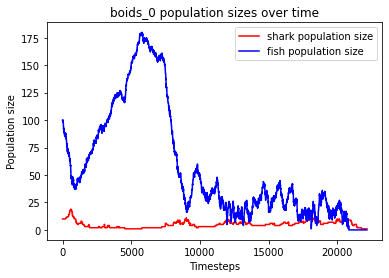

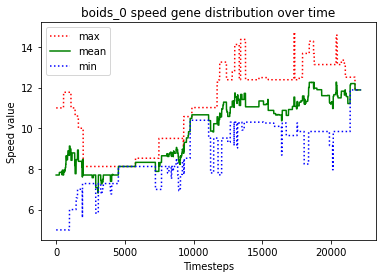

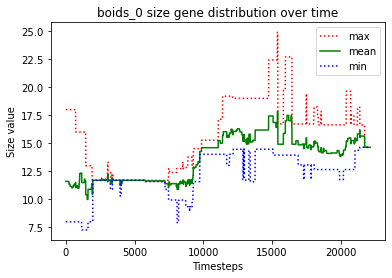

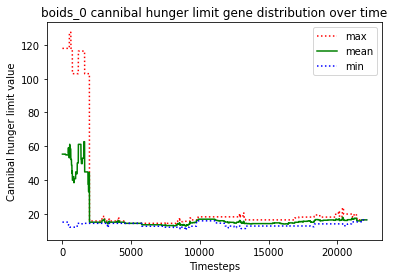

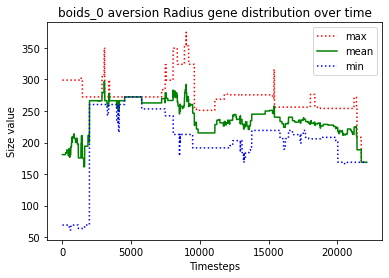

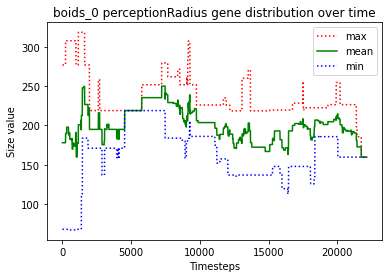

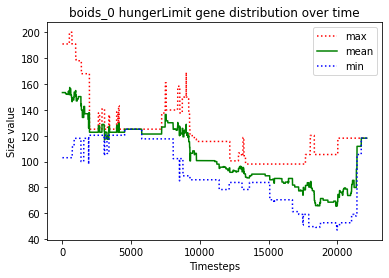





						BOIDS_1

predator_0 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_13 starved to death
predator_10 starved to death
predator_4 ate the carcass of predator_10_carcass
predator_3 ate the carcass of predator_13_carcass
predator_12 just gave birth to predator_14
predator_12 starved to death
predator_14 starved to death
predator_2 starved to death
predator_5 ate the carcass of predator_12_carcass
predator_5 ate the carcass of predator_14_carcass
predator_4 ate the carcass of predator_2_carcass
predator_11 starved to death
predator_8 ate the carcass of predator_11_carcass
predator_0 starved to death
predator_1 ate the carcass of predator_0_carcass
predator_4 just gave birth to predator_15
predator_9 starved to death
predator_15 killed predator_6
predator_5 ate the carcass of predator_9_carcass
predator_15 just gave birth to predator_16
predator_8 starved to death


predator_64 just gave birth to predator_70
predator_67 just gave birth to predator_71
predator_70 starved to death
predator_64 starved to death
predator_59 ate the carcass of predator_70_carcass
predator_49 just gave birth to predator_72
predator_49 killed predator_72
predator_49 ate the carcass of predator_64_carcass
predator_69 just gave birth to predator_73
predator_69 starved to death
predator_73 starved to death
predator_67 ate the carcass of predator_73_carcass
predator_67 ate the carcass of predator_69_carcass
predator_67 just gave birth to predator_74
predator_57 just gave birth to predator_75
predator_71 starved to death
predator_65 just gave birth to predator_76
predator_75 starved to death
predator_57 just gave birth to predator_77
predator_76 ate the carcass of predator_71_carcass
predator_66 starved to death
predator_65 ate the carcass of predator_66_carcass
predator_77 starved to death
predator_74 starved to death
predator_67 just gave birth to predator_78
predator_78 jus

predator_129 killed predator_120
predator_112 starved to death
predator_118 ate the carcass of predator_112_carcass
predator_119 just gave birth to predator_130
predator_130 just gave birth to predator_131
predator_127 just gave birth to predator_132
predator_130 starved to death
predator_131 starved to death
predator_96 ate the carcass of predator_130_carcass
predator_132 just gave birth to predator_133
predator_96 ate the carcass of predator_131_carcass
predator_133 starved to death
predator_127 ate the carcass of predator_133_carcass
predator_96 just gave birth to predator_134
predator_132 starved to death
predator_127 just gave birth to predator_135
predator_119 just gave birth to predator_136
predator_127 just gave birth to predator_137
predator_137 just gave birth to predator_138
predator_137 just gave birth to predator_139
predator_137 starved to death
predator_139 starved to death
predator_118 ate the carcass of predator_137_carcass
predator_138 starved to death
predator_134 ju

predator_179 just gave birth to predator_190
predator_147 just gave birth to predator_191
predator_166 ate the carcass of predator_186_carcass
predator_189 just gave birth to predator_192
predator_166 just gave birth to predator_193
predator_191 starved to death
predator_147 starved to death
predator_192 starved to death
predator_179 ate the carcass of predator_192_carcass
predator_189 just gave birth to predator_194
predator_187 ate the carcass of predator_147_carcass
predator_193 killed predator_194
predator_193 ate the carcass of predator_191_carcass
predator_193 just gave birth to predator_195
predator_193 just gave birth to predator_196
predator_178 just gave birth to predator_197
predator_189 starved to death
predator_187 ate the carcass of predator_189_carcass
predator_196 starved to death
predator_166 ate the carcass of predator_196_carcass
predator_190 just gave birth to predator_198
predator_190 killed predator_198
predator_197 starved to death
predator_187 just gave birth to

predator_245 starved to death
predator_234 ate the carcass of predator_238_carcass
predator_243 ate the carcass of predator_245_carcass
predator_234 just gave birth to predator_246
predator_243 just gave birth to predator_247
predator_247 just gave birth to predator_248
predator_234 starved to death
predator_246 starved to death
predator_248 starved to death
predator_243 ate the carcass of predator_234_carcass
predator_247 starved to death
predator_243 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 249
Timesteps passed: 37615
Fish went extinct at timestep 36355
Sharks went extinct at timestep 37615


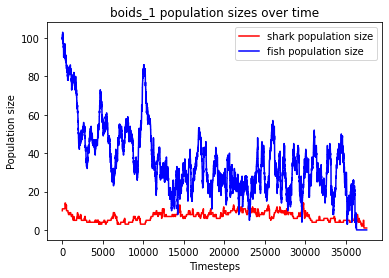

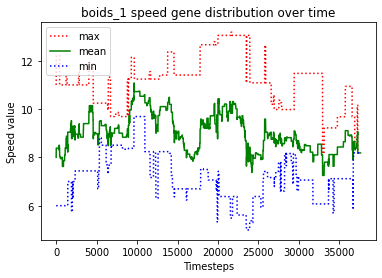

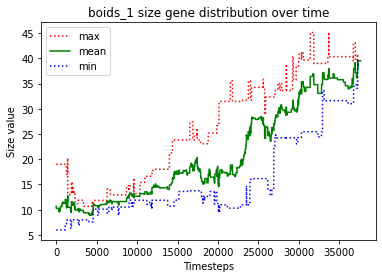

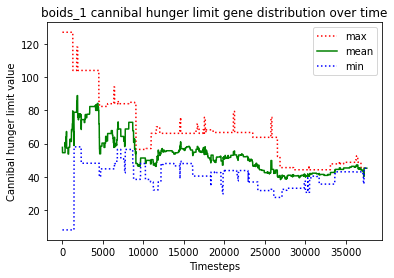

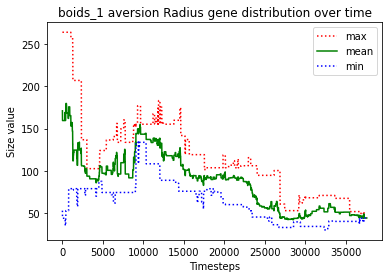

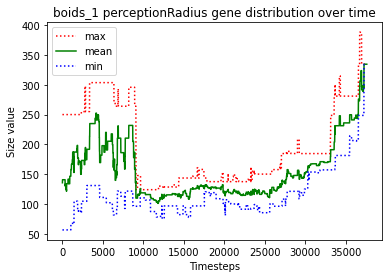

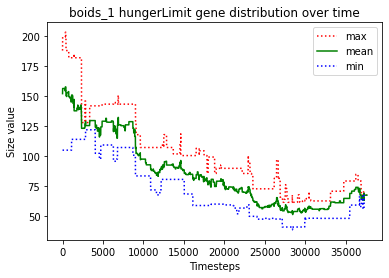





						BOIDS_2

predator_7 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_4 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_7 killed predator_1
predator_7 killed predator_11
predator_14 killed predator_0
predator_14 killed predator_9
predator_4 just gave birth to predator_16
predator_4 starved to death
predator_8 starved to death
predator_12 ate the carcass of predator_4_carcass
predator_15 starved to death
predator_3 ate the carcass of predator_15_carcass
predator_16 starved to death
predator_14 ate the carcass of predator_8_carcass
predator_12 ate the carcass of predator_16_carcass
predator_5 just gave birth to predator_17
predator_12 starved to death
predator_2 just gave birth to predator_18
predator_2 killed predator_18
predator_5 ate the carcass of predator_12_carcass
predator_7 killed predator_17
predator_13 starved to death
p

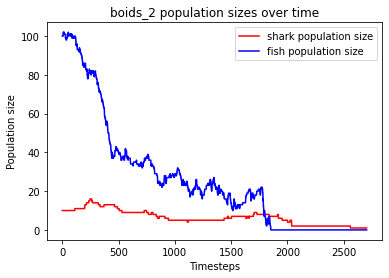

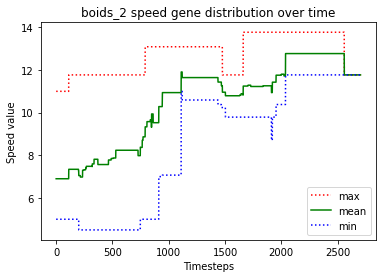

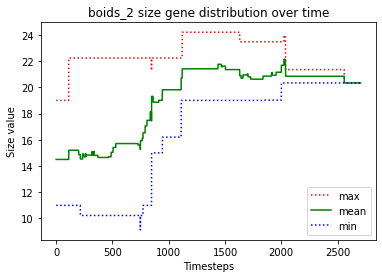

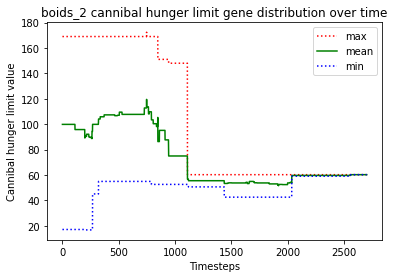

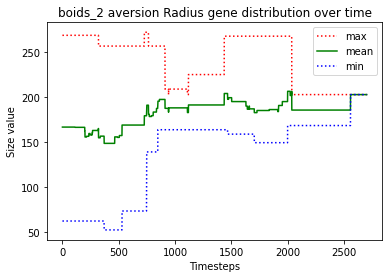

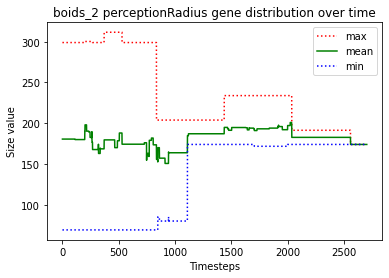

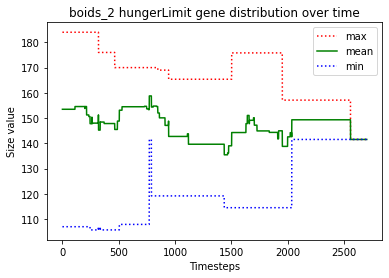





						BOIDS_3

predator_3 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_10 starved to death
predator_13 starved to death
predator_3 starved to death
predator_8 killed predator_0
predator_6 ate the carcass of predator_3_carcass
predator_14 ate the carcass of predator_10_carcass
predator_1 just gave birth to predator_17
predator_14 ate the carcass of predator_13_carcass
predator_8 killed predator_2
predator_12 just gave birth to predator_18
predator_5 just gave birth to predator_19
predator_15 starved to death
predator_19 ate the carcass of predator_15_carcass
predator_4 just gave birth to predator_20
predator_8 starved to death
predator_4 ate the carcass of predator_8_carcass
predator_7 starved to death
predator_11 just gave birth to predat

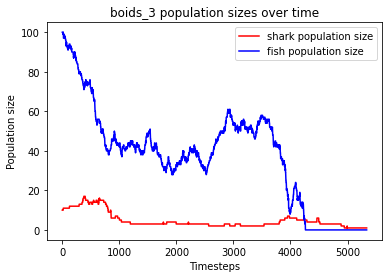

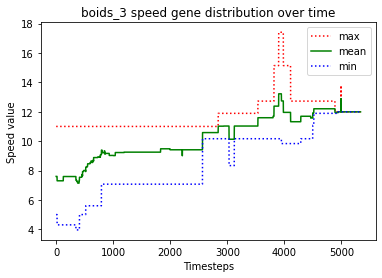

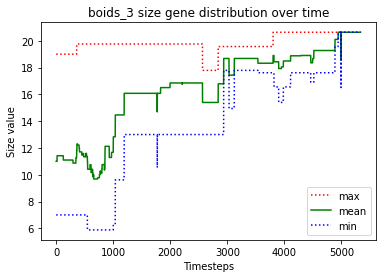

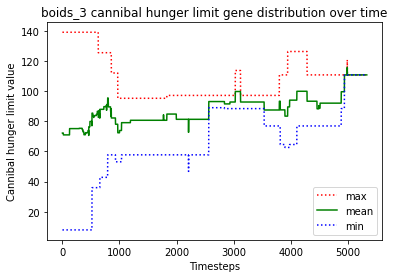

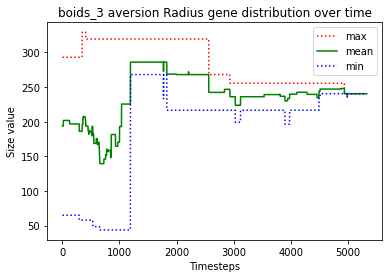

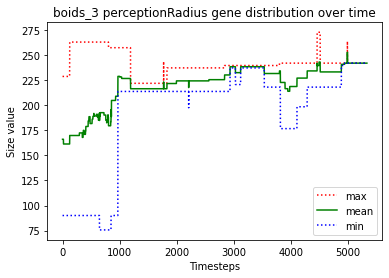

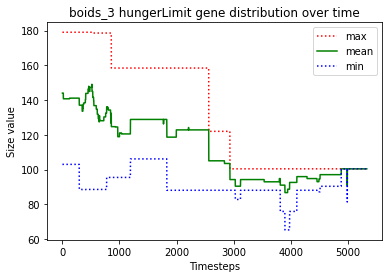





						BOIDS_4

predator_8 just gave birth to predator_10
predator_10 killed predator_4
predator_3 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_8 starved to death
predator_0 ate the carcass of predator_8_carcass
predator_10 killed predator_5
predator_11 starved to death
predator_9 ate the carcass of predator_11_carcass
predator_12 starved to death
predator_3 ate the carcass of predator_12_carcass
predator_6 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_10 starved to death
predator_2 ate the carcass of predator_10_carcass
predator_14 starved to death
predator_13 starved to death
predator_7 ate the carcass of predator_13_carcass
predator_3 starved to death
predator_6 starved to death
predator_9 ate the carcass of predator_14_carcass
predator_2 ate the carcass of predator_3_carcass
predator_9 ate the carcass of predator_6_carcass
predator_2 starved to death
predator_7 ate the carcass of predator_2_carcass
predato

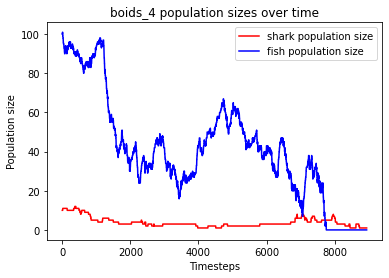

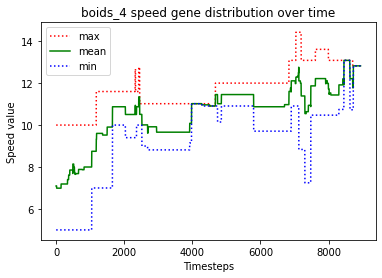

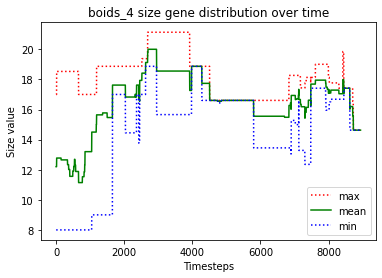

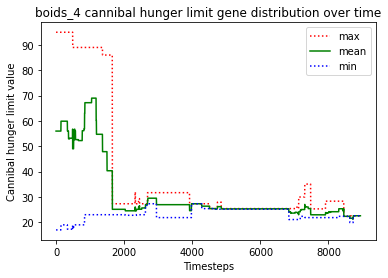

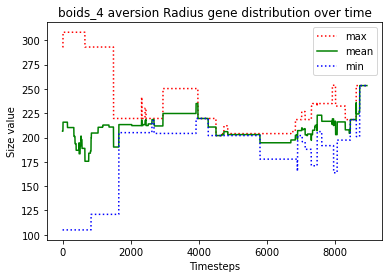

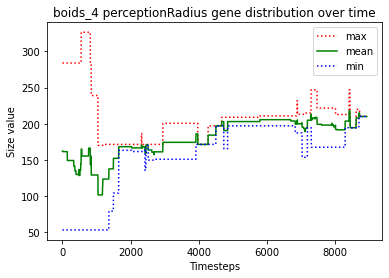

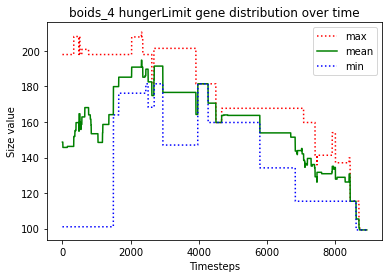





						BOIDS_5

predator_0 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_13 killed predator_14
predator_12 starved to death
predator_1 ate the carcass of predator_12_carcass
predator_0 starved to death
predator_10 ate the carcass of predator_0_carcass
predator_4 just gave birth to predator_15
predator_9 just gave birth to predator_16
predator_15 starved to death
predator_4 starved to death
predator_13 ate the carcass of predator_15_carcass
predator_13 ate the carcass of predator_4_carcass
predator_13 killed predator_8
predator_1 starved to death
predator_10 starved to death
predator_11 starved to death
predator_3 just gave birth to predator_17
predator_2 ate the carcass of predator_1_carcass
predator_13 ate the carcass of predator_10_carcass
predator_13 ate the carcass of predator_11_carcass
predator_13 just gave birth to

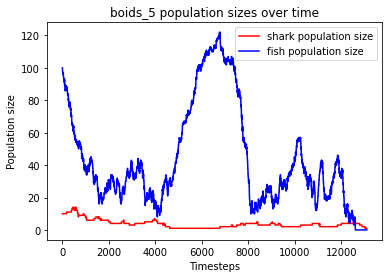

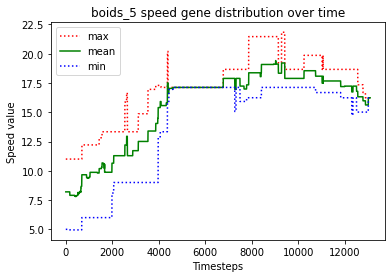

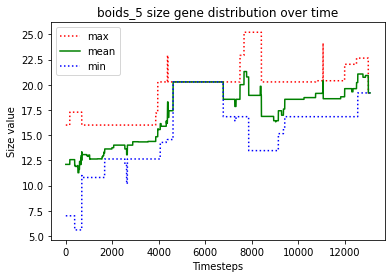

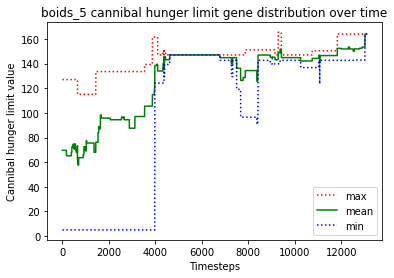

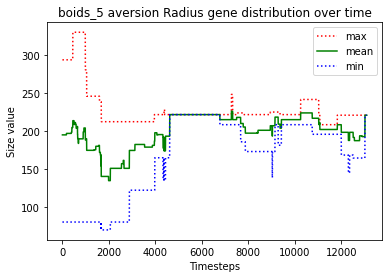

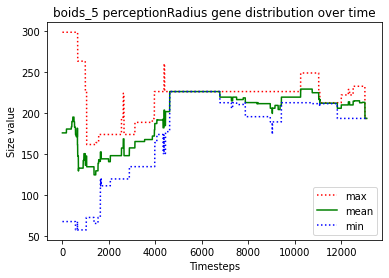

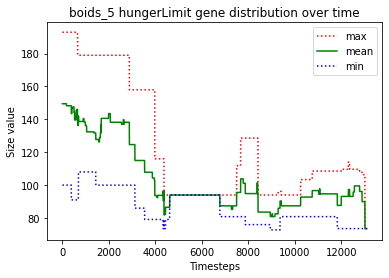





						BOIDS_6

predator_7 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_0 killed predator_11
predator_1 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_7 killed predator_2
predator_8 just gave birth to predator_14
predator_10 starved to death
predator_13 starved to death
predator_12 ate the carcass of predator_10_carcass
predator_1 ate the carcass of predator_13_carcass
predator_12 just gave birth to predator_15
predator_8 starved to death
predator_14 starved to death
predator_0 ate the carcass of predator_8_carcass
predator_7 starved to death
predator_0 ate the carcass of predator_14_carcass
predator_15 ate the carcass of predator_7_carcass
predator_3 starved to death
predator_1 ate the carcass of predator_3_carcass
predator_12 starved to death
predator_15 starved to death
predator_9 ate the carcass of predator_12_carcass
predator_0 ate the carcass of predator_15_carcass
predator_6 starved to death
predator_1 a

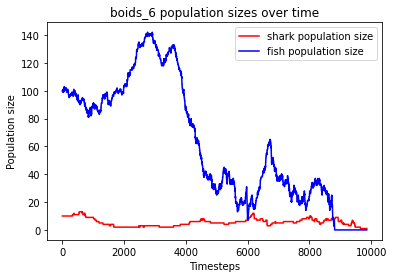

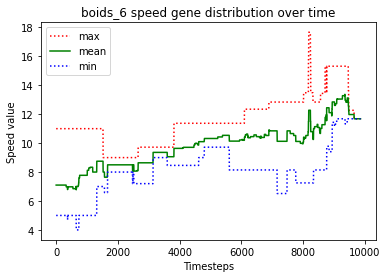

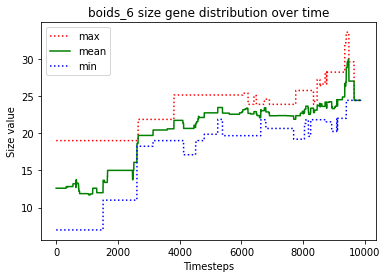

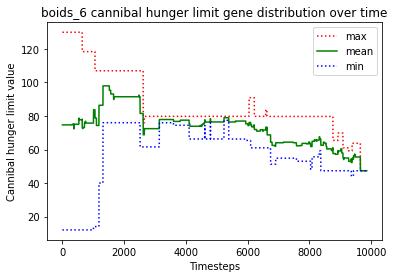

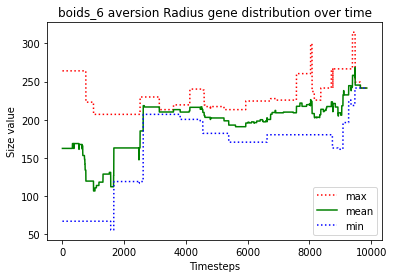

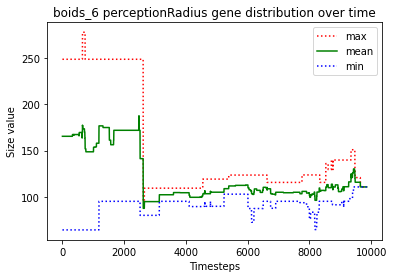

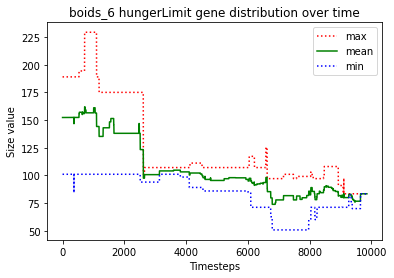





						BOIDS_7

predator_1 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_11 starved to death
predator_13 starved to death
predator_6 ate the carcass of predator_11_carcass
predator_14 just gave birth to predator_15
predator_1 starved to death
predator_2 ate the carcass of predator_1_carcass
predator_7 just gave birth to predator_16
predator_9 just gave birth to predator_17
predator_6 just gave birth to predator_18
predator_16 killed predator_0
predator_10 starved to death
predator_6 ate the carcass of predator_10_carcass
predator_12 ate the carcass of predator_13_carcass
predator_16 killed predator_14
predator_2 starved to death
predator_8 ate the carcass of predator_2_carcass
predator_16 killed predator_9
predator_15 just gave birth to predator_19
predator_16 killed predator_17
predator_15 starved to death
predator_8 just

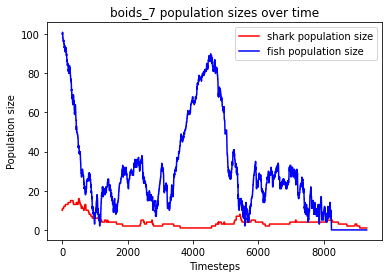

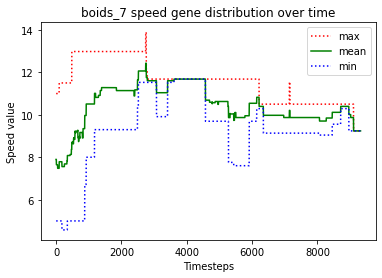

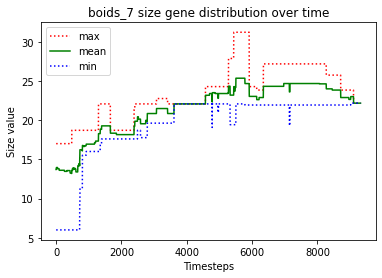

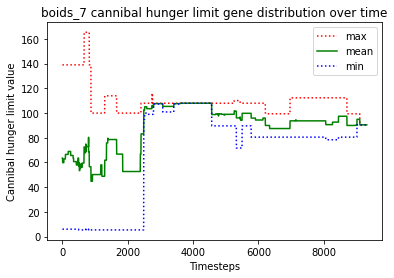

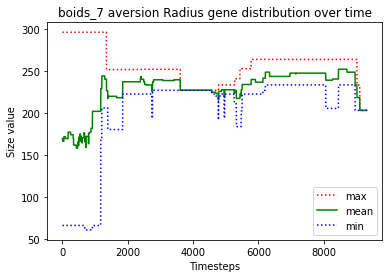

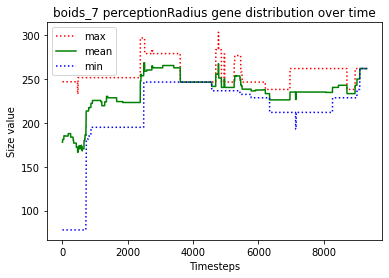

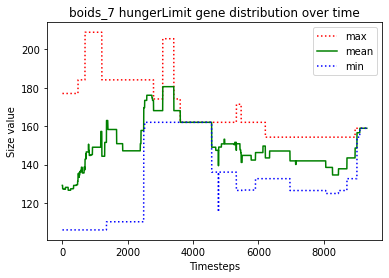





						BOIDS_8

predator_6 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_4 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_10 starved to death
predator_2 ate the carcass of predator_10_carcass
predator_12 just gave birth to predator_14
predator_13 starved to death
predator_2 ate the carcass of predator_13_carcass
predator_9 just gave birth to predator_15
predator_6 starved to death
predator_7 ate the carcass of predator_6_carcass
predator_2 just gave birth to predator_16
predator_14 starved to death
predator_8 just gave birth to predator_17
predator_12 ate the carcass of predator_14_carcass
predator_2 killed predator_5
predator_17 just gave birth to predator_18
predator_1 just gave birth to predator_19
predator_17 starved to death
predator_11 starved to death
predator_1 ate the carcass of predator_17_carcass
predator_19 ate the carcass of predator_11_carcass
predator_8 starved to death
predator_0 starved to death

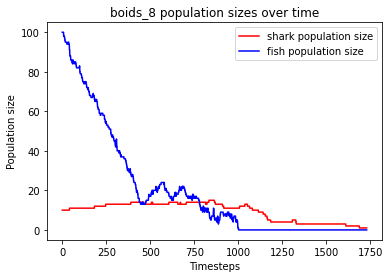

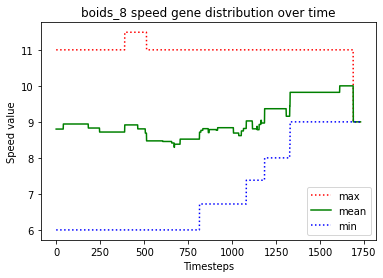

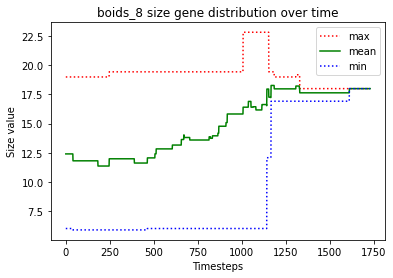

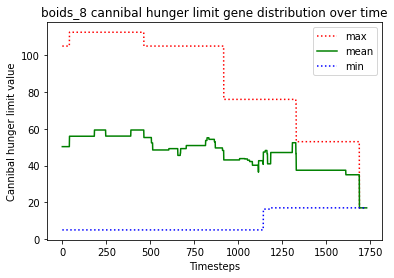

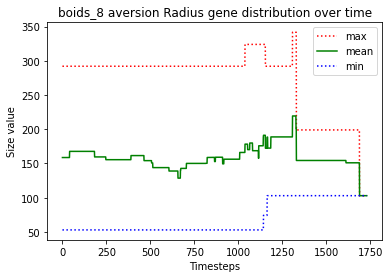

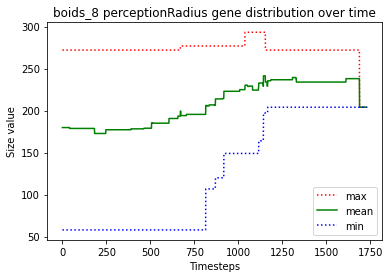

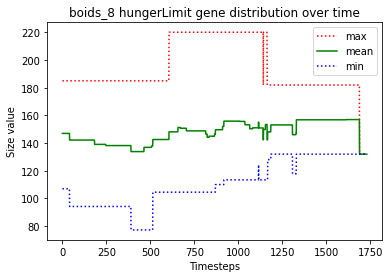





						BOIDS_9

predator_7 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_10 killed predator_2
predator_7 killed predator_1
predator_10 killed predator_11
predator_7 killed predator_0
predator_12 killed predator_4
predator_10 killed predator_6
predator_3 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_9 just gave birth to predator_15
predator_7 killed predator_13
predator_7 killed predator_5
predator_12 starved to death
predator_14 starved to death
predator_10 killed predator_8
predator_7 ate the carcass of predator_14_carcass
predator_9 just gave birth to predator_16
predator_9 ate the carcass of predator_12_carcass
predator_7 starved to death
predator_10 ate the carcass of predator_7_carcass
predator_10 starved to death
predator_16 ate the carcass of predator_10_carcass
predator_3 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_18 starv

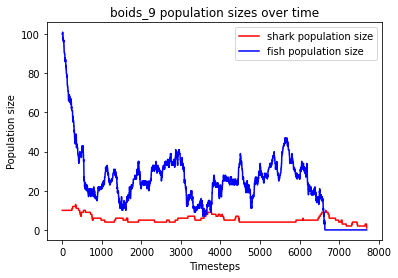

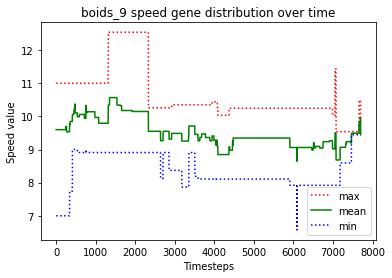

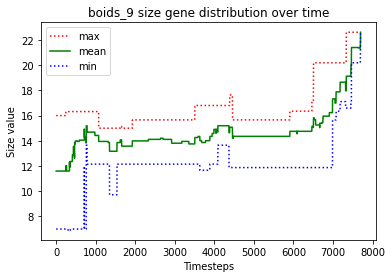

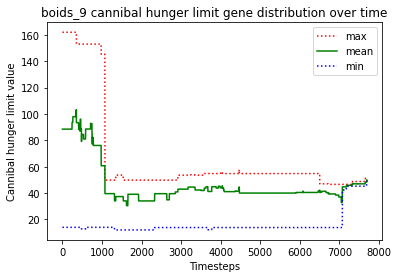

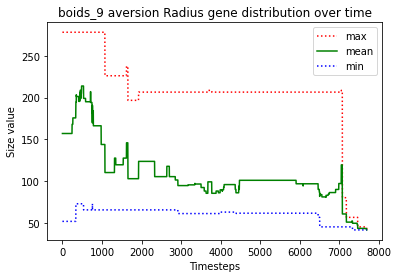

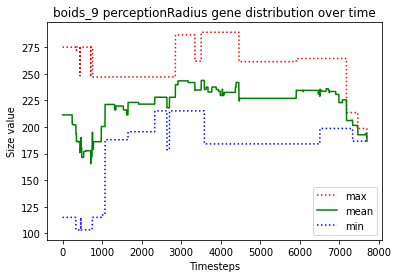

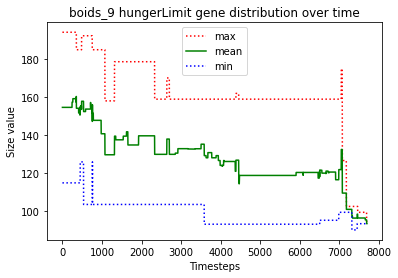





						BOIDS_10

predator_0 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_6 killed predator_8
predator_7 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_9 just gave birth to predator_15
predator_6 just gave birth to predator_16
predator_4 just gave birth to predator_17
predator_13 starved to death
predator_16 ate the carcass of predator_13_carcass
predator_3 just gave birth to predator_18
predator_18 killed predator_16
predator_17 killed predator_9
predator_4 killed predator_11
predator_3 killed predator_6
predator_18 killed predator_5
predator_15 starved to death
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_0 starved to death
predator_18 ate the carcass of predator_0_carcass
predator_18 killed predator_2
predator_18 killed predator_14
predator_4 ate the carcass of predator_15_carcass
predator_18 killed predator_17
predator_3 just

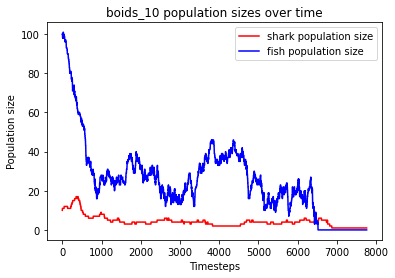

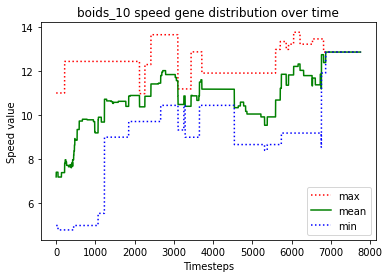

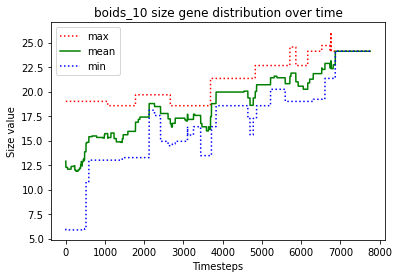

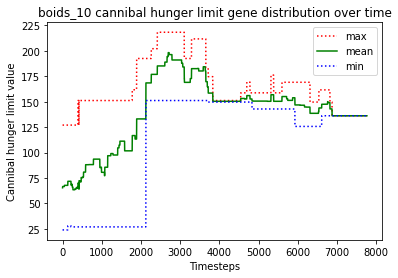

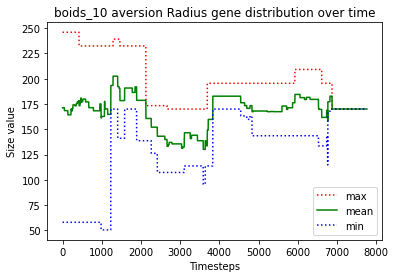

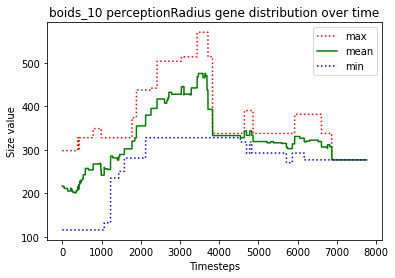

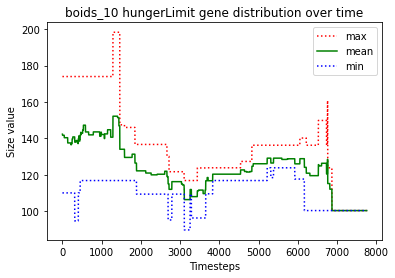





						BOIDS_11

predator_9 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_1 starved to death
predator_8 starved to death
predator_9 ate the carcass of predator_8_carcass
predator_7 ate the carcass of predator_1_carcass
predator_4 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_3 killed predator_14
predator_2 just gave birth to predator_15
predator_5 just gave birth to predator_16
predator_12 killed predator_13
predator_4 starved to death
predator_12 ate the carcass of predator_4_carcass
predator_15 starved to death
predator_12 ate the carcass of predator_15_carcass
predator_2 starved to death
predator_6 ate the carcass of predator_2_carcass
predator_16 starved to death
predator_6 starved to death
predator_0 ate the carcass of predator_16_carcass
predator_12 ate the carcass of predator_6_carcass
predator_3 starved to death
predator_0 ate the carcass of predator_3_carcass
pr

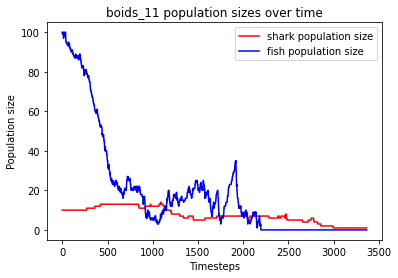

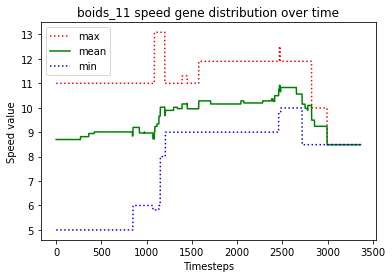

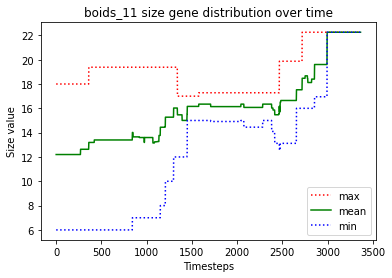

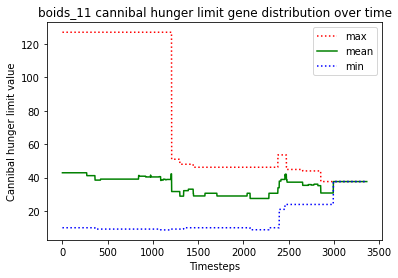

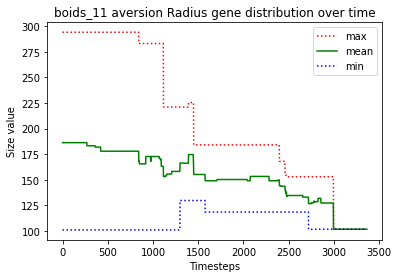

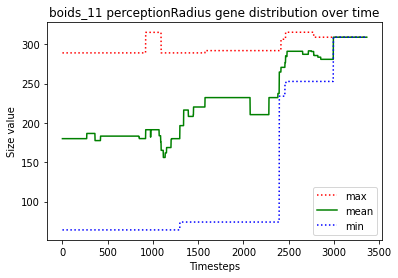

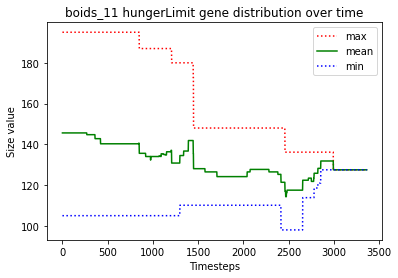





						BOIDS_12

predator_3 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_11 starved to death
predator_10 killed predator_5
predator_3 ate the carcass of predator_11_carcass
predator_0 just gave birth to predator_12
predator_9 starved to death
predator_6 just gave birth to predator_13
predator_10 starved to death
predator_8 just gave birth to predator_14
predator_0 ate the carcass of predator_10_carcass
predator_0 ate the carcass of predator_9_carcass
predator_2 just gave birth to predator_15
predator_6 starved to death
predator_7 ate the carcass of predator_6_carcass
predator_15 just gave birth to predator_16
predator_15 starved to death
predator_16 starved to death
predator_2 starved to death
predator_13 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_4 just gave birth to predator_17
predator_4 starved to death
predator_17 starved to death
predator_14 killed predator_7
predator_0 ate the carcass of predator_4_carcass


predator_61 just gave birth to predator_67
predator_46 just gave birth to predator_68
predator_67 killed predator_68
predator_67 killed predator_46
predator_61 just gave birth to predator_69
predator_61 just gave birth to predator_70
predator_67 just gave birth to predator_71
predator_69 starved to death
predator_66 ate the carcass of predator_69_carcass
predator_61 just gave birth to predator_72
predator_66 just gave birth to predator_73
predator_71 killed predator_72
predator_70 just gave birth to predator_74
predator_74 killed predator_61
predator_67 just gave birth to predator_75
predator_67 starved to death
predator_75 starved to death
predator_73 ate the carcass of predator_75_carcass
predator_74 starved to death
predator_71 starved to death
predator_70 ate the carcass of predator_71_carcass
predator_73 just gave birth to predator_76
predator_76 ate the carcass of predator_74_carcass
predator_73 starved to death
predator_76 ate the carcass of predator_67_carcass
predator_70 ate t

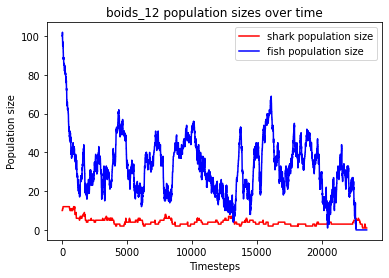

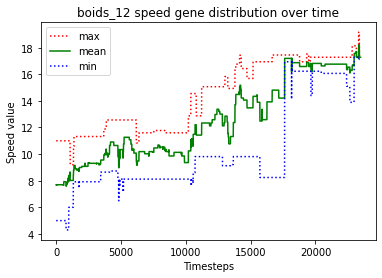

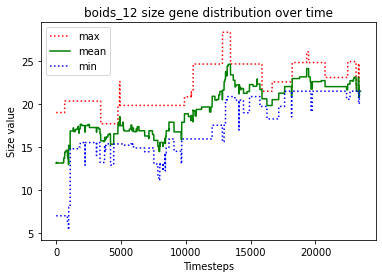

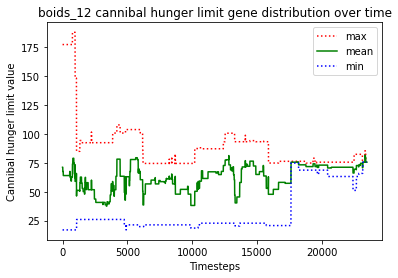

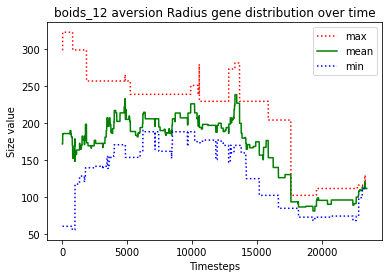

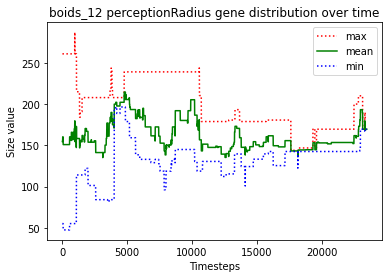

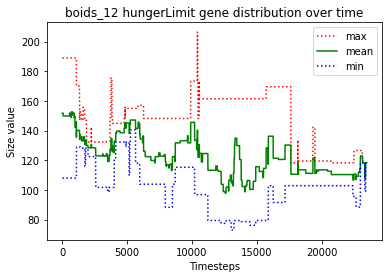





						BOIDS_13

predator_0 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_6 killed predator_9
predator_0 killed predator_8
predator_1 just gave birth to predator_13
predator_1 killed predator_2
predator_6 killed predator_13
predator_6 killed predator_3
predator_0 just gave birth to predator_14
predator_14 starved to death
predator_0 starved to death
predator_7 just gave birth to predator_15
predator_6 ate the carcass of predator_14_carcass
predator_1 just gave birth to predator_16
predator_6 ate the carcass of predator_0_carcass
predator_11 starved to death
predator_6 ate the carcass of predator_11_carcass
predator_15 just gave birth to predator_17
predator_1 starved to death
predator_12 ate the carcass of predator_1_carcass
predator_16 starved to death
predator_12 ate the carcass of predator_16_carcass
predator_10 starved to death
predator_15 starved to death
predator_5 ate the carcass of predator_10_car

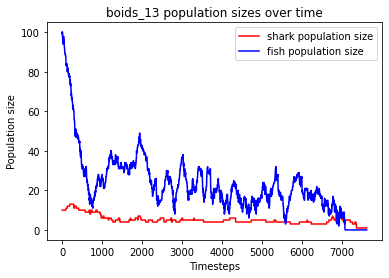

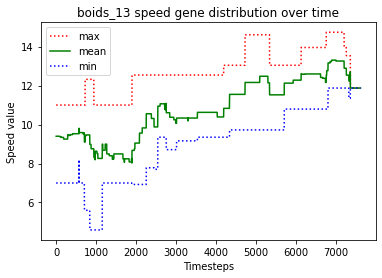

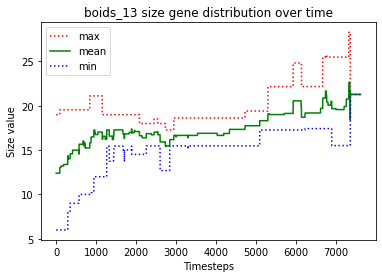

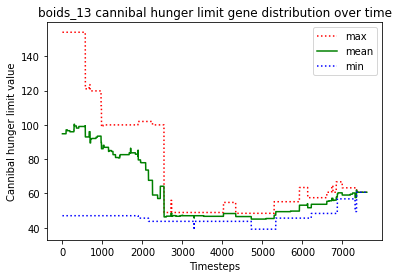

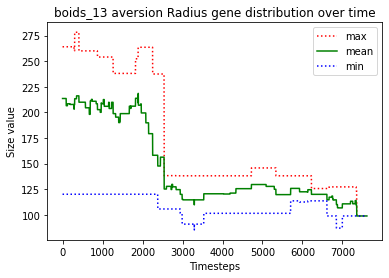

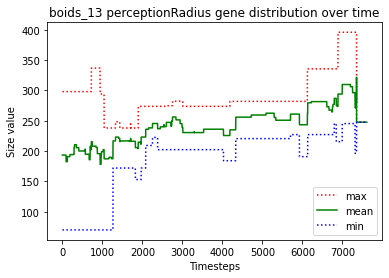

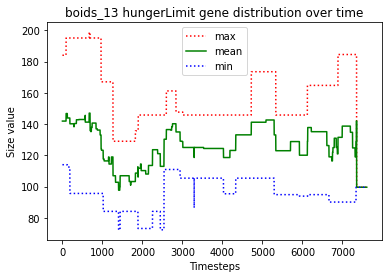





						BOIDS_14

predator_4 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_4 killed predator_13
predator_0 just gave birth to predator_14
predator_12 killed predator_11
predator_9 just gave birth to predator_15
predator_3 just gave birth to predator_16
predator_1 just gave birth to predator_17
predator_2 killed predator_14
predator_17 killed predator_10
predator_17 killed predator_0
predator_8 just gave birth to predator_18
predator_6 just gave birth to predator_19
predator_17 killed predator_9
predator_4 starved to death
predator_16 just gave birth to predator_20
predator_6 starved to death
predator_1 ate the carcass of predator_4_carcass
predator_19 starved to death
predator_15 ate the carcass of predator_6_carcass
predator_3 ate the carcass of predator_19_carcass
predator_20 starved to death
predator_17 ate the carcass of predator_20_carcass
predator_16 starved t

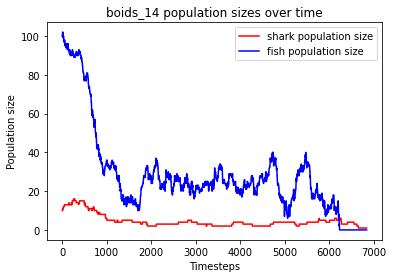

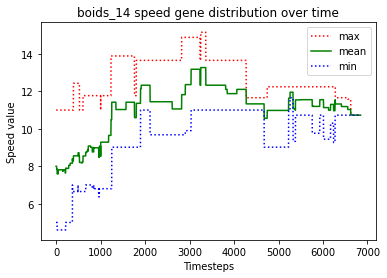

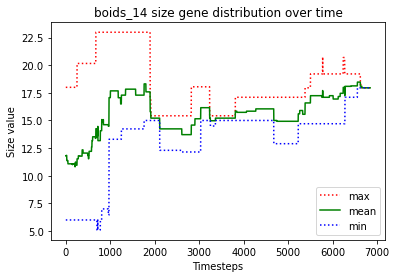

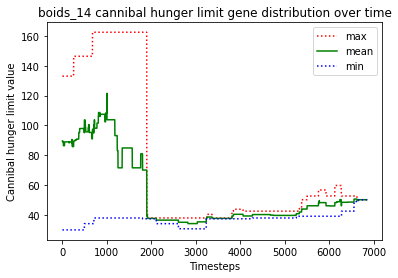

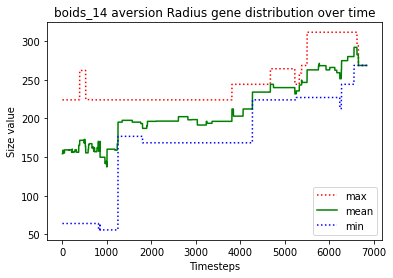

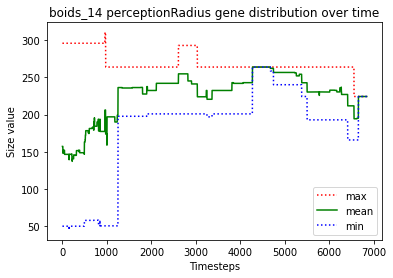

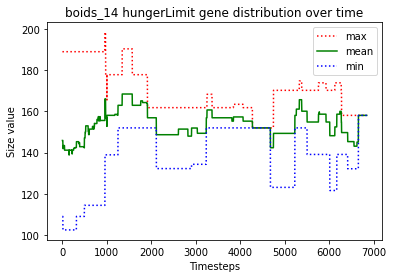





						BOIDS_15

predator_8 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_12 just gave birth to predator_15
predator_7 just gave birth to predator_16
predator_9 just gave birth to predator_17
predator_16 starved to death
predator_7 starved to death
predator_12 starved to death
predator_15 ate the carcass of predator_12_carcass
predator_4 ate the carcass of predator_7_carcass
predator_17 ate the carcass of predator_16_carcass
predator_11 just gave birth to predator_18
predator_3 killed predator_13
predator_10 starved to death
predator_1 ate the carcass of predator_10_carcass
predator_0 just gave birth to predator_19
predator_8 just gave birth to predator_20
predator_14 starved to death
predator_18 starved to death
predator_19 killed predator_6
predator_9 starved to death
predator_11 starved to death
predator_8 starved to de

predator_67 starved to death
predator_69 ate the carcass of predator_67_carcass
predator_69 just gave birth to predator_70
predator_42 starved to death
predator_64 ate the carcass of predator_42_carcass
predator_31 just gave birth to predator_71
predator_31 just gave birth to predator_72
predator_50 just gave birth to predator_73
predator_50 just gave birth to predator_74
predator_74 starved to death
no fish to move
predator_50 starved to death
predator_69 just gave birth to predator_75
predator_72 starved to death
predator_69 ate the carcass of predator_72_carcass
predator_31 ate the carcass of predator_74_carcass
predator_31 ate the carcass of predator_50_carcass
predator_71 starved to death
predator_31 ate the carcass of predator_71_carcass
predator_31 just gave birth to predator_76
predator_31 killed predator_76
predator_73 starved to death
predator_64 ate the carcass of predator_73_carcass
predator_75 starved to death
predator_31 starved to death
predator_70 just gave birth to pre

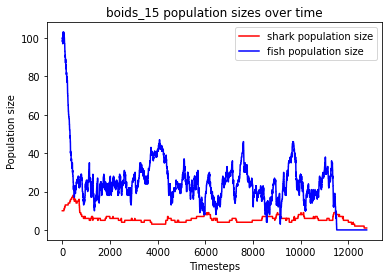

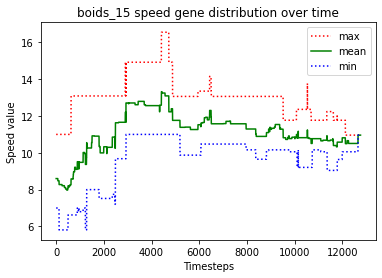

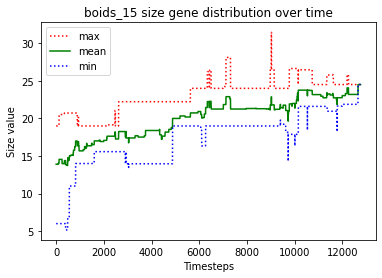

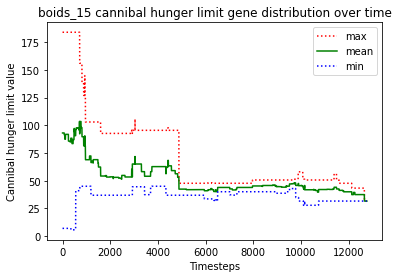

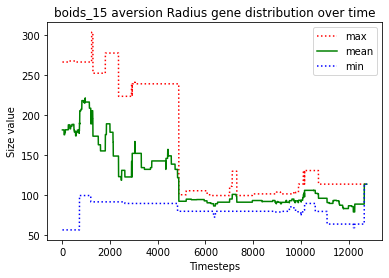

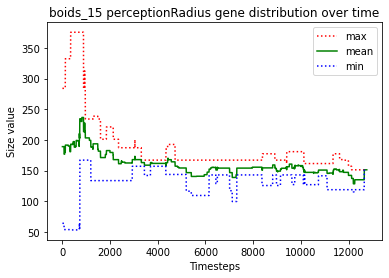

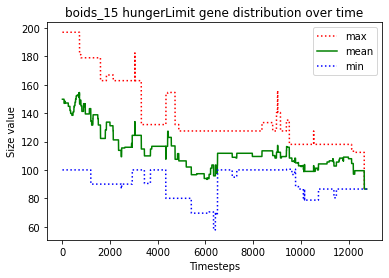





						BOIDS_16

predator_9 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_3 starved to death
predator_11 ate the carcass of predator_3_carcass
predator_10 just gave birth to predator_14
predator_13 just gave birth to predator_15
predator_12 just gave birth to predator_16
predator_14 just gave birth to predator_17
predator_13 starved to death
predator_10 starved to death
predator_14 starved to death
predator_17 starved to death
predator_15 ate the carcass of predator_13_carcass
predator_9 ate the carcass of predator_17_carcass
predator_2 ate the carcass of predator_10_carcass
predator_9 ate the carcass of predator_14_carcass
predator_16 killed predator_1
predator_11 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_15 starved to death
predator_4 just gave birth to predator_18
predator_6 killed predator_7
predator_6 ate the carcass of predat

predator_64 ate the carcass of predator_66_carcass
predator_63 just gave birth to predator_71
predator_63 starved to death
predator_71 starved to death
predator_51 starved to death
predator_68 starved to death
predator_69 ate the carcass of predator_71_carcass
predator_59 just gave birth to predator_72
predator_69 ate the carcass of predator_51_carcass
predator_70 starved to death
predator_59 ate the carcass of predator_70_carcass
predator_59 just gave birth to predator_73
predator_59 ate the carcass of predator_63_carcass
predator_65 just gave birth to predator_74
predator_73 ate the carcass of predator_68_carcass
predator_74 just gave birth to predator_75
predator_75 just gave birth to predator_76
predator_75 killed predator_76
predator_74 starved to death
predator_64 just gave birth to predator_77
predator_77 ate the carcass of predator_74_carcass
predator_75 starved to death
predator_64 starved to death
predator_69 ate the carcass of predator_75_carcass
predator_65 starved to death

predator_129 starved to death
predator_126 ate the carcass of predator_129_carcass
predator_125 ate the carcass of predator_124_carcass
predator_130 just gave birth to predator_131
predator_126 ate the carcass of predator_117_carcass
predator_121 starved to death
predator_126 just gave birth to predator_132
predator_130 starved to death
predator_127 ate the carcass of predator_130_carcass
predator_131 starved to death
predator_118 starved to death
predator_126 ate the carcass of predator_121_carcass
predator_125 ate the carcass of predator_131_carcass
predator_112 starved to death
predator_125 ate the carcass of predator_112_carcass
predator_132 starved to death
predator_126 ate the carcass of predator_132_carcass
predator_127 starved to death
predator_125 ate the carcass of predator_118_carcass
predator_126 ate the carcass of predator_127_carcass
predator_126 starved to death
predator_125 ate the carcass of predator_126_carcass
predator_125 starved to death


finished this run because

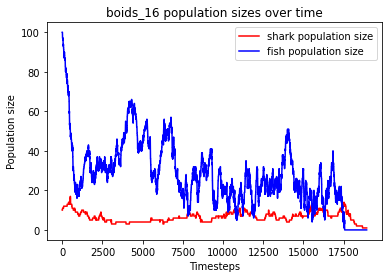

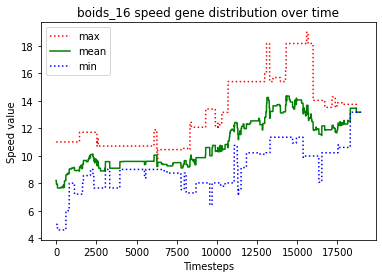

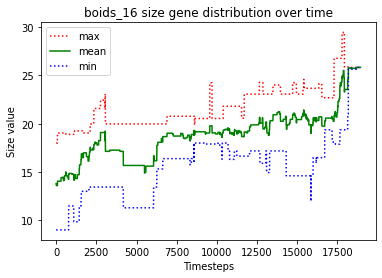

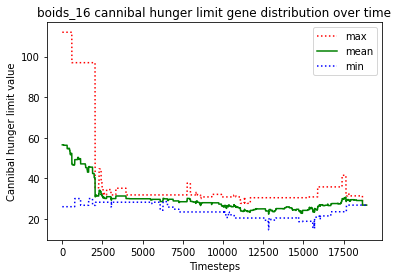

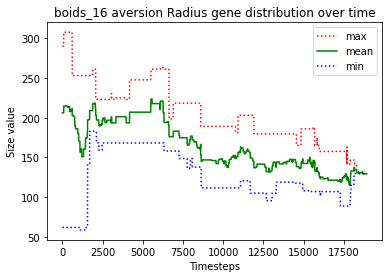

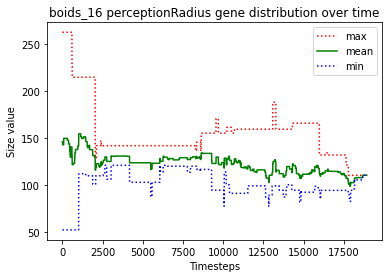

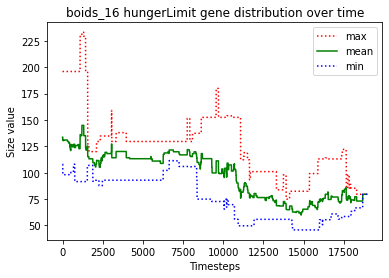





						BOIDS_17

predator_9 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_12 starved to death
predator_10 ate the carcass of predator_12_carcass
predator_11 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_13 starved to death
predator_4 ate the carcass of predator_13_carcass
predator_14 starved to death
predator_11 ate the carcass of predator_14_carcass
predator_15 starved to death
predator_10 killed predator_7
predator_8 ate the carcass of predator_15_carcass
predator_4 just gave birth to predator_16
predator_4 just gave birth to predator_17
predator_17 killed predator_5
predator_4 killed predator_6
predator_3 just gave birth to predator_18
predator_4 killed predator_0
predator_10 starved to death
predator_18 starved to death
predator_16 just gave birth to predator_19
predator_19 just gave birth to predator_20
predator_1 starve

predator_43 just gave birth to predator_71
predator_69 just gave birth to predator_72
predator_69 killed predator_72
predator_65 starved to death
predator_70 just gave birth to predator_73
predator_43 starved to death
predator_69 ate the carcass of predator_65_carcass
predator_71 starved to death
predator_68 ate the carcass of predator_71_carcass
predator_73 starved to death
predator_56 ate the carcass of predator_73_carcass
predator_67 ate the carcass of predator_43_carcass
predator_70 starved to death
predator_67 just gave birth to predator_74
predator_74 ate the carcass of predator_70_carcass
predator_74 just gave birth to predator_75
predator_68 starved to death
predator_67 ate the carcass of predator_68_carcass
predator_74 just gave birth to predator_76
no fish to move
predator_74 starved to death
predator_76 starved to death
predator_67 just gave birth to predator_77
predator_67 killed predator_77
predator_75 ate the carcass of predator_76_carcass
predator_67 starved to death
pre

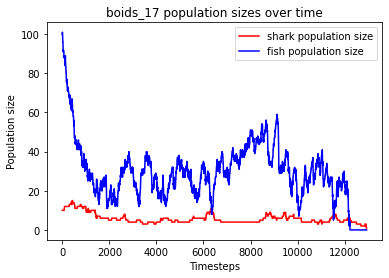

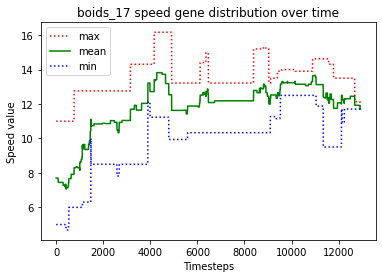

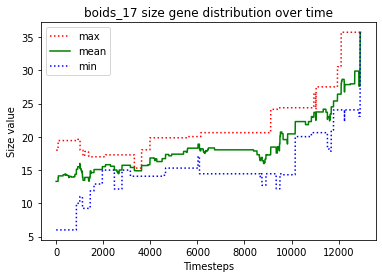

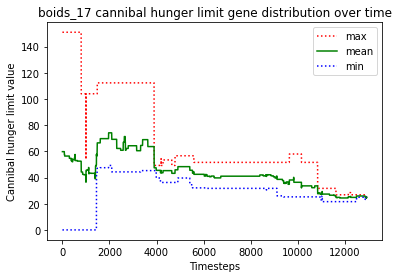

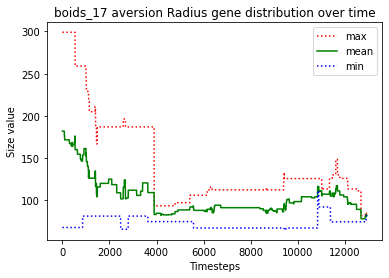

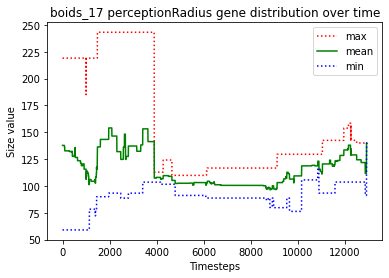

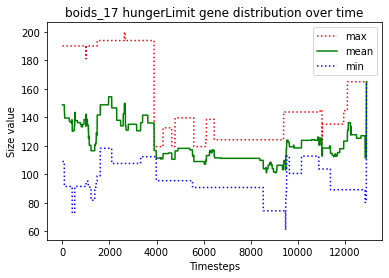





						BOIDS_18

predator_6 just gave birth to predator_10
predator_6 killed predator_8
predator_6 killed predator_2
predator_1 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_12 killed predator_3
predator_12 killed predator_0
predator_10 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_6 just gave birth to predator_15
predator_9 just gave birth to predator_16
predator_14 just gave birth to predator_17
predator_14 just gave birth to predator_18
predator_15 killed predator_17
predator_14 starved to death
predator_18 starved to death
predator_11 ate the carcass of predator_14_carcass
predator_11 ate the carcass of predator_18_carcass
predator_16 starved to death
predator_12 ate the carcass of predator_16_carcass
predator_10 just gave birth to predator_19
predator_13 killed predator_19
predator_9 starved to death
predator_1 ate the carcass of predator_9_carcass
predator_10 starved to death
predator_6 ate the carcass o

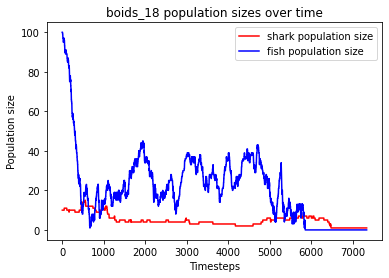

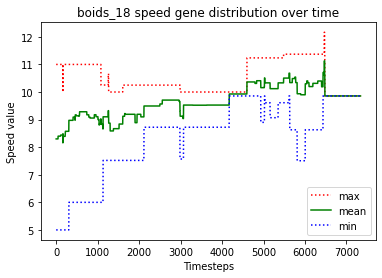

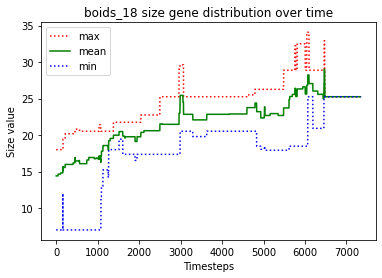

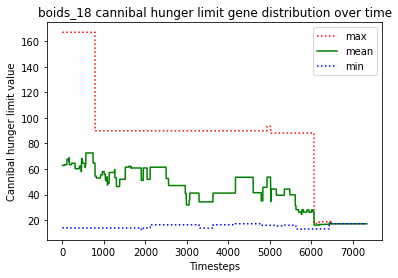

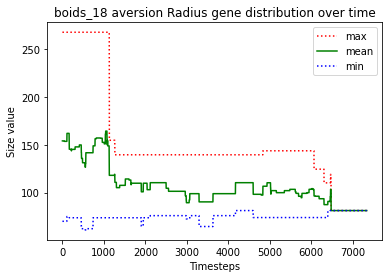

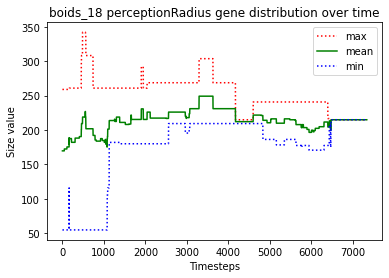

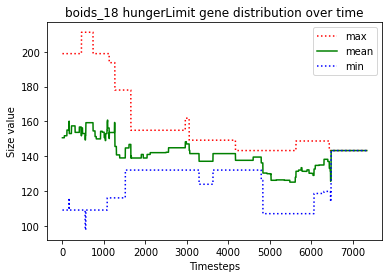





						BOIDS_19

predator_9 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_12 starved to death
predator_1 starved to death
predator_7 ate the carcass of predator_1_carcass
predator_6 just gave birth to predator_14
predator_6 ate the carcass of predator_12_carcass
predator_10 starved to death
predator_5 ate the carcass of predator_10_carcass
predator_7 killed predator_14
predator_0 just gave birth to predator_15
predator_9 killed predator_15
predator_0 starved to death
predator_9 ate the carcass of predator_0_carcass
predator_2 killed predator_8
predator_13 starved to death
predator_4 ate the carcass of predator_13_carcass
predator_2 just gave birth to predator_16
predator_7 killed predator_11
predator_3 starved to death
predator_7 ate the carcass of predator_3_carcass
predator_6 starved to death
predator_2 starved to death
predator_16 starved to death
predator_4 jus

predator_66 ate the carcass of predator_57_carcass
predator_54 just gave birth to predator_67
predator_66 starved to death
predator_67 starved to death
predator_54 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 68
Timesteps passed: 13841
Fish went extinct at timestep 12771
Sharks went extinct at timestep 13841


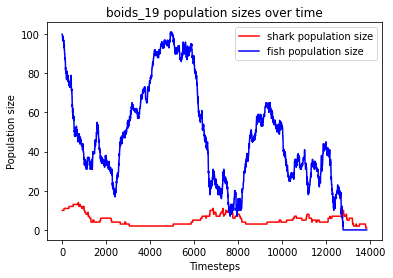

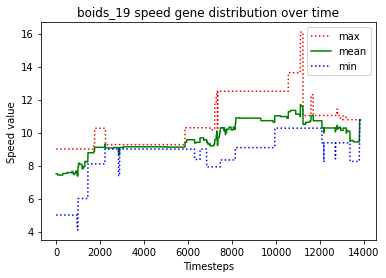

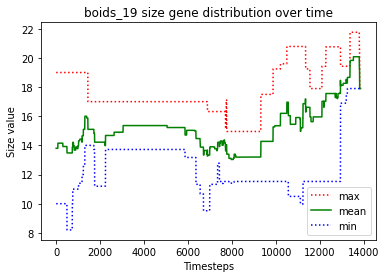

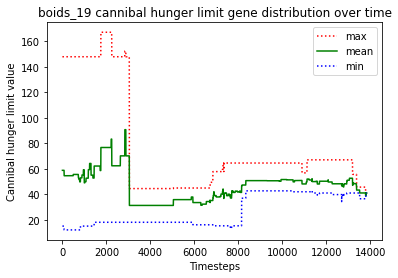

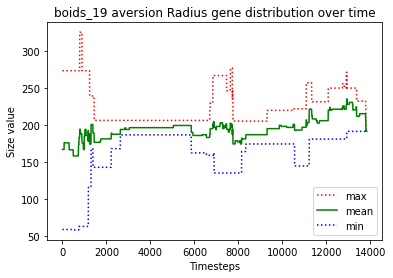

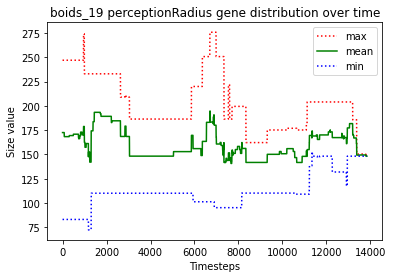

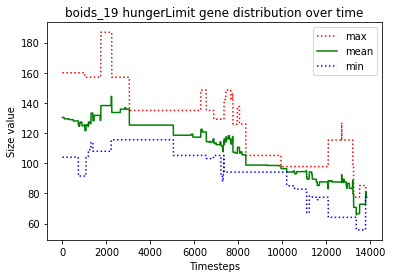





						BOIDS_20

predator_1 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_3 killed predator_5
predator_12 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_1 starved to death
predator_10 ate the carcass of predator_1_carcass
predator_4 just gave birth to predator_15
predator_13 just gave birth to predator_16
predator_7 just gave birth to predator_17
predator_11 starved to death
predator_16 starved to death
predator_6 ate the carcass of predator_11_carcass
predator_0 just gave birth to predator_18
predator_15 ate the carcass of predator_16_carcass
predator_13 starved to death
predator_15 ate the carcass of predator_13_carcass
predator_0 just gave birth to predator_19
predator_4 killed predator_17
predator_10 starved to death
predator_2 ate the carcass of predator_10_carcass
predator_2 just gave birth to predator_20
predator_2 just gave birth to predator_21
predator_7 starved 

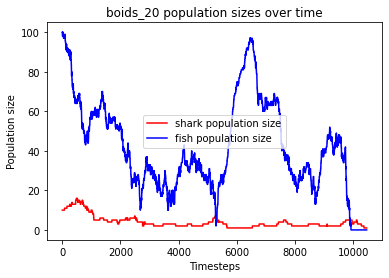

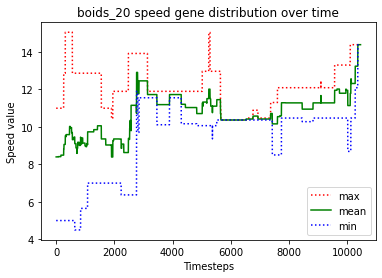

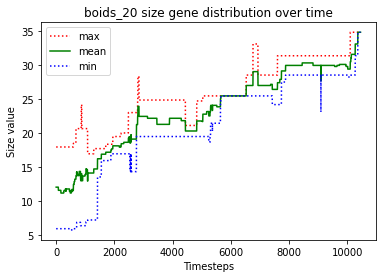

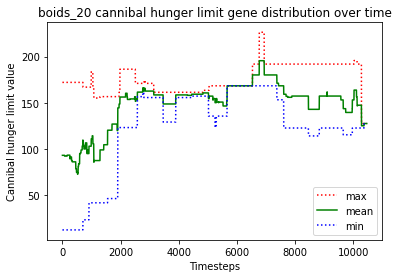

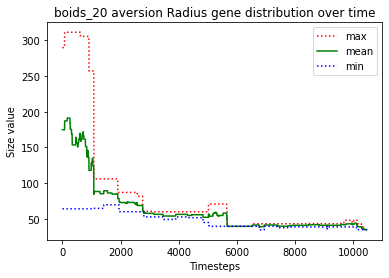

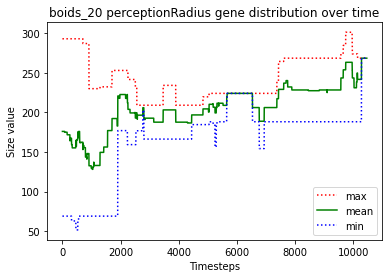

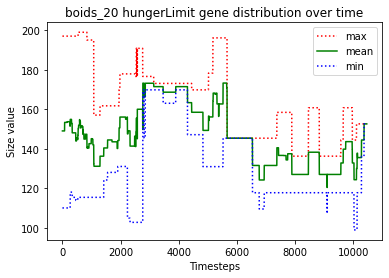





						BOIDS_21

predator_8 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_13 starved to death
predator_3 ate the carcass of predator_13_carcass
predator_2 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_15 just gave birth to predator_17
predator_12 starved to death
predator_17 ate the carcass of predator_12_carcass
predator_10 just gave birth to predator_18
predator_3 starved to death
predator_10 starved to death
predator_1 just gave birth to predator_19
predator_18 starved to death
predator_14 starved to death
predator_0 ate the carcass of predator_18_carcass
predator_0 ate the carcass of predator_10_carcass
predator_0 ate the carcass of predator_14_carcass
predator_17 killed predator_11
predator_15 starved to death
predator_16 ate the carcass of predator_3_carcass
predator_17 ate the ca

predator_58 ate the carcass of predator_66_carcass
predator_58 just gave birth to predator_67
predator_67 just gave birth to predator_68
predator_58 just gave birth to predator_69
predator_68 just gave birth to predator_70
predator_58 starved to death
predator_70 ate the carcass of predator_58_carcass
predator_67 just gave birth to predator_71
predator_42 just gave birth to predator_72
predator_69 just gave birth to predator_73
predator_72 starved to death
predator_68 killed predator_73
predator_42 ate the carcass of predator_72_carcass
predator_69 just gave birth to predator_74
predator_69 just gave birth to predator_75
predator_75 starved to death
predator_69 ate the carcass of predator_75_carcass
predator_42 starved to death
predator_74 starved to death
predator_67 ate the carcass of predator_74_carcass
predator_69 ate the carcass of predator_42_carcass
predator_69 just gave birth to predator_76
predator_76 starved to death
predator_67 ate the carcass of predator_76_carcass
predator

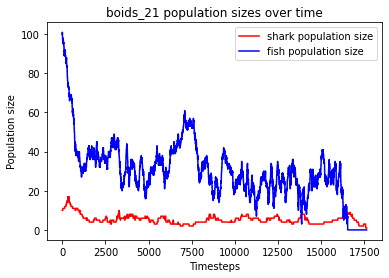

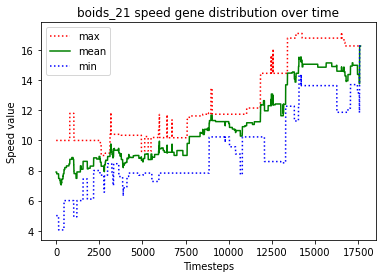

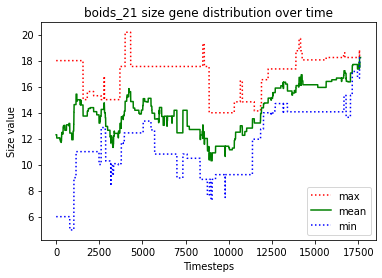

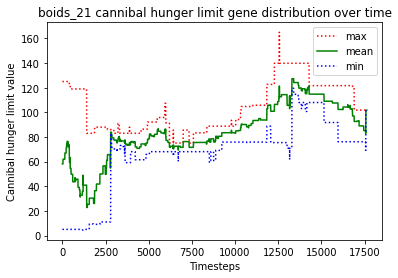

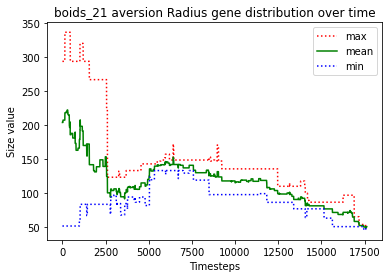

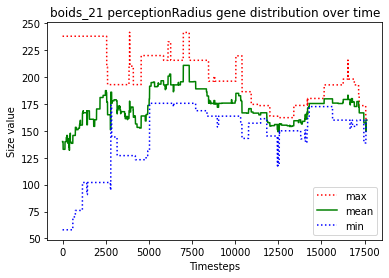

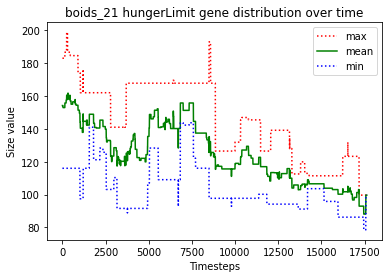





						BOIDS_22

predator_1 just gave birth to predator_10
predator_1 killed predator_10
predator_3 just gave birth to predator_11
predator_3 killed predator_8
predator_3 killed predator_9
predator_11 killed predator_7
predator_3 killed predator_4
predator_11 just gave birth to predator_12
predator_3 killed predator_0
predator_1 killed predator_2
predator_12 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_11 killed predator_5
predator_14 just gave birth to predator_15
predator_3 just gave birth to predator_16
predator_13 starved to death
predator_12 starved to death
predator_16 ate the carcass of predator_12_carcass
predator_1 starved to death
predator_11 ate the carcass of predator_13_carcass
predator_14 starved to death
predator_6 ate the carcass of predator_1_carcass
predator_11 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_16 ate the carcass of predator_14_carcass
predator_17 starved to death
predator_11 sta

predator_72 just gave birth to predator_75
predator_75 starved to death
predator_62 ate the carcass of predator_75_carcass
predator_72 starved to death
predator_43 ate the carcass of predator_71_carcass
predator_70 just gave birth to predator_76
predator_74 just gave birth to predator_77
predator_76 starved to death
predator_70 starved to death
predator_68 ate the carcass of predator_76_carcass
predator_62 ate the carcass of predator_70_carcass
predator_77 starved to death
predator_68 ate the carcass of predator_77_carcass
predator_74 just gave birth to predator_78
predator_74 starved to death
predator_78 starved to death
predator_43 ate the carcass of predator_74_carcass
predator_43 ate the carcass of predator_78_carcass
predator_73 ate the carcass of predator_72_carcass
predator_62 starved to death
predator_68 starved to death
predator_73 ate the carcass of predator_68_carcass
predator_73 just gave birth to predator_79
predator_73 ate the carcass of predator_62_carcass
predator_73 ju

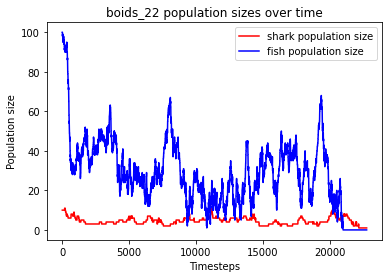

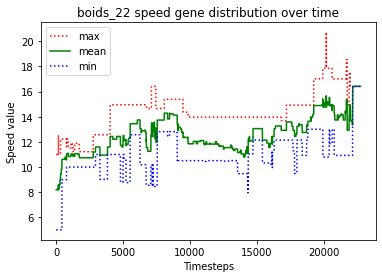

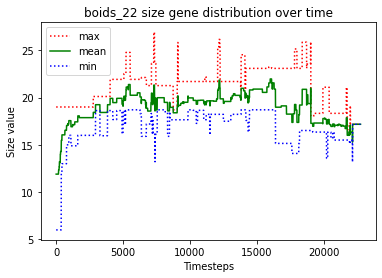

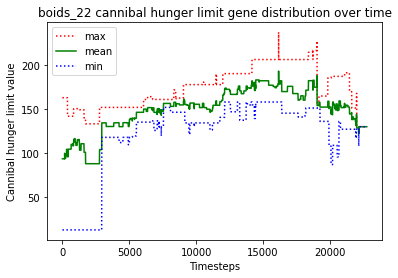

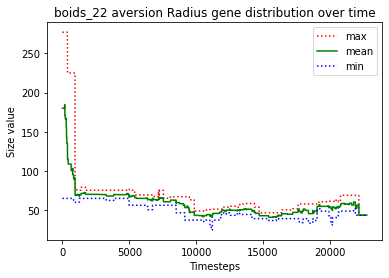

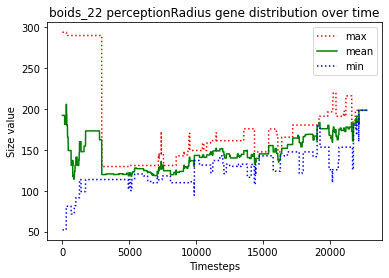

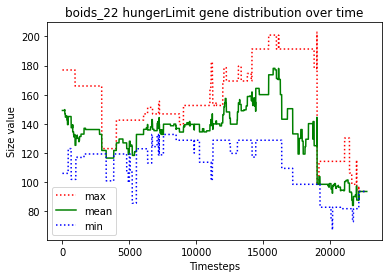





						BOIDS_23

predator_6 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_13 killed predator_6
predator_4 killed predator_10
predator_11 just gave birth to predator_15
predator_4 killed predator_12
predator_9 killed predator_7
predator_15 starved to death
predator_4 ate the carcass of predator_15_carcass
predator_11 starved to death
predator_5 ate the carcass of predator_11_carcass
predator_0 starved to death
predator_13 ate the carcass of predator_0_carcass
predator_5 just gave birth to predator_16
predator_1 killed predator_3
predator_14 starved to death
predator_4 ate the carcass of predator_14_carcass
predator_16 starved to death
predator_13 ate the carcass of predator_16_carcass
predator_5 starved to death
predator_9 ate the carcass of predator_5_carcass
predator_1 just gave birth to predator_17
predator_17 killed pred

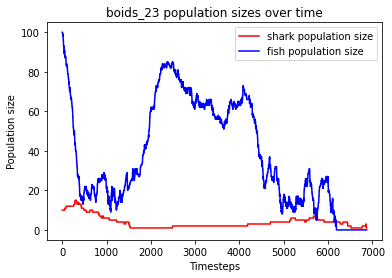

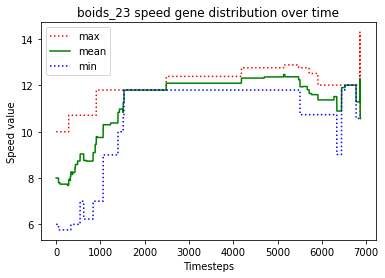

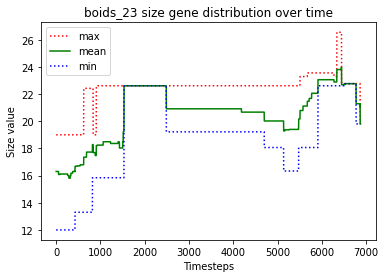

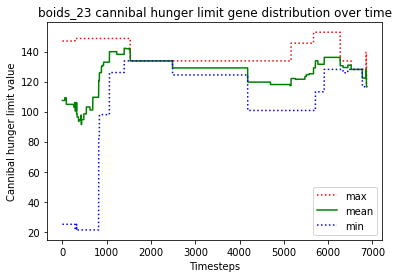

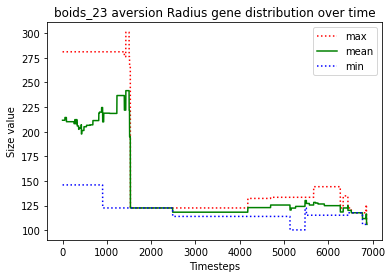

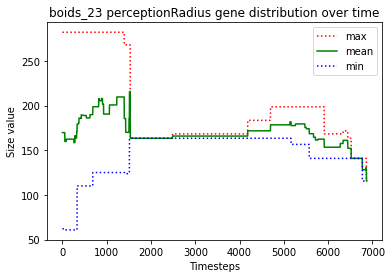

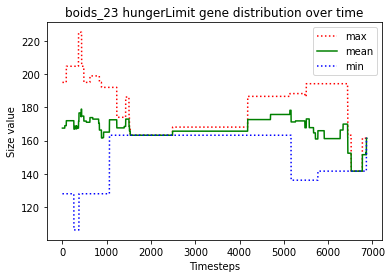





						BOIDS_24

predator_3 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_2 killed predator_3
predator_12 killed predator_6
predator_12 killed predator_10
predator_1 just gave birth to predator_14
predator_12 killed predator_4
predator_12 killed predator_11
predator_1 just gave birth to predator_15
predator_12 killed predator_5
predator_9 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_12 just gave birth to predator_18
predator_13 starved to death
predator_12 ate the carcass of predator_13_carcass
predator_7 starved to death
predator_16 just gave birth to predator_19
predator_18 killed predator_15
predator_0 ate the carcass of predator_7_carcass
predator_1 just gave birth to predator_20
predator_8 starved to death
predator_12 killed predator_16
predator_18 killed predator_9
predator_14 just gave birth to predator_21
predator_19 st

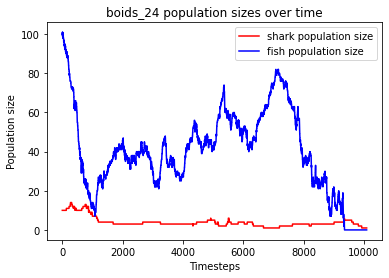

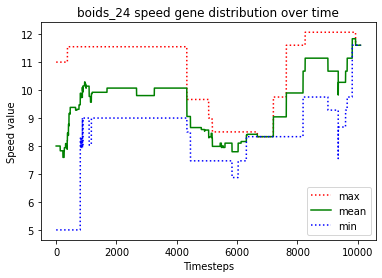

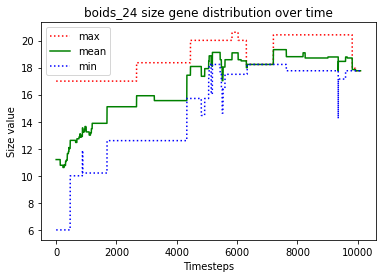

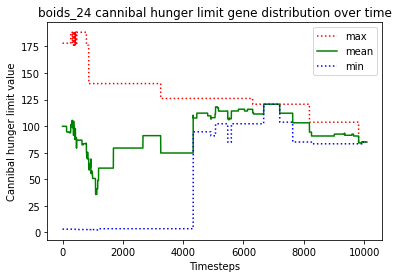

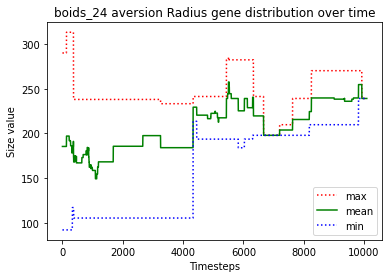

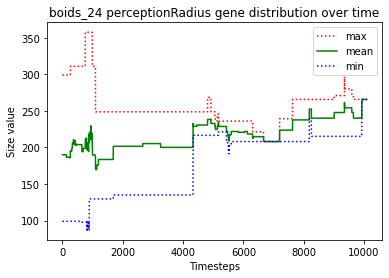

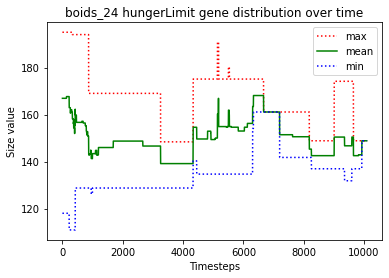





						BOIDS_25

predator_1 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_1 starved to death
predator_8 just gave birth to predator_12
predator_5 ate the carcass of predator_1_carcass
predator_10 starved to death
predator_9 killed predator_11
predator_3 just gave birth to predator_13
predator_4 ate the carcass of predator_10_carcass
predator_7 starved to death
predator_6 ate the carcass of predator_7_carcass
predator_6 just gave birth to predator_14
predator_9 killed predator_5
predator_13 starved to death
predator_3 ate the carcass of predator_13_carcass
predator_2 just gave birth to predator_15
predator_6 killed predator_14
predator_15 just gave birth to predator_16
predator_16 starved to death
predator_15 starved to death
predator_6 just gave birth to predator_17
predator_12 starved to death
predator_17 starved to death
predator_6 ate the carcass of predator_17_carcass
predator_8 ate the carcass of predator_15_carcass
predator_8 ate the carcass

predator_43 ate the carcass of predator_63_carcass
predator_54 just gave birth to predator_72
predator_68 starved to death
predator_70 ate the carcass of predator_68_carcass
predator_43 just gave birth to predator_73
predator_71 starved to death
predator_65 ate the carcass of predator_71_carcass
predator_70 just gave birth to predator_74
predator_74 killed predator_54
predator_66 starved to death
predator_34 ate the carcass of predator_66_carcass
predator_43 just gave birth to predator_75
predator_73 just gave birth to predator_76
predator_65 just gave birth to predator_77
predator_70 starved to death
predator_73 starved to death
predator_76 ate the carcass of predator_73_carcass
predator_34 just gave birth to predator_78
predator_74 starved to death
predator_72 starved to death
predator_43 just gave birth to predator_79
predator_76 ate the carcass of predator_74_carcass
predator_75 starved to death
predator_34 ate the carcass of predator_72_carcass
predator_77 ate the carcass of preda

predator_130 ate the carcass of predator_122_carcass
predator_78 just gave birth to predator_131
no fish to move
predator_125 starved to death
predator_101 just gave birth to predator_132
predator_130 ate the carcass of predator_125_carcass
predator_124 starved to death
predator_127 starved to death
predator_126 just gave birth to predator_133
predator_126 killed predator_133
predator_101 ate the carcass of predator_127_carcass
predator_102 ate the carcass of predator_124_carcass
predator_116 starved to death
predator_132 just gave birth to predator_134
predator_134 starved to death
predator_132 starved to death
predator_123 starved to death
predator_128 ate the carcass of predator_132_carcass
predator_83 ate the carcass of predator_123_carcass
predator_128 ate the carcass of predator_134_carcass
predator_129 just gave birth to predator_135
predator_78 ate the carcass of predator_116_carcass
predator_101 just gave birth to predator_136
predator_101 starved to death
predator_136 ate the

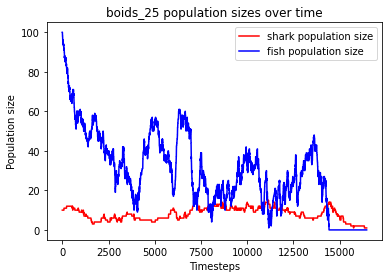

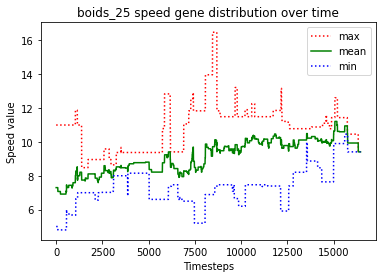

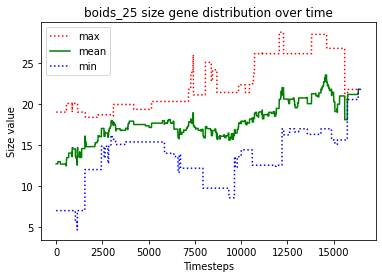

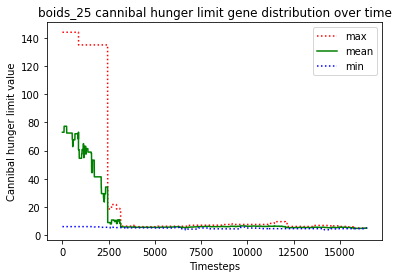

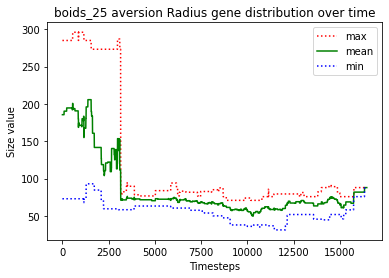

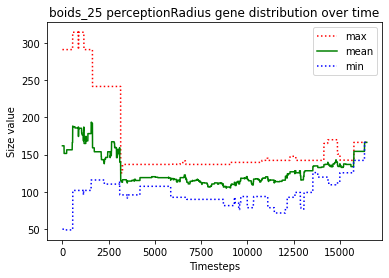

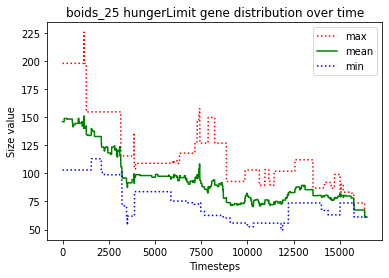





						BOIDS_26

predator_4 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_0 killed predator_11
predator_6 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_6 killed predator_5
predator_4 just gave birth to predator_14
predator_4 killed predator_3
predator_12 killed predator_2
predator_8 just gave birth to predator_15
predator_14 starved to death
predator_4 ate the carcass of predator_14_carcass
predator_6 killed predator_13
predator_10 starved to death
predator_0 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_7 ate the carcass of predator_0_carcass
predator_1 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_16 killed predator_15
predator_12 starved to death
predator_17 starved to death
predator_1 ate the carcass of predator_12_carcass
predator_4 ate the carcass of predator_17_carcass
predator_8 just gave birth to predator_18
predator_16 killed predator_6


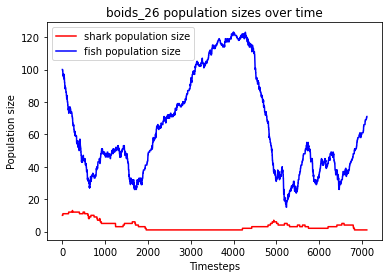

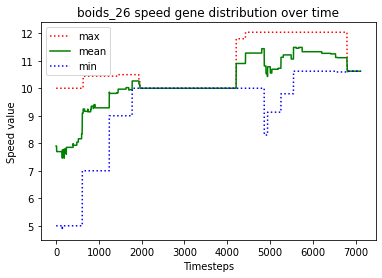

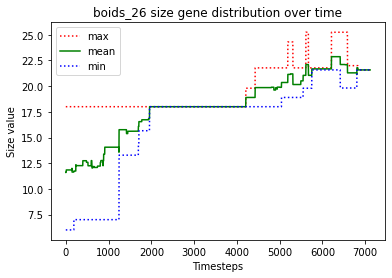

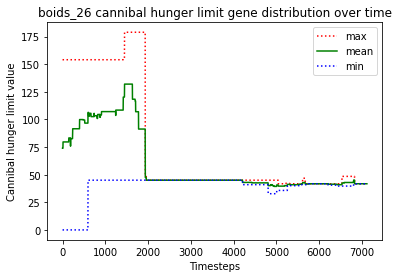

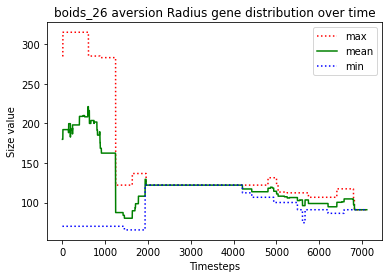

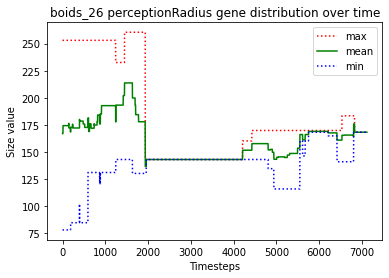

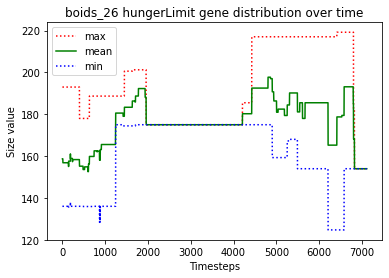





						BOIDS_27

predator_0 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_0 killed predator_5
predator_4 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_12 just gave birth to predator_15
predator_15 starved to death
predator_12 ate the carcass of predator_15_carcass
predator_12 starved to death
predator_4 just gave birth to predator_16
predator_0 ate the carcass of predator_12_carcass
predator_4 just gave birth to predator_17
predator_8 just gave birth to predator_18
predator_8 killed predator_18
predator_17 killed predator_9
predator_1 just gave birth to predator_19
no fish to move
predator_17 killed predator_11
predator_0 starved to death
predator_8 ate the carcass of predator_0_carcass
predator_17 killed predator_14
predator_3 starved to death
predator_13 ate the carcass of predator_3_carcas

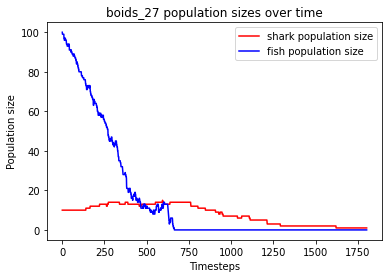

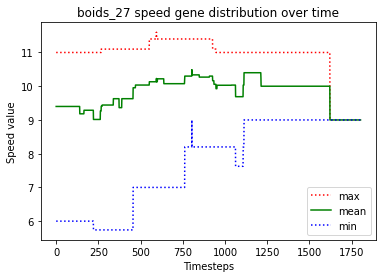

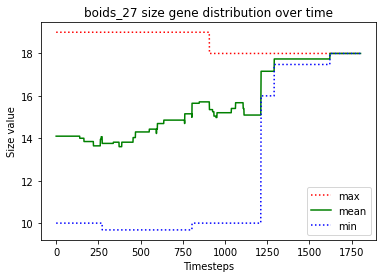

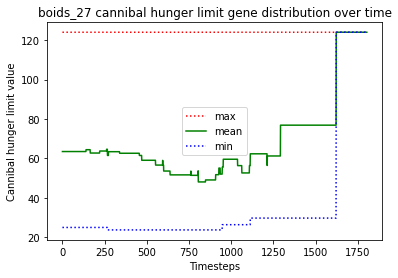

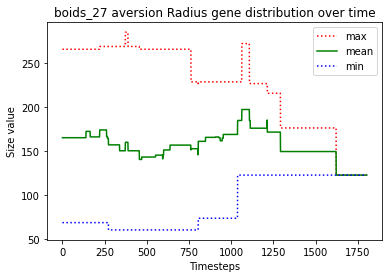

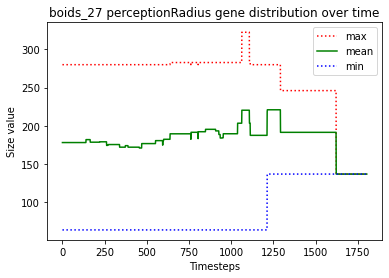

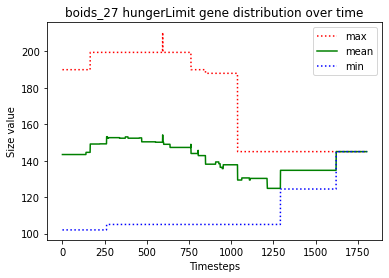





						BOIDS_28

predator_5 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_13 just gave birth to predator_15
predator_13 starved to death
predator_15 ate the carcass of predator_13_carcass
predator_10 just gave birth to predator_16
predator_2 just gave birth to predator_17
predator_14 starved to death
predator_16 ate the carcass of predator_14_carcass
predator_1 starved to death
predator_8 just gave birth to predator_18
predator_11 just gave birth to predator_19
predator_11 ate the carcass of predator_1_carcass
predator_15 starved to death
predator_11 ate the carcass of predator_15_carcass
predator_19 just gave birth to predator_20
predator_11 just gave birth to predator_21
predator_7 just gave birth to predator_22
predator_19 starved to death
predator_20 ate the carcass of predator_19_carcass
predator_7 just gave birth to 

predator_64 just gave birth to predator_68
predator_65 just gave birth to predator_69
predator_52 just gave birth to predator_70
predator_69 starved to death
predator_65 starved to death
predator_64 ate the carcass of predator_69_carcass
predator_64 ate the carcass of predator_65_carcass
predator_68 just gave birth to predator_71
predator_52 killed predator_68
predator_52 killed predator_71
predator_52 starved to death
predator_66 ate the carcass of predator_52_carcass
predator_64 just gave birth to predator_72
predator_70 just gave birth to predator_73
predator_66 just gave birth to predator_74
predator_72 just gave birth to predator_75
predator_64 starved to death
predator_75 ate the carcass of predator_64_carcass
no fish to move
predator_75 killed predator_74
predator_72 starved to death
predator_75 ate the carcass of predator_72_carcass
predator_73 just gave birth to predator_76
predator_76 killed predator_66
predator_73 starved to death
predator_75 starved to death
predator_76 sta

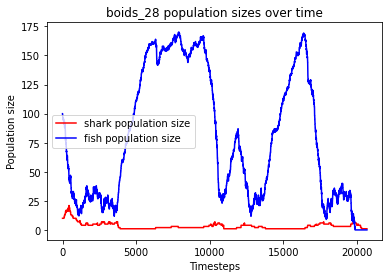

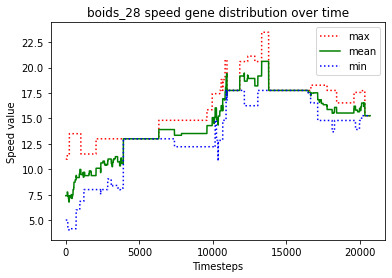

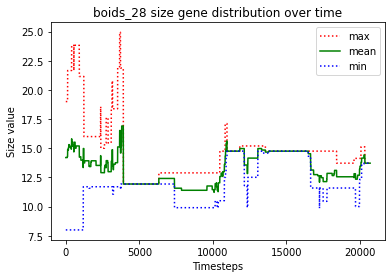

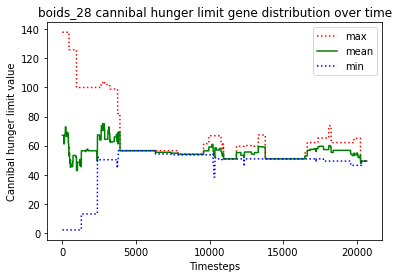

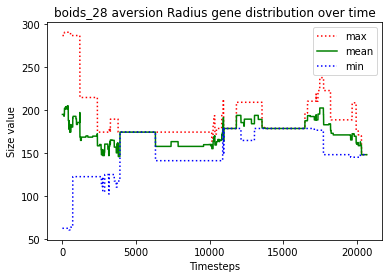

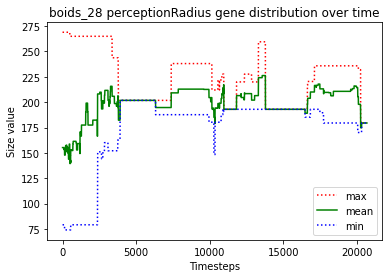

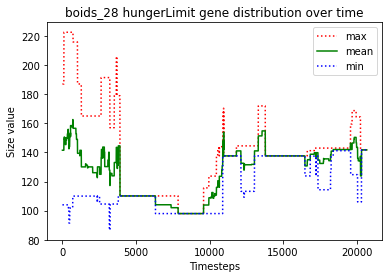





						BOIDS_29

predator_3 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_3 killed predator_0
predator_12 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_5 just gave birth to predator_15
predator_15 just gave birth to predator_16
predator_5 killed predator_8
predator_1 just gave birth to predator_17
predator_10 killed predator_12
predator_13 starved to death
predator_10 ate the carcass of predator_13_carcass
predator_16 just gave birth to predator_18
predator_14 starved to death
predator_2 just gave birth to predator_19
predator_15 starved to death
predator_3 ate the carcass of predator_15_carcass
predator_16 ate the carcass of predator_14_carcass
predator_18 starved to death
predator_11 ate the carcass of predator_18_carcass
predator_16 just gave birth to predator_20
predator_10 killed predator_19
predator_4 just gave birth to predator_21
predator_16 starved to death
pre

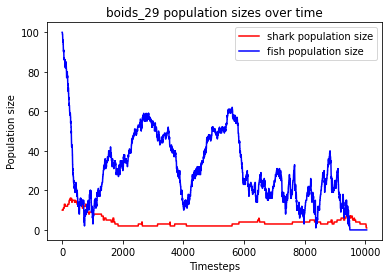

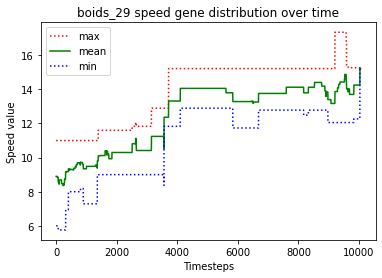

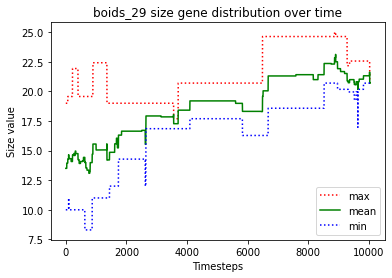

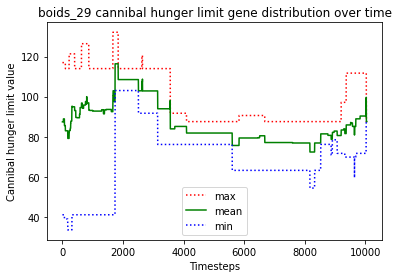

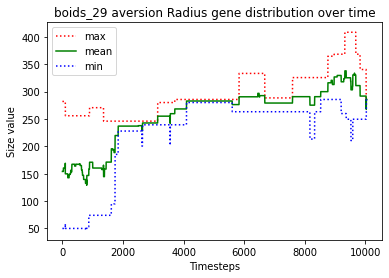

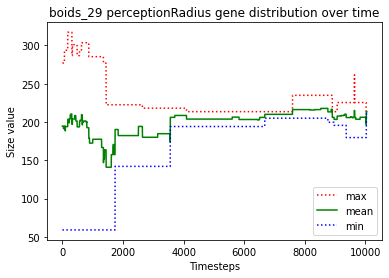

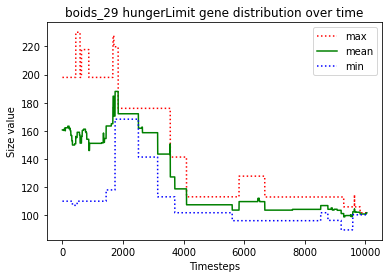





						BOIDS_30

predator_9 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_11 killed predator_7
predator_12 starved to death
predator_10 ate the carcass of predator_12_carcass
predator_13 just gave birth to predator_14
predator_2 just gave birth to predator_15
predator_13 killed predator_4
predator_11 starved to death
predator_10 ate the carcass of predator_11_carcass
predator_2 just gave birth to predator_16
predator_2 just gave birth to predator_17
predator_2 starved to death
predator_13 ate the carcass of predator_2_carcass
predator_16 starved to death
predator_17 starved to death
predator_8 ate the carcass of predator_16_carcass
predator_10 starved to death
predator_15 ate the carcass of predator_10_carcass
predator_14 starved to death
predator_15 ate the carcass of predator_14_carcass
predator_8 ate the carcass of predator_17_carcass
predator_15 just gave bir

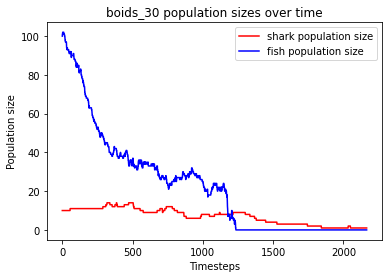

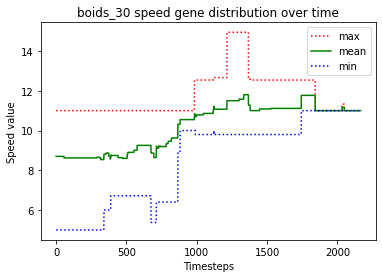

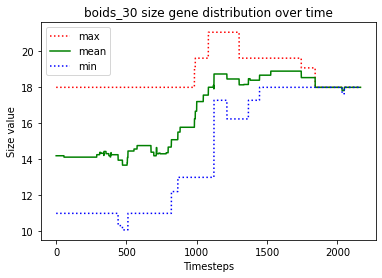

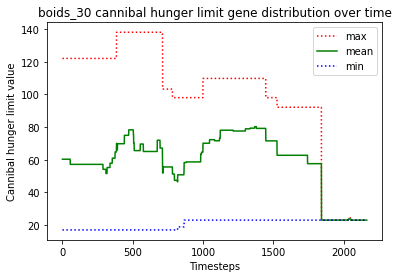

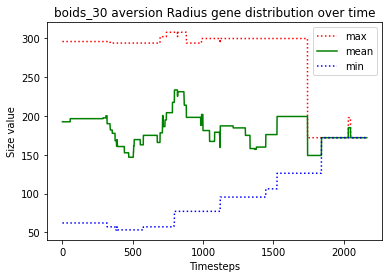

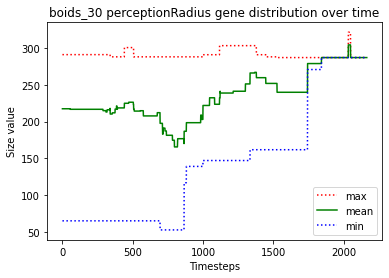

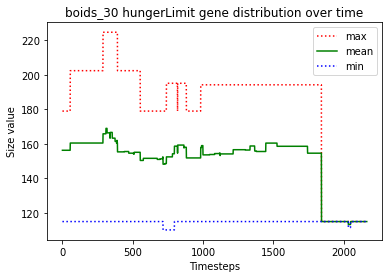





						BOIDS_31

predator_2 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_12 starved to death
predator_10 starved to death
predator_13 starved to death
predator_14 ate the carcass of predator_12_carcass
predator_2 ate the carcass of predator_13_carcass
predator_5 ate the carcass of predator_10_carcass
predator_4 starved to death
predator_14 just gave birth to predator_15
predator_14 ate the carcass of predator_4_carcass
predator_2 starved to death
predator_7 ate the carcass of predator_2_carcass
predator_8 just gave birth to predator_16
predator_9 just gave birth to predator_17
predator_7 just gave birth to predator_18
predator_7 killed predator_18
predator_9 just gave birth to predator_19
predator_14 just gave birth to predator_20
predator_17 killed predator_8
predator_9 killed predator_16
predator_6 just gave birth to pr

predator_69 just gave birth to predator_71
predator_66 starved to death
predator_64 ate the carcass of predator_66_carcass
predator_70 just gave birth to predator_72
predator_72 just gave birth to predator_73
predator_73 killed predator_70
predator_71 starved to death
predator_69 just gave birth to predator_74
no fish to move
predator_64 starved to death
predator_73 ate the carcass of predator_64_carcass
predator_69 ate the carcass of predator_71_carcass
predator_69 just gave birth to predator_75
predator_73 starved to death
predator_75 ate the carcass of predator_73_carcass
predator_72 starved to death
predator_75 ate the carcass of predator_72_carcass
predator_74 starved to death
predator_69 starved to death
predator_75 ate the carcass of predator_74_carcass
predator_75 ate the carcass of predator_69_carcass
predator_75 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 76
Timesteps passed: 11661
Fish went extinct at timestep 

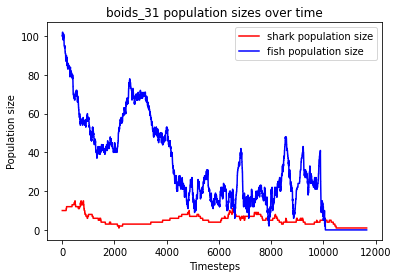

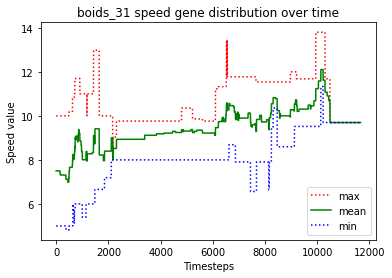

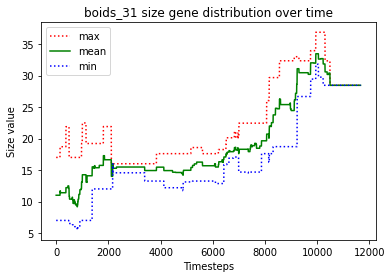

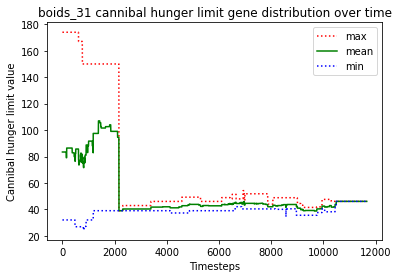

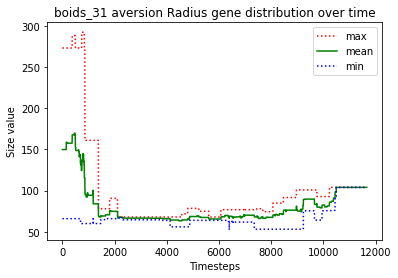

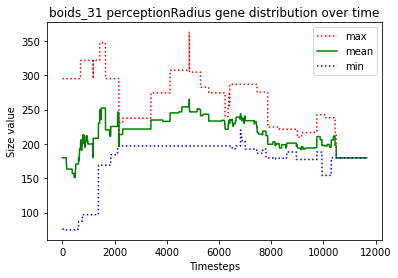

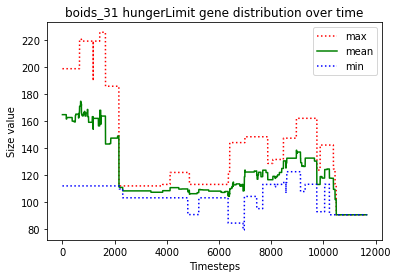





						BOIDS_32

predator_5 just gave birth to predator_10
predator_5 killed predator_7
predator_5 killed predator_0
predator_2 killed predator_3
predator_5 killed predator_4
predator_5 killed predator_9
predator_2 killed predator_6
predator_10 just gave birth to predator_11
predator_10 killed predator_11
predator_5 just gave birth to predator_12
predator_10 starved to death
predator_8 just gave birth to predator_13
predator_5 ate the carcass of predator_10_carcass
predator_2 just gave birth to predator_14
predator_12 just gave birth to predator_15
predator_15 starved to death
predator_14 ate the carcass of predator_15_carcass
predator_12 starved to death
predator_2 ate the carcass of predator_12_carcass
predator_14 just gave birth to predator_16
predator_8 starved to death
predator_5 ate the carcass of predator_8_carcass
predator_13 starved to death
predator_2 ate the carcass of predator_13_carcass
predator_2 just gave birth to predator_17
predator_5 starved to death
predator_14 ju

predator_62 just gave birth to predator_66
predator_62 just gave birth to predator_67
predator_66 just gave birth to predator_68
predator_62 just gave birth to predator_69
no fish to move
predator_68 starved to death
predator_69 starved to death
predator_67 ate the carcass of predator_69_carcass
predator_62 starved to death
predator_66 ate the carcass of predator_62_carcass
predator_66 ate the carcass of predator_68_carcass
predator_66 just gave birth to predator_70
predator_66 starved to death
predator_70 starved to death
predator_67 ate the carcass of predator_70_carcass
predator_67 ate the carcass of predator_66_carcass
predator_67 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 71
Timesteps passed: 28278
Fish went extinct at timestep 27786
Sharks went extinct at timestep 28278


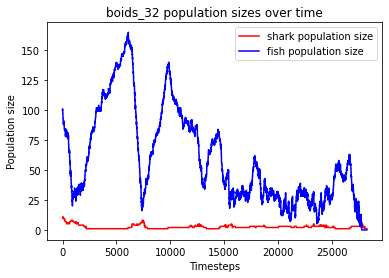

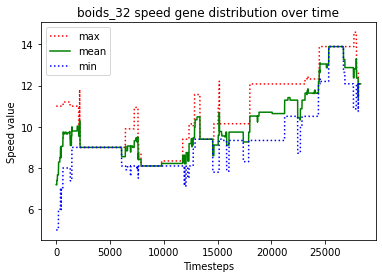

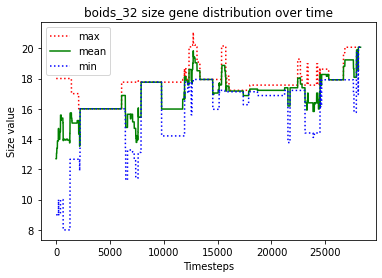

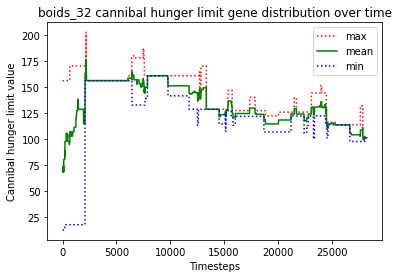

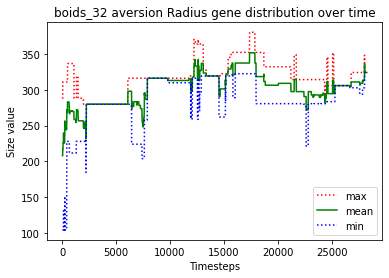

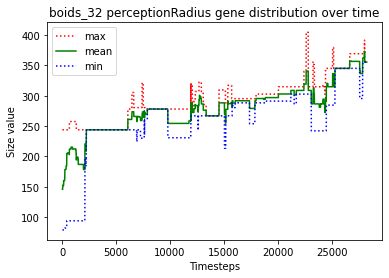

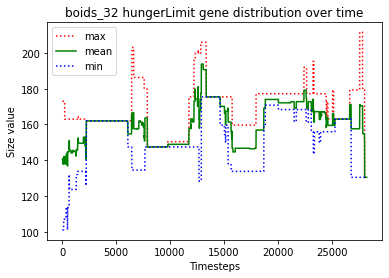





						BOIDS_33

predator_1 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_12 starved to death
predator_4 ate the carcass of predator_12_carcass
predator_11 starved to death
predator_5 ate the carcass of predator_11_carcass
predator_6 just gave birth to predator_13
predator_13 starved to death
predator_6 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_9 ate the carcass of predator_6_carcass
predator_10 just gave birth to predator_14
predator_10 starved to death
predator_14 starved to death
predator_0 ate the carcass of predator_10_carcass
predator_7 ate the carcass of predator_14_carcass
predator_0 starved to death
predator_2 ate the carcass of predator_0_carcass
predator_3 just gave birth to predator_15
predator_2 starved to death
predator_9 just gave birth to predator_16
predator_5 ate the carcass of predator_2_carcass
predator_4 just gave birth to predator_17
predator_3 starv

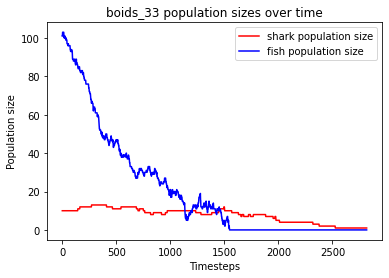

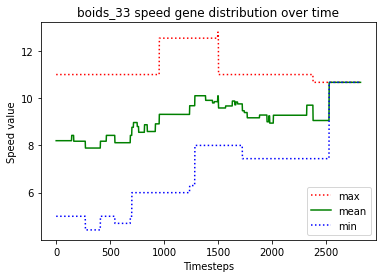

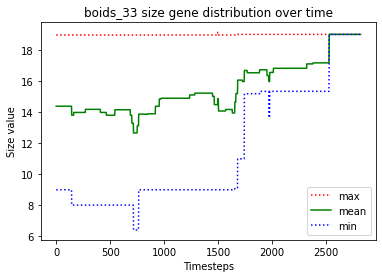

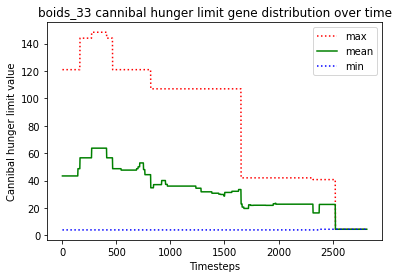

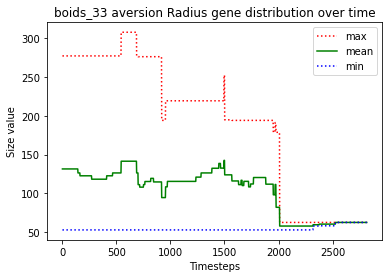

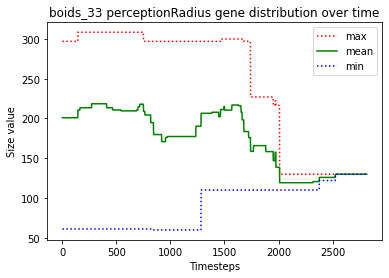

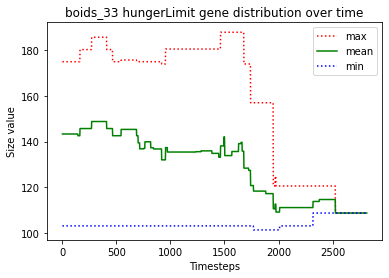





						BOIDS_34

predator_0 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_14 killed predator_2
predator_10 just gave birth to predator_15
predator_12 starved to death
predator_8 killed predator_6
predator_3 ate the carcass of predator_12_carcass
predator_14 killed predator_7
predator_0 starved to death
predator_14 ate the carcass of predator_0_carcass
predator_15 starved to death
predator_13 starved to death
predator_10 starved to death
predator_3 ate the carcass of predator_10_carcass
predator_5 just gave birth to predator_16
predator_5 killed predator_16
predator_14 ate the carcass of predator_15_carcass
predator_3 ate the carcass of predator_13_carcass
predator_8 killed predator_1
predator_5 starved to death
predator_3 ate the carcass of predator_5_carcass
predator_11 just gave birth to predator_17
predator_9 just gave b

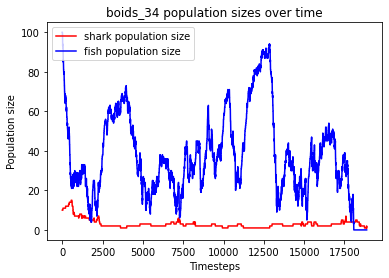

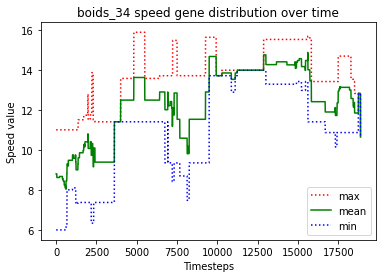

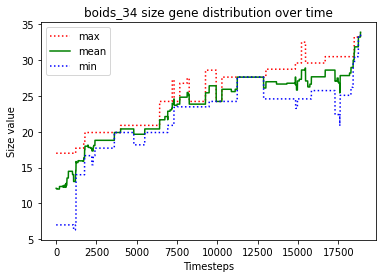

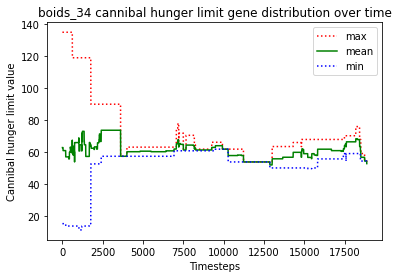

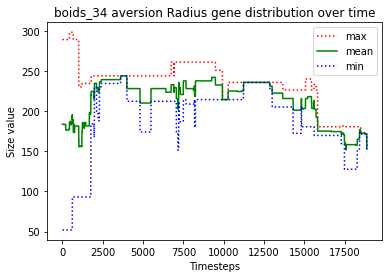

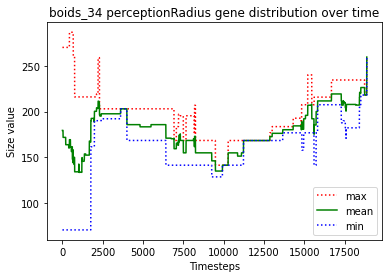

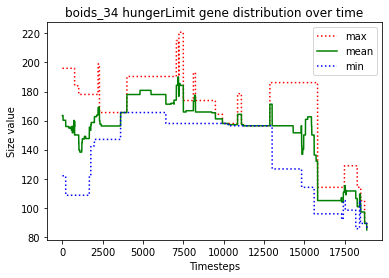





						BOIDS_35

predator_4 just gave birth to predator_10
predator_4 killed predator_5
predator_4 killed predator_1
predator_2 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_9 killed predator_12
predator_11 starved to death
predator_6 ate the carcass of predator_11_carcass
predator_6 just gave birth to predator_13
predator_6 starved to death
predator_13 ate the carcass of predator_6_carcass
predator_9 just gave birth to predator_14
predator_2 starved to death
predator_4 just gave birth to predator_15
predator_14 starved to death
predator_7 ate the carcass of predator_14_carcass
predator_4 ate the carcass of predator_2_carcass
predator_13 starved to death
predator_15 ate the carcass of predator_13_carcass
predator_9 starved to death
predator_15 ate the carcass of predator_9_carcass
predator_7 just gave birth to predator_16
predator_10 starved to death
predator_16 just gave birth to predator_17
predator_16 killed predator_17
predator_15 starved to 

predator_58 starved to death
predator_66 ate the carcass of predator_49_carcass
predator_66 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 69
Timesteps passed: 22348
Fish went extinct at timestep 21520
Sharks went extinct at timestep 22348


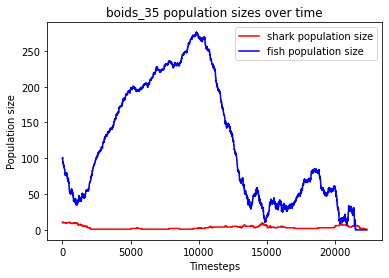

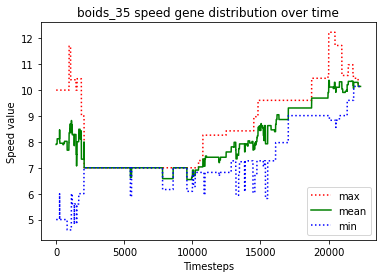

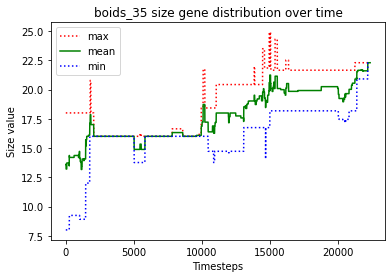

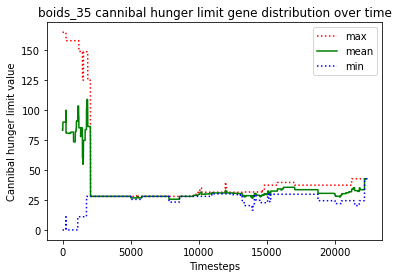

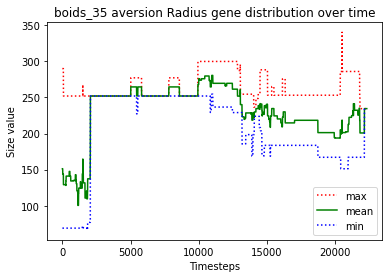

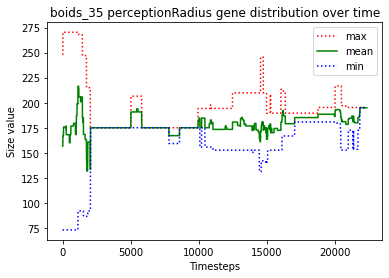

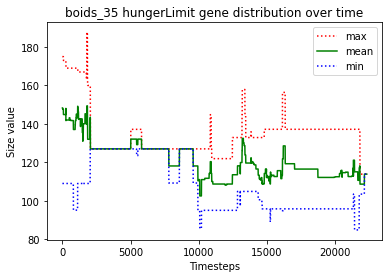





						BOIDS_36

predator_1 just gave birth to predator_10
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_1 starved to death
predator_9 ate the carcass of predator_1_carcass
predator_6 starved to death
predator_7 just gave birth to predator_11
predator_4 starved to death
predator_5 starved to death
predator_11 ate the carcass of predator_4_carcass
predator_11 ate the carcass of predator_6_carcass
predator_9 ate the carcass of predator_5_carcass
predator_8 just gave birth to predator_12
predator_8 killed predator_12
predator_2 just gave birth to predator_13
predator_13 starved to death
predator_2 starved to death
predator_7 ate the carcass of predator_2_carcass
predator_9 ate the carcass of predator_13_carcass
predator_7 just gave birth to predator_14
predator_14 killed predator_11
predator_9 just gave birth to predator_15
predator_15 just gave birth to predator_16
predator_7 just gave birth to predator_17
predator_8 starved to death
predator_

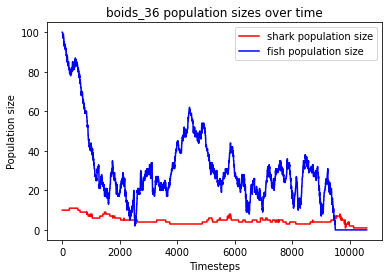

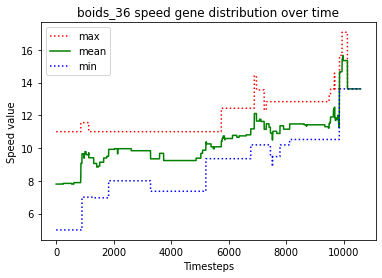

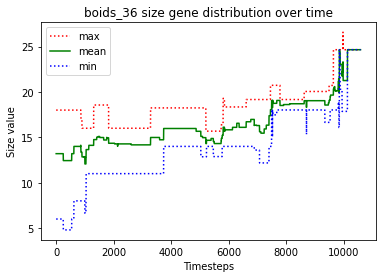

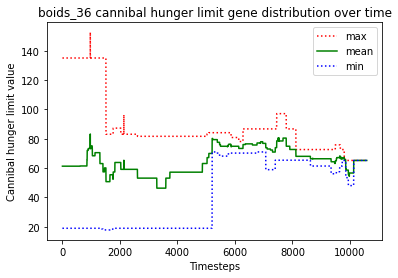

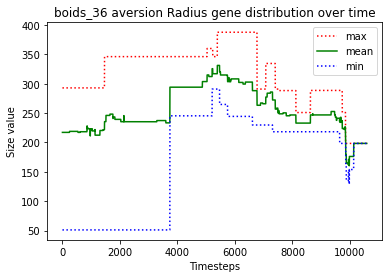

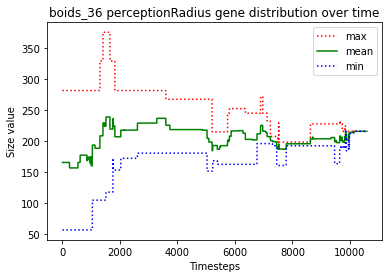

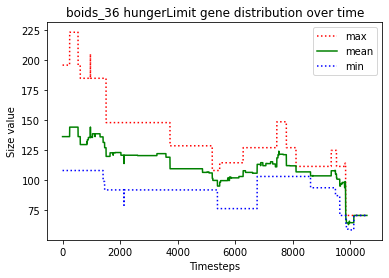





						BOIDS_37

predator_3 killed predator_9
predator_7 just gave birth to predator_10
predator_3 killed predator_1
predator_3 just gave birth to predator_11
predator_11 killed predator_4
predator_10 just gave birth to predator_12
predator_12 killed predator_6
predator_0 starved to death
predator_7 ate the carcass of predator_0_carcass
predator_5 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_5 starved to death
predator_14 starved to death
predator_13 starved to death
predator_12 ate the carcass of predator_13_carcass
predator_12 ate the carcass of predator_14_carcass
predator_11 ate the carcass of predator_5_carcass
predator_10 starved to death
predator_2 just gave birth to predator_15
predator_2 ate the carcass of predator_10_carcass
predator_15 killed predator_7
predator_2 just gave birth to predator_16
predator_2 starved to death
predator_16 starved to death
predator_8 ate the carcass of predator_2_carcass
predator_3 ate the carcass of predat

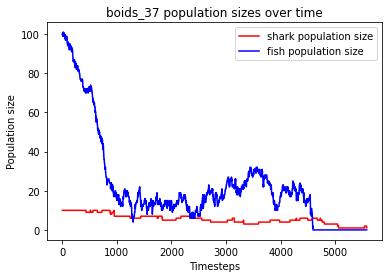

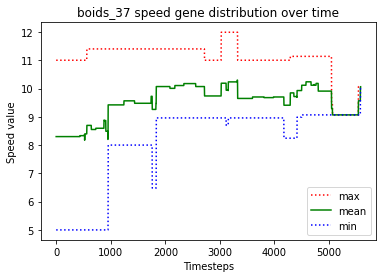

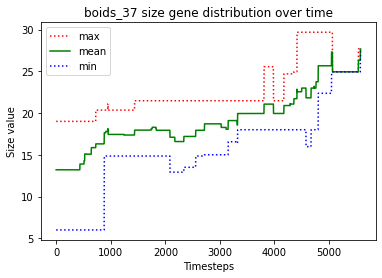

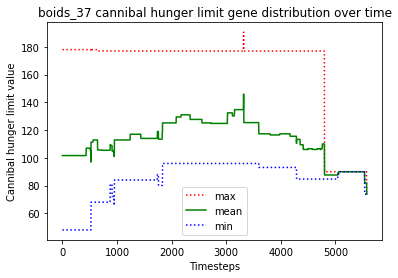

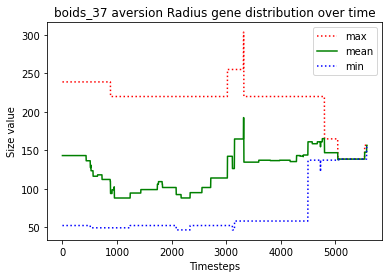

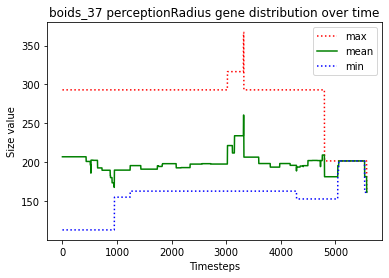

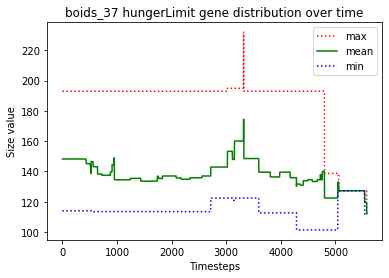





						BOIDS_38

predator_7 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_14 starved to death
predator_13 just gave birth to predator_15
predator_4 ate the carcass of predator_14_carcass
predator_13 just gave birth to predator_16
predator_13 killed predator_16
predator_6 killed predator_7
predator_15 starved to death
predator_10 ate the carcass of predator_15_carcass
predator_0 starved to death
predator_4 ate the carcass of predator_0_carcass
predator_6 killed predator_11
predator_9 just gave birth to predator_17
predator_2 starved to death
predator_10 starved to death
predator_6 ate the carcass of predator_10_carcass
predator_4 ate the carcass of predator_2_carcass
predator_6 just gave birth to predator_18
predator_9 just gave birth to predator_19
predator_19 killed predator_12
predator_1 starved to death
predator_6 ate th

predator_56 ate the carcass of predator_67_carcass
predator_64 ate the carcass of predator_63_carcass
predator_56 ate the carcass of predator_61_carcass
predator_64 just gave birth to predator_68
predator_68 just gave birth to predator_69
predator_69 just gave birth to predator_70
predator_70 starved to death
predator_56 ate the carcass of predator_70_carcass
predator_68 starved to death
predator_56 ate the carcass of predator_68_carcass
predator_65 starved to death
predator_56 ate the carcass of predator_65_carcass
predator_69 starved to death
predator_56 just gave birth to predator_71
predator_64 just gave birth to predator_72
predator_56 starved to death
predator_71 starved to death
predator_72 ate the carcass of predator_56_carcass
predator_64 ate the carcass of predator_71_carcass
predator_64 ate the carcass of predator_69_carcass
predator_72 just gave birth to predator_73
predator_73 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_75 just gave b

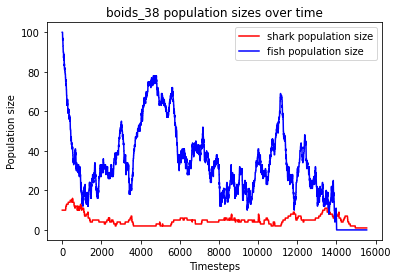

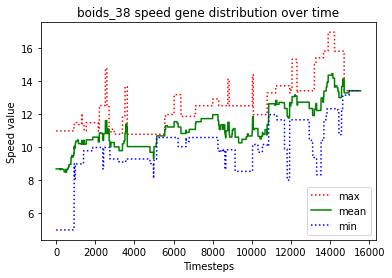

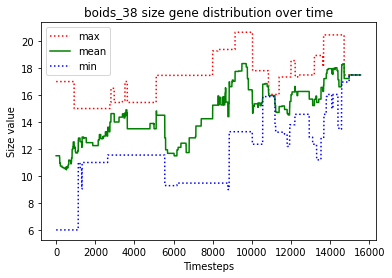

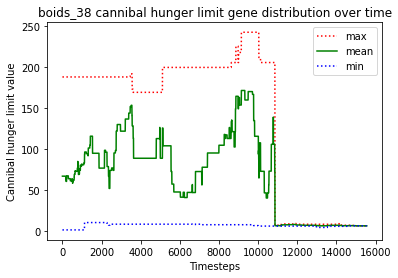

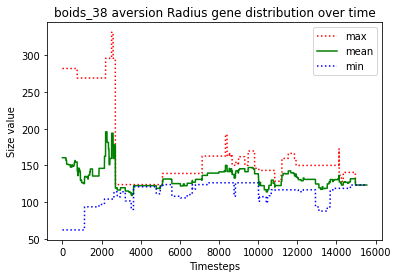

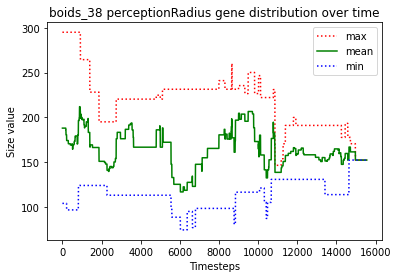

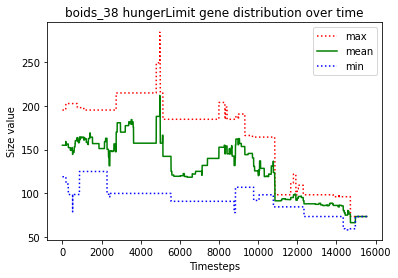





						BOIDS_39

predator_0 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_11 killed predator_12
predator_8 just gave birth to predator_13
predator_11 killed predator_4
predator_2 just gave birth to predator_14
predator_9 just gave birth to predator_15
predator_5 killed predator_15
predator_2 killed predator_8
predator_11 killed predator_9
predator_11 killed predator_1
predator_13 starved to death
predator_0 ate the carcass of predator_13_carcass
predator_10 just gave birth to predator_16
predator_7 just gave birth to predator_17
predator_2 starved to death
predator_10 ate the carcass of predator_2_carcass
predator_14 starved to death
predator_3 ate the carcass of predator_14_carcass
predator_6 just gave birth to predator_18
predator_0 starved to death
predator_11 ate the carcass of predator_0_carcass
predator_10 starved to death
predator_5 ate the carcass of predator_10_carcass
predator_18 starved to death

predator_58 starved to death
predator_47 ate the carcass of predator_58_carcass
predator_47 just gave birth to predator_70
predator_70 just gave birth to predator_71
predator_65 starved to death
predator_71 ate the carcass of predator_65_carcass
predator_55 just gave birth to predator_72
predator_47 starved to death
predator_70 starved to death
predator_55 ate the carcass of predator_70_carcass
predator_72 starved to death
predator_55 ate the carcass of predator_72_carcass
predator_71 just gave birth to predator_73
predator_55 ate the carcass of predator_47_carcass
predator_71 just gave birth to predator_74
predator_71 just gave birth to predator_75
predator_71 starved to death
predator_74 ate the carcass of predator_71_carcass
predator_73 starved to death
predator_74 ate the carcass of predator_73_carcass
predator_55 just gave birth to predator_76
predator_55 just gave birth to predator_77
predator_75 just gave birth to predator_78
predator_76 starved to death
predator_55 ate the carc

predator_129 starved to death
predator_128 starved to death
predator_126 just gave birth to predator_131
predator_126 starved to death
predator_131 ate the carcass of predator_127_carcass
predator_131 ate the carcass of predator_129_carcass
predator_131 ate the carcass of predator_120_carcass
predator_131 ate the carcass of predator_128_carcass
predator_131 just gave birth to predator_132
predator_131 ate the carcass of predator_126_carcass
predator_132 starved to death
predator_131 ate the carcass of predator_132_carcass
predator_131 ate the carcass of predator_130_carcass
predator_131 just gave birth to predator_133
predator_133 just gave birth to predator_134
predator_133 just gave birth to predator_135
predator_135 starved to death
predator_134 ate the carcass of predator_135_carcass
predator_134 just gave birth to predator_136
predator_133 just gave birth to predator_137
predator_133 just gave birth to predator_138
predator_138 starved to death
predator_131 just gave birth to pred

predator_189 just gave birth to predator_191
predator_169 starved to death
predator_179 ate the carcass of predator_169_carcass
predator_188 starved to death
predator_189 starved to death
predator_191 starved to death
predator_179 ate the carcass of predator_191_carcass
predator_161 ate the carcass of predator_189_carcass
predator_179 just gave birth to predator_192
predator_161 ate the carcass of predator_188_carcass
predator_192 just gave birth to predator_193
predator_179 just gave birth to predator_194
predator_193 starved to death
predator_194 starved to death
predator_192 just gave birth to predator_195
predator_195 just gave birth to predator_196
predator_196 just gave birth to predator_197
predator_197 starved to death
predator_195 ate the carcass of predator_197_carcass
predator_161 just gave birth to predator_198
predator_198 ate the carcass of predator_193_carcass
predator_195 just gave birth to predator_199
predator_192 just gave birth to predator_200
predator_196 ate the c

predator_245 just gave birth to predator_248
predator_241 just gave birth to predator_249
predator_248 just gave birth to predator_250
predator_248 killed predator_250
predator_245 killed predator_249
predator_248 killed predator_241
predator_248 just gave birth to predator_251
predator_248 just gave birth to predator_252
predator_248 just gave birth to predator_253
predator_252 starved to death
predator_251 ate the carcass of predator_252_carcass
predator_245 starved to death
predator_251 just gave birth to predator_254
predator_251 ate the carcass of predator_245_carcass
predator_254 starved to death
predator_251 ate the carcass of predator_254_carcass
predator_248 starved to death
predator_251 ate the carcass of predator_248_carcass
predator_251 just gave birth to predator_255
predator_255 starved to death
predator_251 ate the carcass of predator_255_carcass
predator_253 just gave birth to predator_256
predator_251 just gave birth to predator_257
predator_251 just gave birth to pred

predator_288 just gave birth to predator_313
predator_311 starved to death
predator_288 just gave birth to predator_314
predator_312 just gave birth to predator_315
predator_315 starved to death
predator_312 starved to death
predator_283 ate the carcass of predator_315_carcass
predator_288 ate the carcass of predator_311_carcass
predator_314 ate the carcass of predator_312_carcass
predator_310 just gave birth to predator_316
predator_314 just gave birth to predator_317
predator_313 starved to death
predator_303 just gave birth to predator_318
predator_316 ate the carcass of predator_313_carcass
predator_317 starved to death
predator_288 ate the carcass of predator_317_carcass
predator_314 starved to death
predator_283 ate the carcass of predator_314_carcass
predator_303 just gave birth to predator_319
predator_293 just gave birth to predator_320
no fish to move
predator_310 just gave birth to predator_321
predator_320 killed predator_318
predator_288 killed predator_316
predator_320 ju

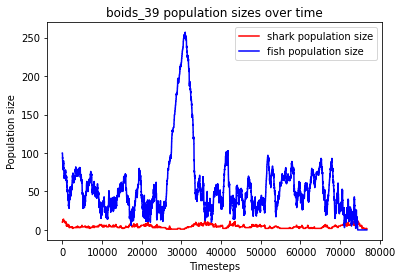

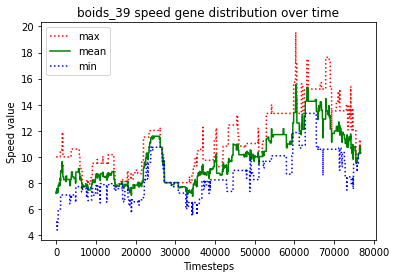

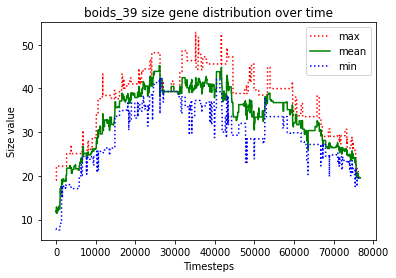

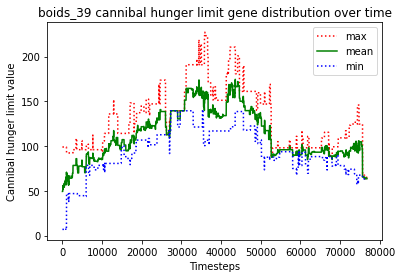

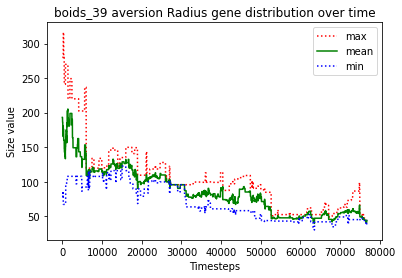

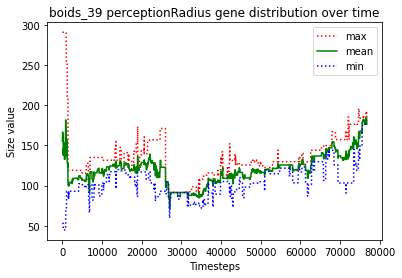

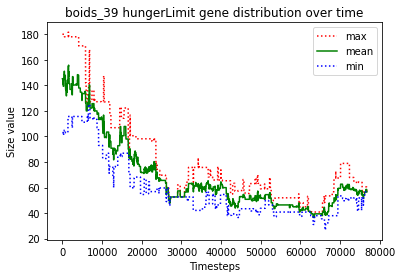





						BOIDS_40

predator_4 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_4 starved to death
predator_14 ate the carcass of predator_4_carcass
predator_14 killed predator_8
predator_11 starved to death
predator_10 starved to death
predator_13 killed predator_5
predator_9 starved to death
predator_14 starved to death
predator_12 ate the carcass of predator_9_carcass
predator_6 just gave birth to predator_15
predator_13 ate the carcass of predator_14_carcass
predator_3 ate the carcass of predator_11_carcass
predator_12 just gave birth to predator_16
predator_3 ate the carcass of predator_10_carcass
predator_16 killed predator_1
predator_12 just gave birth to predator_17
predator_16 starved to death
predator_12 starved to death
predator_17 starved to death
predator_13 ate the carcass of predator_16_carcass
predator_7 ate the c

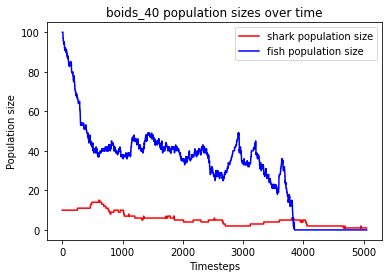

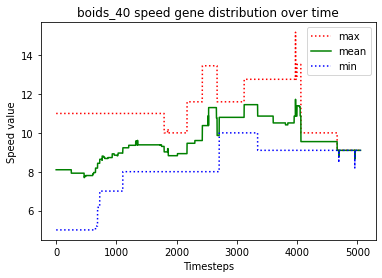

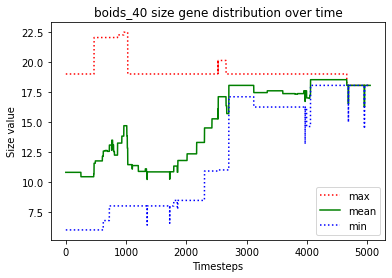

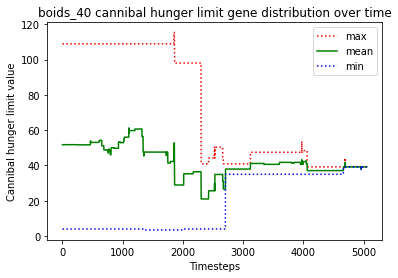

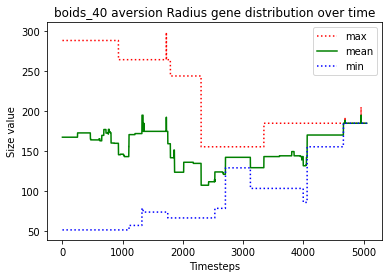

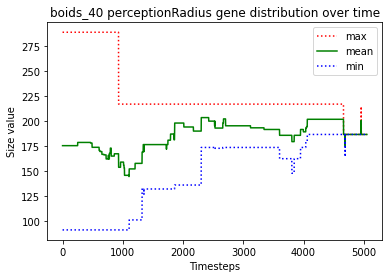

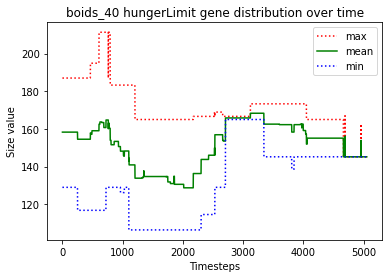





						BOIDS_41

predator_9 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_5 just gave birth to predator_16
predator_9 just gave birth to predator_17
predator_17 just gave birth to predator_18
predator_12 just gave birth to predator_19
predator_10 just gave birth to predator_20
predator_15 just gave birth to predator_21
predator_14 starved to death
predator_19 ate the carcass of predator_14_carcass
predator_7 starved to death
predator_9 ate the carcass of predator_7_carcass
predator_11 starved to death
predator_12 ate the carcass of predator_11_carcass
predator_16 starved to death
predator_15 ate the carcass of predator_16_carcass
predator_6 just gave birth to predator_22
predator_6 killed predator_22
predator_21 starved to death
predator_5 just gave birth to predator_23
predator_5

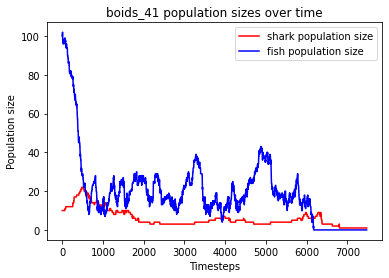

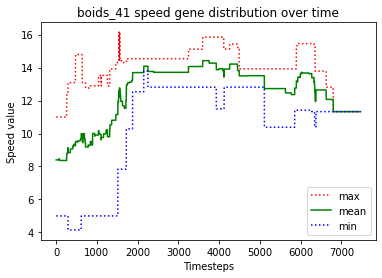

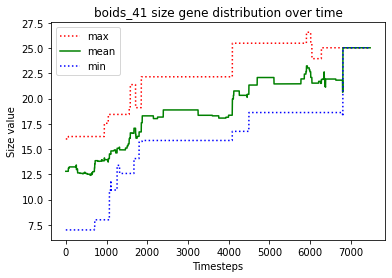

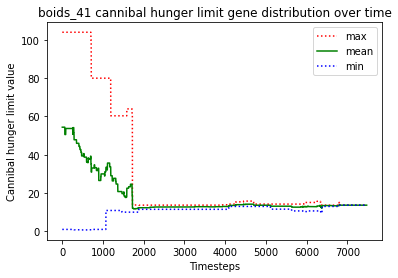

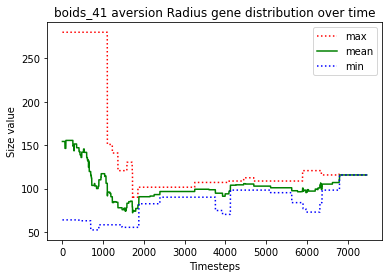

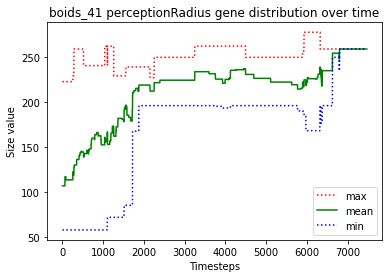

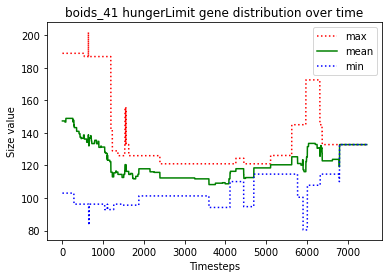





						BOIDS_42

predator_0 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_13 starved to death
predator_12 ate the carcass of predator_13_carcass
predator_10 starved to death
predator_5 just gave birth to predator_15
predator_14 ate the carcass of predator_10_carcass
predator_0 starved to death
predator_12 starved to death
predator_14 ate the carcass of predator_12_carcass
predator_1 just gave birth to predator_16
predator_2 starved to death
predator_8 ate the carcass of predator_0_carcass
predator_16 ate the carcass of predator_2_carcass
predator_14 starved to death
predator_3 ate the carcass of predator_14_carcass
predator_7 just gave birth to predator_17
predator_5 starved to death
predator_17 starved to death
predator_7 starved to death
predator_3 ate the carcass of predator_17_carcass
predator_9 ate the carcass of pre

predator_67 just gave birth to predator_68
predator_67 starved to death
predator_68 starved to death
predator_57 just gave birth to predator_69
predator_44 ate the carcass of predator_68_carcass
predator_64 ate the carcass of predator_67_carcass
predator_66 starved to death
predator_64 just gave birth to predator_70
predator_57 ate the carcass of predator_66_carcass
predator_57 just gave birth to predator_71
predator_44 just gave birth to predator_72
predator_44 starved to death
predator_72 starved to death
predator_57 ate the carcass of predator_72_carcass
predator_57 ate the carcass of predator_44_carcass
predator_71 starved to death
predator_69 just gave birth to predator_73
predator_70 starved to death
predator_64 ate the carcass of predator_70_carcass
predator_57 ate the carcass of predator_71_carcass
predator_64 just gave birth to predator_74
predator_64 killed predator_74
predator_57 just gave birth to predator_75
predator_64 starved to death
predator_75 starved to death
predato

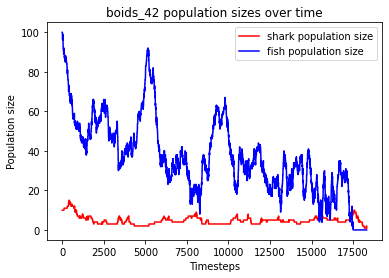

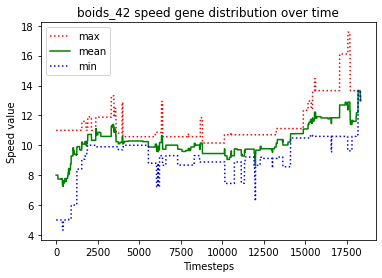

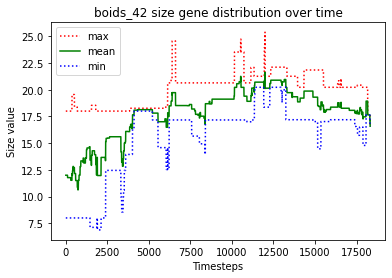

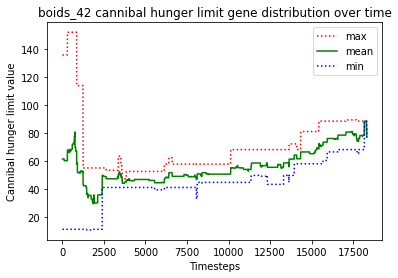

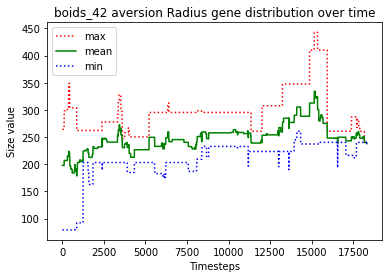

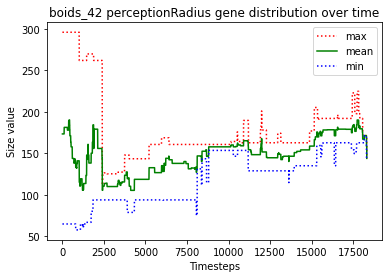

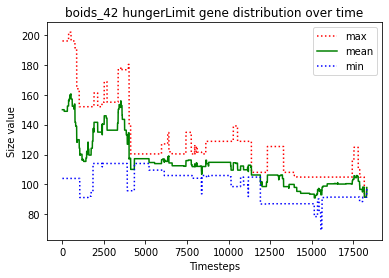





						BOIDS_43

predator_2 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_12 starved to death
predator_6 ate the carcass of predator_12_carcass
predator_3 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_6 starved to death
predator_5 ate the carcass of predator_6_carcass
predator_11 starved to death
predator_5 ate the carcass of predator_11_carcass
predator_2 starved to death
predator_7 ate the carcass of predator_2_carcass
predator_7 just gave birth to predator_15
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_5 just gave birth to predator_16
predator_14 starved to death
predator_0 ate the carcass of predator_14_carcass
predator_13 starved to death
predator_4 starved to death
predator_9 ate the carcass of predator_4_carcass
predator_15 ate the carcass of predator_13_carcass
predator_3 starved to death
predator_16 just gave birth to 

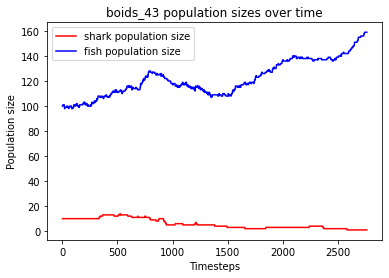

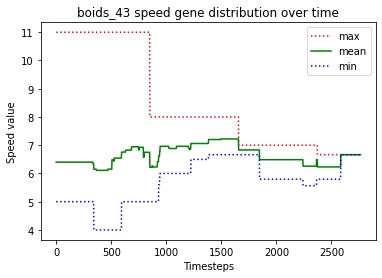

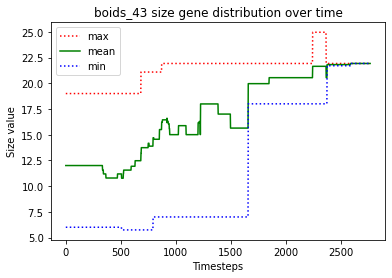

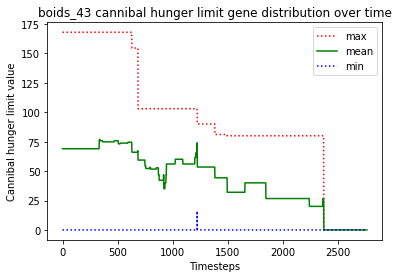

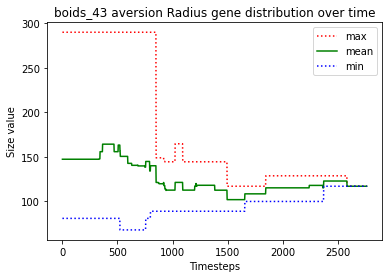

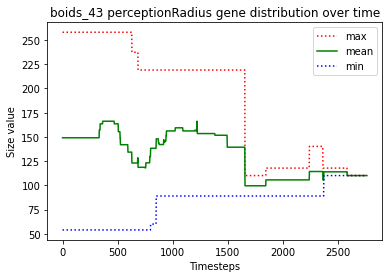

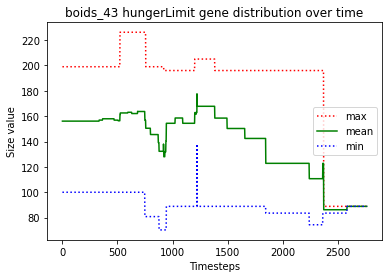





						BOIDS_44

predator_1 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_11 killed predator_9
predator_0 just gave birth to predator_12
predator_10 killed predator_2
predator_4 just gave birth to predator_13
predator_1 just gave birth to predator_14
predator_1 starved to death
predator_14 starved to death
predator_11 ate the carcass of predator_14_carcass
predator_11 ate the carcass of predator_1_carcass
predator_13 starved to death
predator_4 ate the carcass of predator_13_carcass
predator_12 just gave birth to predator_15
predator_12 killed predator_15
predator_10 starved to death
predator_8 ate the carcass of predator_10_carcass
predator_6 just gave birth to predator_16
predator_11 just gave birth to predator_17
predator_0 just gave birth to predator_18
predator_4 just gave birth to predator_19
predator_4 killed predator_19
predator_12 starved to death
predator_6 just gave birth to predator_20
predator_8 just gave birth to predator_21
predator

predator_67 starved to death
predator_54 starved to death
predator_65 ate the carcass of predator_67_carcass
predator_65 ate the carcass of predator_54_carcass
predator_65 just gave birth to predator_68
predator_65 just gave birth to predator_69
predator_68 just gave birth to predator_70
predator_70 just gave birth to predator_71
predator_65 just gave birth to predator_72
predator_70 starved to death
predator_69 ate the carcass of predator_70_carcass
predator_72 just gave birth to predator_73
predator_71 starved to death
predator_68 ate the carcass of predator_71_carcass
predator_73 starved to death
predator_69 ate the carcass of predator_73_carcass
predator_68 just gave birth to predator_74
predator_72 starved to death
predator_68 starved to death
predator_69 ate the carcass of predator_68_carcass
predator_69 ate the carcass of predator_72_carcass
predator_65 starved to death
predator_69 ate the carcass of predator_65_carcass
predator_74 starved to death
predator_69 ate the carcass of

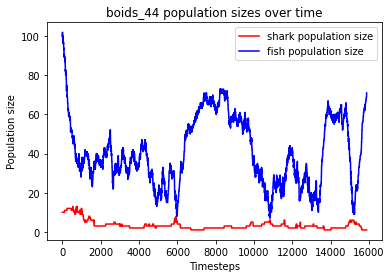

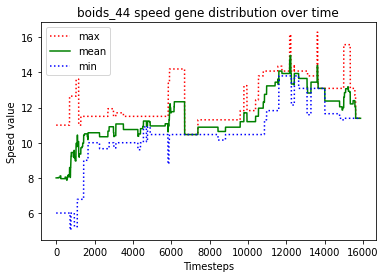

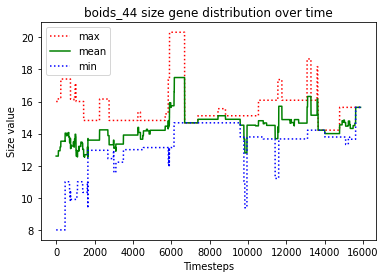

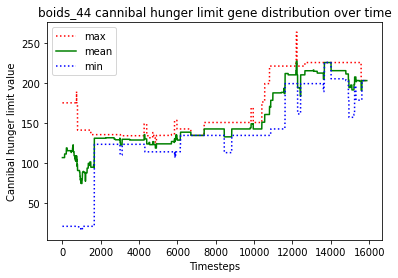

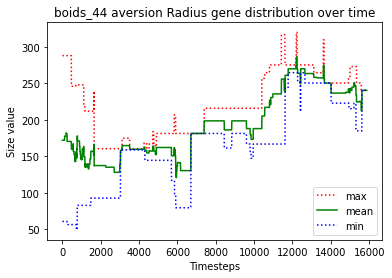

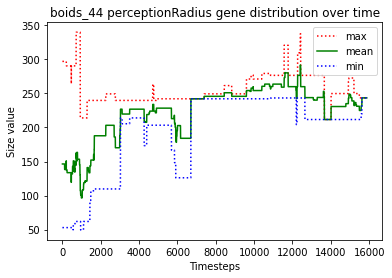

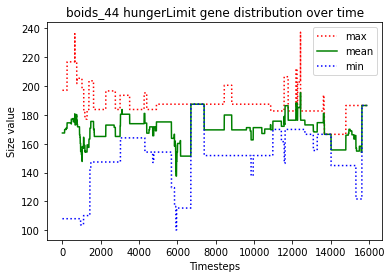





						BOIDS_45

predator_7 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_8 killed predator_13
predator_11 killed predator_5
predator_11 starved to death
predator_2 ate the carcass of predator_11_carcass
predator_12 starved to death
predator_10 ate the carcass of predator_12_carcass
predator_0 just gave birth to predator_14
predator_7 just gave birth to predator_15
predator_7 killed predator_15
predator_8 starved to death
predator_6 ate the carcass of predator_8_carcass
predator_7 killed predator_6
predator_0 just gave birth to predator_16
predator_2 killed predator_4
predator_7 starved to death
predator_14 ate the carcass of predator_7_carcass
predator_0 just gave birth to predator_17
predator_1 starved to death
predator_0 ate the carcass of predator_1_carcass
predator_17 starved to death
predator_14 ate the carcass of predator_17_carcass
predator_3 starved to de

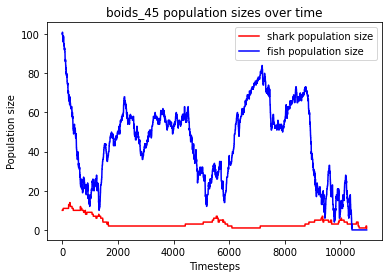

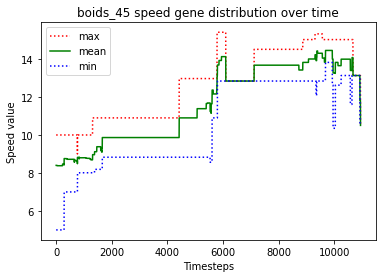

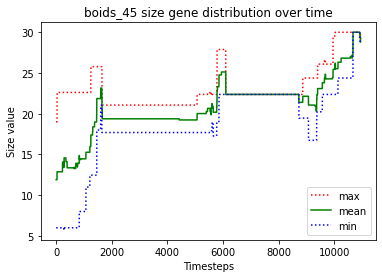

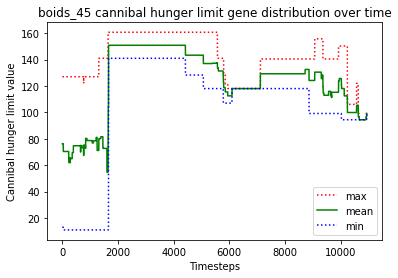

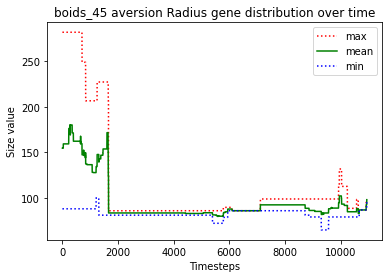

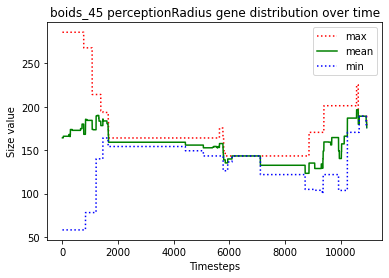

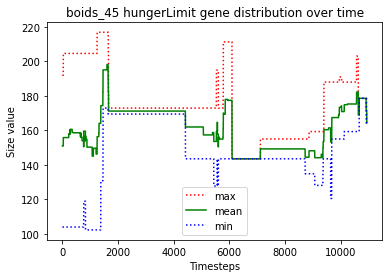





						BOIDS_46

predator_4 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_2 killed predator_1
predator_12 just gave birth to predator_15
predator_12 killed predator_5
predator_15 starved to death
predator_12 ate the carcass of predator_15_carcass
predator_12 killed predator_10
predator_9 just gave birth to predator_16
predator_2 starved to death
predator_11 ate the carcass of predator_2_carcass
predator_12 killed predator_14
predator_12 killed predator_3
predator_7 just gave birth to predator_17
predator_11 killed predator_4
predator_12 killed predator_0
predator_12 just gave birth to predator_18
predator_13 starved to death
predator_12 ate the carcass of predator_13_carcass
predator_18 starved to death
predator_6 ate the carcass of predator_18_carcass
predator_11 killed predator_7
predator_12 starved to death
predator_11 a

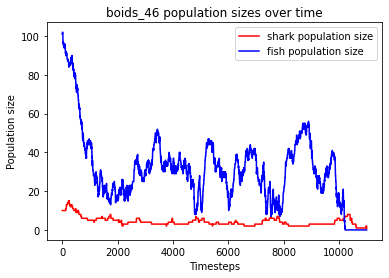

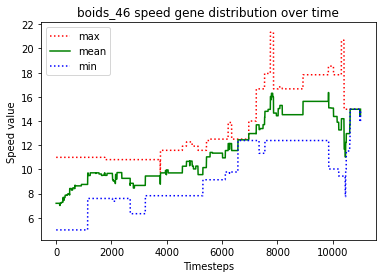

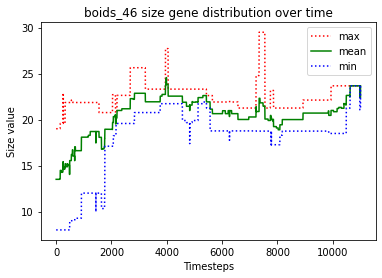

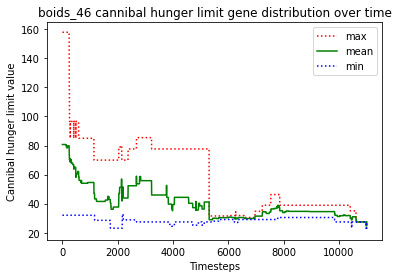

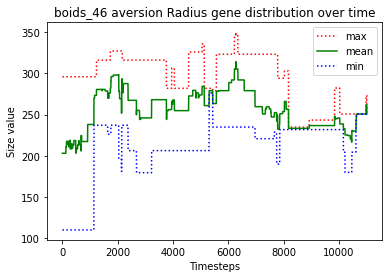

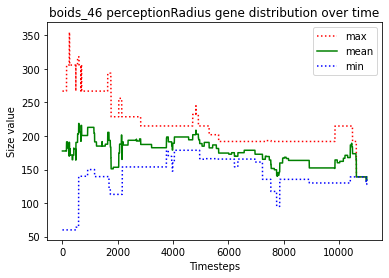

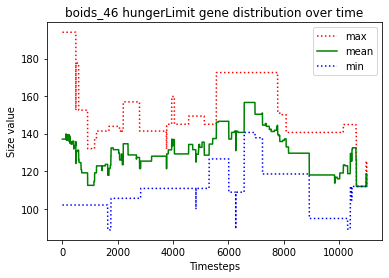





						BOIDS_47

predator_2 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_11 starved to death
predator_13 ate the carcass of predator_11_carcass
predator_10 starved to death
predator_8 ate the carcass of predator_10_carcass
predator_4 just gave birth to predator_14
predator_4 killed predator_2
predator_14 killed predator_1
predator_4 killed predator_5
predator_9 starved to death
predator_3 ate the carcass of predator_9_carcass
predator_4 killed predator_8
predator_14 killed predator_13
predator_12 starved to death
predator_14 killed predator_6
predator_7 just gave birth to predator_15
predator_0 starved to death
predator_7 ate the carcass of predator_12_carcass
predator_4 killed predator_15
predator_14 killed predator_7
predator_14 ate the carcass of predator_0_carcass
predator_14 killed predator_3
predator_4 just gave birth to predator_16
predator_16 starved to de

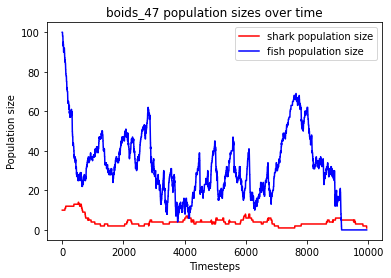

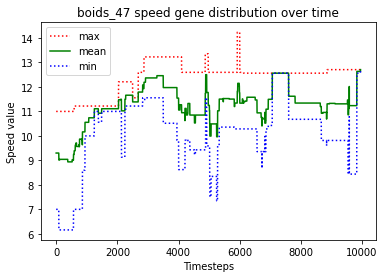

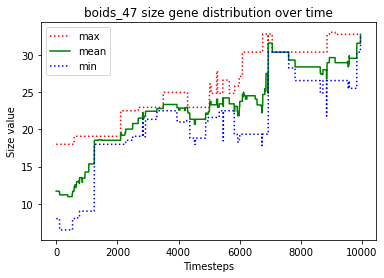

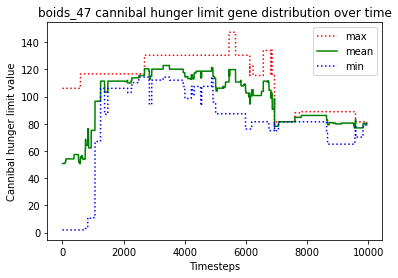

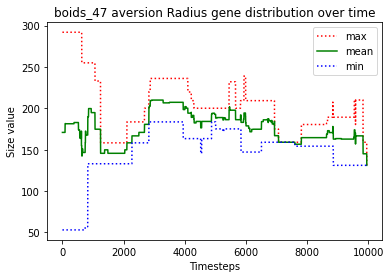

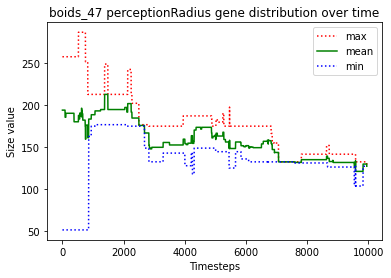

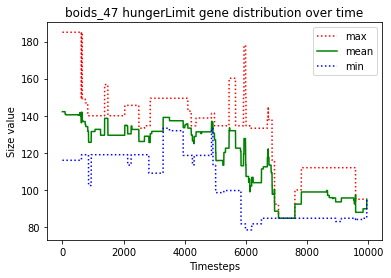





						BOIDS_48

predator_3 just gave birth to predator_10
predator_10 killed predator_8
predator_10 killed predator_9
predator_7 just gave birth to predator_11
predator_7 killed predator_11
predator_5 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_7 killed predator_2
predator_1 just gave birth to predator_14
predator_5 just gave birth to predator_15
predator_13 just gave birth to predator_16
predator_15 starved to death
predator_10 ate the carcass of predator_15_carcass
predator_7 just gave birth to predator_17
predator_13 starved to death
predator_1 just gave birth to predator_18
predator_16 ate the carcass of predator_13_carcass
predator_7 starved to death
predator_17 starved to death
predator_3 ate the carcass of predator_7_carcass
predator_6 starved to death
predator_16 starved to death
predator_3 ate the carcass of predator_17_carcass
predator_12 ate the carcass of predator_16_carcass
predator_1 just gave birth to predator_19
predator_19 star

predator_49 just gave birth to predator_69
predator_67 starved to death
predator_69 ate the carcass of predator_67_carcass
predator_49 just gave birth to predator_70
predator_49 ate the carcass of predator_65_carcass
predator_57 starved to death
predator_70 ate the carcass of predator_57_carcass
predator_69 just gave birth to predator_71
predator_62 just gave birth to predator_72
predator_69 just gave birth to predator_73
predator_69 just gave birth to predator_74
predator_62 just gave birth to predator_75
predator_69 starved to death
predator_74 starved to death
predator_73 ate the carcass of predator_69_carcass
predator_73 ate the carcass of predator_74_carcass
predator_62 starved to death
predator_49 ate the carcass of predator_62_carcass
predator_72 starved to death
predator_75 starved to death
predator_49 ate the carcass of predator_75_carcass
predator_73 ate the carcass of predator_72_carcass
predator_71 killed predator_55
predator_73 just gave birth to predator_76
predator_73 ju

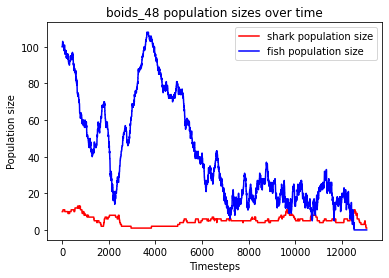

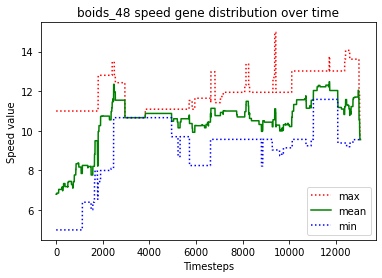

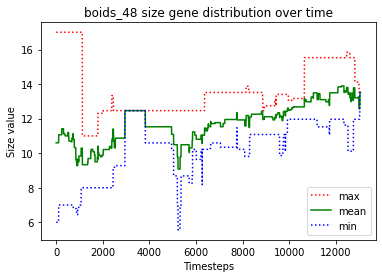

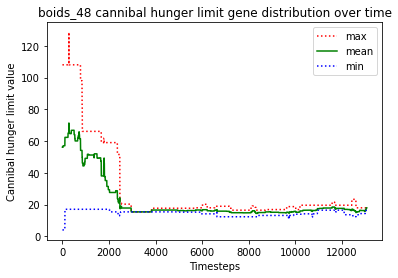

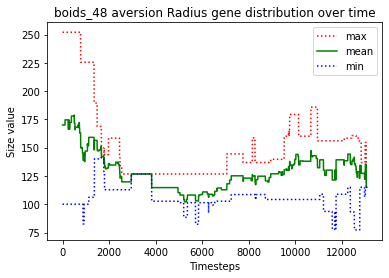

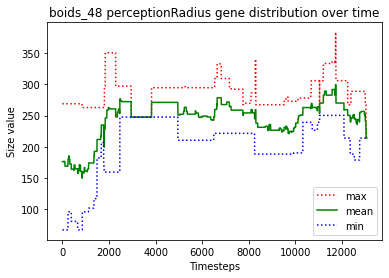

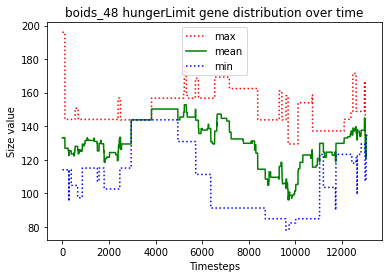





						BOIDS_49

predator_9 just gave birth to predator_10
predator_6 killed predator_5
predator_2 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_4 killed predator_7
predator_11 just gave birth to predator_16
predator_3 just gave birth to predator_17
predator_10 starved to death
predator_4 ate the carcass of predator_10_carcass
predator_4 just gave birth to predator_18
predator_6 killed predator_16
predator_4 killed predator_18
predator_17 starved to death
predator_3 starved to death
predator_0 ate the carcass of predator_17_carcass
predator_4 ate the carcass of predator_3_carcass
predator_8 starved to death
predator_11 starved to death
predator_12 ate the carcass of predator_8_carcass
predator_15 starved to death
predator_14 starved to death
predator_6 ate the carcass of predator_14_carcass
predator_4 ate the carcass of pr

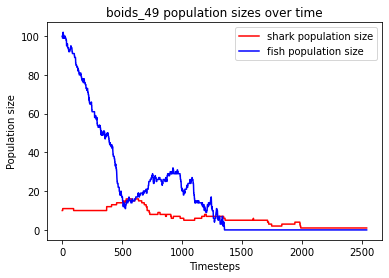

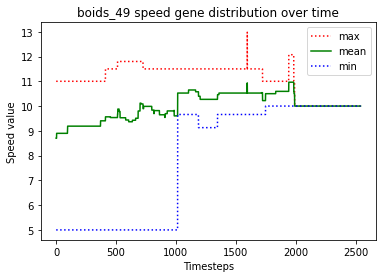

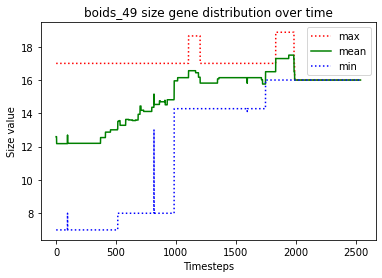

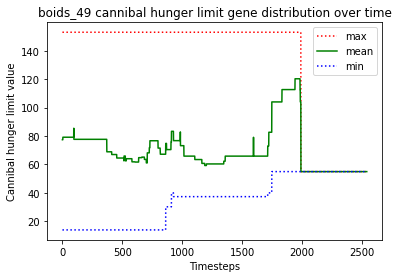

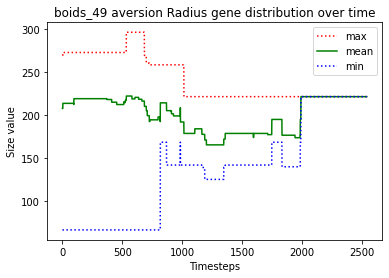

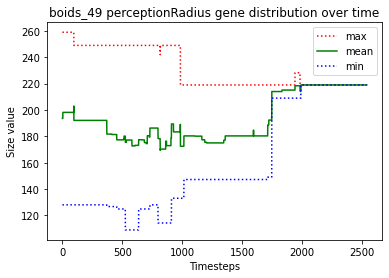

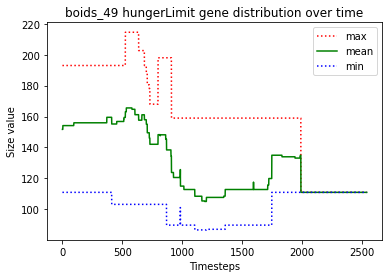





						BOIDS_50

predator_5 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_8 killed predator_2
predator_11 just gave birth to predator_13
predator_11 killed predator_3
predator_13 killed predator_0
predator_11 killed predator_6
predator_8 just gave birth to predator_14
predator_8 killed predator_7
predator_14 killed predator_4
predator_11 killed predator_9
predator_14 killed predator_5
predator_10 just gave birth to predator_15
predator_12 just gave birth to predator_16
predator_10 just gave birth to predator_17
predator_17 starved to death
predator_15 ate the carcass of predator_17_carcass
predator_10 starved to death
predator_1 starved to death
predator_15 ate the carcass of predator_10_carcass
predator_14 ate the carcass of predator_1_carcass
predator_15 starved to death
predator_14 ate the carcass of predator_15_carcass
predator_12 just gave birth to predator_18
predator_16 starved to death
predator_12 

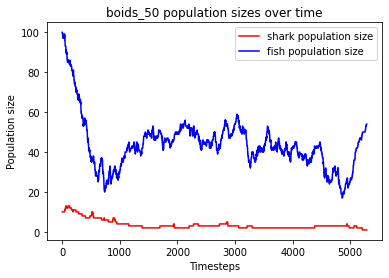

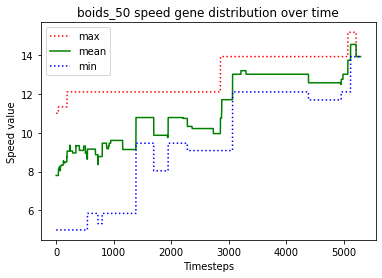

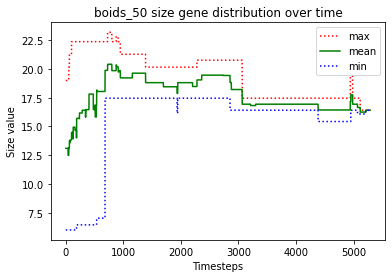

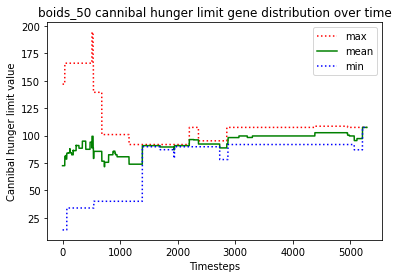

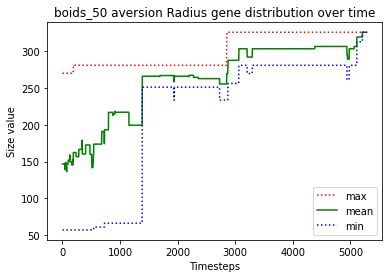

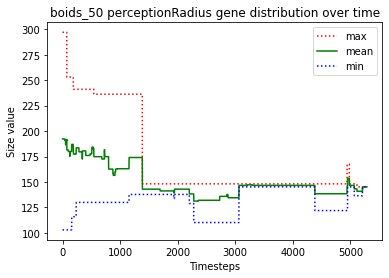

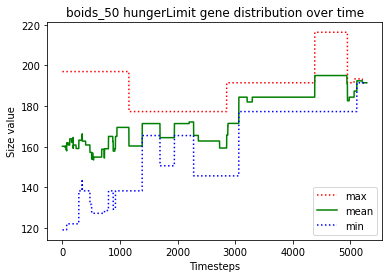





						BOIDS_51

predator_7 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_14 starved to death
predator_9 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_8 ate the carcass of predator_14_carcass
predator_10 starved to death
predator_8 ate the carcass of predator_10_carcass
predator_9 killed predator_12
predator_15 killed predator_3
predator_6 starved to death
predator_15 killed predator_7
predator_11 starved to death
predator_15 ate the carcass of predator_11_carcass
predator_4 ate the carcass of predator_6_carcass
predator_0 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_5 killed predator_13
predator_17 just gave birth to predator_19
predator_19 just gave birth to predator_20
predator_19 killed predator_2
predator_20 starved to death
predator_9 ate the c

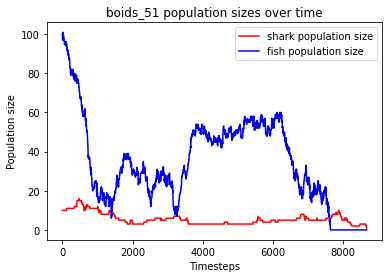

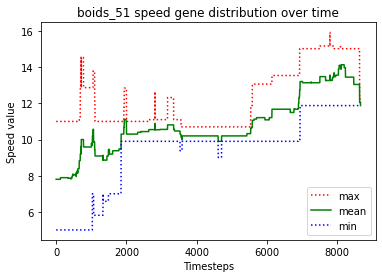

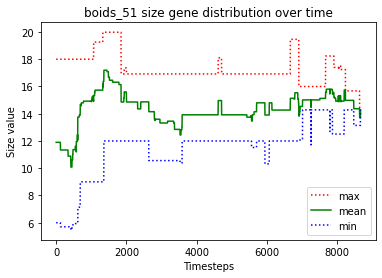

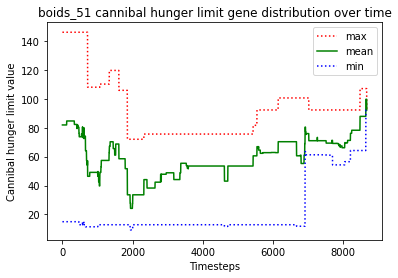

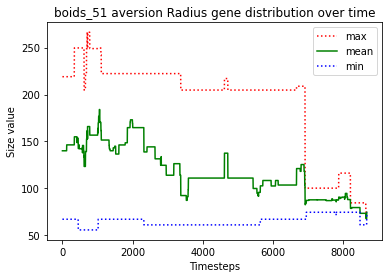

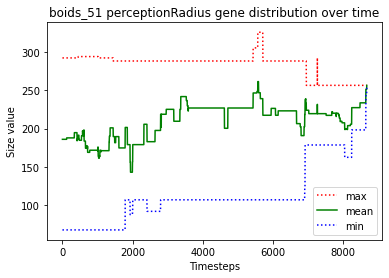

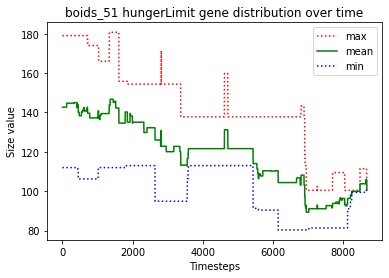





						BOIDS_52

predator_0 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_10 killed predator_2
predator_10 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_10 killed predator_11
predator_3 just gave birth to predator_15
predator_12 starved to death
predator_10 ate the carcass of predator_12_carcass
predator_10 killed predator_8
predator_13 just gave birth to predator_16
predator_13 starved to death
predator_16 starved to death
predator_4 ate the carcass of predator_16_carcass
predator_14 starved to death
predator_6 ate the carcass of predator_14_carcass
predator_4 just gave birth to predator_17
predator_4 just gave birth to predator_18
predator_10 just gave birth to predator_19
predator_6 ate the carcass of predator_13_carcass
predator_18 just gave birth to predator_20
predator_20 starved to death
predator_18 starved to death
predator_4 ate the carcass of predator_18_carcas

predator_57 ate the carcass of predator_65_carcass
predator_62 ate the carcass of predator_63_carcass
predator_70 starved to death
predator_68 just gave birth to predator_71
predator_71 ate the carcass of predator_70_carcass
predator_68 starved to death
predator_71 ate the carcass of predator_68_carcass
predator_71 starved to death
predator_62 ate the carcass of predator_71_carcass
predator_57 just gave birth to predator_72
predator_57 just gave birth to predator_73
predator_27 just gave birth to predator_74
predator_57 just gave birth to predator_75
no fish to move
predator_74 killed predator_57
predator_27 just gave birth to predator_76
predator_27 starved to death
predator_76 starved to death
predator_74 just gave birth to predator_77
predator_74 starved to death
predator_77 starved to death
predator_75 ate the carcass of predator_74_carcass
predator_75 ate the carcass of predator_77_carcass
predator_73 just gave birth to predator_78
predator_78 starved to death
predator_73 starved 

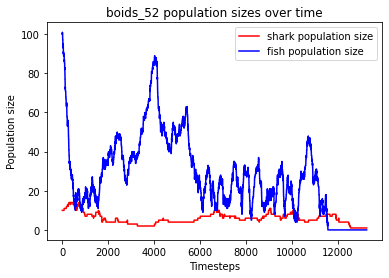

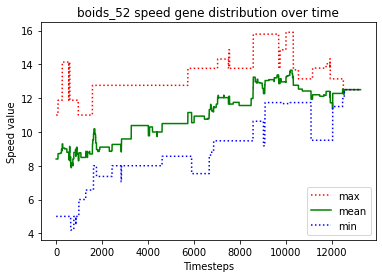

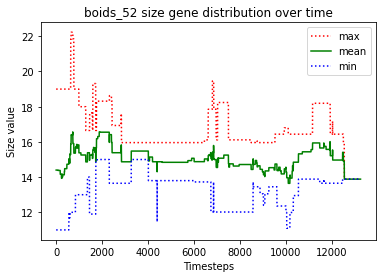

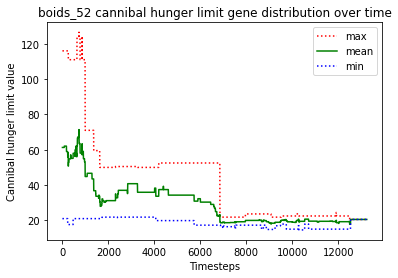

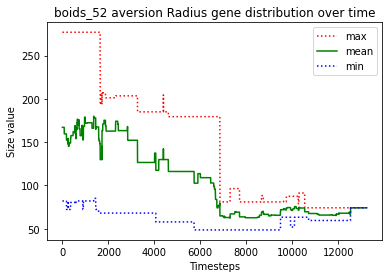

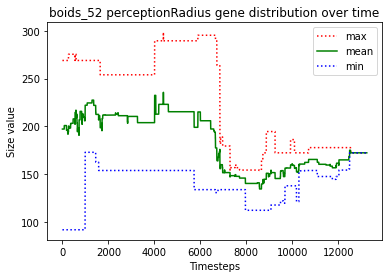

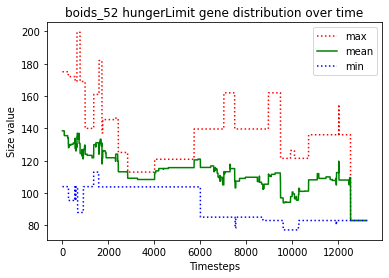





						BOIDS_53

predator_8 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_12 starved to death
predator_10 starved to death
predator_8 starved to death
predator_3 ate the carcass of predator_10_carcass
predator_11 starved to death
predator_6 ate the carcass of predator_8_carcass
predator_3 just gave birth to predator_14
predator_2 ate the carcass of predator_11_carcass
predator_2 ate the carcass of predator_12_carcass
predator_13 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_16 just gave birth to predator_17
predator_13 killed predator_5
predator_3 killed predator_1
predator_9 just gave birth to predator_18
predator_17 starved to death
predator_3 ate the carcass of predator_17_carcass
predator_16 starved to death
predator_2 ate the carcass of predator_16_carcass
predator_15 killed predator_9
predator_15 just gave birth to predato

predator_65 just gave birth to predator_68
predator_66 killed predator_67
predator_65 just gave birth to predator_69
predator_58 starved to death
predator_69 starved to death
predator_65 ate the carcass of predator_58_carcass
predator_68 just gave birth to predator_70
predator_65 ate the carcass of predator_69_carcass
predator_68 starved to death
predator_70 starved to death
predator_65 just gave birth to predator_71
predator_66 ate the carcass of predator_70_carcass
predator_65 ate the carcass of predator_68_carcass
predator_71 just gave birth to predator_72
predator_66 starved to death
predator_71 ate the carcass of predator_66_carcass
predator_71 just gave birth to predator_73
predator_73 just gave birth to predator_74
predator_73 killed predator_74
predator_65 just gave birth to predator_75
predator_73 just gave birth to predator_76
predator_73 killed predator_76
predator_71 starved to death
predator_72 just gave birth to predator_77
predator_73 ate the carcass of predator_71_carca

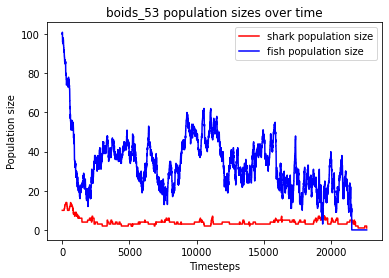

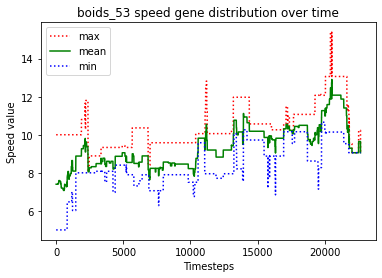

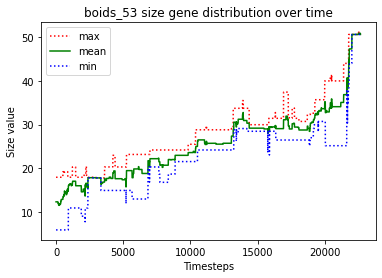

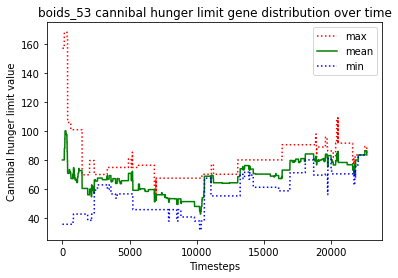

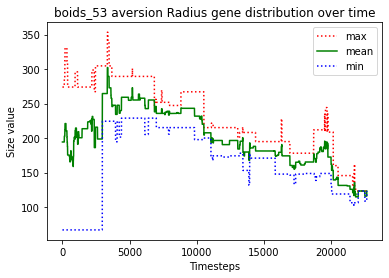

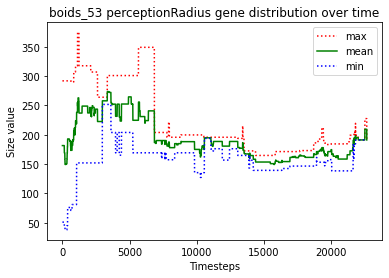

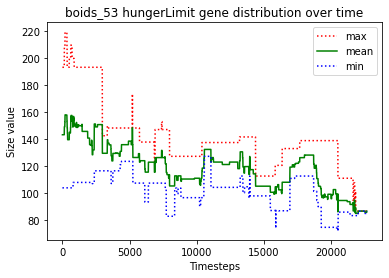





						BOIDS_54

predator_3 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_4 killed predator_9
predator_5 killed predator_13
predator_6 just gave birth to predator_15
predator_11 starved to death
predator_12 ate the carcass of predator_11_carcass
predator_3 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_4 killed predator_7
predator_3 starved to death
predator_16 starved to death
predator_4 ate the carcass of predator_16_carcass
predator_5 killed predator_6
predator_4 ate the carcass of predator_3_carcass
predator_12 killed predator_10
predator_17 starved to death
predator_4 killed predator_2
predator_14 ate the carcass of predator_17_carcass
predator_5 killed predator_15
predator_4 killed predator_1
predator_12 starved to death
predator_0 ate the carcass of predator_12_carcass
predator_14

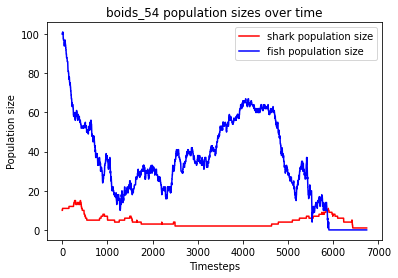

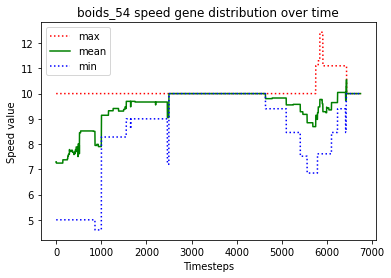

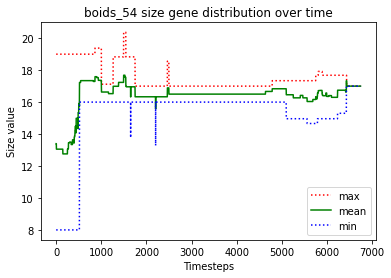

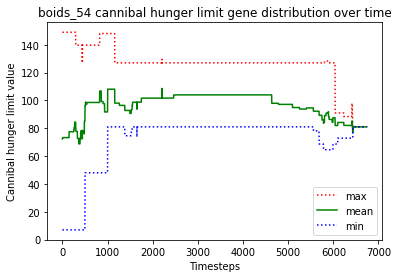

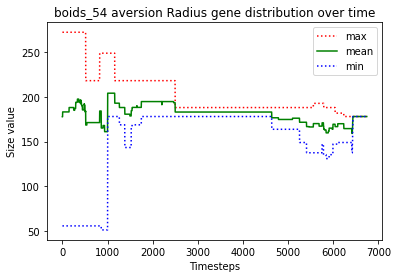

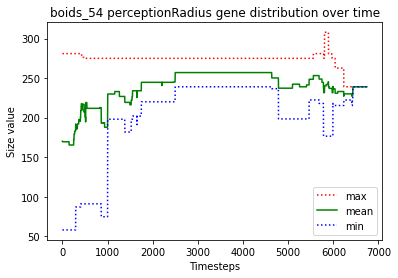

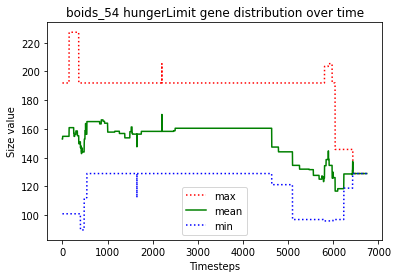





						BOIDS_55

predator_2 just gave birth to predator_10
predator_10 starved to death
predator_4 just gave birth to predator_11
predator_7 ate the carcass of predator_10_carcass
predator_4 just gave birth to predator_12
predator_4 killed predator_5
predator_2 starved to death
predator_11 killed predator_1
predator_9 ate the carcass of predator_2_carcass
predator_0 just gave birth to predator_13
predator_0 killed predator_13
predator_4 killed predator_6
predator_4 killed predator_0
predator_12 just gave birth to predator_14
predator_12 killed predator_8
predator_3 just gave birth to predator_15
predator_4 killed predator_14
predator_3 just gave birth to predator_16
predator_4 killed predator_3
predator_7 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_15 just gave birth to predator_19
predator_18 starved to death
predator_11 just gave birth to predator_20
predator_17 ate the carcass of predator_18_carcass
predator_19 starved to death
predator_9 at

predator_68 starved to death
predator_62 starved to death
predator_66 ate the carcass of predator_62_carcass
predator_66 ate the carcass of predator_68_carcass
predator_66 just gave birth to predator_71
predator_61 starved to death
predator_71 starved to death
predator_43 starved to death
predator_66 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 72
Timesteps passed: 8458
Fish went extinct at timestep 7332
Sharks went extinct at timestep 8458


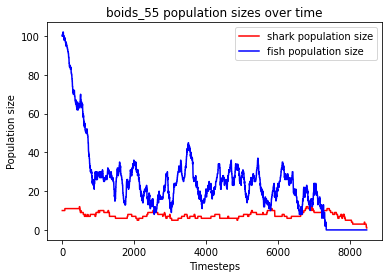

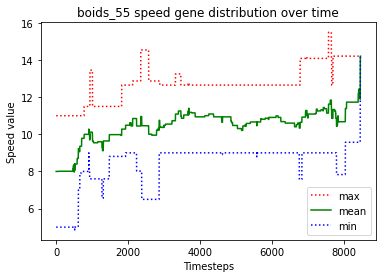

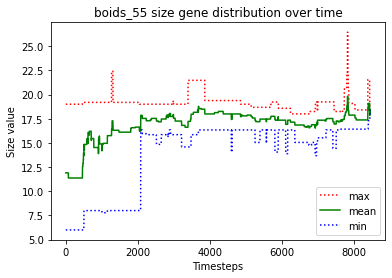

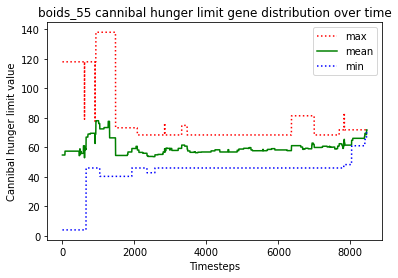

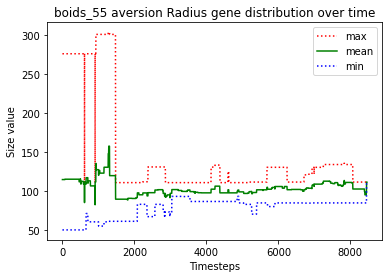

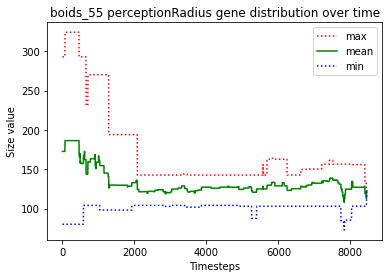

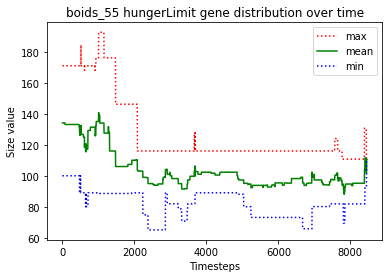





						BOIDS_56

predator_7 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_3 killed predator_1
predator_7 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_9 just gave birth to predator_17
predator_13 starved to death
predator_15 starved to death
predator_5 ate the carcass of predator_13_carcass
predator_14 ate the carcass of predator_15_carcass
predator_17 killed predator_16
predator_14 just gave birth to predator_18
predator_14 killed predator_0
predator_3 starved to death
predator_9 ate the carcass of predator_3_carcass
predator_17 just gave birth to predator_19
predator_7 starved to death
predator_14 ate the carcass of predator_7_carcass
predator_17 just gave birth to predator_20
predator_18 starved to death
predator_17 ate the carcass of predator_18_carcass
predator_11 starved to death
pr

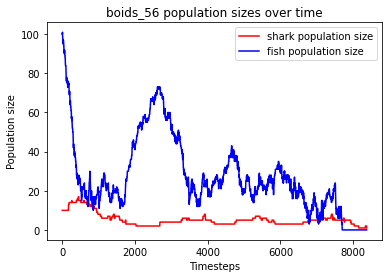

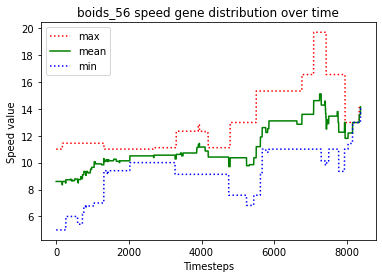

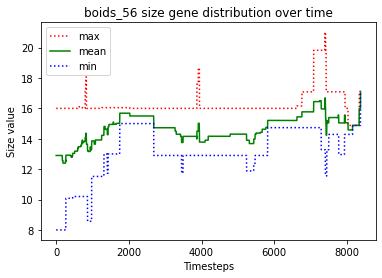

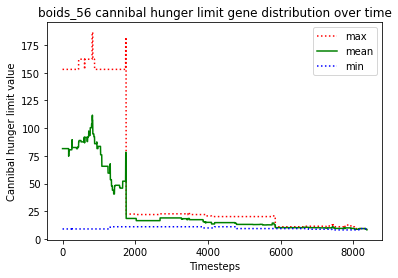

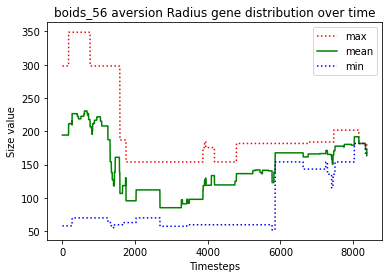

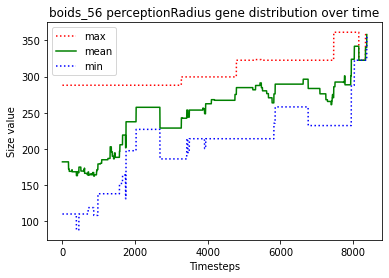

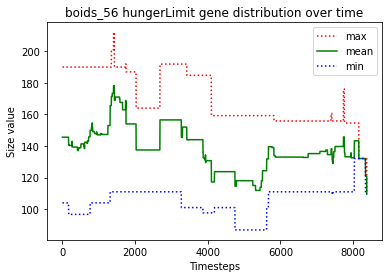





						BOIDS_57

predator_6 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_0 killed predator_7
predator_2 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_2 killed predator_10
predator_5 killed predator_6
predator_5 just gave birth to predator_16
predator_16 just gave birth to predator_17
predator_15 killed predator_9
predator_13 starved to death
predator_2 just gave birth to predator_18
predator_16 starved to death
predator_3 ate the carcass of predator_13_carcass
predator_14 starved to death
predator_12 ate the carcass of predator_16_carcass
predator_17 starved to death
predator_1 just gave birth to predator_19
predator_0 ate the carcass of predator_14_carcass
predator_12 ate the carcass of predator_17_carcass
predator_5 starved to death
predator_1 just gave birth to predator_20
predator_18 ate the carcass of predator_5_carcass
pr

predator_69 killed predator_71
predator_64 ate the carcass of predator_62_carcass
predator_69 starved to death
predator_38 ate the carcass of predator_69_carcass
predator_67 just gave birth to predator_72
predator_72 starved to death
predator_50 just gave birth to predator_73
predator_38 ate the carcass of predator_72_carcass
predator_64 starved to death
predator_67 ate the carcass of predator_64_carcass
predator_45 starved to death
predator_70 ate the carcass of predator_45_carcass
predator_73 just gave birth to predator_74
predator_50 starved to death
predator_67 ate the carcass of predator_50_carcass
predator_70 starved to death
predator_67 just gave birth to predator_75
predator_67 ate the carcass of predator_70_carcass
predator_75 starved to death
predator_74 ate the carcass of predator_75_carcass
predator_38 just gave birth to predator_76
predator_67 just gave birth to predator_77
predator_77 starved to death
predator_67 just gave birth to predator_78
predator_76 ate the carcass 

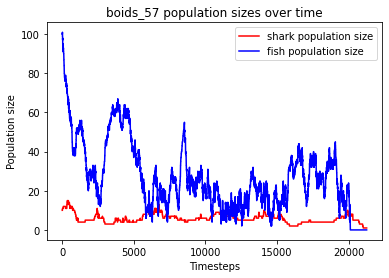

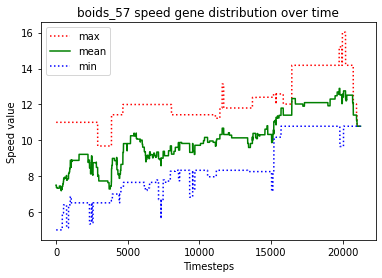

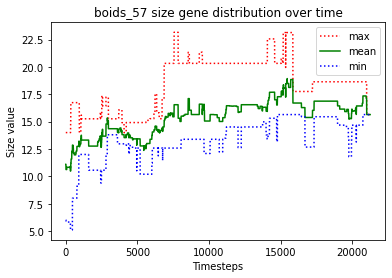

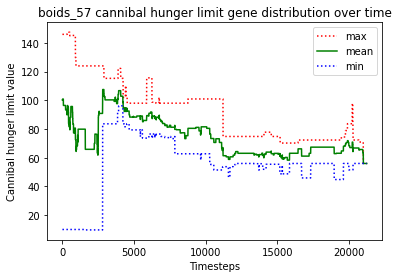

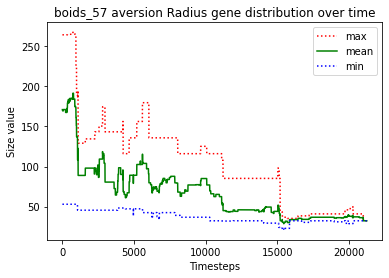

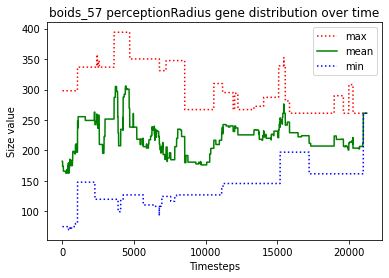

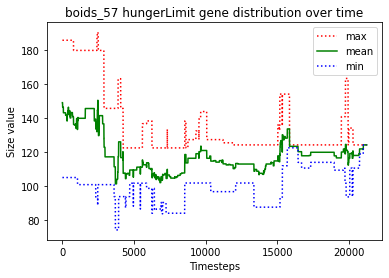





						BOIDS_58

predator_3 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_11 killed predator_1
predator_12 starved to death
predator_6 ate the carcass of predator_12_carcass
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_0 just gave birth to predator_14
predator_13 starved to death
predator_3 starved to death
predator_0 starved to death
predator_11 ate the carcass of predator_13_carcass
predator_2 just gave birth to predator_15
predator_2 killed predator_15
predator_11 ate the carcass of predator_3_carcass
predator_11 ate the carcass of predator_0_carcass
predator_14 just gave birth to predator_16
predator_14 starved to death
predator_16 starved to death
predator_11 ate the carcass of predator_16_carcass
predator_8 ate the carcass of predator_14_carcass
predator_6 just gave birth to predator_17
predator_2 just gave birth to

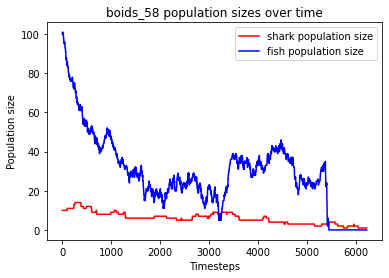

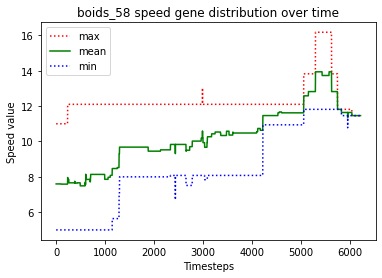

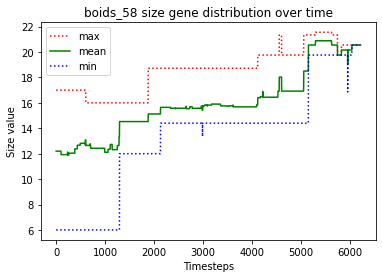

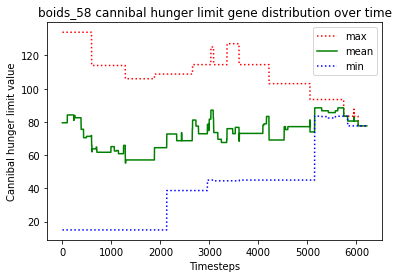

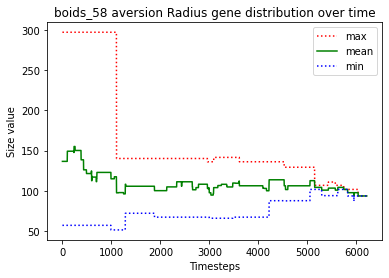

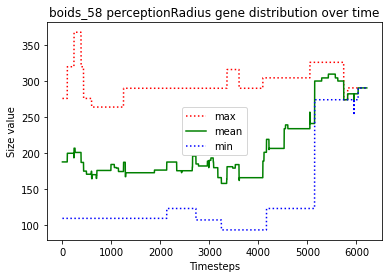

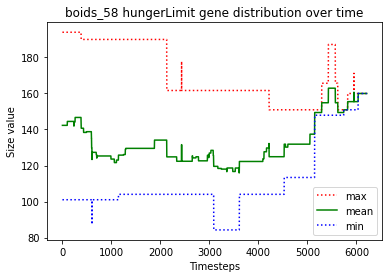





						BOIDS_59

predator_6 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_10 killed predator_9
predator_7 just gave birth to predator_15
predator_8 just gave birth to predator_16
predator_0 killed predator_5
predator_8 killed predator_11
predator_12 just gave birth to predator_17
predator_12 starved to death
predator_17 starved to death
predator_3 ate the carcass of predator_17_carcass
predator_3 ate the carcass of predator_12_carcass
predator_14 starved to death
predator_0 killed predator_7
predator_2 ate the carcass of predator_14_carcass
predator_3 just gave birth to predator_18
predator_15 starved to death
predator_2 just gave birth to predator_19
predator_10 ate the carcass of predator_15_carcass
predator_2 starved to death
predator_19 starved to death
predator_8 ate the carcass of predator_19_carcass
predator_8 ate 

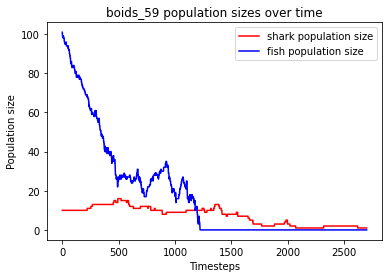

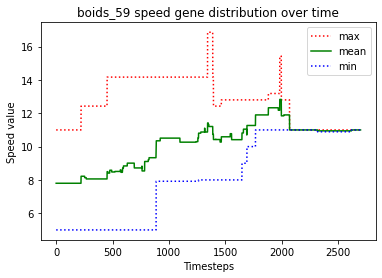

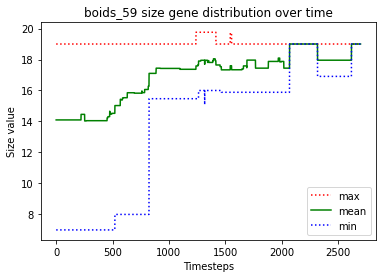

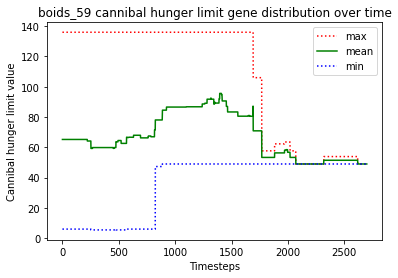

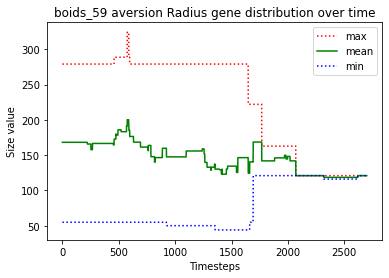

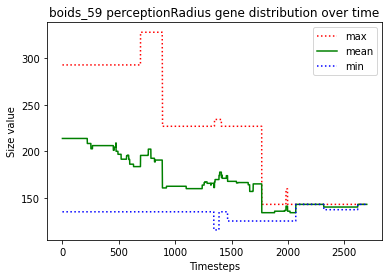

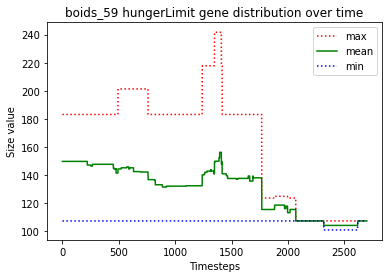





						BOIDS_60

predator_8 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_13 killed predator_8
predator_11 killed predator_3
predator_6 just gave birth to predator_14
predator_2 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_13 just gave birth to predator_17
predator_9 starved to death
predator_11 ate the carcass of predator_9_carcass
predator_16 starved to death
predator_0 just gave birth to predator_18
predator_15 ate the carcass of predator_16_carcass
predator_10 starved to death
predator_17 starved to death
predator_13 ate the carcass of predator_10_carcass
predator_14 ate the carcass of predator_17_carcass
predator_4 starved to death
predator_12 ate the carcass of predator_4_carcass
predator_18 just gave birth to predator_19
predator_19 just gave birth to predator_20
predator_18 killed predator_20
predator_12 just gave birth 

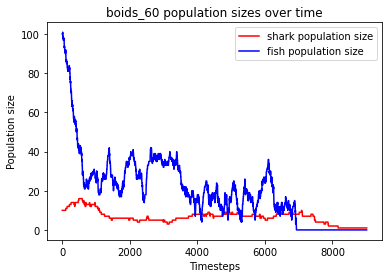

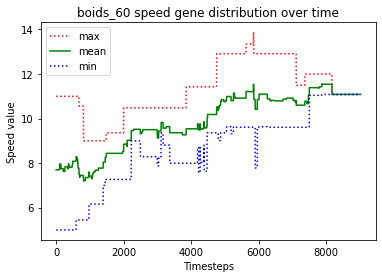

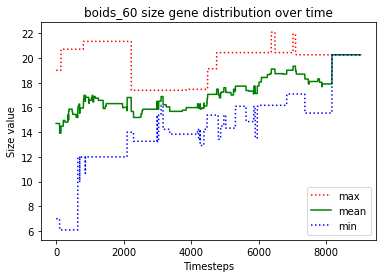

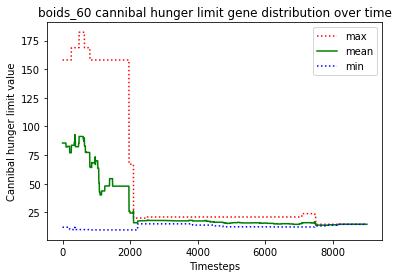

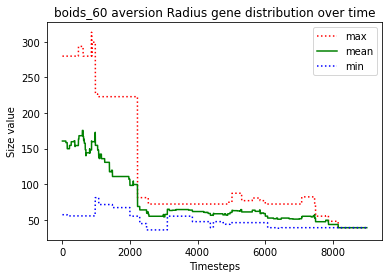

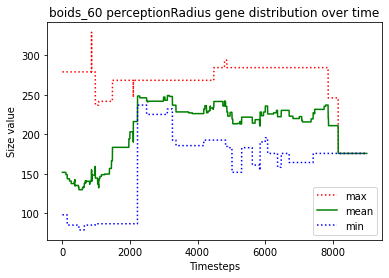

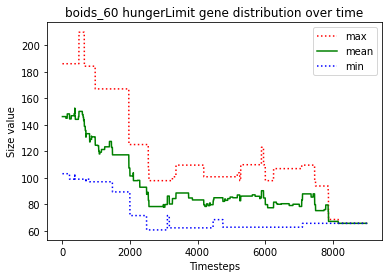





						BOIDS_61

predator_3 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_1 just gave birth to predator_14
predator_10 starved to death
predator_11 ate the carcass of predator_10_carcass
predator_9 just gave birth to predator_15
predator_1 starved to death
predator_3 starved to death
predator_8 just gave birth to predator_16
predator_0 ate the carcass of predator_3_carcass
predator_14 starved to death
predator_9 ate the carcass of predator_1_carcass
predator_13 starved to death
predator_11 ate the carcass of predator_14_carcass
predator_11 just gave birth to predator_17
predator_9 ate the carcass of predator_13_carcass
predator_12 just gave birth to predator_18
predator_18 killed predator_8
predator_7 killed predator_2
predator_17 starved to death
predator_18 killed predator_16
predator_7 ate the carcass of predator_17_carcass
predator_11 starved to death
predator_

predator_66 starved to death
predator_65 starved to death
predator_55 ate the carcass of predator_66_carcass
predator_62 ate the carcass of predator_65_carcass
predator_61 starved to death
predator_62 ate the carcass of predator_61_carcass
predator_58 starved to death
predator_55 ate the carcass of predator_58_carcass
predator_62 starved to death
predator_55 just gave birth to predator_67
predator_55 starved to death
predator_67 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 68
Timesteps passed: 10277
Fish went extinct at timestep 9186
Sharks went extinct at timestep 10277


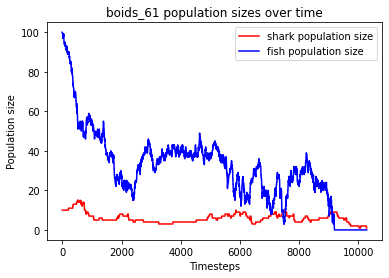

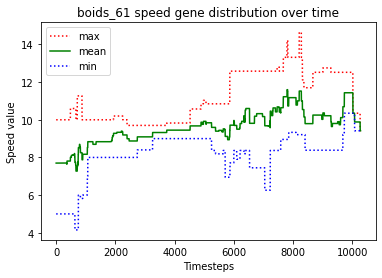

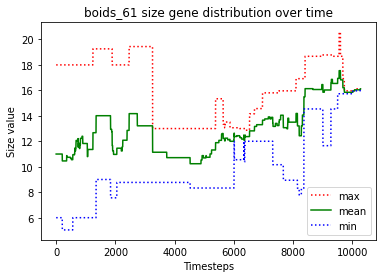

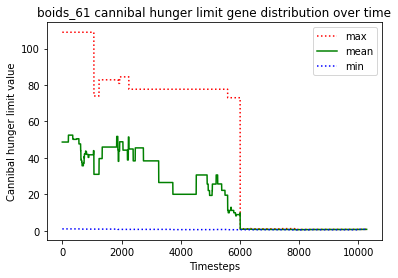

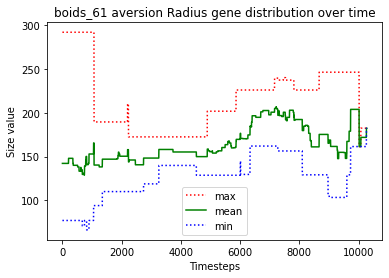

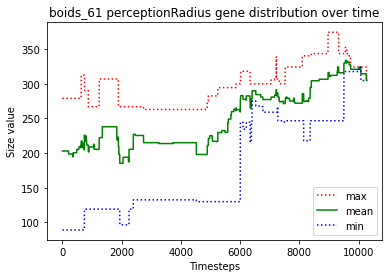

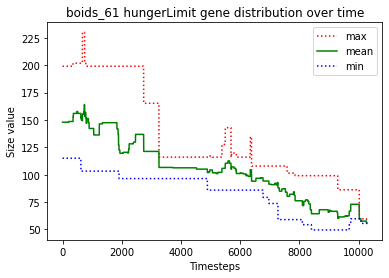





						BOIDS_62

predator_8 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_7 just gave birth to predator_15
predator_14 killed predator_12
predator_10 starved to death
predator_7 starved to death
predator_15 starved to death
predator_9 ate the carcass of predator_10_carcass
predator_1 ate the carcass of predator_7_carcass
predator_1 ate the carcass of predator_15_carcass
predator_1 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_8 killed predator_17
predator_8 just gave birth to predator_18
predator_11 starved to death
predator_3 ate the carcass of predator_11_carcass
predator_13 just gave birth to predator_19
predator_13 starved to death
predator_18 starved to death
predator_19 starved to death
predator_8 starved to death
predator_5 ate the carcass of predator_18_carcass
predator_14 ate the

predator_58 ate the carcass of predator_67_carcass
predator_59 starved to death
predator_68 ate the carcass of predator_59_carcass
predator_69 just gave birth to predator_70
predator_70 starved to death
predator_68 just gave birth to predator_71
predator_69 starved to death
predator_64 starved to death
predator_55 ate the carcass of predator_69_carcass
predator_71 ate the carcass of predator_64_carcass
predator_36 starved to death
predator_56 ate the carcass of predator_36_carcass
predator_71 ate the carcass of predator_70_carcass
predator_56 just gave birth to predator_72
predator_55 just gave birth to predator_73
predator_71 just gave birth to predator_74
predator_71 killed predator_74
predator_72 starved to death
predator_58 ate the carcass of predator_72_carcass
predator_68 starved to death
predator_71 starved to death
predator_55 just gave birth to predator_75
predator_62 ate the carcass of predator_71_carcass
predator_75 ate the carcass of predator_68_carcass
predator_56 just gav

predator_124 just gave birth to predator_129
predator_119 just gave birth to predator_130
predator_129 starved to death
predator_124 starved to death
predator_111 ate the carcass of predator_129_carcass
predator_128 ate the carcass of predator_124_carcass
predator_127 just gave birth to predator_131
predator_119 starved to death
predator_130 ate the carcass of predator_119_carcass
no fish to move
predator_130 starved to death
predator_111 ate the carcass of predator_130_carcass
predator_126 starved to death
predator_131 ate the carcass of predator_126_carcass
predator_111 just gave birth to predator_132
predator_111 just gave birth to predator_133
predator_133 starved to death
predator_111 starved to death
predator_131 ate the carcass of predator_111_carcass
predator_132 starved to death
predator_127 ate the carcass of predator_132_carcass
predator_128 starved to death
predator_127 ate the carcass of predator_128_carcass
predator_127 ate the carcass of predator_133_carcass
predator_131

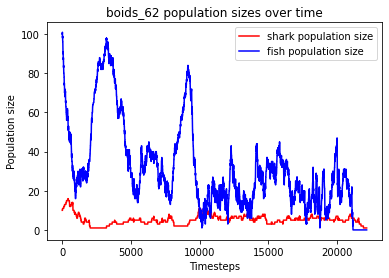

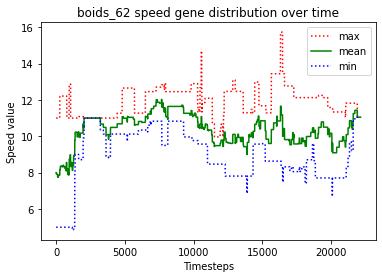

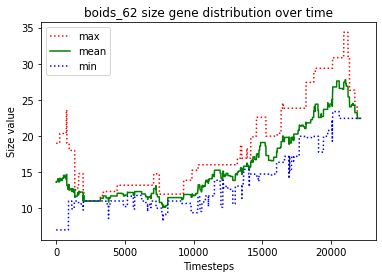

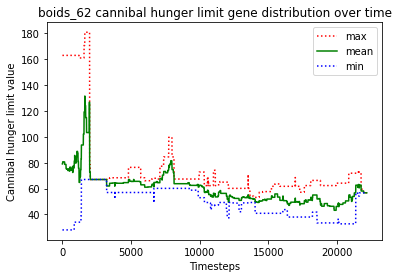

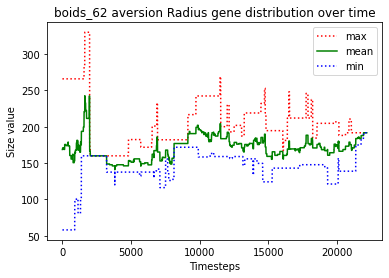

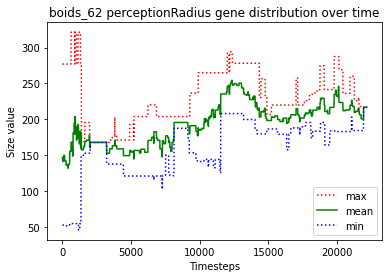

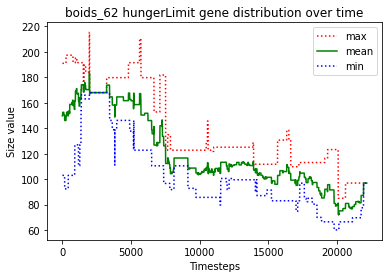





						BOIDS_63

predator_9 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_15 starved to death
predator_8 starved to death
predator_0 just gave birth to predator_16
predator_3 ate the carcass of predator_15_carcass
predator_6 ate the carcass of predator_8_carcass
predator_11 starved to death
predator_14 starved to death
predator_13 ate the carcass of predator_11_carcass
predator_13 ate the carcass of predator_14_carcass
predator_10 just gave birth to predator_17
predator_9 starved to death
predator_0 just gave birth to predator_18
predator_1 ate the carcass of predator_9_carcass
predator_12 starved to death
predator_0 ate the carcass of predator_12_carcass
predator_10 starved to death
predator_17 ate the carcass of predator_10_carcass
predator_7 just gave birth to predator_19
predat

predator_47 just gave birth to predator_72
predator_71 ate the carcass of predator_67_carcass
predator_71 just gave birth to predator_73
predator_47 starved to death
predator_72 starved to death
predator_73 ate the carcass of predator_47_carcass
predator_65 just gave birth to predator_74
predator_71 ate the carcass of predator_68_carcass
predator_74 ate the carcass of predator_72_carcass
predator_69 starved to death
predator_40 just gave birth to predator_75
predator_71 ate the carcass of predator_69_carcass
predator_74 just gave birth to predator_76
predator_71 just gave birth to predator_77
predator_65 starved to death
predator_76 starved to death
predator_74 ate the carcass of predator_65_carcass
predator_75 ate the carcass of predator_76_carcass
predator_71 starved to death
predator_73 just gave birth to predator_78
predator_73 ate the carcass of predator_71_carcass
predator_40 just gave birth to predator_79
predator_77 starved to death
predator_75 starved to death
predator_40 ate 

predator_127 ate the carcass of predator_102_carcass
predator_129 starved to death
predator_127 ate the carcass of predator_129_carcass
predator_127 just gave birth to predator_130
predator_105 just gave birth to predator_131
predator_130 just gave birth to predator_132
predator_132 just gave birth to predator_133
predator_133 starved to death
predator_127 ate the carcass of predator_133_carcass
predator_131 starved to death
predator_105 ate the carcass of predator_131_carcass
predator_132 killed predator_120
predator_125 just gave birth to predator_134
predator_132 starved to death
predator_127 starved to death
predator_130 starved to death
predator_125 ate the carcass of predator_127_carcass
predator_125 ate the carcass of predator_132_carcass
predator_134 starved to death
predator_125 ate the carcass of predator_130_carcass
predator_105 starved to death
predator_125 ate the carcass of predator_105_carcass
predator_125 just gave birth to predator_135
predator_135 ate the carcass of p

predator_174 just gave birth to predator_190
predator_174 killed predator_189
predator_157 just gave birth to predator_191
predator_190 starved to death
predator_187 just gave birth to predator_192
predator_188 just gave birth to predator_193
predator_193 just gave birth to predator_194
predator_174 starved to death
predator_168 ate the carcass of predator_174_carcass
predator_188 just gave birth to predator_195
predator_192 ate the carcass of predator_190_carcass
predator_193 killed predator_192
predator_195 starved to death
predator_168 ate the carcass of predator_195_carcass
predator_157 starved to death
predator_187 ate the carcass of predator_157_carcass
predator_191 starved to death
predator_168 ate the carcass of predator_191_carcass
predator_188 starved to death
predator_193 starved to death
predator_168 ate the carcass of predator_193_carcass
predator_168 ate the carcass of predator_188_carcass
predator_187 just gave birth to predator_196
predator_194 just gave birth to predat

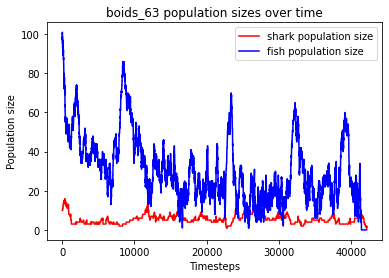

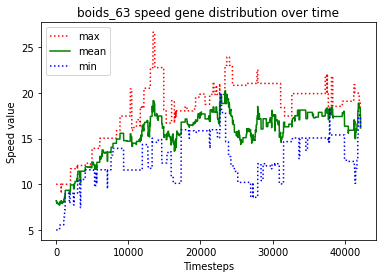

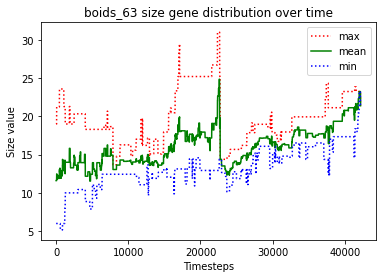

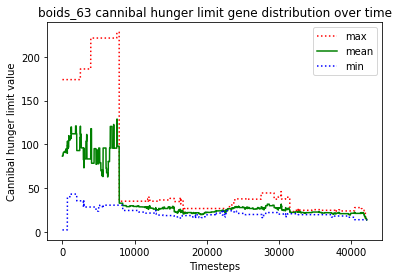

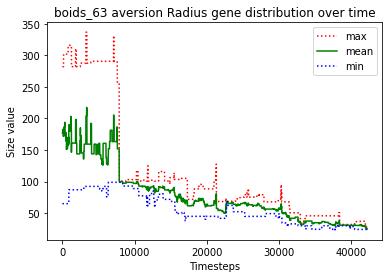

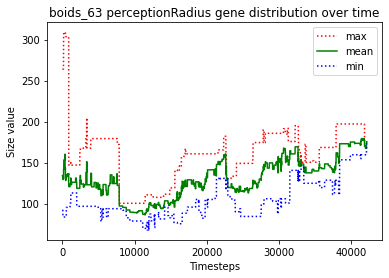

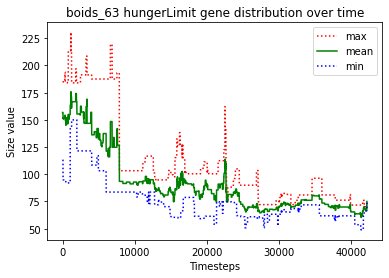





						BOIDS_64

predator_6 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_13 just gave birth to predator_15
predator_12 killed predator_3
predator_7 killed predator_14
predator_9 killed predator_8
predator_13 starved to death
predator_12 ate the carcass of predator_13_carcass
predator_15 killed predator_6
predator_12 killed predator_1
predator_7 killed predator_9
predator_12 killed predator_11
predator_7 killed predator_10
predator_12 killed predator_4
predator_7 just gave birth to predator_16
predator_15 starved to death
predator_16 just gave birth to predator_17
predator_16 killed predator_17
predator_7 ate the carcass of predator_15_carcass
predator_12 just gave birth to predator_18
predator_16 starved to death
predator_0 ate the carcass of predator_16_carcass
predator_18 just gave birth to predator_19
predator_0 just ga

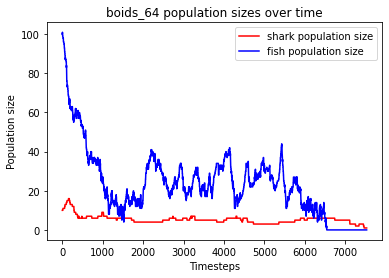

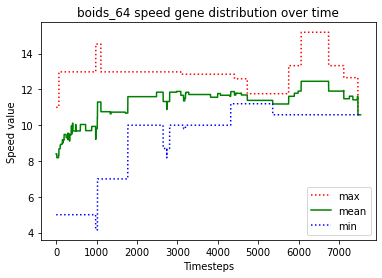

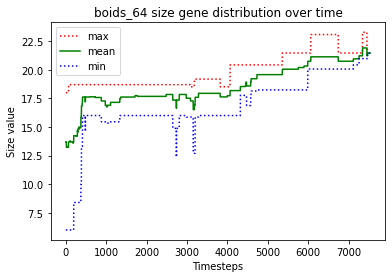

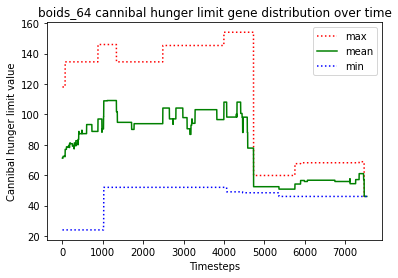

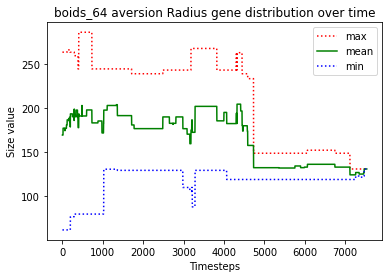

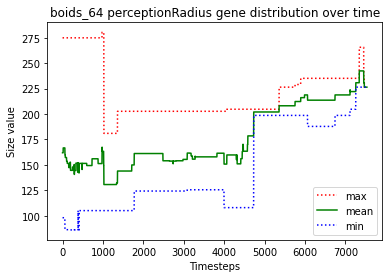

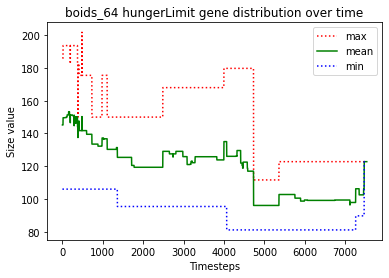





						BOIDS_65

predator_8 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_10 killed predator_3
predator_0 just gave birth to predator_12
predator_12 killed predator_4
predator_10 killed predator_2
predator_5 just gave birth to predator_13
predator_8 killed predator_6
predator_0 just gave birth to predator_14
predator_7 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_14 just gave birth to predator_17
predator_11 starved to death
predator_14 just gave birth to predator_18
predator_14 killed predator_18
predator_14 just gave birth to predator_19
predator_8 starved to death
predator_9 ate the carcass of predator_11_carcass
predator_10 ate the carcass of predator_8_carcass
predator_5 killed predator_1
predator_5 just gave birth to predator_20
predator_14 starved to death
predator_19 starved to death
predator_5 just gave birth to predator_21
predator_17 ate the carcass of predator_19_carcass
predator_9 ate the carcass o

predator_26 just gave birth to predator_71
predator_26 starved to death
predator_71 starved to death
predator_61 ate the carcass of predator_26_carcass
predator_68 ate the carcass of predator_71_carcass
predator_62 just gave birth to predator_72
predator_58 just gave birth to predator_73
predator_66 just gave birth to predator_74
predator_62 starved to death
predator_72 starved to death
predator_68 ate the carcass of predator_62_carcass
predator_66 just gave birth to predator_75
predator_58 starved to death
predator_61 ate the carcass of predator_58_carcass
predator_68 ate the carcass of predator_72_carcass
predator_75 starved to death
predator_66 starved to death
predator_57 just gave birth to predator_76
predator_73 starved to death
predator_57 ate the carcass of predator_66_carcass
predator_76 ate the carcass of predator_75_carcass
predator_74 ate the carcass of predator_73_carcass
predator_57 just gave birth to predator_77
predator_74 just gave birth to predator_78
predator_76 just

predator_128 killed predator_127
predator_104 just gave birth to predator_129
predator_107 just gave birth to predator_130
predator_107 just gave birth to predator_131
predator_104 just gave birth to predator_132
predator_130 starved to death
predator_129 ate the carcass of predator_130_carcass
predator_131 starved to death
predator_128 ate the carcass of predator_131_carcass
predator_107 starved to death
predator_128 ate the carcass of predator_107_carcass
predator_129 just gave birth to predator_133
predator_132 starved to death
predator_128 ate the carcass of predator_132_carcass
predator_133 starved to death
predator_123 ate the carcass of predator_133_carcass
predator_104 just gave birth to predator_134
predator_128 just gave birth to predator_135
predator_129 just gave birth to predator_136
predator_134 starved to death
predator_128 ate the carcass of predator_134_carcass
predator_135 just gave birth to predator_137
predator_129 starved to death
predator_136 ate the carcass of pr

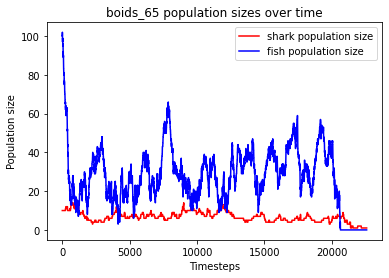

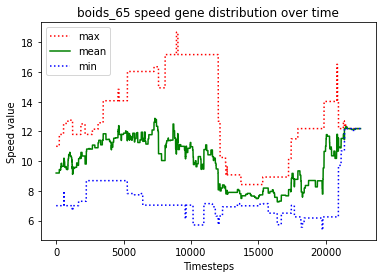

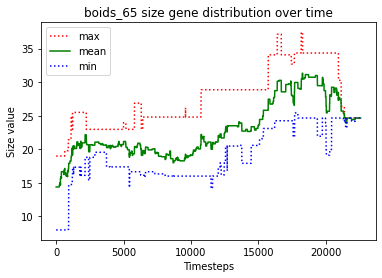

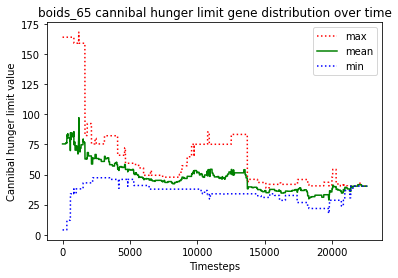

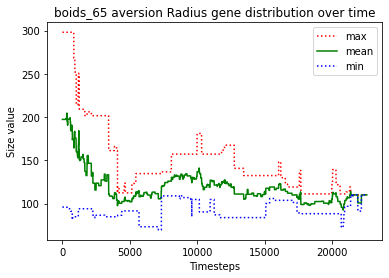

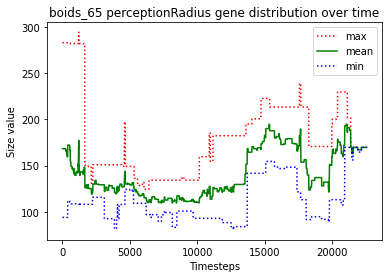

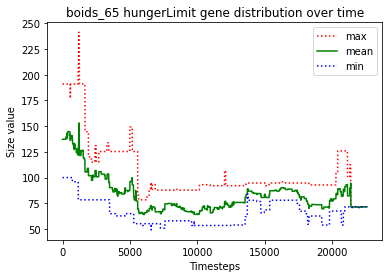





						BOIDS_66

predator_6 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_13 starved to death
predator_0 starved to death
predator_7 ate the carcass of predator_0_carcass
predator_10 just gave birth to predator_14
predator_14 ate the carcass of predator_13_carcass
predator_10 just gave birth to predator_15
predator_15 killed predator_7
predator_5 just gave birth to predator_16
predator_1 just gave birth to predator_17
predator_12 starved to death
predator_10 starved to death
predator_6 ate the carcass of predator_12_carcass
predator_17 ate the carcass of predator_10_carcass
predator_15 starved to death
predator_8 ate the carcass of predator_15_carcass
predator_1 killed predator_2
predator_5 killed predator_6
predator_16 killed predator_17
predator_4 just gave birth to predator_18
predator_14 starved to death
predator_16 just gave birth to predator_19
predator_16 ki

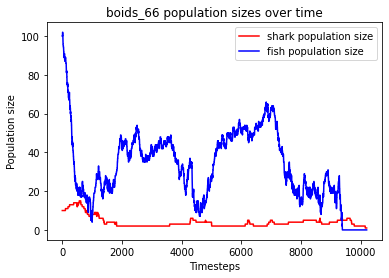

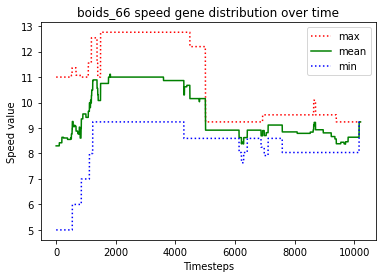

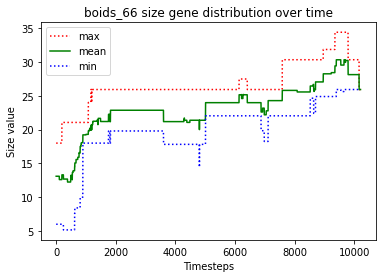

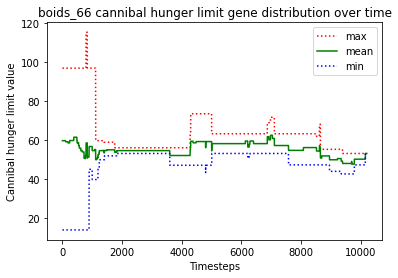

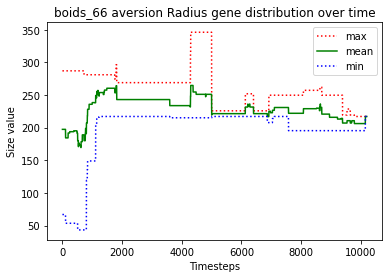

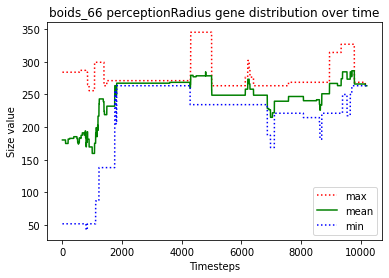

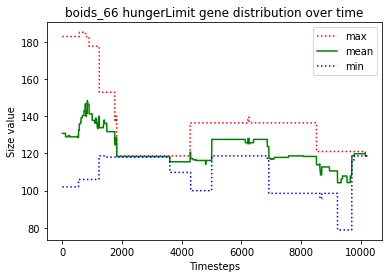





						BOIDS_67

predator_5 just gave birth to predator_10
predator_3 killed predator_7
predator_4 just gave birth to predator_11
predator_3 killed predator_1
predator_9 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_5 starved to death
predator_10 starved to death
predator_12 ate the carcass of predator_10_carcass
predator_4 ate the carcass of predator_5_carcass
predator_9 starved to death
predator_11 ate the carcass of predator_9_carcass
predator_12 just gave birth to predator_15
predator_12 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_17 starved to death
predator_0 ate the carcass of predator_17_carcass
predator_12 starved to death
predator_3 ate the carcass of predator_12_carcass
predator_6 just gave birth to predator_18
predator_16 starved to death
predator_11 starved to death
predator_13 ate the carcass of predator_16_carcass
predator_13 ate the carcass of predator

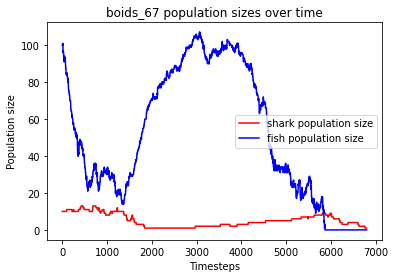

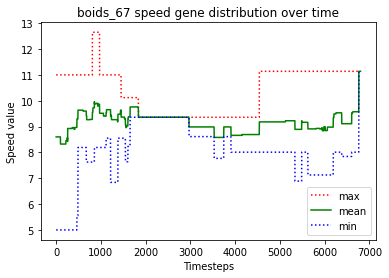

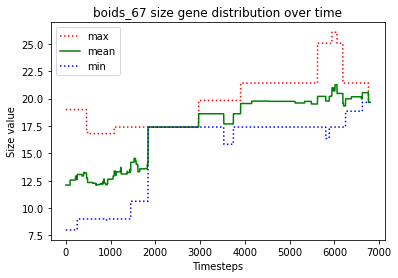

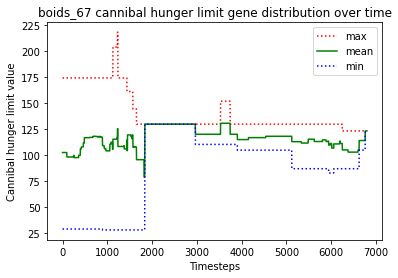

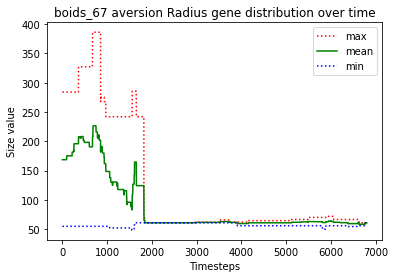

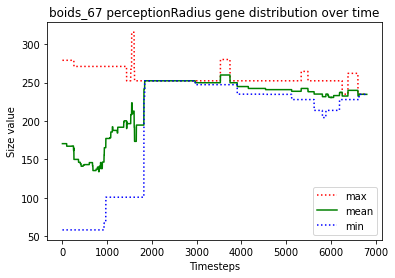

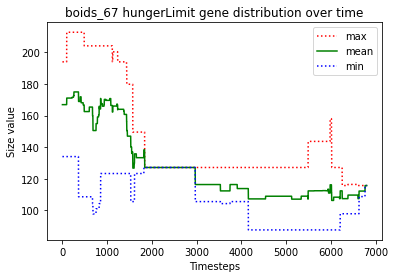





						BOIDS_68

predator_9 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_2 just gave birth to predator_16
predator_16 killed predator_3
predator_11 starved to death
predator_6 just gave birth to predator_17
predator_6 killed predator_17
predator_14 starved to death
predator_2 starved to death
predator_15 just gave birth to predator_18
predator_9 ate the carcass of predator_11_carcass
predator_0 ate the carcass of predator_14_carcass
predator_18 ate the carcass of predator_2_carcass
predator_15 starved to death
predator_18 ate the carcass of predator_15_carcass
predator_7 just gave birth to predator_19
predator_4 starved to death
predator_19 starved to death
predator_6 starved to death
predator_9 ate the carcass of predator_4_carcass
predator_7 starved to death
predator_18 starve

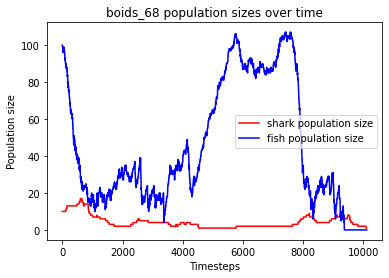

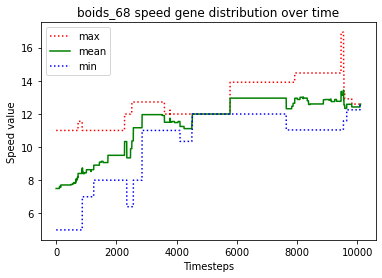

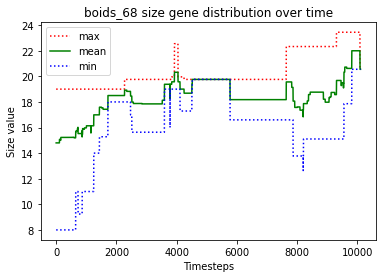

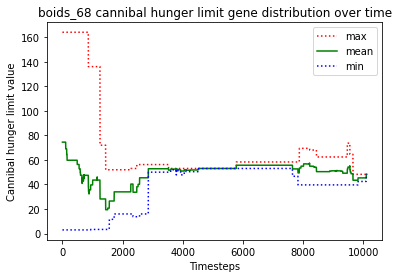

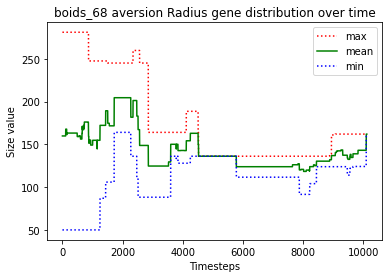

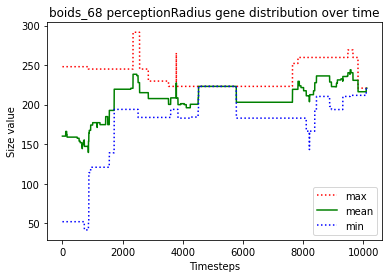

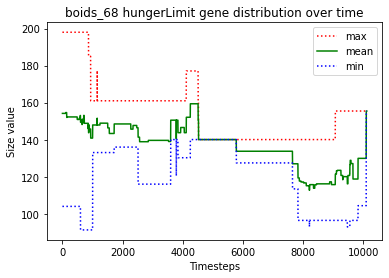





						BOIDS_69

predator_0 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_4 starved to death
predator_11 killed predator_7
predator_10 ate the carcass of predator_4_carcass
predator_1 just gave birth to predator_12
predator_10 starved to death
predator_0 ate the carcass of predator_10_carcass
predator_9 starved to death
predator_2 starved to death
predator_8 ate the carcass of predator_9_carcass
predator_11 starved to death
predator_3 ate the carcass of predator_2_carcass
predator_3 just gave birth to predator_13
predator_0 ate the carcass of predator_11_carcass
predator_3 just gave birth to predator_14
predator_5 just gave birth to predator_15
predator_15 just gave birth to predator_16
predator_3 killed predator_13
predator_0 starved to death
predator_14 ate the carcass of predator_0_carcass
predator_16 killed predator_8
predator_5 killed predator_3
predator_1 starved to death
predator_14 ate the carcass of predator_1_carcass
predator_16 killed p

predator_64 starved to death
predator_60 starved to death
predator_72 starved to death
predator_69 ate the carcass of predator_60_carcass
predator_70 ate the carcass of predator_64_carcass
predator_69 ate the carcass of predator_62_carcass
predator_55 ate the carcass of predator_71_carcass
predator_69 ate the carcass of predator_57_carcass
predator_69 ate the carcass of predator_72_carcass
predator_70 just gave birth to predator_73
predator_73 starved to death
predator_69 ate the carcass of predator_73_carcass
predator_69 just gave birth to predator_74
predator_55 just gave birth to predator_75
predator_49 just gave birth to predator_76
predator_75 just gave birth to predator_77
predator_69 just gave birth to predator_78
predator_74 just gave birth to predator_79
predator_76 killed predator_70
predator_69 just gave birth to predator_80
predator_76 killed predator_55
predator_78 just gave birth to predator_81
predator_76 killed predator_77
predator_76 just gave birth to predator_82
pred

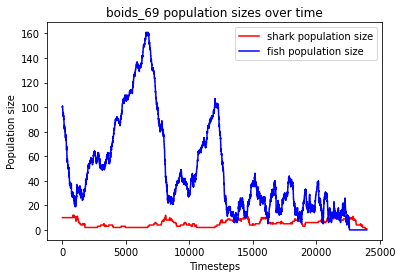

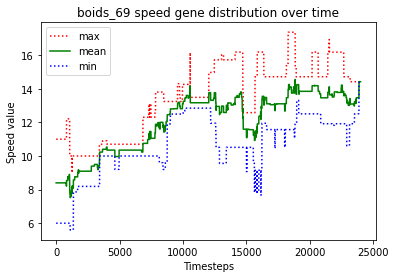

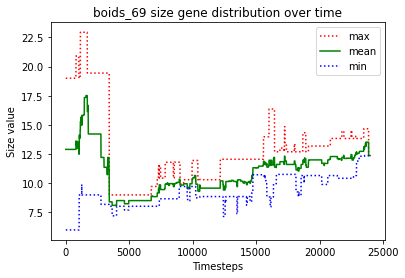

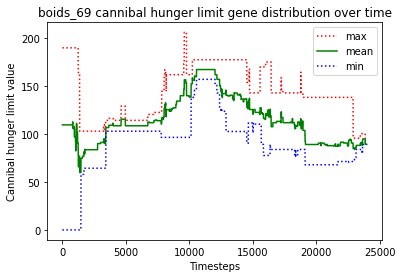

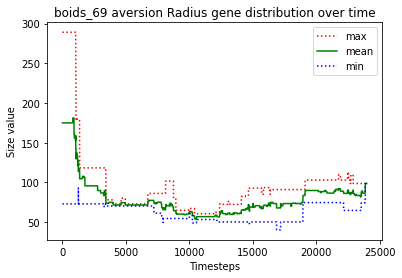

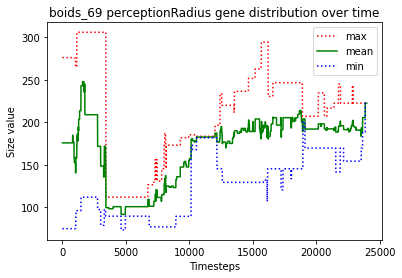

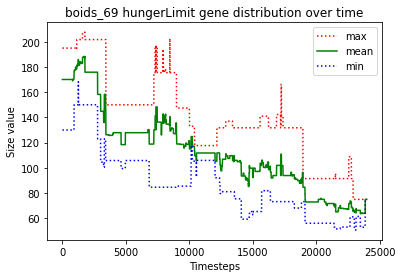





						BOIDS_70

predator_2 killed predator_6
predator_1 just gave birth to predator_10
predator_2 killed predator_4
predator_1 killed predator_5
predator_0 just gave birth to predator_11
predator_1 killed predator_3
predator_7 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_8 killed predator_14
predator_7 killed predator_10
predator_13 starved to death
predator_12 ate the carcass of predator_13_carcass
predator_2 just gave birth to predator_15
predator_7 killed predator_12
predator_0 starved to death
predator_8 just gave birth to predator_16
predator_7 ate the carcass of predator_0_carcass
predator_7 just gave birth to predator_17
predator_17 starved to death
predator_7 starved to death
predator_1 starved to death
predator_8 ate the carcass of predator_17_carcass
predator_2 ate the carcass of predator_1_carcass
predator_15 ate the carcass of predator_7_carcass
predator_11 just gave birth to predator_18
pred

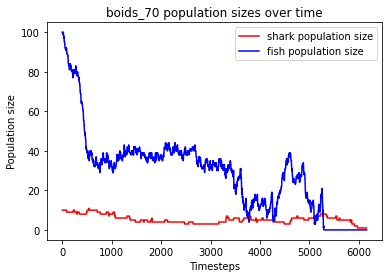

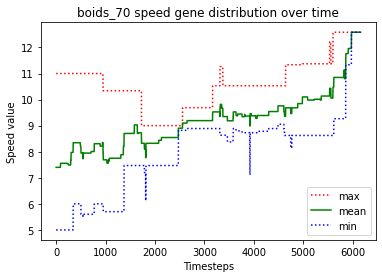

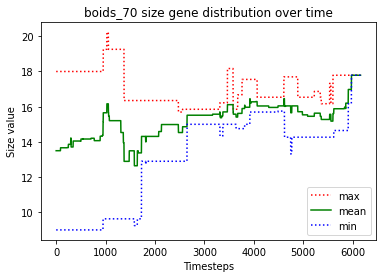

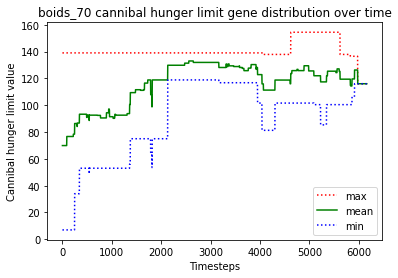

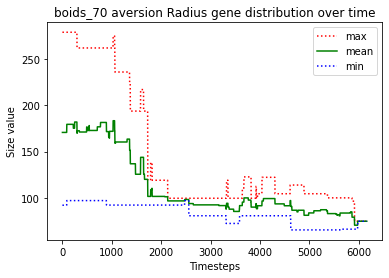

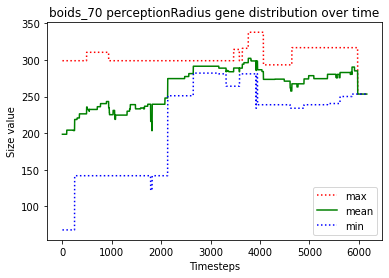

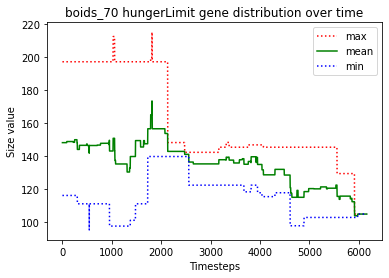





						BOIDS_71

predator_3 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_3 starved to death
predator_2 ate the carcass of predator_3_carcass
predator_12 starved to death
predator_13 just gave birth to predator_14
predator_13 ate the carcass of predator_12_carcass
predator_10 starved to death
predator_4 just gave birth to predator_15
predator_5 ate the carcass of predator_10_carcass
predator_14 starved to death
predator_7 just gave birth to predator_16
predator_5 ate the carcass of predator_14_carcass
predator_16 starved to death
predator_7 starved to death
predator_9 ate the carcass of predator_16_carcass
predator_8 ate the carcass of predator_7_carcass
predator_1 starved to death
predator_11 starved to death
predator_15 just gave birth to predator_17
predator_8 ate the carcass of predator_11_carcass
predator_15 starved to death
predator_5 ate the carcass of preda

predator_41 just gave birth to predator_69
predator_68 starved to death
predator_58 starved to death
predator_28 ate the carcass of predator_68_carcass
predator_64 just gave birth to predator_70
predator_64 starved to death
predator_70 ate the carcass of predator_64_carcass
predator_70 ate the carcass of predator_58_carcass
predator_41 just gave birth to predator_71
predator_67 starved to death
predator_71 ate the carcass of predator_67_carcass
predator_71 just gave birth to predator_72
predator_41 just gave birth to predator_73
predator_73 killed predator_69
predator_72 killed predator_28
predator_41 starved to death
predator_73 ate the carcass of predator_41_carcass
predator_71 just gave birth to predator_74
predator_71 starved to death
predator_74 just gave birth to predator_75
predator_75 ate the carcass of predator_71_carcass
predator_72 just gave birth to predator_76
predator_70 just gave birth to predator_77
predator_73 just gave birth to predator_78
predator_78 killed predator_

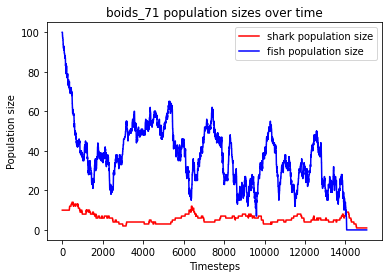

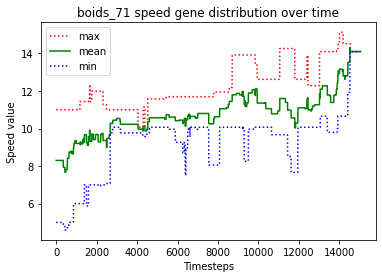

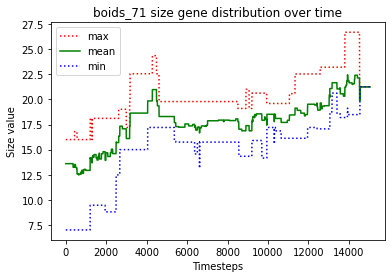

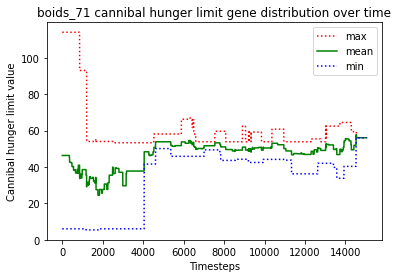

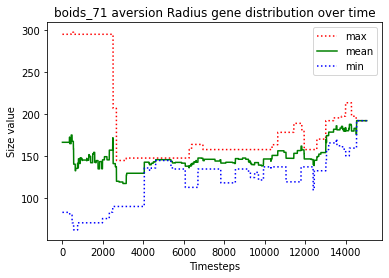

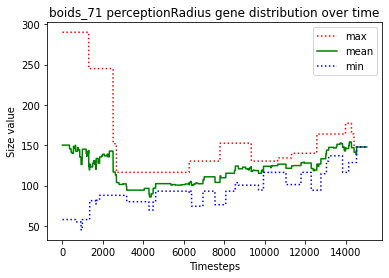

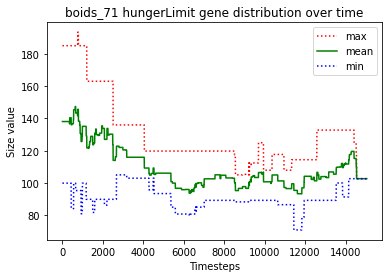





						BOIDS_72

predator_6 just gave birth to predator_10
predator_8 killed predator_1
predator_3 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_15 starved to death
predator_10 starved to death
predator_0 ate the carcass of predator_15_carcass
predator_8 ate the carcass of predator_10_carcass
predator_14 just gave birth to predator_16
predator_0 just gave birth to predator_17
predator_13 starved to death
predator_0 ate the carcass of predator_13_carcass
predator_16 just gave birth to predator_18
predator_11 starved to death
predator_8 ate the carcass of predator_11_carcass
predator_16 starved to death
predator_18 starved to death
predator_3 starved to death
predator_17 ate the carcass of predator_3_carcass
predator_8 ate the carcass of predator_18_carcass
predator_9 just gave birth to predator_19
predator_8 ate the carcas

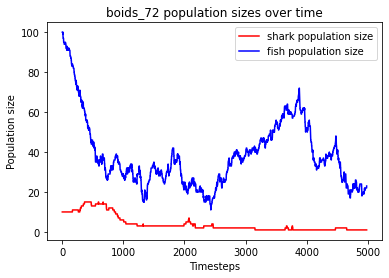

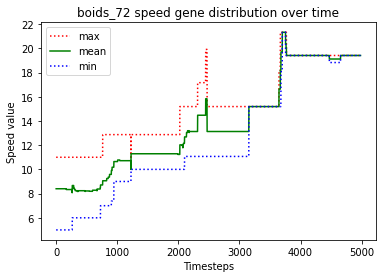

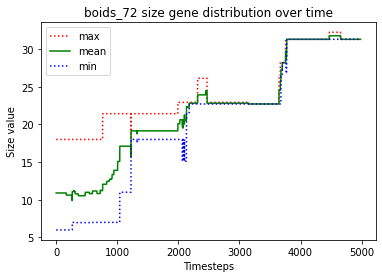

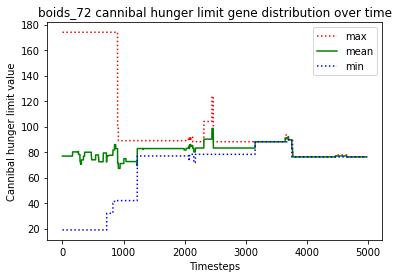

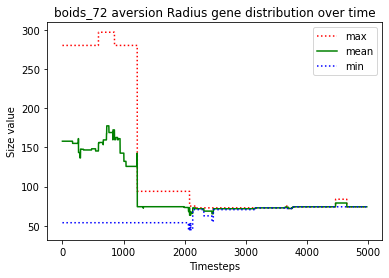

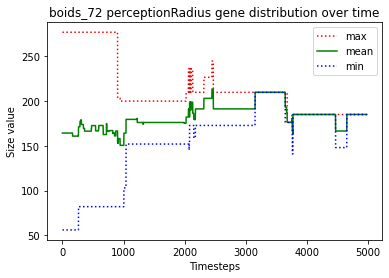

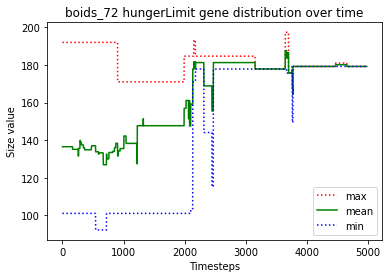





						BOIDS_73

predator_0 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_0 killed predator_7
predator_8 killed predator_6
predator_5 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_10 killed predator_13
predator_4 just gave birth to predator_14
predator_0 killed predator_2
predator_0 killed predator_4
predator_11 just gave birth to predator_15
predator_5 just gave birth to predator_16
predator_14 killed predator_9
predator_15 starved to death
predator_11 starved to death
predator_12 just gave birth to predator_17
predator_12 ate the carcass of predator_15_carcass
predator_1 just gave birth to predator_18
predator_17 ate the carcass of predator_11_carcass
predator_12 just gave birth to predator_19
predator_5 starved to death
predator_10 ate the carcass of predator_5_carcass
no fish to move
predator_0 starved to death
predator_10 ate the carcass of predator_0_carcass
predator_16 starved to death
predator_8 ate th

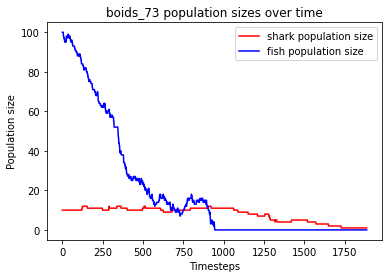

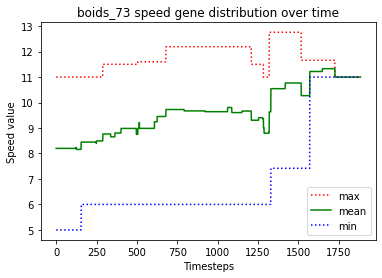

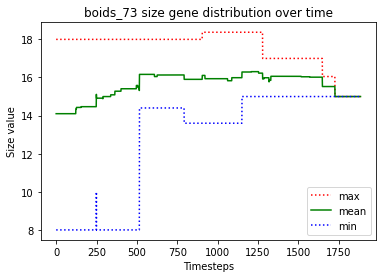

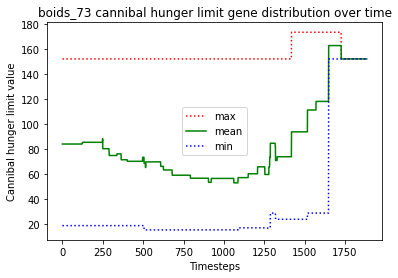

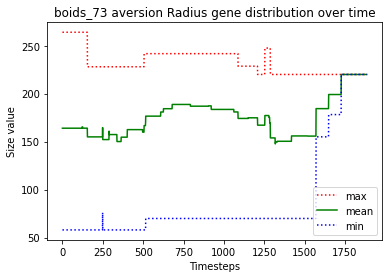

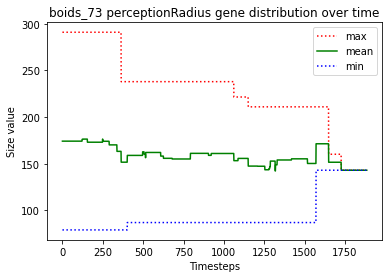

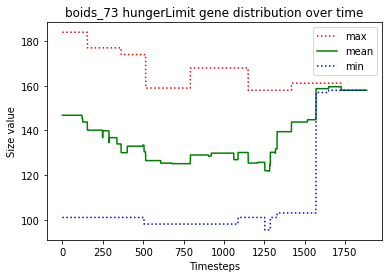





						BOIDS_74

predator_6 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_7 killed predator_4
predator_11 killed predator_9
predator_10 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_12 starved to death
predator_8 just gave birth to predator_14
predator_10 ate the carcass of predator_12_carcass
predator_0 just gave birth to predator_15
predator_10 starved to death
predator_11 ate the carcass of predator_10_carcass
predator_6 starved to death
predator_8 ate the carcass of predator_6_carcass
predator_1 starved to death
predator_13 starved to death
predator_5 ate the carcass of predator_1_carcass
predator_2 ate the carcass of predator_13_carcass
predator_7 just gave birth to predator_16
predator_7 starved to death
predator_16 starved to death
predator_2 ate the carcass of predator_16_carcass
predator_8 just gave birth to predator_17
predator_8 killed predator_3
predator_17 starved to death
predator_2 ate the carcass

predator_35 ate the carcass of predator_68_carcass
predator_65 just gave birth to predator_71
predator_61 just gave birth to predator_72
predator_63 just gave birth to predator_73
predator_69 ate the carcass of predator_53_carcass
predator_54 ate the carcass of predator_67_carcass
predator_35 just gave birth to predator_74
predator_66 killed predator_72
predator_63 starved to death
predator_60 starved to death
predator_73 starved to death
predator_28 ate the carcass of predator_73_carcass
predator_69 starved to death
predator_35 ate the carcass of predator_63_carcass
predator_71 ate the carcass of predator_60_carcass
predator_66 starved to death
predator_61 ate the carcass of predator_66_carcass
predator_65 ate the carcass of predator_69_carcass
predator_71 just gave birth to predator_75
predator_75 starved to death
predator_54 ate the carcass of predator_75_carcass
predator_61 starved to death
predator_71 just gave birth to predator_76
predator_54 ate the carcass of predator_61_carcas

predator_116 starved to death
predator_121 ate the carcass of predator_116_carcass
predator_125 starved to death
predator_121 ate the carcass of predator_124_carcass
predator_121 ate the carcass of predator_125_carcass
predator_131 starved to death
predator_74 ate the carcass of predator_131_carcass
predator_130 starved to death
predator_111 ate the carcass of predator_130_carcass
predator_85 starved to death
predator_112 ate the carcass of predator_85_carcass
predator_121 just gave birth to predator_132
predator_112 just gave birth to predator_133
predator_114 starved to death
predator_111 ate the carcass of predator_114_carcass
predator_133 just gave birth to predator_134
predator_111 just gave birth to predator_135
predator_134 starved to death
predator_133 starved to death
predator_132 ate the carcass of predator_134_carcass
predator_132 just gave birth to predator_136
predator_135 just gave birth to predator_137
predator_112 just gave birth to predator_138
predator_132 ate the car

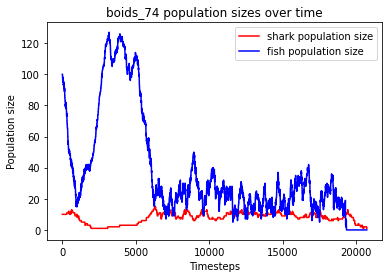

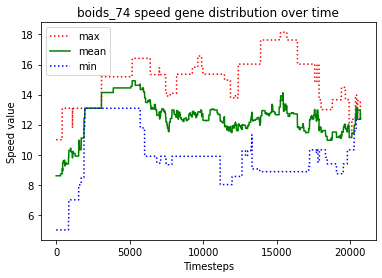

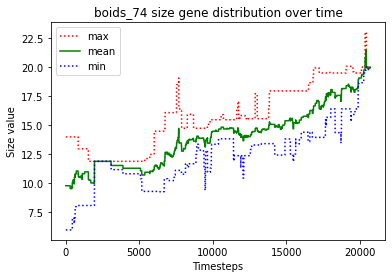

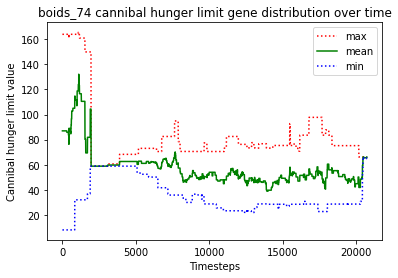

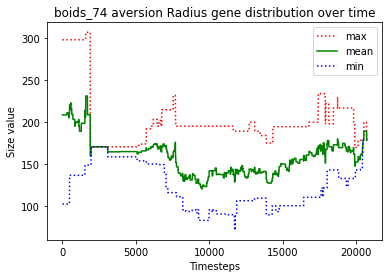

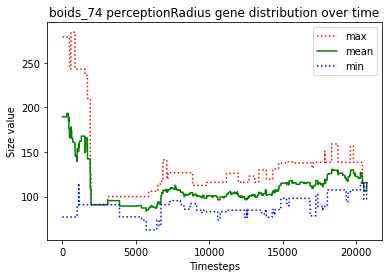

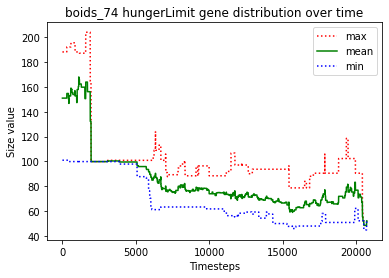





						BOIDS_75

predator_0 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_12 killed predator_10
predator_8 killed predator_2
predator_12 killed predator_11
predator_3 starved to death
predator_1 ate the carcass of predator_3_carcass
predator_12 just gave birth to predator_13
predator_5 starved to death
predator_8 killed predator_7
predator_1 ate the carcass of predator_5_carcass
predator_13 starved to death
predator_9 just gave birth to predator_14
predator_12 ate the carcass of predator_13_carcass
predator_9 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_14 killed predator_0
predator_1 starved to death
predator_14 ate the carcass of predator_1_carcass
predator_4 starved to death
predator_14 killed predator_6
predator_8 starved to death
predator_15 starved to death
predator_14 ate the carcass of predator_15_carcass
predator_14 ate the carcass of predator_4_carcass
predato

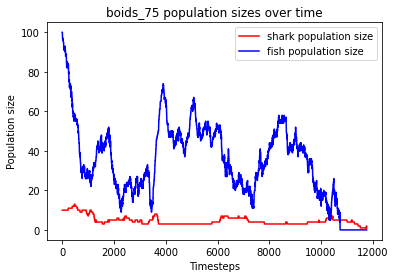

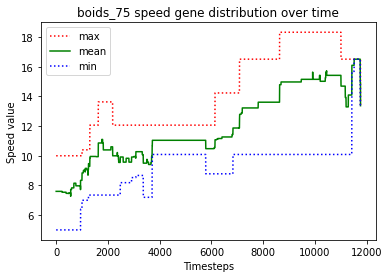

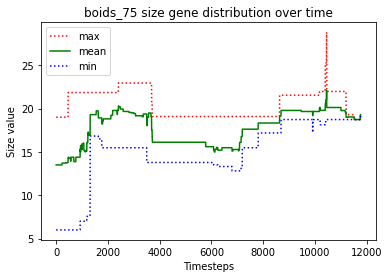

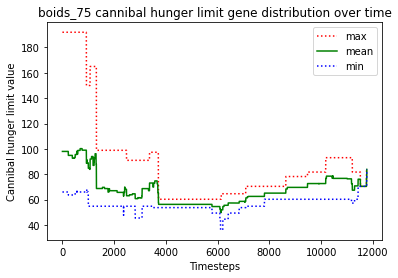

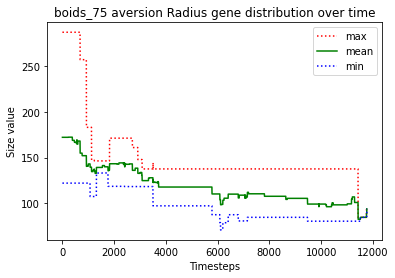

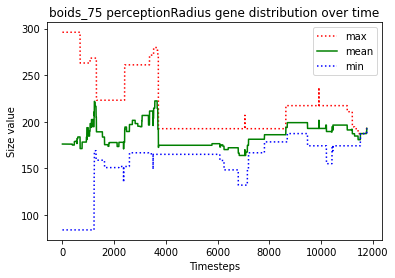

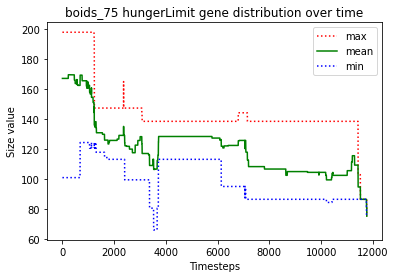





						BOIDS_76

predator_9 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_9 starved to death
predator_5 just gave birth to predator_12
predator_8 ate the carcass of predator_9_carcass
predator_10 starved to death
predator_3 ate the carcass of predator_10_carcass
predator_12 starved to death
predator_6 ate the carcass of predator_12_carcass
predator_11 starved to death
predator_5 starved to death
predator_2 ate the carcass of predator_5_carcass
predator_6 ate the carcass of predator_11_carcass
predator_8 just gave birth to predator_13
predator_13 killed predator_3
predator_13 just gave birth to predator_14
predator_14 killed predator_2
predator_13 killed predator_0
predator_13 killed predator_4
predator_1 just gave birth to predator_15
predator_1 starved to death
predator_7 ate the carcass of predator_1_carcass
predator_15 starved to death
predator_14 killed predator_6
predator_8 just gave birth to predator_16
predator_13 starved to death
predator_

predator_57 starved to death
predator_44 ate the carcass of predator_57_carcass
predator_69 just gave birth to predator_70
predator_70 just gave birth to predator_71
predator_58 starved to death
predator_44 starved to death
predator_68 ate the carcass of predator_44_carcass
predator_68 ate the carcass of predator_58_carcass
predator_70 just gave birth to predator_72
predator_68 just gave birth to predator_73
predator_72 killed predator_69
predator_61 starved to death
predator_72 ate the carcass of predator_61_carcass
predator_70 killed predator_73
predator_71 just gave birth to predator_74
predator_70 just gave birth to predator_75
predator_74 starved to death
predator_72 ate the carcass of predator_74_carcass
predator_71 just gave birth to predator_76
predator_70 starved to death
predator_75 starved to death
predator_71 starved to death
predator_68 just gave birth to predator_77
predator_76 starved to death
predator_68 ate the carcass of predator_70_carcass
predator_72 just gave birth

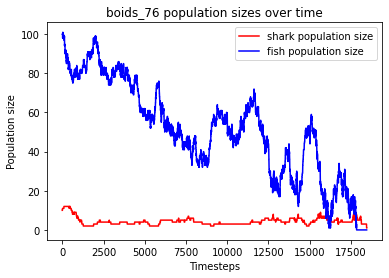

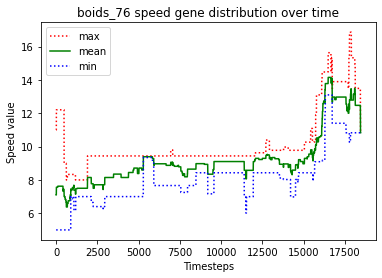

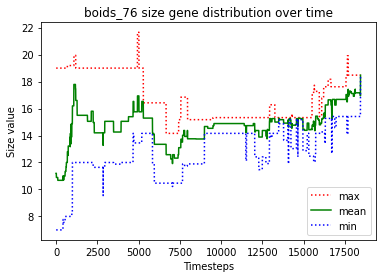

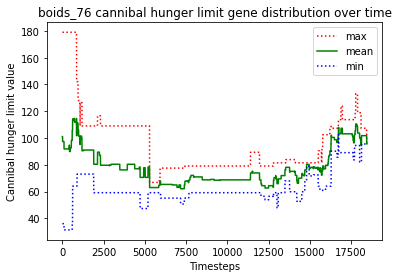

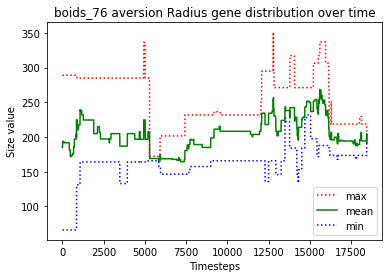

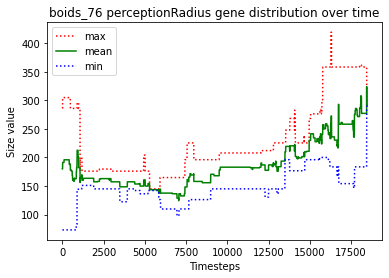

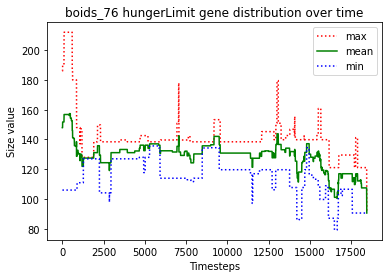





						BOIDS_77

predator_7 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_1 killed predator_4
predator_11 starved to death
predator_6 ate the carcass of predator_11_carcass
predator_13 just gave birth to predator_14
predator_13 starved to death
predator_14 starved to death
predator_6 ate the carcass of predator_13_carcass
predator_6 ate the carcass of predator_14_carcass
predator_8 just gave birth to predator_15
predator_10 starved to death
predator_7 starved to death
predator_1 ate the carcass of predator_10_carcass
predator_6 ate the carcass of predator_7_carcass
predator_1 just gave birth to predator_16
predator_1 killed predator_0
predator_15 starved to death
predator_8 ate the carcass of predator_15_carcass
predator_8 starved to death
predator_5 ate the carcass of predator_8_carcass
predator_12 starved to death
predator_1 ate the carcass of predator_12_carcas

predator_71 just gave birth to predator_72
predator_61 just gave birth to predator_73
predator_72 starved to death
predator_71 starved to death
predator_70 ate the carcass of predator_72_carcass
predator_50 ate the carcass of predator_71_carcass
predator_29 just gave birth to predator_74
predator_29 killed predator_74
predator_70 starved to death
predator_73 ate the carcass of predator_70_carcass
predator_60 just gave birth to predator_75
predator_60 starved to death
predator_75 starved to death
predator_73 starved to death
predator_61 ate the carcass of predator_73_carcass
predator_61 ate the carcass of predator_75_carcass
predator_61 ate the carcass of predator_60_carcass
predator_50 just gave birth to predator_76
predator_61 just gave birth to predator_77
predator_29 just gave birth to predator_78
predator_77 killed predator_76
predator_61 just gave birth to predator_79
predator_77 killed predator_29
predator_78 just gave birth to predator_80
predator_77 just gave birth to predator_

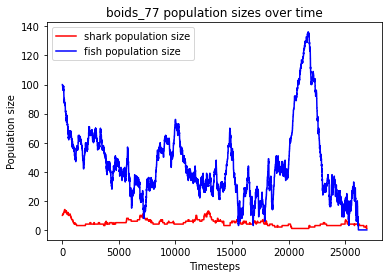

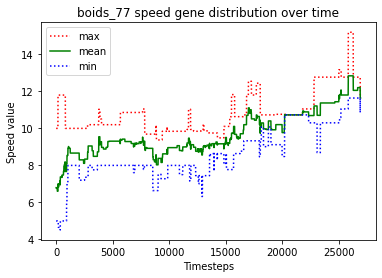

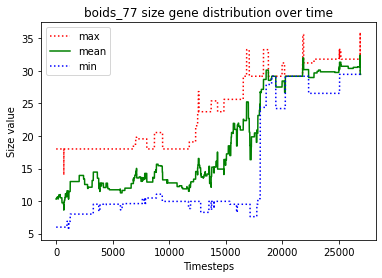

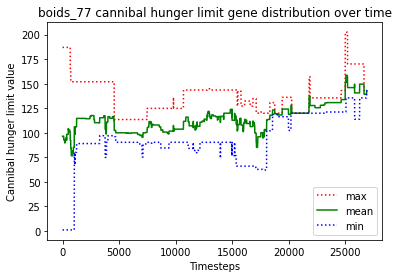

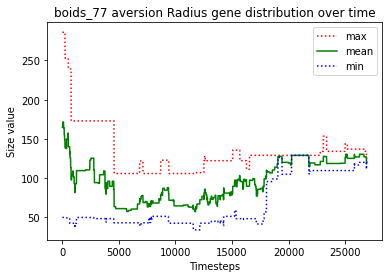

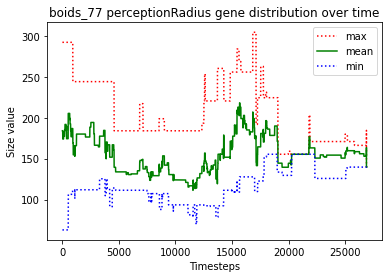

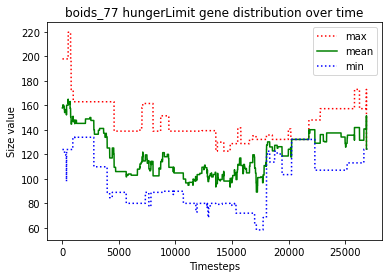





						BOIDS_78

predator_4 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_12 starved to death
predator_3 ate the carcass of predator_12_carcass
predator_4 starved to death
predator_0 just gave birth to predator_13
predator_11 ate the carcass of predator_4_carcass
predator_10 starved to death
predator_1 ate the carcass of predator_10_carcass
predator_0 just gave birth to predator_14
predator_7 starved to death
predator_2 ate the carcass of predator_7_carcass
predator_3 just gave birth to predator_15
predator_5 just gave birth to predator_16
predator_15 killed predator_8
predator_3 killed predator_1
predator_16 just gave birth to predator_17
predator_14 starved to death
predator_0 starved to death
predator_6 ate the carcass of predator_0_carcass
predator_13 just gave birth to predator_18
predator_15 killed predator_9
predator_11 ate the carcass of predator_14_carcass
predator_6 just gave birth to predator_19

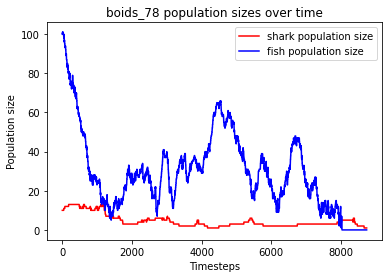

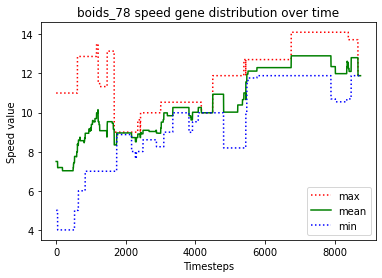

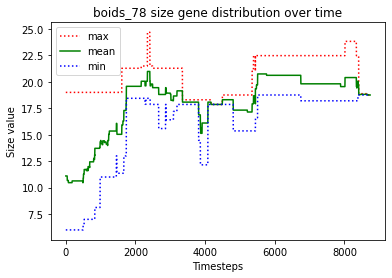

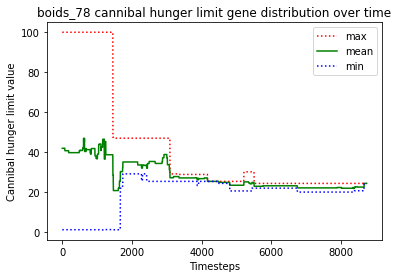

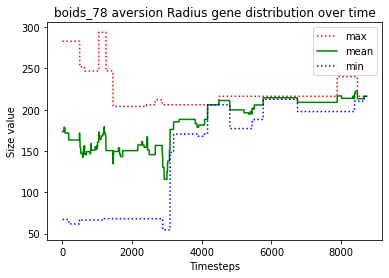

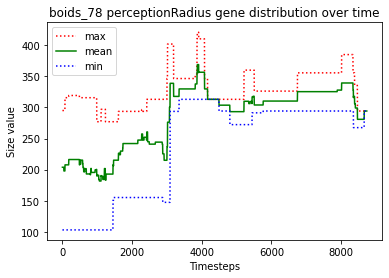

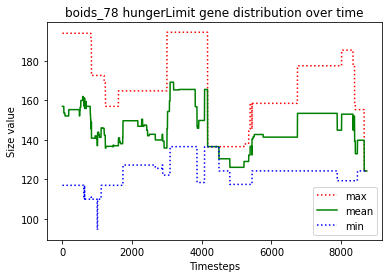





						BOIDS_79

predator_8 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_10 killed predator_12
predator_11 killed predator_0
predator_8 killed predator_3
predator_10 killed predator_11
predator_6 killed predator_4
predator_8 starved to death
predator_10 killed predator_2
predator_10 killed predator_7
predator_13 ate the carcass of predator_8_carcass
predator_13 killed predator_6
predator_9 starved to death
predator_10 just gave birth to predator_14
predator_5 ate the carcass of predator_9_carcass
predator_10 starved to death
predator_13 ate the carcass of predator_10_carcass
predator_14 starved to death
predator_1 ate the carcass of predator_14_carcass
predator_13 just gave birth to predator_15
predator_13 starved to death
predator_15 ate the carcass of predator_13_carcass
predator_15 killed predator_5
predator_1 just gave birth to predator_16
predator_1 just gave

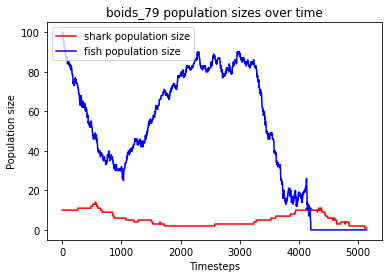

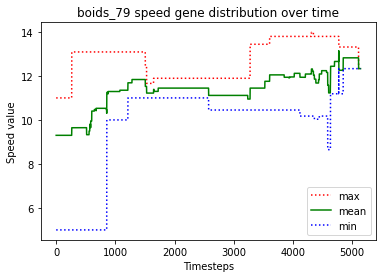

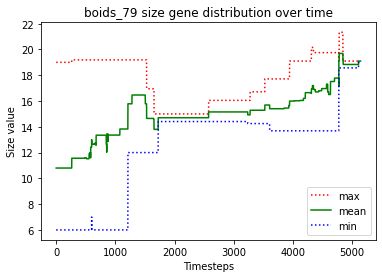

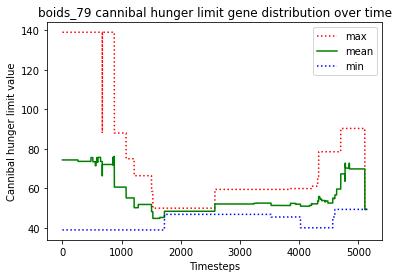

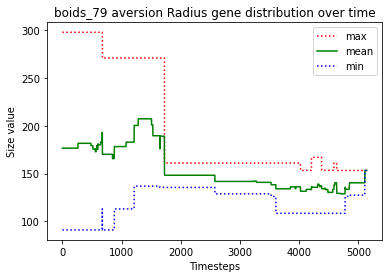

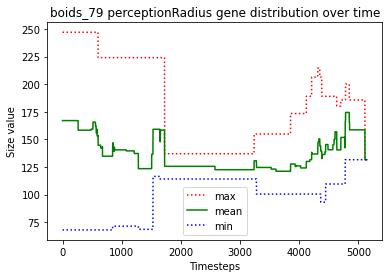

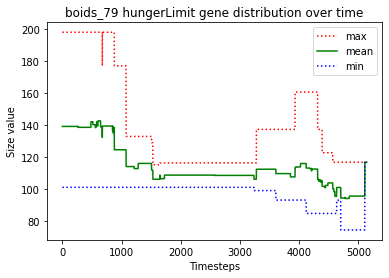





						BOIDS_80

predator_6 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_6 starved to death
predator_13 starved to death
predator_8 ate the carcass of predator_6_carcass
predator_4 starved to death
predator_12 starved to death
predator_11 starved to death
predator_9 ate the carcass of predator_4_carcass
predator_10 starved to death
predator_3 ate the carcass of predator_12_carcass
predator_9 ate the carcass of predator_10_carcass
predator_7 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_9 ate the carcass of predator_7_carcass
predator_0 just gave birth to predator_14
predator_9 ate the carcass of predator_11_carcass
predator_14 just gave birth to predator_15
predator_15 starved to death
predator_14 starved to death
predator_2 ate the carcass of predator_15_carcass
predator_0 ate the carcass of predator_14_carcass
predator_5 just gave 

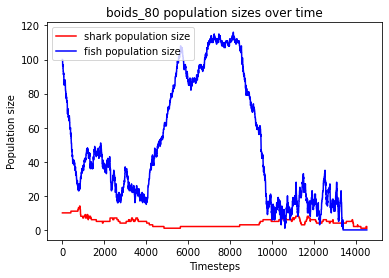

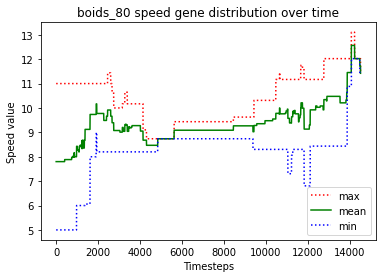

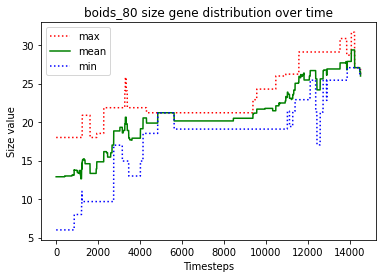

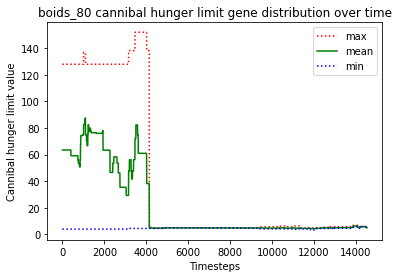

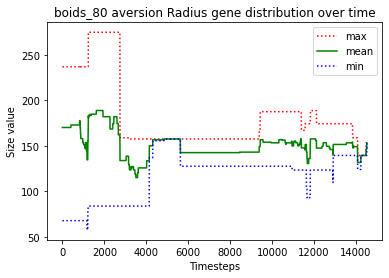

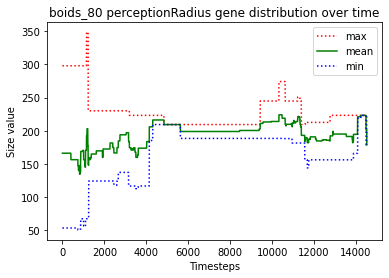

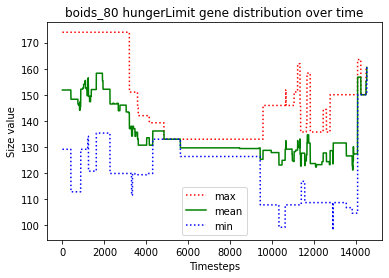





						BOIDS_81

predator_3 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_0 killed predator_6
predator_12 killed predator_8
predator_9 just gave birth to predator_13
predator_11 starved to death
predator_2 ate the carcass of predator_11_carcass
predator_4 just gave birth to predator_14
predator_2 just gave birth to predator_15
predator_10 just gave birth to predator_16
predator_12 killed predator_5
predator_2 just gave birth to predator_17
predator_13 starved to death
predator_9 starved to death
predator_12 ate the carcass of predator_9_carcass
predator_3 just gave birth to predator_18
predator_4 ate the carcass of predator_13_carcass
predator_17 starved to death
predator_3 ate the carcass of predator_17_carcass
predator_2 starved to death
predator_14 just gave birth to predator_19
predator_15 ate the carcass of predator_2_carcass
predator_14 starved to death
predator_16 just gave birth to predator_20
pred

predator_71 starved to death
predator_66 ate the carcass of predator_71_carcass
predator_72 starved to death
predator_68 ate the carcass of predator_72_carcass
predator_66 just gave birth to predator_73
predator_59 just gave birth to predator_74
predator_61 just gave birth to predator_75
predator_68 killed predator_75
predator_73 just gave birth to predator_76
predator_76 starved to death
predator_66 ate the carcass of predator_76_carcass
predator_73 starved to death
predator_56 starved to death
predator_58 starved to death
predator_74 just gave birth to predator_77
predator_64 ate the carcass of predator_73_carcass
predator_74 starved to death
predator_77 starved to death
predator_66 just gave birth to predator_78
predator_61 just gave birth to predator_79
predator_61 ate the carcass of predator_58_carcass
predator_64 just gave birth to predator_80
predator_68 ate the carcass of predator_56_carcass
predator_64 killed predator_79
predator_78 ate the carcass of predator_74_carcass
preda

predator_90 ate the carcass of predator_115_carcass
predator_126 just gave birth to predator_133
predator_129 killed predator_133
predator_129 just gave birth to predator_134
predator_129 killed predator_134
predator_90 just gave birth to predator_135
predator_135 just gave birth to predator_136
predator_129 just gave birth to predator_137
predator_125 just gave birth to predator_138
predator_125 killed predator_138
predator_137 just gave birth to predator_139
predator_136 killed predator_106
predator_139 starved to death
predator_137 ate the carcass of predator_139_carcass
predator_135 just gave birth to predator_140
predator_140 starved to death
predator_135 starved to death
predator_127 ate the carcass of predator_140_carcass
predator_127 ate the carcass of predator_135_carcass
predator_137 starved to death
predator_125 ate the carcass of predator_137_carcass
predator_129 just gave birth to predator_141
predator_125 just gave birth to predator_142
predator_142 killed predator_126
pr

predator_186 just gave birth to predator_196
predator_194 starved to death
predator_186 starved to death
predator_190 just gave birth to predator_197
predator_195 starved to death
predator_196 starved to death
predator_193 ate the carcass of predator_186_carcass
predator_191 ate the carcass of predator_196_carcass
predator_176 just gave birth to predator_198
predator_193 just gave birth to predator_199
predator_187 ate the carcass of predator_195_carcass
predator_176 just gave birth to predator_200
predator_200 ate the carcass of predator_194_carcass
predator_198 just gave birth to predator_201
predator_198 starved to death
predator_201 starved to death
predator_192 starved to death
predator_187 ate the carcass of predator_201_carcass
predator_190 ate the carcass of predator_192_carcass
predator_176 starved to death
predator_193 ate the carcass of predator_198_carcass
predator_187 just gave birth to predator_202
predator_187 ate the carcass of predator_176_carcass
predator_197 starved 

predator_252 ate the carcass of predator_253_carcass
predator_251 just gave birth to predator_254
predator_241 killed predator_254
predator_241 killed predator_252
predator_241 just gave birth to predator_255
predator_241 killed predator_255
predator_251 just gave birth to predator_256
predator_241 just gave birth to predator_257
predator_257 killed predator_256
predator_251 just gave birth to predator_258
predator_241 killed predator_258
predator_257 killed predator_251
predator_241 just gave birth to predator_259
predator_259 starved to death
predator_257 ate the carcass of predator_259_carcass
predator_257 just gave birth to predator_260
predator_241 starved to death
predator_257 ate the carcass of predator_241_carcass
predator_257 just gave birth to predator_261
predator_261 starved to death
predator_257 ate the carcass of predator_261_carcass
predator_260 starved to death
predator_257 ate the carcass of predator_260_carcass
predator_257 just gave birth to predator_262
predator_262

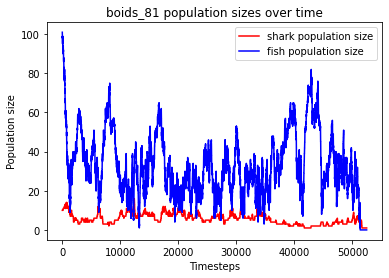

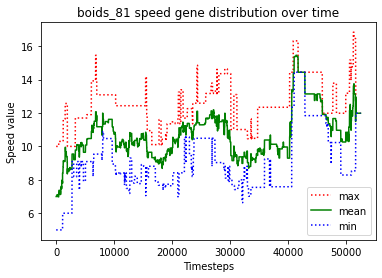

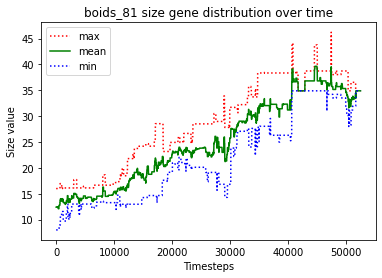

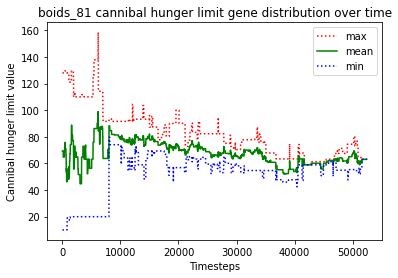

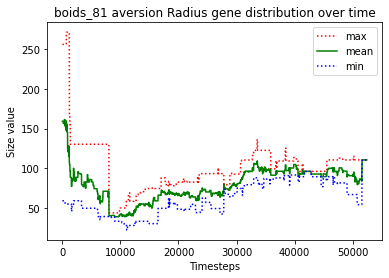

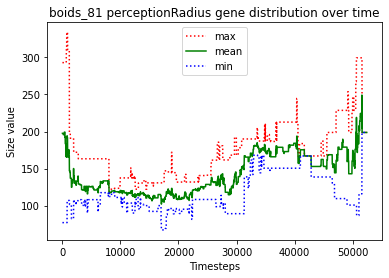

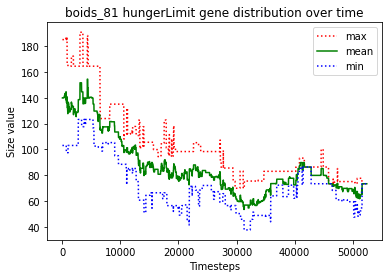





						BOIDS_82

predator_4 killed predator_0
predator_1 just gave birth to predator_10
predator_1 killed predator_8
predator_1 just gave birth to predator_11
predator_10 killed predator_2
predator_10 killed predator_3
predator_10 killed predator_9
predator_1 killed predator_6
predator_10 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_10 starved to death
predator_11 ate the carcass of predator_10_carcass
predator_1 starved to death
predator_12 ate the carcass of predator_1_carcass
predator_7 just gave birth to predator_15
predator_4 starved to death
predator_14 just gave birth to predator_16
predator_13 just gave birth to predator_17
predator_16 starved to death
predator_14 starved to death
predator_12 ate the carcass of predator_4_carcass
predator_17 just gave birth to predator_18
predator_17 killed predator_18
predator_7 ate the carcass of predator_14_carcass
predator_12 ate the carcass of predator_16_car

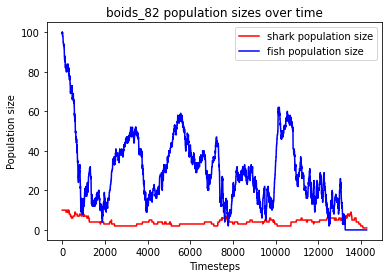

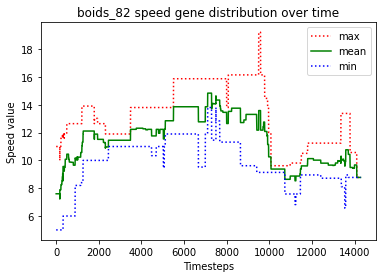

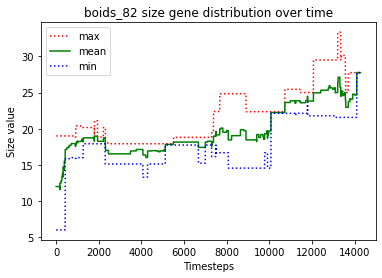

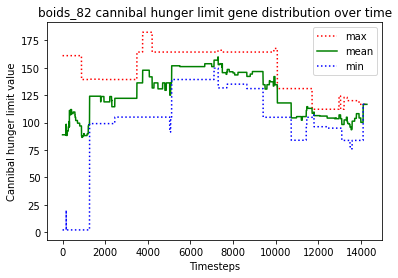

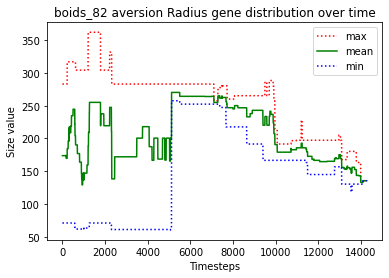

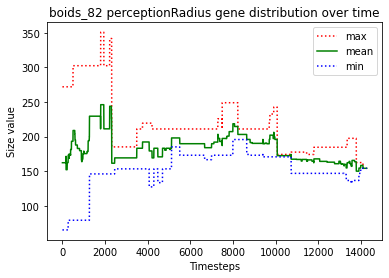

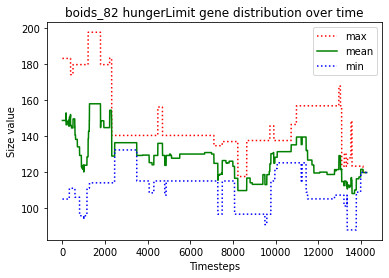





						BOIDS_83

predator_6 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_3 killed predator_4
predator_3 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_5 killed predator_7
predator_1 just gave birth to predator_14
predator_11 starved to death
predator_2 just gave birth to predator_15
predator_10 just gave birth to predator_16
predator_15 just gave birth to predator_17
predator_3 starved to death
predator_12 starved to death
predator_2 killed predator_14
predator_5 killed predator_9
predator_8 ate the carcass of predator_3_carcass
predator_16 ate the carcass of predator_11_carcass
predator_0 ate the carcass of predator_12_carcass
predator_10 starved to death
predator_16 ate the carcass of predator_10_carcass
predator_15 killed predator_1
predator_17 killed predator_2
predator_13 just gave birth to predator_18
predator_13 starved to death
predator_18 starved to death
predator_17 ate the carcass of predator_13_carc

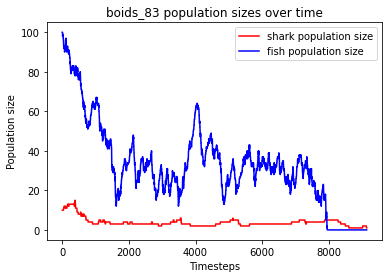

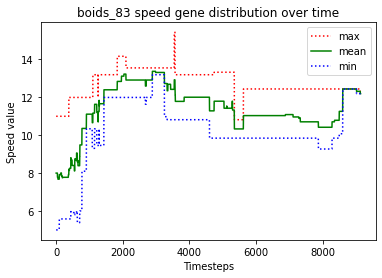

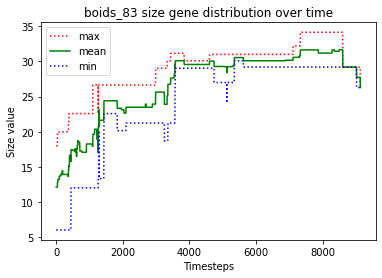

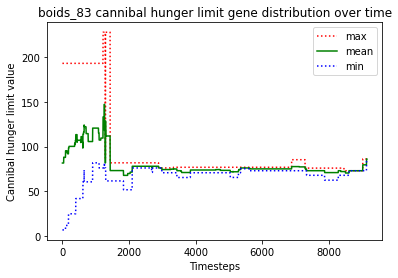

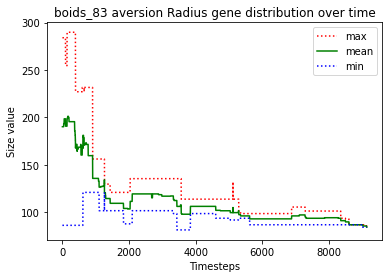

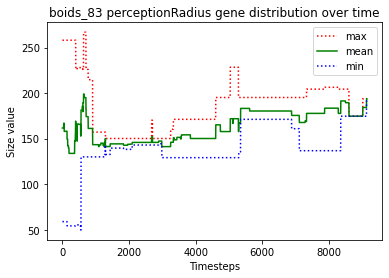

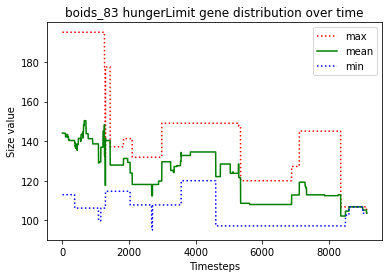





						BOIDS_84

predator_4 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_11 killed predator_10
predator_12 killed predator_4
predator_12 killed predator_6
predator_8 just gave birth to predator_14
predator_14 killed predator_9
predator_14 just gave birth to predator_15
predator_11 starved to death
predator_13 ate the carcass of predator_11_carcass
predator_15 killed predator_0
predator_15 killed predator_8
predator_5 just gave birth to predator_16
predator_15 killed predator_1
predator_2 starved to death
predator_16 ate the carcass of predator_2_carcass
predator_12 just gave birth to predator_17
predator_5 starved to death
predator_17 ate the carcass of predator_5_carcass
predator_12 starved to death
predator_13 ate the carcass of predator_12_carcass
predator_17 starved to death
predator_14 ate the carcass of predator_17_carcass
predator_15 just gave birth to pre

predator_62 starved to death
predator_61 just gave birth to predator_71
predator_67 ate the carcass of predator_62_carcass
predator_71 starved to death
predator_61 starved to death
predator_67 ate the carcass of predator_69_carcass
predator_70 starved to death
predator_67 ate the carcass of predator_61_carcass
predator_67 ate the carcass of predator_71_carcass
predator_67 ate the carcass of predator_70_carcass
predator_67 just gave birth to predator_72
predator_72 starved to death
predator_67 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 73
Timesteps passed: 16731
Fish went extinct at timestep 15585
Sharks went extinct at timestep 16731


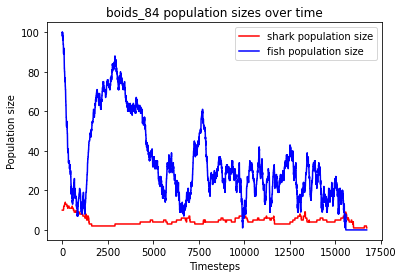

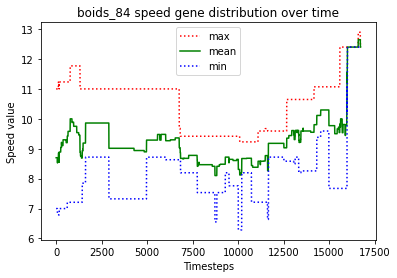

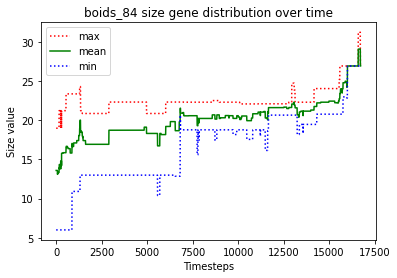

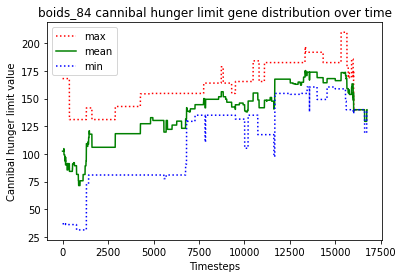

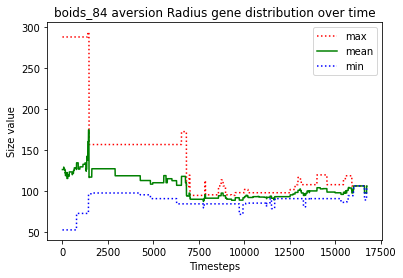

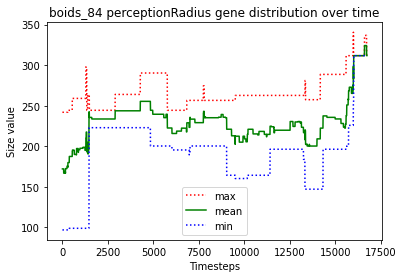

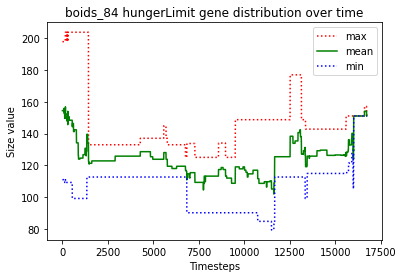





						BOIDS_85

predator_9 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_1 killed predator_6
predator_3 killed predator_2
predator_8 just gave birth to predator_14
predator_4 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_5 starved to death
predator_13 ate the carcass of predator_5_carcass
predator_4 starved to death
predator_7 starved to death
predator_13 starved to death
predator_15 starved to death
predator_11 ate the carcass of predator_13_carcass
predator_0 ate the carcass of predator_7_carcass
predator_0 ate the carcass of predator_15_carcass
predator_11 ate the carcass of predator_4_carcass
predator_16 starved to death
predator_14 ate the carcass of predator_16_carcass
predator_0 just gave birth to predator_17
predator_8 killed predator_10
predator_14 killed predator_3
predator_0 just gave birth to predator_18
predator_9

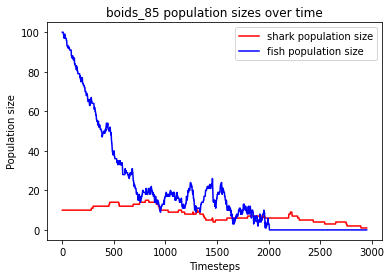

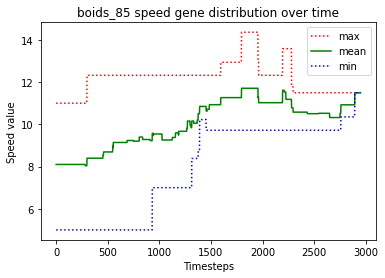

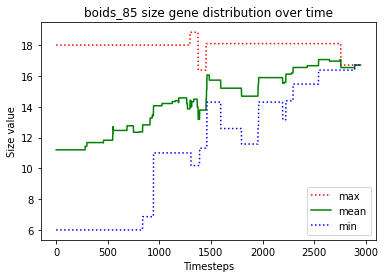

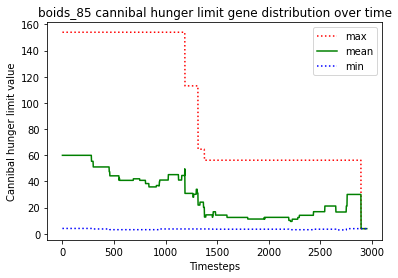

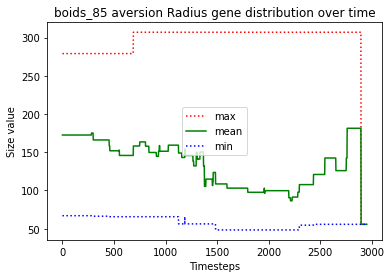

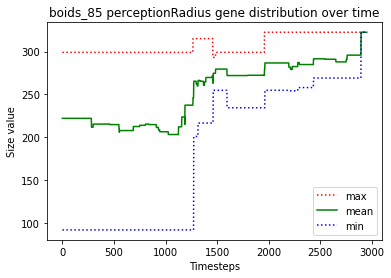

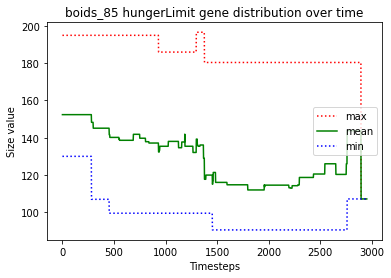





						BOIDS_86

predator_1 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_3 killed predator_9
predator_11 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_0 killed predator_15
predator_11 killed predator_4
predator_13 just gave birth to predator_16
predator_7 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_3 killed predator_18
predator_16 starved to death
predator_14 ate the carcass of predator_16_carcass
predator_17 starved to death
predator_13 starved to death
predator_7 ate the carcass of predator_13_carcass
predator_5 ate the carcass of predator_17_carcass
predator_12 starved to death
predator_3 ate the carcass of predator_12_carcass
predator_11 starved to death
predator_14 ate the carcass of predator_11_carcass
predator_1 starved to death
predator_7 starved to death
predator_3 ate the carcass 

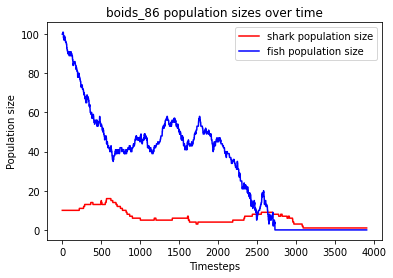

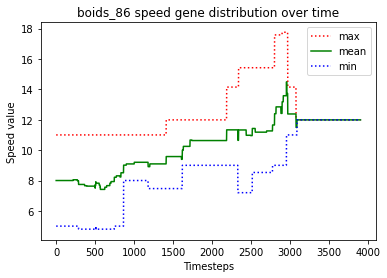

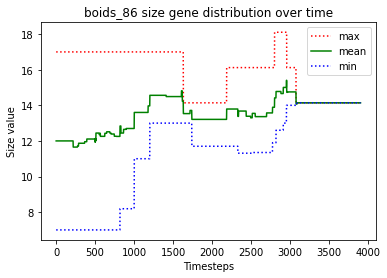

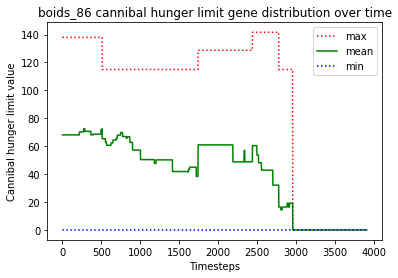

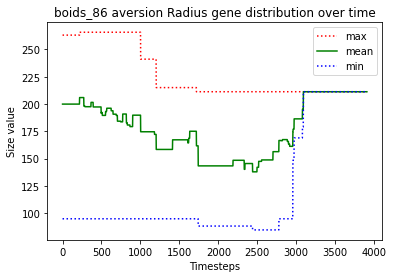

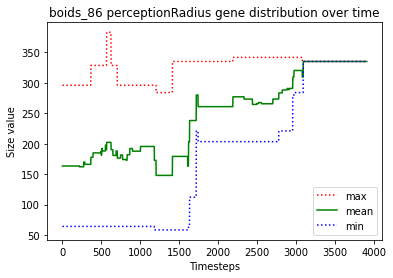

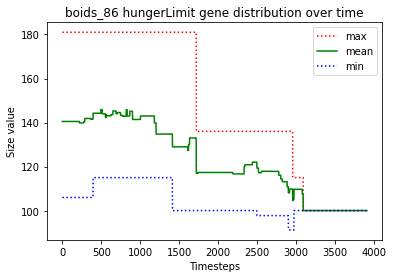





						BOIDS_87

predator_2 just gave birth to predator_10
predator_10 killed predator_8
predator_9 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_11 just gave birth to predator_15
predator_12 killed predator_2
predator_14 killed predator_10
predator_11 starved to death
predator_15 starved to death
predator_5 ate the carcass of predator_15_carcass
predator_13 just gave birth to predator_16
predator_16 starved to death
predator_13 ate the carcass of predator_16_carcass
predator_6 ate the carcass of predator_11_carcass
predator_12 just gave birth to predator_17
predator_12 just gave birth to predator_18
predator_14 starved to death
predator_0 ate the carcass of predator_14_carcass
predator_13 starved to death
predator_12 starved to death
predator_18 starved to death
predator_5 ate the carcass of predator_13_carcass
predator_17 ate the carcass of predator_18_carcass
p

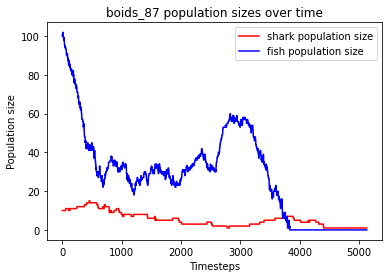

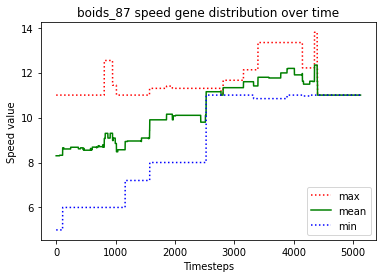

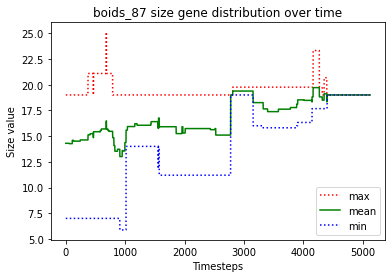

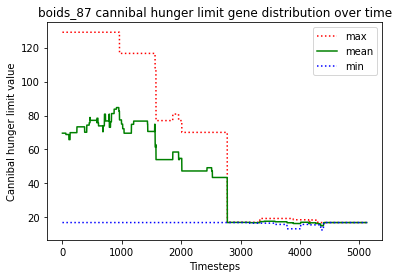

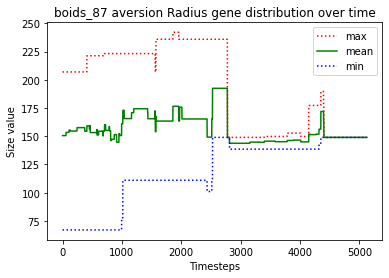

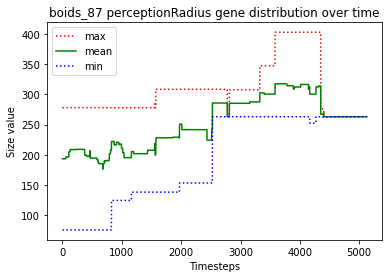

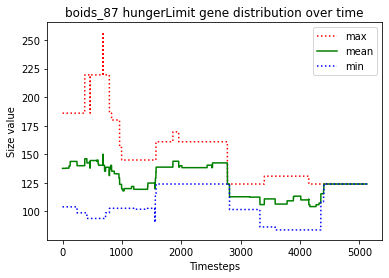





						BOIDS_88

predator_3 killed predator_5
predator_8 just gave birth to predator_10
predator_3 killed predator_7
predator_0 killed predator_2
predator_3 killed predator_4
predator_6 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_0 killed predator_13
predator_11 just gave birth to predator_15
predator_11 just gave birth to predator_16
predator_14 starved to death
predator_11 just gave birth to predator_17
predator_10 starved to death
predator_16 killed predator_1
predator_11 starved to death
predator_17 starved to death
predator_3 ate the carcass of predator_11_carcass
predator_3 ate the carcass of predator_17_carcass
predator_3 ate the carcass of predator_14_carcass
predator_3 ate the carcass of predator_10_carcass
predator_12 starved to death
predator_9 ate the carcass of predator_12_carcass
predator_15 just gave birth to predator_18
predator_15 just gave birt

predator_71 starved to death
predator_72 starved to death
predator_21 ate the carcass of predator_72_carcass
predator_61 just gave birth to predator_73
predator_48 ate the carcass of predator_57_carcass
predator_61 ate the carcass of predator_68_carcass
predator_61 ate the carcass of predator_55_carcass
predator_48 just gave birth to predator_74
predator_70 ate the carcass of predator_71_carcass
predator_61 ate the carcass of predator_65_carcass
predator_61 just gave birth to predator_75
predator_74 just gave birth to predator_76
predator_74 killed predator_76
predator_73 just gave birth to predator_77
predator_73 killed predator_77
predator_75 just gave birth to predator_78
predator_48 starved to death
predator_70 just gave birth to predator_79
predator_21 ate the carcass of predator_48_carcass
predator_73 starved to death
predator_74 starved to death
predator_21 ate the carcass of predator_74_carcass
predator_70 just gave birth to predator_80
predator_61 just gave birth to predator_8

predator_120 starved to death
predator_134 starved to death
predator_132 ate the carcass of predator_120_carcass
predator_118 ate the carcass of predator_134_carcass
predator_129 just gave birth to predator_135
predator_129 killed predator_135
predator_133 just gave birth to predator_136
predator_133 killed predator_136
predator_133 just gave birth to predator_137
predator_129 just gave birth to predator_138
predator_129 just gave birth to predator_139
predator_133 starved to death
predator_139 starved to death
predator_137 ate the carcass of predator_139_carcass
predator_137 ate the carcass of predator_133_carcass
predator_129 starved to death
predator_138 starved to death
predator_137 ate the carcass of predator_138_carcass
predator_125 ate the carcass of predator_129_carcass
predator_118 starved to death
predator_125 ate the carcass of predator_118_carcass
predator_132 just gave birth to predator_140
predator_132 starved to death
predator_125 ate the carcass of predator_132_carcass


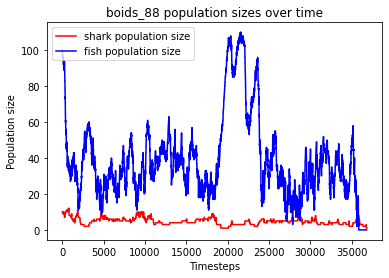

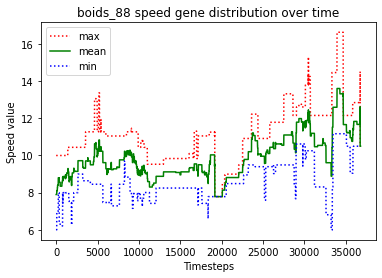

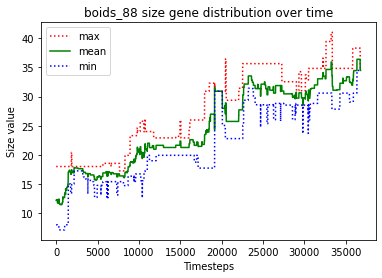

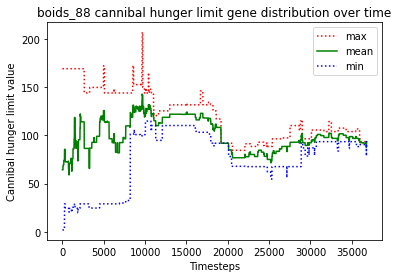

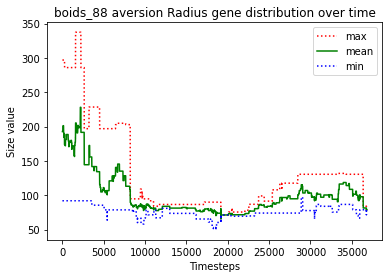

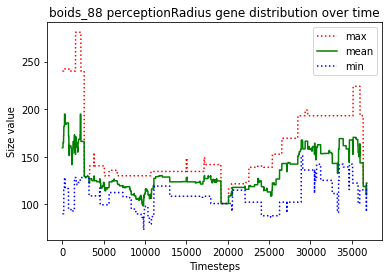

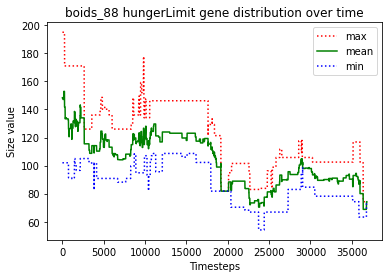





						BOIDS_89

predator_7 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_6 killed predator_11
predator_6 killed predator_9
predator_12 just gave birth to predator_13
predator_10 starved to death
predator_4 just gave birth to predator_14
predator_14 killed predator_1
predator_0 ate the carcass of predator_10_carcass
predator_3 just gave birth to predator_15
predator_12 starved to death
predator_13 starved to death
predator_5 ate the carcass of predator_13_carcass
predator_4 ate the carcass of predator_12_carcass
predator_7 starved to death
predator_15 ate the carcass of predator_7_carcass
predator_0 killed predator_8
predator_2 starved to death
predator_5 ate the carcass of predator_2_carcass
predator_15 starved to death
predator_0 ate the carcass of predator_15_carcass
predator_4 starved to death
predator_5 ate the carcass of predator_4_carcass
predator_6 just gave birth to predator_16
predator_6 killed p

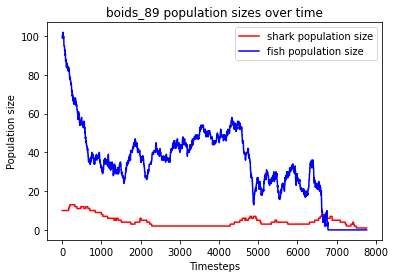

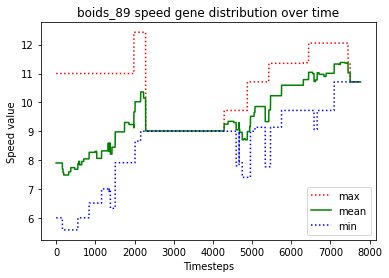

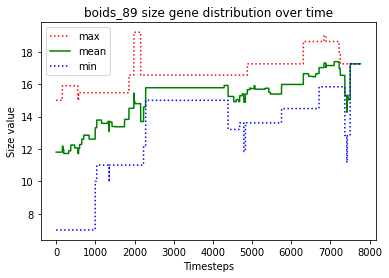

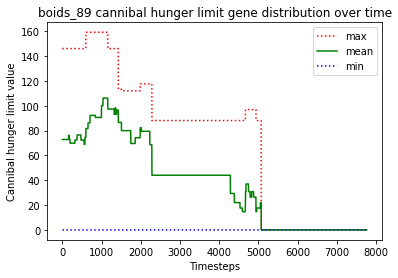

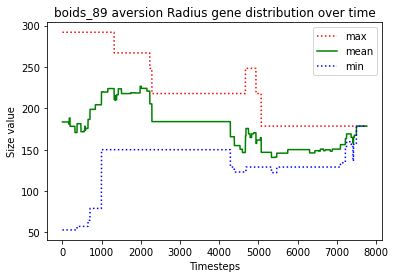

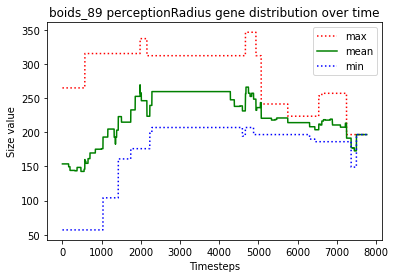

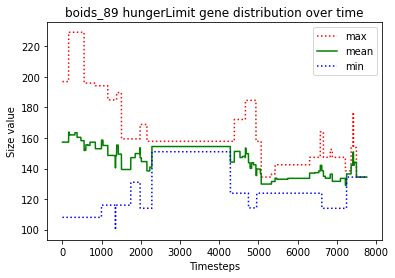





						BOIDS_90

predator_6 just gave birth to predator_10
predator_6 killed predator_4
predator_2 just gave birth to predator_11
predator_6 killed predator_0
predator_6 killed predator_5
predator_10 killed predator_3
predator_6 killed predator_9
predator_8 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_10 killed predator_12
predator_13 just gave birth to predator_14
predator_8 starved to death
predator_10 ate the carcass of predator_8_carcass
predator_14 just gave birth to predator_15
predator_15 starved to death
predator_14 starved to death
predator_11 ate the carcass of predator_15_carcass
predator_2 ate the carcass of predator_14_carcass
predator_11 just gave birth to predator_16
predator_13 starved to death
predator_7 starved to death
predator_6 starved to death
predator_2 ate the carcass of predator_6_carcass
predator_10 ate the carcass of predator_7_carcass
predator_10 ate the carcass of predator_13_carcass
predator_1 just gave birth to pred

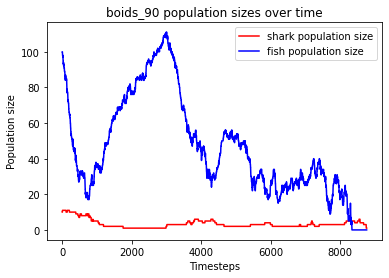

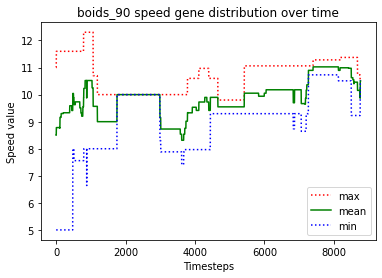

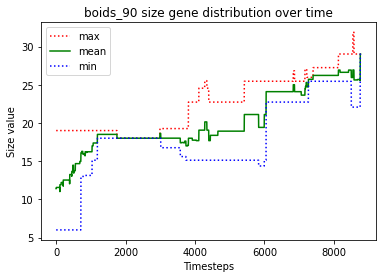

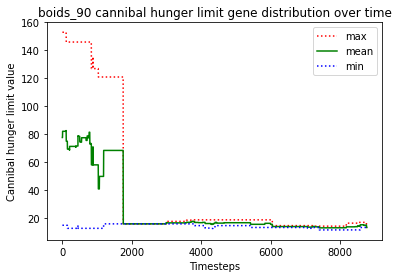

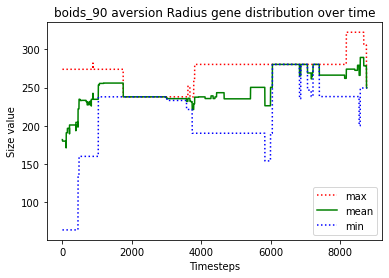

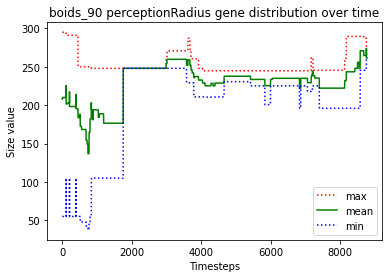

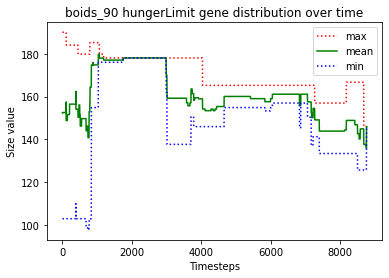





						BOIDS_91

predator_5 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_14 starved to death
predator_7 ate the carcass of predator_14_carcass
predator_11 starved to death
predator_6 ate the carcass of predator_11_carcass
predator_1 just gave birth to predator_15
predator_10 starved to death
predator_5 ate the carcass of predator_10_carcass
predator_3 just gave birth to predator_16
predator_6 just gave birth to predator_17
predator_13 starved to death
predator_12 starved to death
predator_5 ate the carcass of predator_13_carcass
predator_2 ate the carcass of predator_12_carcass
predator_1 just gave birth to predator_18
predator_2 just gave birth to predator_19
predator_4 starved to death
predator_17 ate the carcass of predator_4_carcass
predator_18 just gave birth to predator_20
predator_3 starved to death
predator_18 s

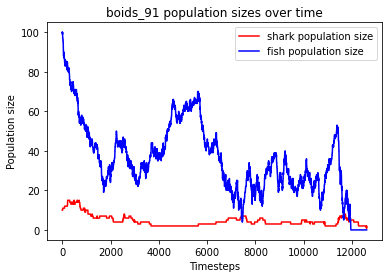

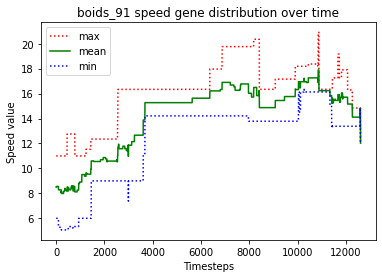

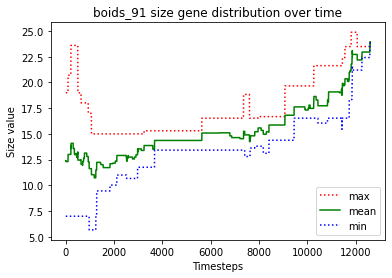

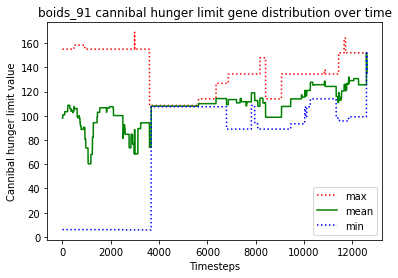

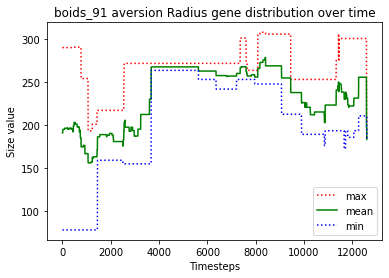

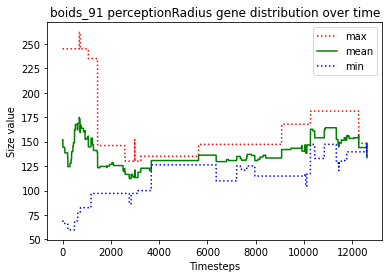

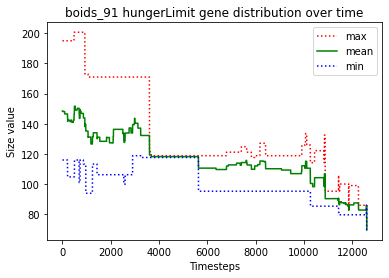





						BOIDS_92

predator_0 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_5 just gave birth to predator_15
predator_12 starved to death
predator_11 ate the carcass of predator_12_carcass
predator_14 just gave birth to predator_16
predator_1 just gave birth to predator_17
predator_0 starved to death
predator_17 just gave birth to predator_18
predator_2 ate the carcass of predator_0_carcass
predator_18 killed predator_5
predator_10 starved to death
predator_2 just gave birth to predator_19
predator_8 ate the carcass of predator_10_carcass
predator_16 starved to death
predator_11 ate the carcass of predator_16_carcass
predator_14 starved to death
predator_11 ate the carcass of predator_14_carcass
predator_7 starved to death
predator_15 ate the carcass of predator_7_carcass
predator_17 killed predator_3
predator_13 starved to d

predator_67 starved to death
predator_66 starved to death
predator_55 just gave birth to predator_71
predator_57 just gave birth to predator_72
predator_59 ate the carcass of predator_66_carcass
predator_55 just gave birth to predator_73
predator_71 ate the carcass of predator_69_carcass
predator_72 ate the carcass of predator_67_carcass
predator_72 just gave birth to predator_74
predator_59 just gave birth to predator_75
predator_73 starved to death
predator_63 ate the carcass of predator_73_carcass
no fish to move
predator_55 starved to death
predator_72 starved to death
predator_63 ate the carcass of predator_72_carcass
predator_74 ate the carcass of predator_55_carcass
predator_42 starved to death
predator_71 just gave birth to predator_76
predator_75 starved to death
predator_59 ate the carcass of predator_75_carcass
predator_63 ate the carcass of predator_42_carcass
predator_59 just gave birth to predator_77
predator_71 starved to death
predator_76 starved to death
predator_74 st

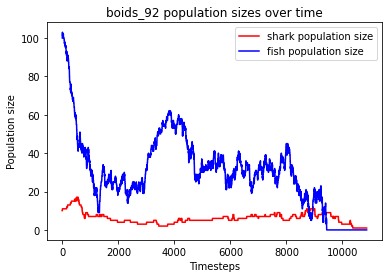

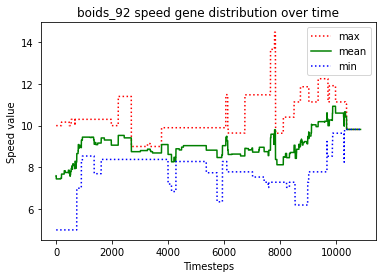

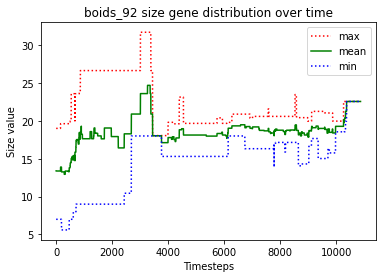

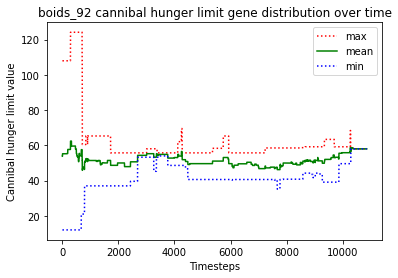

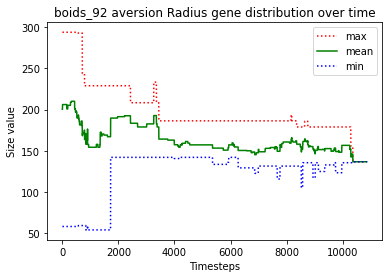

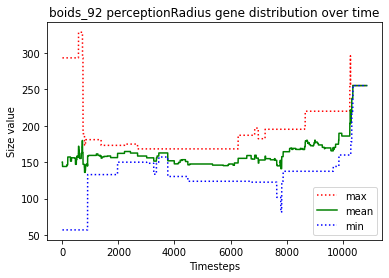

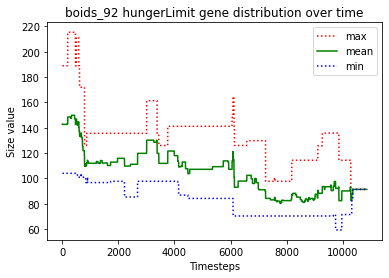





						BOIDS_93

predator_1 killed predator_9
predator_1 killed predator_3
predator_2 just gave birth to predator_10
predator_1 killed predator_6
predator_5 just gave birth to predator_11
predator_4 just gave birth to predator_12
predator_10 killed predator_4
predator_10 killed predator_12
predator_2 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_7 just gave birth to predator_15
predator_7 killed predator_15
predator_13 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_14 starved to death
predator_11 starved to death
predator_1 ate the carcass of predator_11_carcass
predator_7 starved to death
predator_1 ate the carcass of predator_14_carcass
predator_10 ate the carcass of predator_7_carcass
predator_2 just gave birth to predator_16
predator_16 just gave birth to predator_17
predator_8 just gave birth to predator_18
predator_17 starved to death
predator_1 ate the carcass of predator_17_carcass
predator_16 starved to death


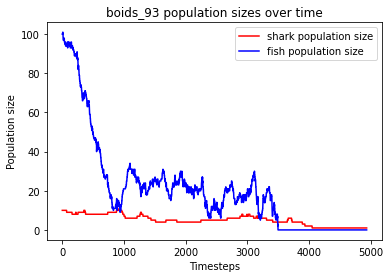

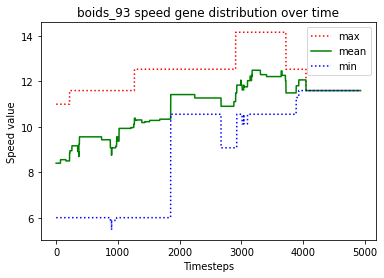

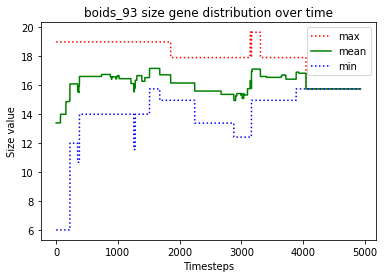

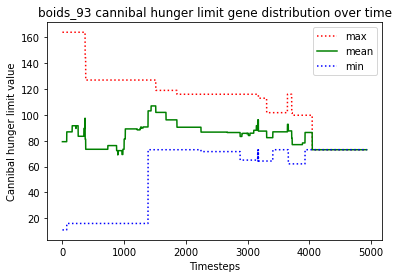

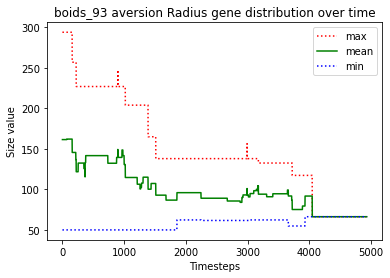

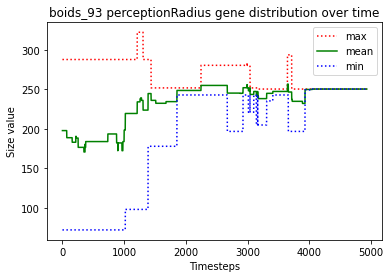

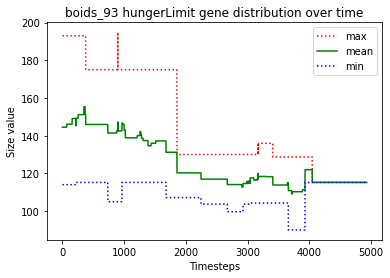





						BOIDS_94

predator_9 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_11 killed predator_4
predator_0 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_13 starved to death
predator_10 starved to death
predator_6 ate the carcass of predator_13_carcass
predator_3 ate the carcass of predator_10_carcass
predator_8 just gave birth to predator_16
predator_14 just gave birth to predator_17
predator_6 just gave birth to predator_18
predator_11 killed predator_17
predator_14 starved to death
predator_8 starved to death
predator_16 starved to death
predator_5 ate the carcass of predator_14_carcass
predator_7 ate the carcass of predator_8_carcass
predator_2 ate the carcass of predator_16_carcass
predator_18 just gave birth to predator_19
predator_19 just gave birth to predator_20
predator_9 just gave birth to predator_21
predator_15 starve

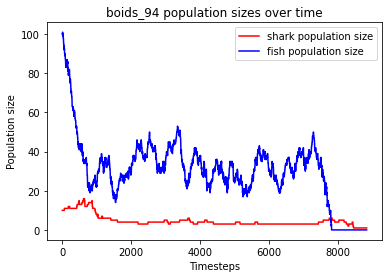

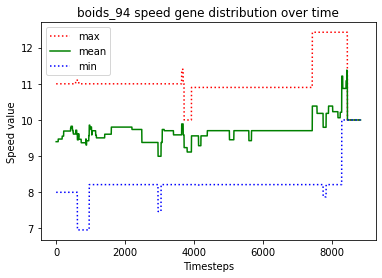

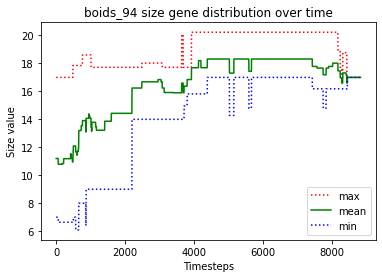

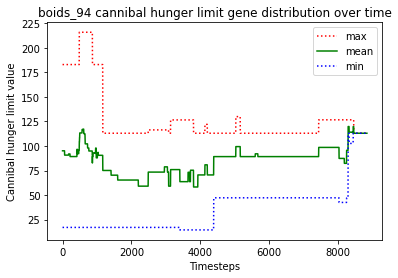

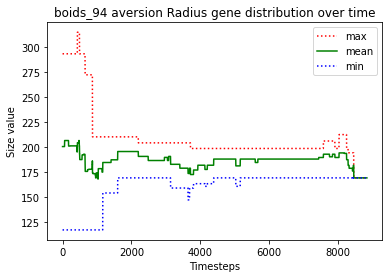

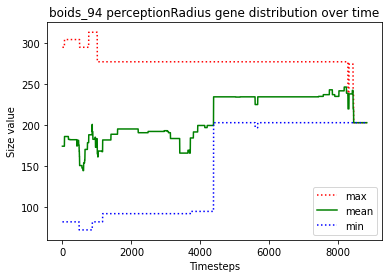

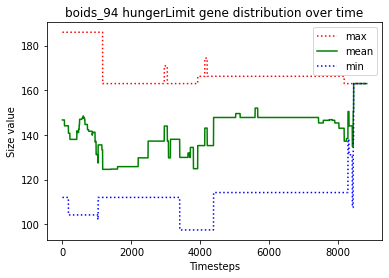





						BOIDS_95

predator_2 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_10 starved to death
predator_13 starved to death
predator_0 ate the carcass of predator_13_carcass
predator_3 ate the carcass of predator_10_carcass
predator_6 just gave birth to predator_14
predator_2 starved to death
predator_9 ate the carcass of predator_2_carcass
predator_14 killed predator_0
predator_6 killed predator_12
predator_8 killed predator_7
predator_14 killed predator_5
predator_14 killed predator_9
predator_14 killed predator_1
predator_4 just gave birth to predator_15
predator_11 starved to death
predator_14 ate the carcass of predator_11_carcass
predator_3 just gave birth to predator_16
predator_16 killed predator_4
predator_6 just gave birth to predator_17
predator_3 just gave birth to predator_18
predator_16 just gave birth to predator_19
predator_6 just gave birth to pred

predator_69 ate the carcass of predator_63_carcass
predator_70 just gave birth to predator_73
predator_42 just gave birth to predator_74
predator_73 ate the carcass of predator_49_carcass
predator_67 just gave birth to predator_75
predator_75 just gave birth to predator_76
predator_74 starved to death
predator_73 ate the carcass of predator_74_carcass
predator_42 starved to death
predator_73 ate the carcass of predator_42_carcass
predator_70 just gave birth to predator_77
predator_69 killed predator_76
predator_77 starved to death
predator_69 ate the carcass of predator_77_carcass
predator_75 starved to death
predator_73 just gave birth to predator_78
predator_73 ate the carcass of predator_75_carcass
predator_78 starved to death
predator_70 just gave birth to predator_79
predator_69 ate the carcass of predator_78_carcass
predator_79 starved to death
predator_67 ate the carcass of predator_79_carcass
predator_73 just gave birth to predator_80
predator_80 starved to death
predator_69 at

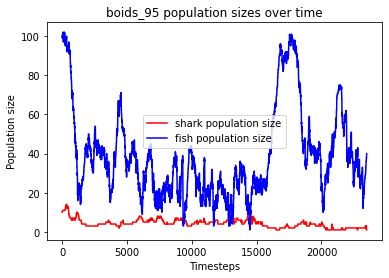

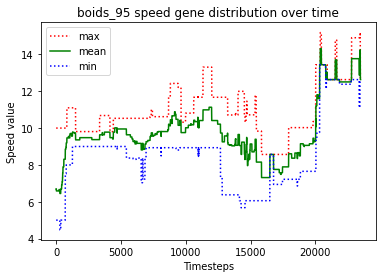

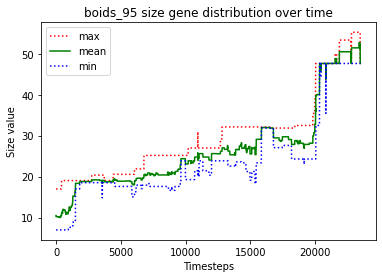

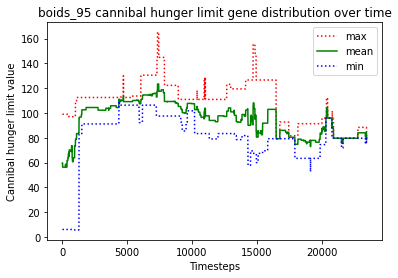

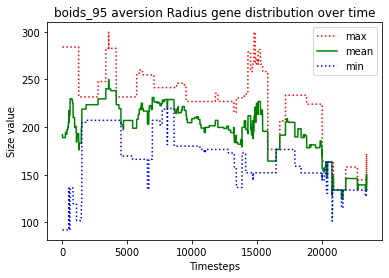

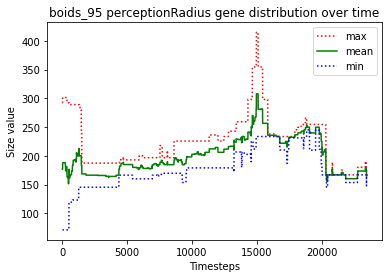

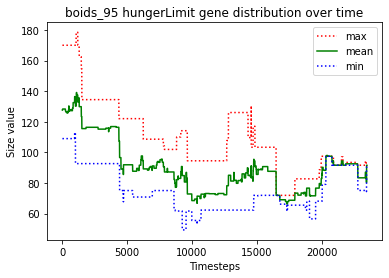





						BOIDS_96

predator_4 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_11 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_4 starved to death
predator_9 ate the carcass of predator_4_carcass
predator_5 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_12 killed predator_9
predator_5 starved to death
predator_7 ate the carcass of predator_5_carcass
predator_0 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_8 killed predator_15
predator_14 starved to death
predator_12 starved to death
predator_2 ate the carcass of predator_12_carcass
predator_1 starved to death
predator_0 ate the carcass of predator_14_carcass
predator_7 starved to death
predator_13 ate the carcass of predator_7_carcass
predator_6 just gave birth to predator_16
predator_6 killed predator_16
predator_8 ate the carcass of predator_1_carcass
predator_0 just gave birth to predator_17
predato

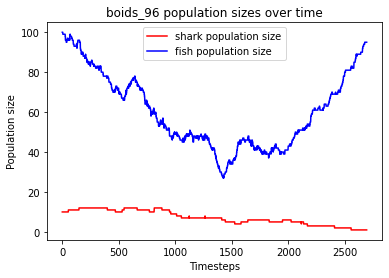

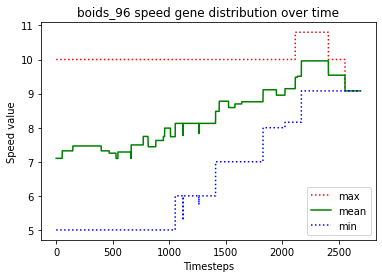

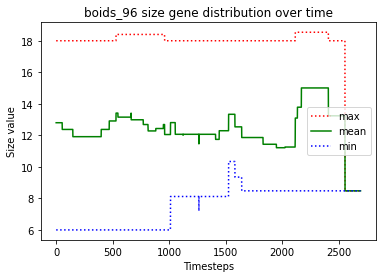

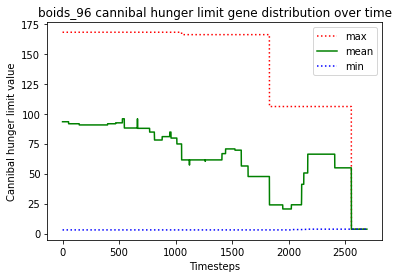

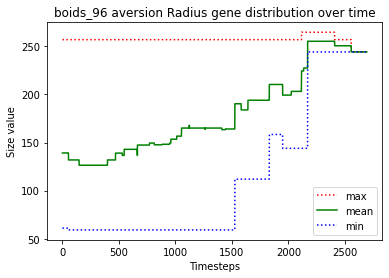

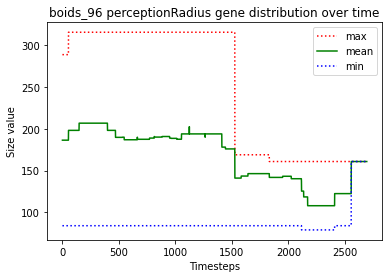

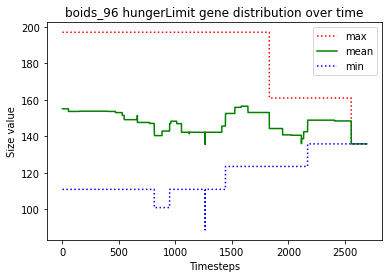





						BOIDS_97

predator_0 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_0 killed predator_9
predator_6 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_10 killed predator_2
predator_11 killed predator_5
predator_0 killed predator_12
predator_11 killed predator_6
predator_11 killed predator_13
predator_1 just gave birth to predator_15
predator_10 killed predator_8
predator_10 killed predator_4
predator_15 starved to death
predator_11 ate the carcass of predator_15_carcass
predator_11 killed predator_1
predator_14 just gave birth to predator_16
predator_14 just gave birth to predator_17
predator_17 starved to death
predator_14 starved to death
predator_16 starved to death
predator_10 ate the carcass of predator_14_carcass
predator_10 ate the carcass of predator_17_carcass
predator_10 ate the carcass of predator_16_carcass
predator_7 starved to death
predator_11 starved to 

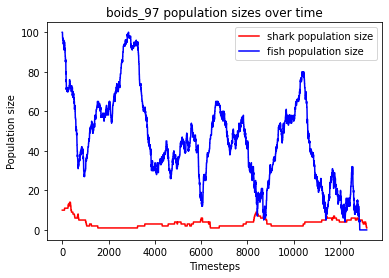

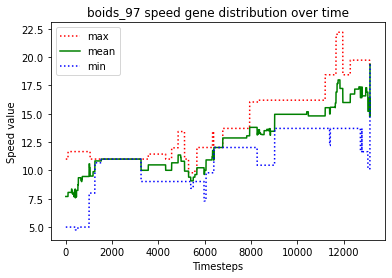

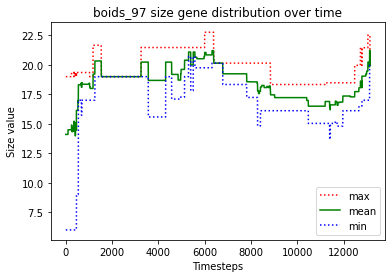

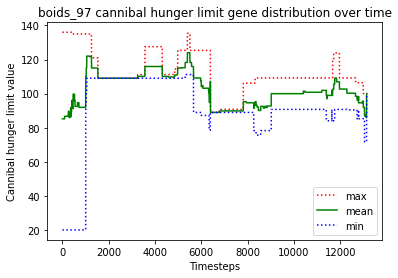

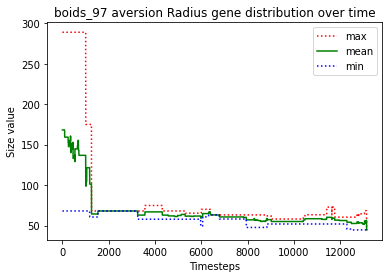

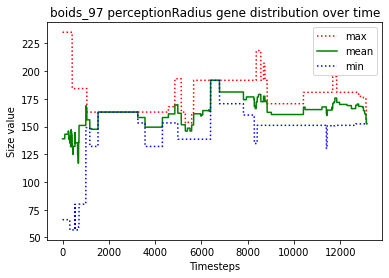

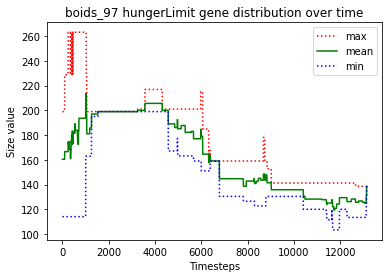





						BOIDS_98

predator_4 just gave birth to predator_10
predator_4 killed predator_8
predator_4 just gave birth to predator_11
predator_4 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_4 starved to death
predator_11 killed predator_6
predator_1 ate the carcass of predator_4_carcass
predator_10 killed predator_9
predator_3 just gave birth to predator_14
predator_3 killed predator_1
predator_10 just gave birth to predator_15
predator_15 just gave birth to predator_16
predator_3 killed predator_13
predator_11 killed predator_2
predator_3 just gave birth to predator_17
predator_3 starved to death
predator_17 starved to death
predator_11 ate the carcass of predator_3_carcass
predator_14 ate the carcass of predator_17_carcass
predator_0 starved to death
predator_7 just gave birth to predator_18
predator_15 ate the carcass of predator_0_carcass
predator_18 just gave birth to predator_19
predator_19 starved to death
predator_11 ate the carcass of predat

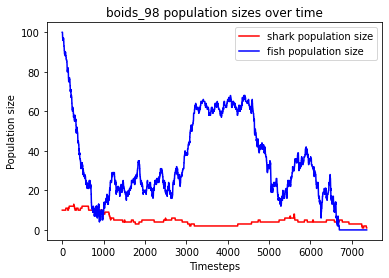

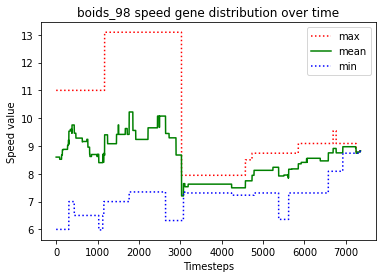

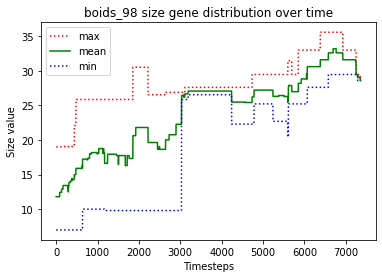

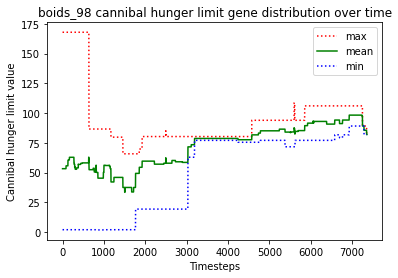

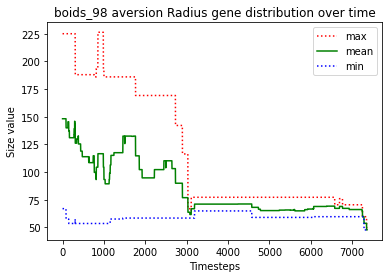

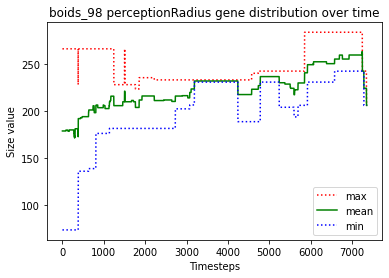

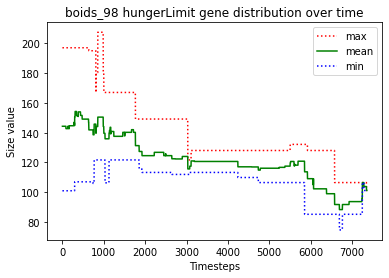





						BOIDS_99

predator_3 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_15 just gave birth to predator_17
predator_17 killed predator_12
predator_15 killed predator_2
predator_17 starved to death
predator_11 just gave birth to predator_18
predator_14 just gave birth to predator_19
predator_11 ate the carcass of predator_17_carcass
predator_15 starved to death
predator_3 ate the carcass of predator_15_carcass
predator_18 starved to death
predator_10 ate the carcass of predator_18_carcass
predator_1 just gave birth to predator_20
predator_7 just gave birth to predator_21
predator_9 starved to death
predator_4 ate the carcass of predator_9_carcass
predator_19 starved to death
predator_11 starved to death
predator_10 ate the carcass of predat

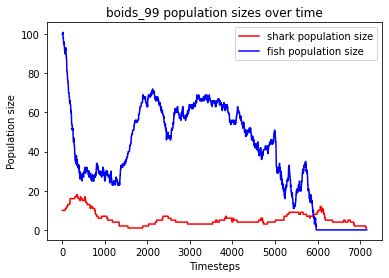

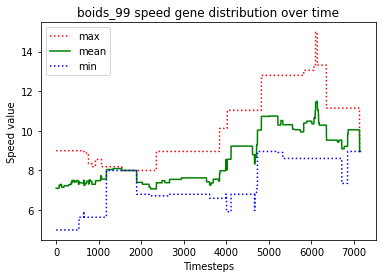

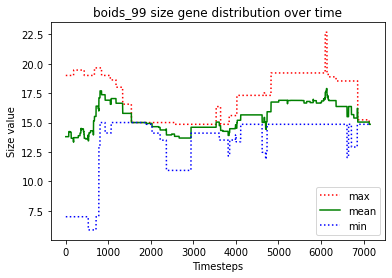

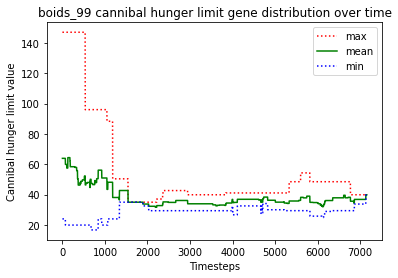

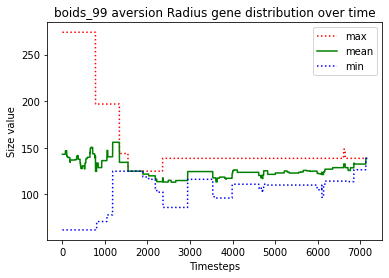

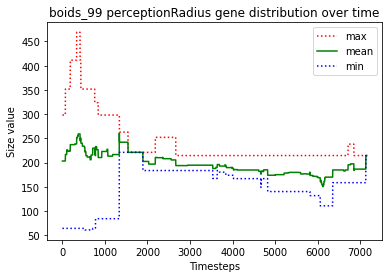

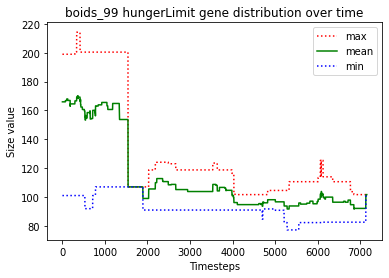





						SOLO_0

predator_4 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_3 killed predator_12
predator_2 just gave birth to predator_13
predator_13 killed predator_3
predator_2 killed predator_4
predator_13 killed predator_10
predator_2 killed predator_5
predator_2 killed predator_6
predator_11 starved to death
predator_7 ate the carcass of predator_11_carcass
predator_13 killed predator_0
predator_1 just gave birth to predator_14
predator_14 starved to death
predator_13 ate the carcass of predator_14_carcass
predator_8 starved to death
predator_1 starved to death
predator_2 ate the carcass of predator_8_carcass
predator_2 ate the carcass of predator_1_carcass
predator_9 starved to death
predator_2 ate the carcass of predator_9_carcass
predator_13 just gave birth to predator_15
predator_13 starved to death
predator_7 ate the carcass of predator_13_carcass
predator_15 starved to death
predator_2 ate the carc

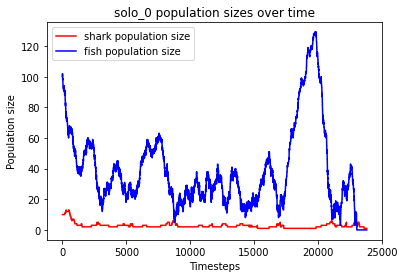

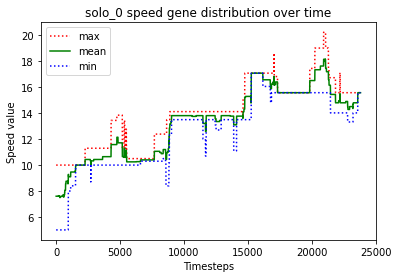

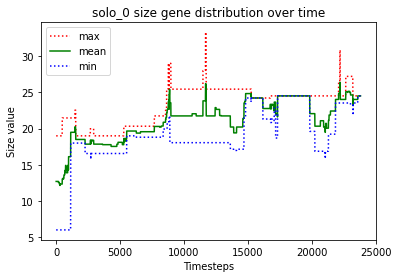

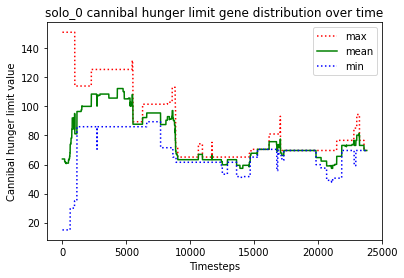

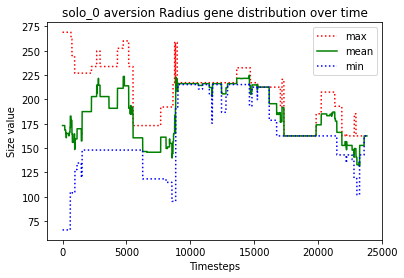

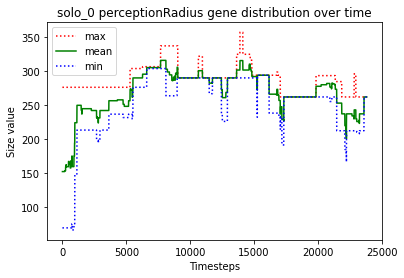

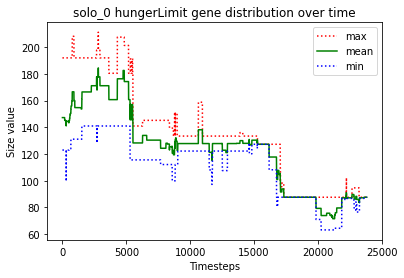





						SOLO_1

predator_2 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_8 killed predator_0
predator_12 starved to death
predator_2 starved to death
predator_11 ate the carcass of predator_12_carcass
predator_7 killed predator_3
predator_8 killed predator_9
predator_7 ate the carcass of predator_2_carcass
predator_10 starved to death
predator_1 ate the carcass of predator_10_carcass
predator_7 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_11 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_5 just gave birth to predator_17
predator_5 killed predator_17
predator_6 just gave birth to predator_18
predator_15 killed predator_4
predator_5 starved to death
predator_6 starved to death
predator_18 starved to death
predator_15 ate the carcass of predator_5_carcass
predator_1 starved to death
predator_16 ate the carcass of predator_1_carcass
predato

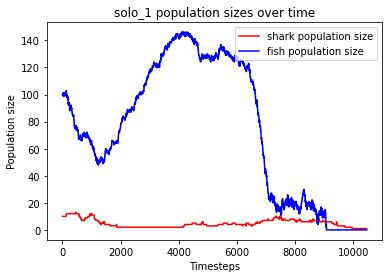

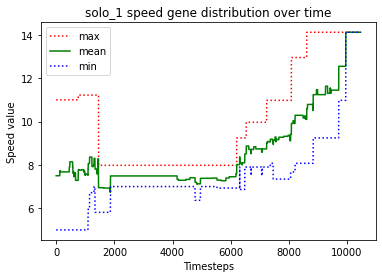

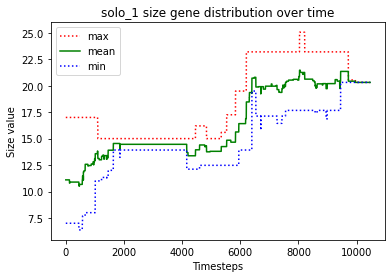

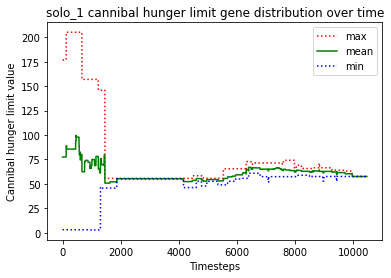

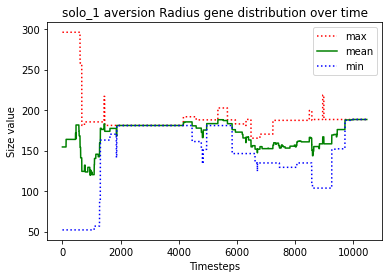

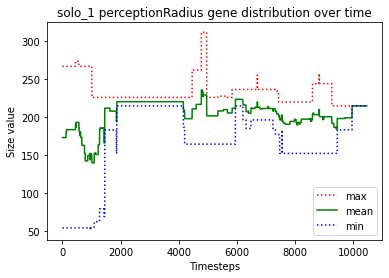

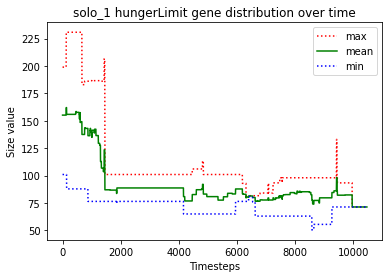





						SOLO_2

predator_4 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_12 killed predator_3
predator_1 just gave birth to predator_14
predator_12 killed predator_11
predator_9 just gave birth to predator_15
predator_13 starved to death
predator_7 ate the carcass of predator_13_carcass
predator_10 starved to death
predator_12 killed predator_14
predator_0 ate the carcass of predator_10_carcass
predator_5 starved to death
predator_9 ate the carcass of predator_5_carcass
predator_12 killed predator_6
predator_1 just gave birth to predator_16
predator_12 starved to death
predator_16 ate the carcass of predator_12_carcass
predator_8 starved to death
predator_4 ate the carcass of predator_8_carcass
predator_16 killed predator_7
predator_15 starved to death
predator_1 starved to death
predator_0 ate the carcass of predator_15_carcass
predator_9 starved to death
predator_

predator_57 ate the carcass of predator_64_carcass
predator_57 ate the carcass of predator_58_carcass
predator_57 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 68
Timesteps passed: 19066
Fish went extinct at timestep 18170
Sharks went extinct at timestep 19066


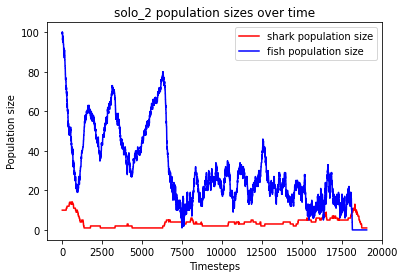

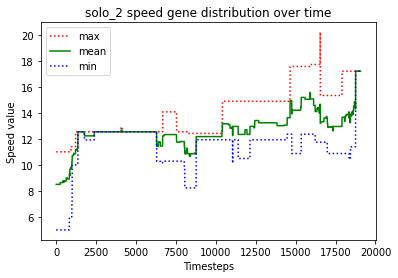

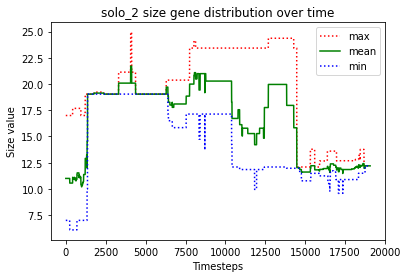

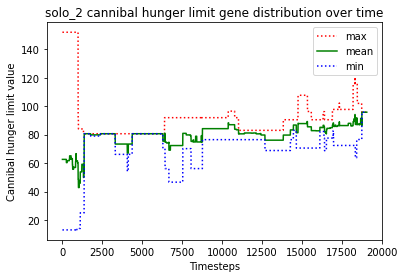

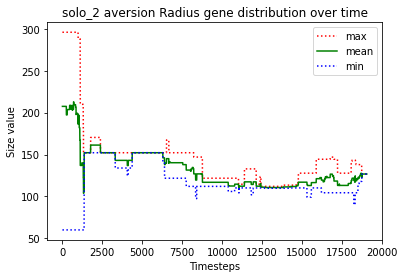

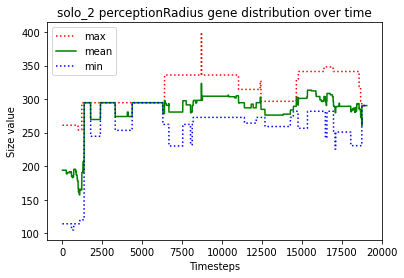

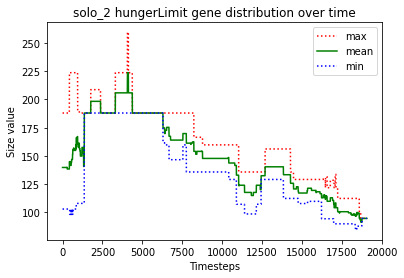





						SOLO_3

predator_8 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_2 killed predator_10
predator_3 just gave birth to predator_12
predator_11 killed predator_1
predator_0 just gave birth to predator_13
predator_2 killed predator_8
predator_12 just gave birth to predator_14
predator_5 just gave birth to predator_15
predator_15 just gave birth to predator_16
predator_2 killed predator_14
predator_12 starved to death
predator_16 starved to death
predator_2 ate the carcass of predator_12_carcass
predator_7 ate the carcass of predator_16_carcass
predator_15 starved to death
predator_2 killed predator_5
predator_7 ate the carcass of predator_15_carcass
predator_2 just gave birth to predator_17
predator_11 killed predator_9
predator_11 starved to death
predator_3 ate the carcass of predator_11_carcass
predator_13 just gave birth to predator_18
predator_17 starved to death
predator_7 just gave birth to predator_19
predator_4 ate the carcass of predat

predator_69 just gave birth to predator_71
predator_70 starved to death
predator_50 ate the carcass of predator_70_carcass
predator_71 starved to death
predator_62 ate the carcass of predator_71_carcass
predator_65 just gave birth to predator_72
predator_72 just gave birth to predator_73
predator_73 just gave birth to predator_74
predator_73 just gave birth to predator_75
predator_73 starved to death
predator_75 starved to death
predator_72 ate the carcass of predator_75_carcass
predator_74 starved to death
predator_65 ate the carcass of predator_74_carcass
predator_50 ate the carcass of predator_73_carcass
predator_72 just gave birth to predator_76
predator_72 just gave birth to predator_77
predator_76 starved to death
predator_72 ate the carcass of predator_76_carcass
predator_77 starved to death
predator_72 ate the carcass of predator_77_carcass
predator_72 starved to death
predator_69 just gave birth to predator_78
predator_78 ate the carcass of predator_72_carcass
predator_78 star

predator_112 ate the carcass of predator_100_carcass
predator_103 just gave birth to predator_130
predator_126 ate the carcass of predator_129_carcass
predator_130 starved to death
predator_103 starved to death
predator_126 starved to death
predator_112 ate the carcass of predator_130_carcass
predator_112 ate the carcass of predator_103_carcass
predator_112 ate the carcass of predator_126_carcass
predator_112 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 131
Timesteps passed: 26633
Fish went extinct at timestep 24831
Sharks went extinct at timestep 26633


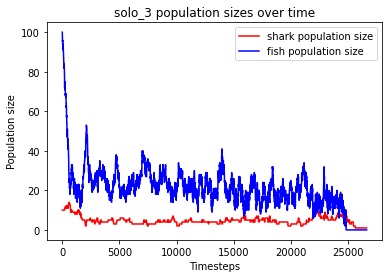

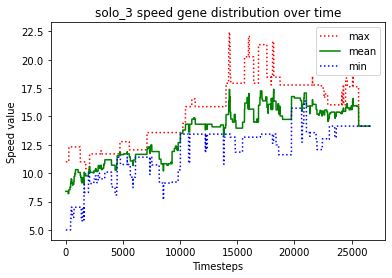

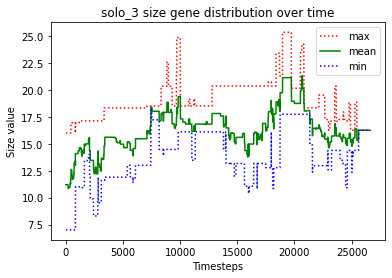

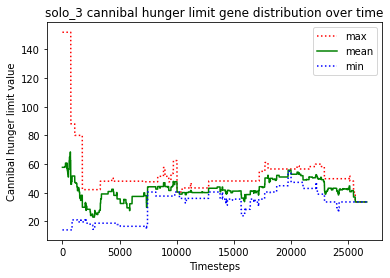

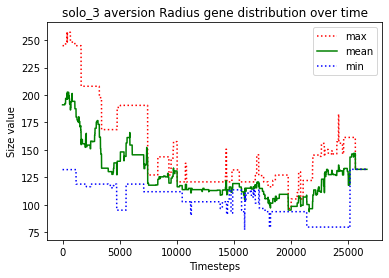

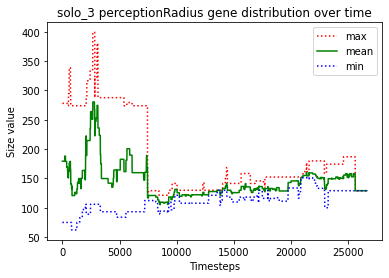

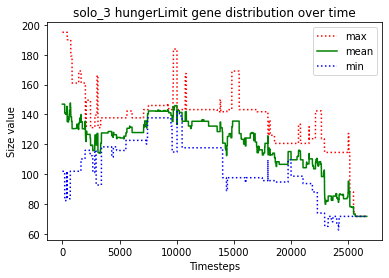





						SOLO_4

predator_5 just gave birth to predator_10
predator_6 killed predator_7
predator_1 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_1 killed predator_0
predator_1 killed predator_4
predator_5 starved to death
predator_10 starved to death
predator_6 just gave birth to predator_13
predator_12 starved to death
predator_2 ate the carcass of predator_5_carcass
predator_2 ate the carcass of predator_12_carcass
predator_11 starved to death
predator_8 just gave birth to predator_14
predator_8 ate the carcass of predator_10_carcass
predator_1 starved to death
predator_3 ate the carcass of predator_11_carcass
predator_2 ate the carcass of predator_1_carcass
predator_13 starved to death
predator_2 ate the carcass of predator_13_carcass
predator_9 just gave birth to predator_15
predator_6 starved to death
predator_9 starved to death
predator_15 starved to death
predator_2 just gave birth to predator_16
predator_2 ate the carcass of predator_6_carc

predator_57 just gave birth to predator_68
predator_68 just gave birth to predator_69
predator_69 just gave birth to predator_70
predator_70 starved to death
predator_57 ate the carcass of predator_70_carcass
predator_63 just gave birth to predator_71
predator_69 starved to death
predator_57 ate the carcass of predator_69_carcass
predator_63 just gave birth to predator_72
predator_63 just gave birth to predator_73
predator_73 killed predator_72
predator_71 starved to death
predator_57 ate the carcass of predator_71_carcass
predator_63 starved to death
predator_73 ate the carcass of predator_63_carcass
predator_73 starved to death
predator_68 ate the carcass of predator_73_carcass
predator_68 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_57 just gave birth to predator_76
predator_75 just gave birth to predator_77
predator_76 starved to death
predator_57 ate the carcass of predator_76_carcass
predator_68 just gave birth to predator_78
predator_57 just

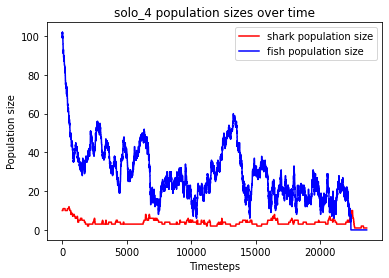

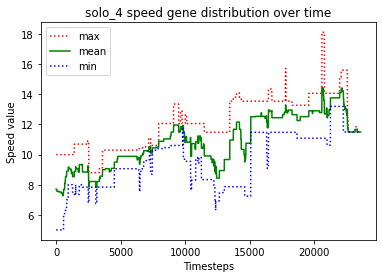

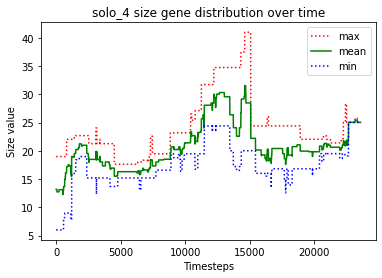

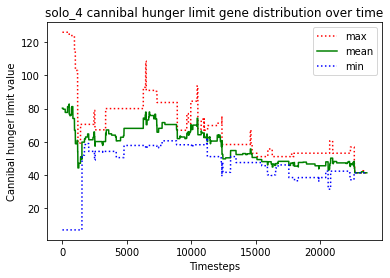

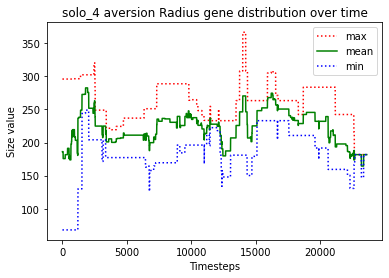

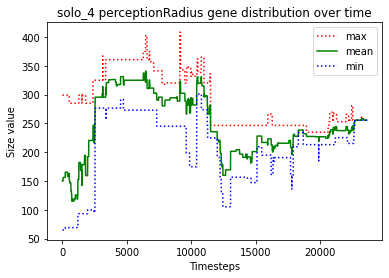

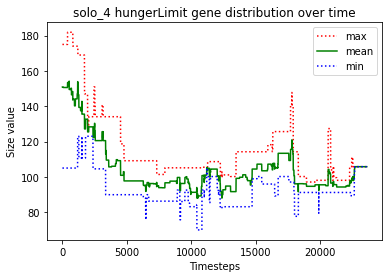





						SOLO_5

predator_8 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_7 killed predator_11
predator_7 just gave birth to predator_12
predator_7 killed predator_12
predator_7 killed predator_3
predator_7 killed predator_2
predator_6 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_6 killed predator_5
predator_10 starved to death
predator_4 ate the carcass of predator_10_carcass
predator_6 just gave birth to predator_15
predator_15 just gave birth to predator_16
predator_13 starved to death
predator_0 ate the carcass of predator_13_carcass
predator_14 starved to death
predator_16 starved to death
predator_15 ate the carcass of predator_14_carcass
predator_6 ate the carcass of predator_16_carcass
predator_4 just gave birth to predator_17
predator_15 starved to death
predator_6 ate the carcass of predator_15_carcass
predator_1 just gave birth to predator_18
predator_7 killed predator_9
predator_8 just gave birth to 

predator_57 ate the carcass of predator_69_carcass
predator_49 just gave birth to predator_70
predator_49 just gave birth to predator_71
predator_71 starved to death
predator_37 ate the carcass of predator_71_carcass
predator_70 just gave birth to predator_72
predator_72 just gave birth to predator_73
predator_49 just gave birth to predator_74
predator_70 starved to death
predator_57 ate the carcass of predator_70_carcass
predator_74 starved to death
predator_73 starved to death
predator_64 ate the carcass of predator_73_carcass
predator_64 ate the carcass of predator_74_carcass
predator_72 starved to death
predator_57 ate the carcass of predator_72_carcass
predator_57 just gave birth to predator_75
predator_57 just gave birth to predator_76
predator_64 just gave birth to predator_77
predator_57 just gave birth to predator_78
predator_57 just gave birth to predator_79
predator_77 killed predator_37
predator_49 just gave birth to predator_80
predator_75 just gave birth to predator_81
pr

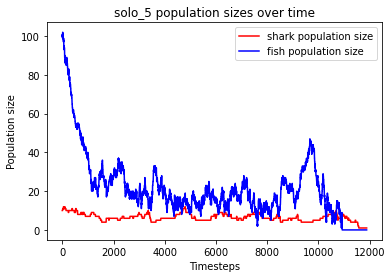

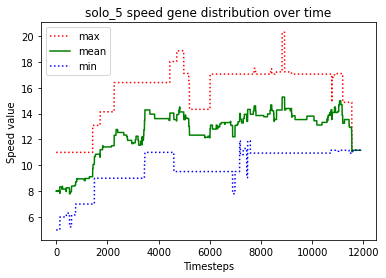

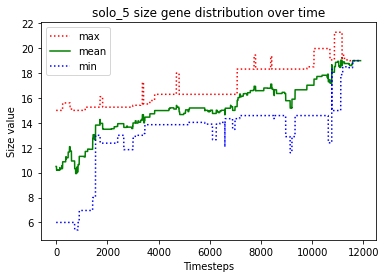

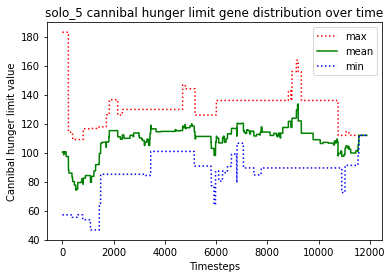

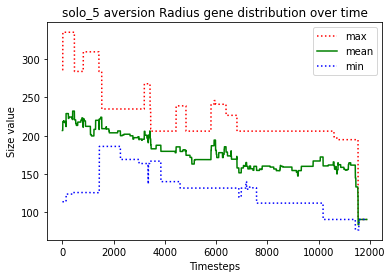

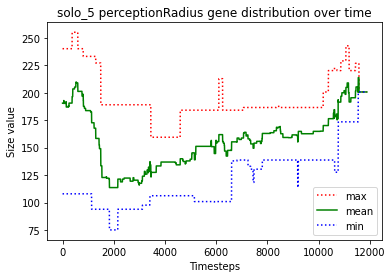

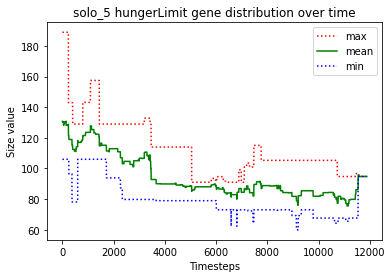





						SOLO_6

predator_7 just gave birth to predator_10
predator_7 killed predator_10
predator_9 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_9 starved to death
predator_7 starved to death
predator_3 ate the carcass of predator_7_carcass
predator_12 starved to death
predator_8 ate the carcass of predator_12_carcass
predator_14 ate the carcass of predator_9_carcass
predator_13 starved to death
predator_5 ate the carcass of predator_13_carcass
predator_11 starved to death
predator_2 ate the carcass of predator_11_carcass
predator_2 just gave birth to predator_15
predator_0 killed predator_4
predator_1 starved to death
predator_6 starved to death
predator_8 ate the carcass of predator_1_carcass
predator_3 ate the carcass of predator_6_carcass
predator_5 just gave birth to predator_16
predator_15 starved to death
predator_2 starved to death
predator_5 just gave birth

predator_45 starved to death
predator_64 ate the carcass of predator_45_carcass
predator_57 just gave birth to predator_69
predator_68 starved to death
predator_67 starved to death
predator_66 ate the carcass of predator_68_carcass
predator_57 starved to death
predator_69 starved to death
predator_56 ate the carcass of predator_57_carcass
predator_59 ate the carcass of predator_67_carcass
predator_56 ate the carcass of predator_69_carcass
predator_59 starved to death
predator_66 starved to death
predator_64 ate the carcass of predator_59_carcass
predator_56 ate the carcass of predator_66_carcass
predator_64 starved to death
predator_56 ate the carcass of predator_64_carcass
predator_56 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 70
Timesteps passed: 16874
Fish went extinct at timestep 15877
Sharks went extinct at timestep 16874


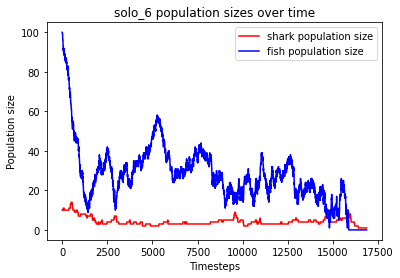

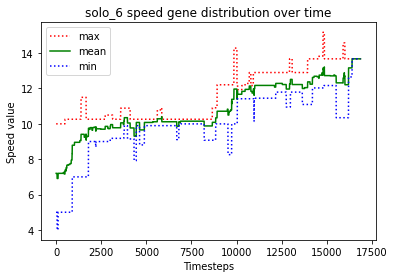

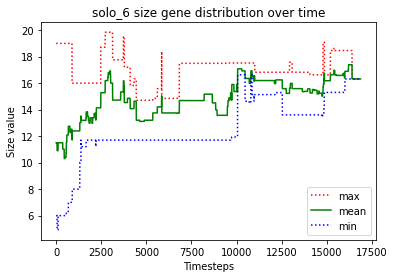

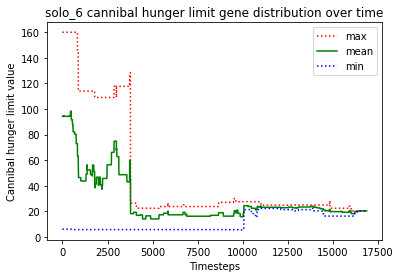

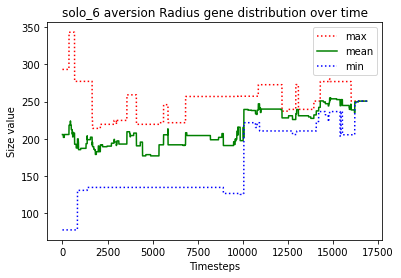

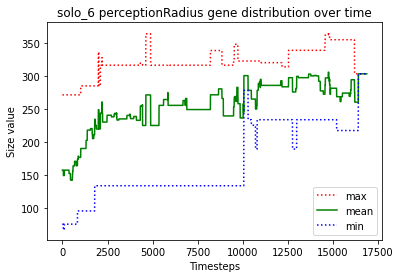

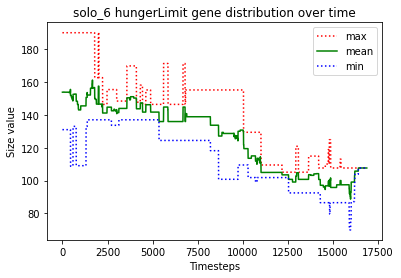





						SOLO_7

predator_1 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_7 just gave birth to predator_15
predator_8 just gave birth to predator_16
predator_11 starved to death
predator_13 starved to death
predator_14 ate the carcass of predator_13_carcass
predator_9 just gave birth to predator_17
predator_10 starved to death
predator_5 ate the carcass of predator_10_carcass
predator_9 ate the carcass of predator_11_carcass
predator_1 starved to death
predator_2 just gave birth to predator_18
predator_8 killed predator_6
predator_14 ate the carcass of predator_1_carcass
predator_12 starved to death
predator_14 ate the carcass of predator_12_carcass
predator_15 starved to death
predator_9 ate the carcass of predator_15_carcass
predator_14 just gave birth to predator_19
predator_3 just gave birth to predator_20
predator_18 s

predator_61 ate the carcass of predator_65_carcass
predator_61 ate the carcass of predator_67_carcass
predator_66 starved to death
predator_61 ate the carcass of predator_66_carcass
predator_64 just gave birth to predator_68
predator_64 starved to death
predator_68 starved to death
predator_62 just gave birth to predator_69
predator_62 just gave birth to predator_70
predator_62 ate the carcass of predator_68_carcass
predator_62 ate the carcass of predator_64_carcass
predator_70 starved to death
predator_69 ate the carcass of predator_70_carcass
predator_63 starved to death
predator_69 ate the carcass of predator_63_carcass
predator_57 just gave birth to predator_71
predator_71 starved to death
predator_57 starved to death
predator_62 ate the carcass of predator_71_carcass
predator_58 starved to death
predator_69 ate the carcass of predator_58_carcass
predator_61 starved to death
predator_62 ate the carcass of predator_61_carcass
predator_62 ate the carcass of predator_57_carcass
predat

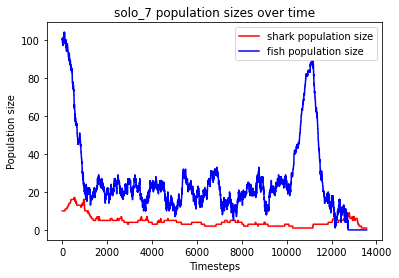

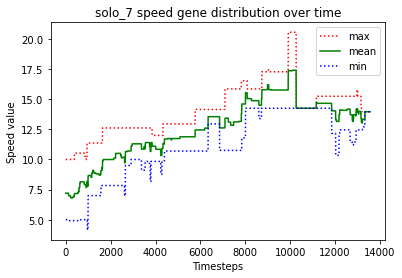

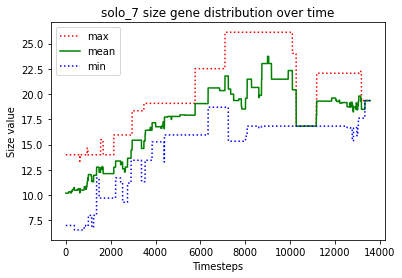

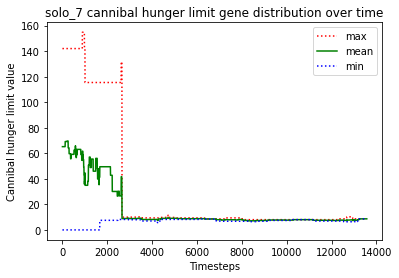

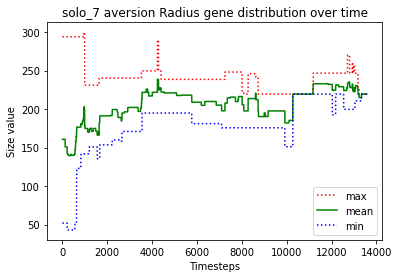

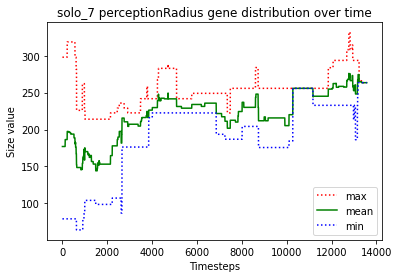

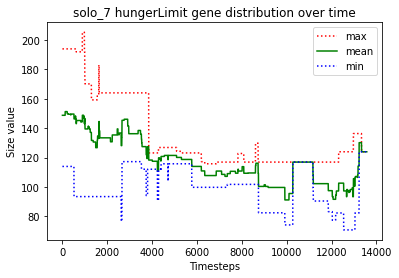





						SOLO_8

predator_9 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_9 starved to death
predator_11 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_3 ate the carcass of predator_9_carcass
predator_6 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_10 starved to death
predator_4 just gave birth to predator_14
predator_4 ate the carcass of predator_10_carcass
predator_5 just gave birth to predator_15
predator_6 starved to death
predator_12 starved to death
predator_3 ate the carcass of predator_6_carcass
predator_7 ate the carcass of predator_12_carcass
predator_0 just gave birth to predator_16
predator_16 just gave birth to predator_17
predator_16 killed predator_17
predator_2 killed predator_1
predator_4 starved to death
predator_16 just gave birth to predator_18
predator_14 starved to death
predator_13 ate the carcass of predator_4_carcass
predator_5 ate the carcass of predator_14_ca

predator_40 just gave birth to predator_71
predator_69 just gave birth to predator_72
predator_72 starved to death
predator_69 starved to death
predator_40 ate the carcass of predator_72_carcass
predator_40 ate the carcass of predator_69_carcass
predator_70 just gave birth to predator_73
predator_73 killed predator_71
predator_70 just gave birth to predator_74
predator_67 just gave birth to predator_75
predator_64 starved to death
predator_73 ate the carcass of predator_64_carcass
predator_67 starved to death
predator_75 starved to death
predator_73 ate the carcass of predator_75_carcass
predator_74 ate the carcass of predator_67_carcass
predator_51 just gave birth to predator_76
predator_70 just gave birth to predator_77
predator_74 just gave birth to predator_78
predator_74 just gave birth to predator_79
predator_77 starved to death
predator_73 ate the carcass of predator_77_carcass
predator_76 starved to death
predator_79 killed predator_78
predator_79 just gave birth to predator_80

predator_129 starved to death
predator_119 ate the carcass of predator_129_carcass
predator_115 starved to death
predator_128 ate the carcass of predator_115_carcass
predator_131 just gave birth to predator_133
predator_132 just gave birth to predator_134
predator_134 killed predator_125
predator_131 starved to death
predator_133 starved to death
predator_132 starved to death
predator_134 ate the carcass of predator_132_carcass
predator_134 ate the carcass of predator_131_carcass
predator_119 ate the carcass of predator_133_carcass
predator_128 just gave birth to predator_135
predator_134 killed predator_135
predator_122 just gave birth to predator_136
predator_134 killed predator_119
predator_128 just gave birth to predator_137
predator_134 just gave birth to predator_138
predator_128 just gave birth to predator_139
predator_134 just gave birth to predator_140
predator_139 starved to death
predator_137 ate the carcass of predator_139_carcass
predator_140 starved to death
predator_134 

predator_184 killed predator_186
predator_194 just gave birth to predator_195
predator_195 starved to death
predator_194 starved to death
predator_184 ate the carcass of predator_195_carcass
predator_179 ate the carcass of predator_194_carcass
predator_191 starved to death
predator_187 ate the carcass of predator_191_carcass
predator_179 just gave birth to predator_196
predator_179 just gave birth to predator_197
predator_174 just gave birth to predator_198
predator_196 just gave birth to predator_199
predator_196 starved to death
predator_199 starved to death
predator_197 starved to death
predator_174 ate the carcass of predator_196_carcass
predator_179 ate the carcass of predator_197_carcass
predator_184 starved to death
predator_167 ate the carcass of predator_184_carcass
predator_187 just gave birth to predator_200
predator_187 ate the carcass of predator_199_carcass
predator_198 starved to death
predator_200 starved to death
predator_179 ate the carcass of predator_200_carcass
pre

predator_208 ate the carcass of predator_239_carcass
predator_255 just gave birth to predator_257
predator_243 ate the carcass of predator_248_carcass
predator_247 just gave birth to predator_258
predator_257 starved to death
predator_201 starved to death
predator_251 ate the carcass of predator_233_carcass
predator_249 just gave birth to predator_259
predator_255 ate the carcass of predator_257_carcass
predator_167 ate the carcass of predator_254_carcass
predator_256 ate the carcass of predator_201_carcass
predator_237 starved to death
predator_247 starved to death
predator_255 ate the carcass of predator_237_carcass
predator_255 just gave birth to predator_260
predator_259 starved to death
predator_243 ate the carcass of predator_247_carcass
predator_249 just gave birth to predator_261
predator_260 just gave birth to predator_262
predator_261 just gave birth to predator_263
predator_256 just gave birth to predator_264
predator_251 ate the carcass of predator_259_carcass
predator_263 

predator_314 ate the carcass of predator_311_carcass
predator_308 starved to death
predator_313 ate the carcass of predator_308_carcass
predator_294 starved to death
predator_252 just gave birth to predator_315
predator_297 ate the carcass of predator_294_carcass
predator_252 just gave birth to predator_316
predator_252 killed predator_313
predator_316 just gave birth to predator_317
predator_317 starved to death
predator_316 ate the carcass of predator_317_carcass
predator_297 killed predator_315
predator_252 just gave birth to predator_318
predator_318 starved to death
predator_289 ate the carcass of predator_318_carcass
predator_252 just gave birth to predator_319
predator_297 just gave birth to predator_320
predator_297 just gave birth to predator_321
predator_321 killed predator_319
predator_320 starved to death
predator_297 ate the carcass of predator_320_carcass
predator_321 killed predator_252
predator_297 just gave birth to predator_322
predator_316 just gave birth to predator

predator_372 just gave birth to predator_378
predator_378 starved to death
predator_372 ate the carcass of predator_378_carcass
predator_374 starved to death
predator_349 ate the carcass of predator_374_carcass
predator_377 just gave birth to predator_379
predator_377 starved to death
predator_349 just gave birth to predator_380
predator_372 starved to death
predator_379 ate the carcass of predator_372_carcass
predator_289 ate the carcass of predator_377_carcass
predator_364 just gave birth to predator_381
predator_371 starved to death
predator_349 ate the carcass of predator_371_carcass
predator_381 starved to death
predator_379 ate the carcass of predator_381_carcass
predator_289 just gave birth to predator_382
predator_380 killed predator_379
predator_364 starved to death
predator_380 ate the carcass of predator_364_carcass
predator_380 just gave birth to predator_383
predator_289 just gave birth to predator_384
predator_384 starved to death
predator_380 ate the carcass of predator_

predator_420 just gave birth to predator_438
predator_420 starved to death
predator_408 ate the carcass of predator_420_carcass
predator_437 starved to death
predator_438 starved to death
predator_423 ate the carcass of predator_437_carcass
predator_432 ate the carcass of predator_438_carcass
predator_408 just gave birth to predator_439
predator_439 starved to death
predator_432 just gave birth to predator_440
predator_423 just gave birth to predator_441
predator_432 ate the carcass of predator_439_carcass
predator_432 just gave birth to predator_442
predator_440 starved to death
predator_435 ate the carcass of predator_440_carcass
predator_425 just gave birth to predator_443
predator_432 starved to death
predator_408 starved to death
predator_442 ate the carcass of predator_432_carcass
predator_442 ate the carcass of predator_408_carcass
predator_441 just gave birth to predator_444
predator_443 just gave birth to predator_445
predator_444 just gave birth to predator_446
predator_444 s

predator_485 just gave birth to predator_494
predator_491 just gave birth to predator_495
predator_478 just gave birth to predator_496
predator_478 killed predator_496
predator_488 starved to death
predator_478 ate the carcass of predator_488_carcass
predator_495 starved to death
predator_460 ate the carcass of predator_495_carcass
predator_460 just gave birth to predator_497
predator_491 just gave birth to predator_498
predator_485 starved to death
predator_490 ate the carcass of predator_485_carcass
predator_498 starved to death
predator_491 just gave birth to predator_499
predator_460 ate the carcass of predator_498_carcass
predator_499 starved to death
predator_491 ate the carcass of predator_499_carcass
predator_460 just gave birth to predator_500
predator_497 starved to death
predator_490 ate the carcass of predator_497_carcass
predator_460 starved to death
predator_490 just gave birth to predator_501
predator_490 killed predator_501
predator_491 ate the carcass of predator_460_c

predator_550 ate the carcass of predator_548_carcass
predator_491 just gave birth to predator_551
predator_550 just gave birth to predator_552
predator_491 starved to death
predator_551 starved to death
predator_552 ate the carcass of predator_491_carcass
predator_552 ate the carcass of predator_551_carcass
predator_550 starved to death
predator_552 ate the carcass of predator_550_carcass
predator_552 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 553
Timesteps passed: 89824
Fish went extinct at timestep 87050
Sharks went extinct at timestep 89824


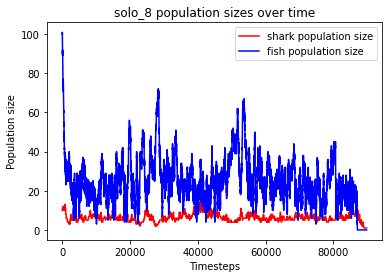

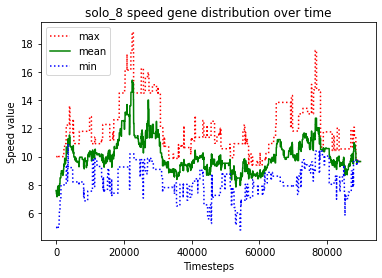

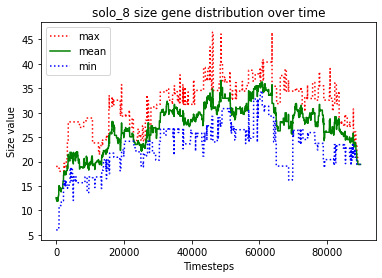

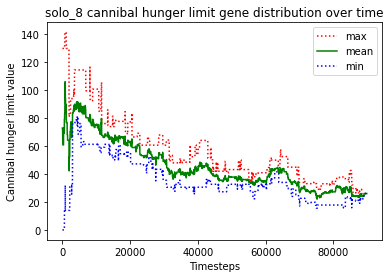

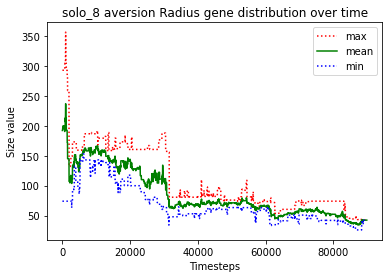

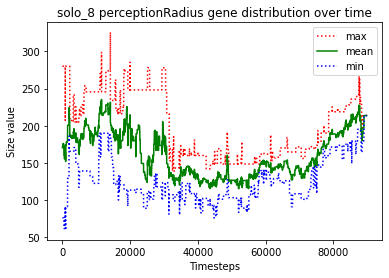

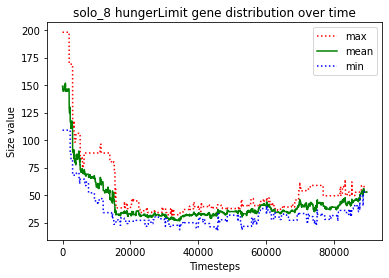





						SOLO_9

predator_8 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_8 killed predator_6
predator_10 killed predator_11
predator_10 killed predator_5
predator_9 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_3 starved to death
predator_1 ate the carcass of predator_3_carcass
predator_4 just gave birth to predator_14
predator_8 killed predator_12
predator_0 just gave birth to predator_15
predator_13 just gave birth to predator_16
predator_13 starved to death
predator_16 starved to death
predator_1 just gave birth to predator_17
predator_15 ate the carcass of predator_16_carcass
predator_15 ate the carcass of predator_13_carcass
predator_0 killed predator_14
predator_17 just gave birth to predator_18
predator_0 killed predator_4
predator_18 killed predator_8
predator_2 starved to death
predator_17 ate the carcass of predator_2_carcass
predator_18 killed predator_9
predator_18 starved to death
predator_17 ate the

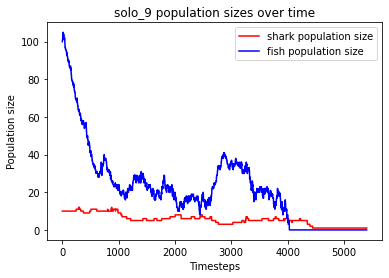

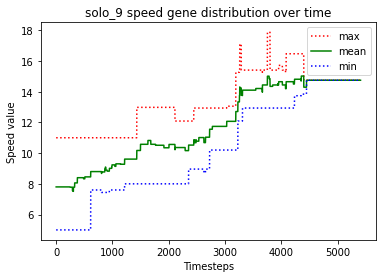

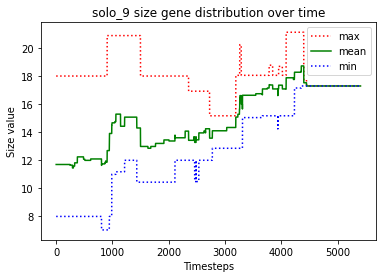

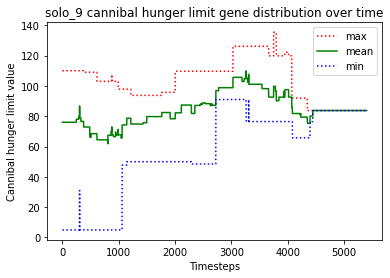

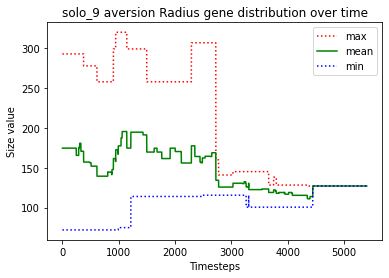

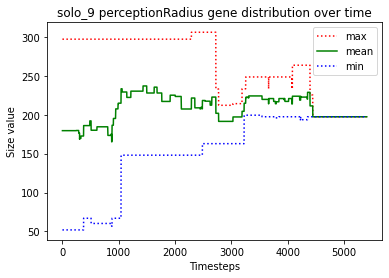

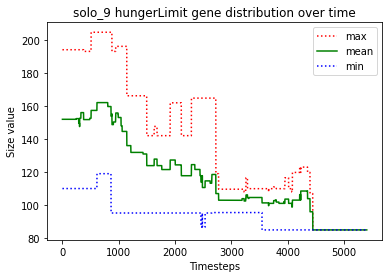





						SOLO_10

predator_3 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_0 killed predator_4
predator_13 just gave birth to predator_15
predator_14 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_6 killed predator_1
predator_17 just gave birth to predator_18
predator_14 starved to death
predator_16 starved to death
predator_9 just gave birth to predator_19
predator_11 ate the carcass of predator_16_carcass
predator_10 starved to death
predator_12 just gave birth to predator_20
predator_19 ate the carcass of predator_10_carcass
predator_9 ate the carcass of predator_14_carcass
predator_17 starved to death
predator_13 ate the carcass of predator_17_carcass
predator_18 starved to death
predator_6 killed predator_8
predator_3 starved to death
predator_0 ate the carcass of predator_3_carcass
p

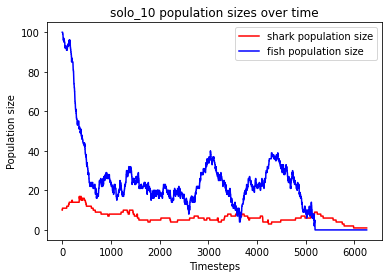

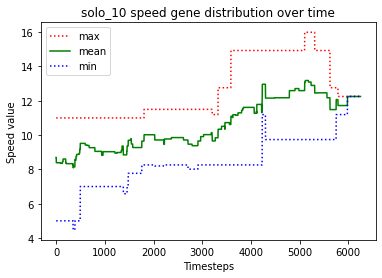

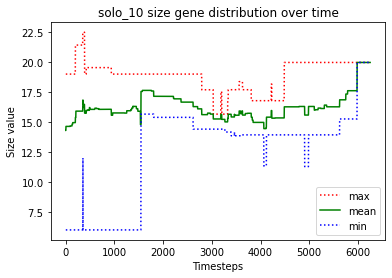

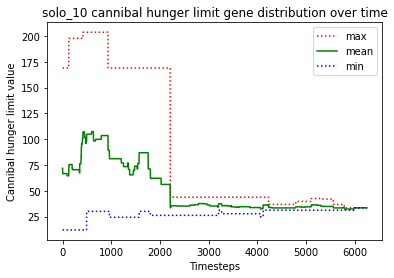

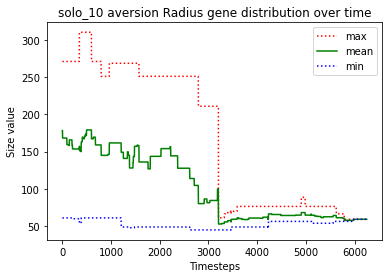

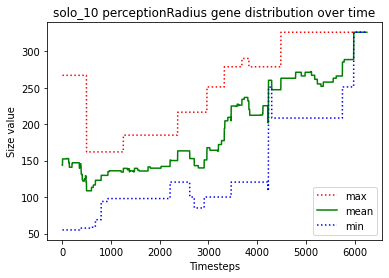

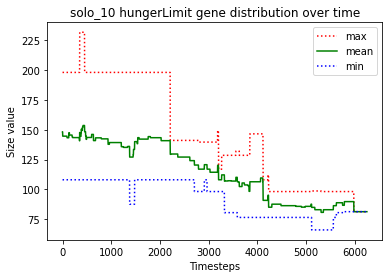





						SOLO_11

predator_8 just gave birth to predator_10
predator_8 killed predator_10
predator_2 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_1 just gave birth to predator_15
predator_2 starved to death
predator_11 starved to death
predator_14 ate the carcass of predator_2_carcass
predator_0 ate the carcass of predator_11_carcass
predator_8 starved to death
predator_1 starved to death
predator_0 ate the carcass of predator_1_carcass
predator_4 ate the carcass of predator_8_carcass
predator_15 starved to death
predator_3 ate the carcass of predator_15_carcass
predator_4 just gave birth to predator_16
predator_12 starved to death
predator_9 ate the carcass of predator_12_carcass
predator_4 starved to death
predator_16 starved to death
predator_3 ate the carcass of predator_4_carcass
predator_9 ate the carcass of predator_16_carcass
predator_13 starved to death
pre

predator_60 starved to death
predator_57 ate the carcass of predator_60_carcass
predator_57 just gave birth to predator_67
predator_62 just gave birth to predator_68
predator_66 starved to death
predator_62 ate the carcass of predator_66_carcass
predator_67 just gave birth to predator_69
predator_62 just gave birth to predator_70
predator_67 starved to death
predator_69 ate the carcass of predator_67_carcass
predator_70 just gave birth to predator_71
predator_55 just gave birth to predator_72
predator_65 just gave birth to predator_73
predator_71 just gave birth to predator_74
predator_65 starved to death
predator_57 ate the carcass of predator_65_carcass
predator_73 starved to death
predator_71 ate the carcass of predator_73_carcass
predator_68 starved to death
predator_70 ate the carcass of predator_68_carcass
predator_72 just gave birth to predator_75
predator_75 starved to death
predator_72 ate the carcass of predator_75_carcass
predator_69 just gave birth to predator_76
predator_7

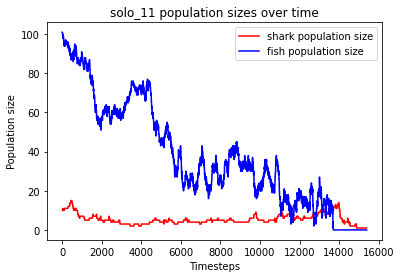

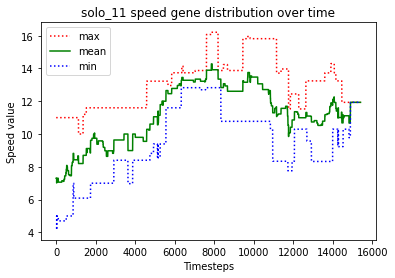

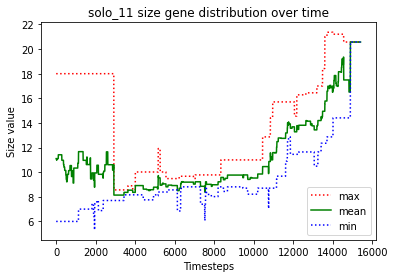

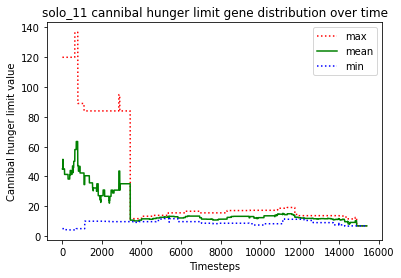

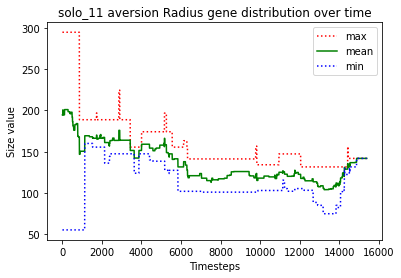

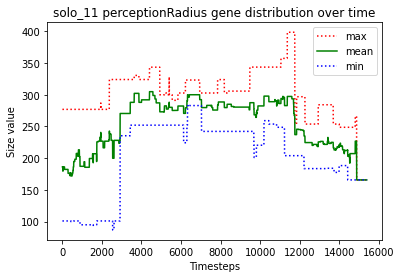

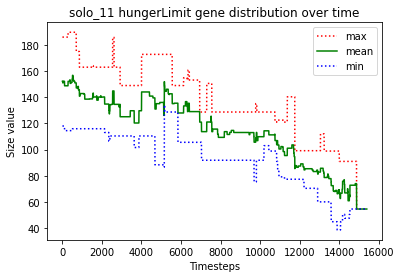





						SOLO_12

predator_3 just gave birth to predator_10
predator_3 killed predator_8
predator_2 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_10 starved to death
predator_1 ate the carcass of predator_10_carcass
predator_3 starved to death
predator_5 ate the carcass of predator_3_carcass
predator_13 starved to death
predator_0 starved to death
predator_1 ate the carcass of predator_0_carcass
predator_7 ate the carcass of predator_13_carcass
predator_2 starved to death
predator_11 ate the carcass of predator_2_carcass
predator_14 just gave birth to predator_15
predator_14 killed predator_15
predator_9 starved to death
predator_1 ate the carcass of predator_9_carcass
predator_14 starved to death
predator_1 ate the carcass of predator_14_carcass
predator_12 starved to death
predator_7 starved to death
predator_11 ate the carcass of predator_12_carcass
predator_11 at

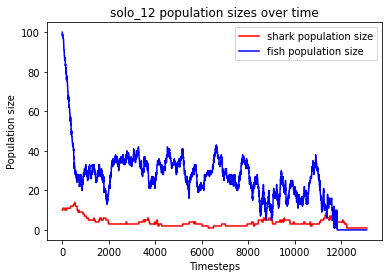

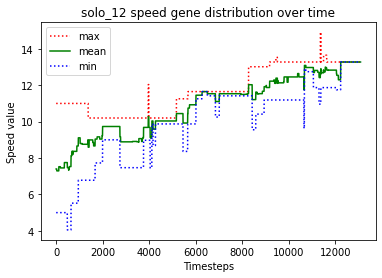

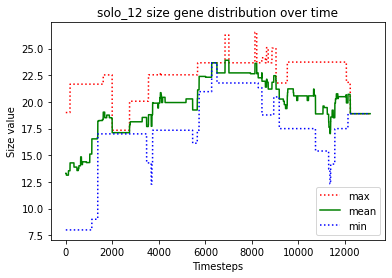

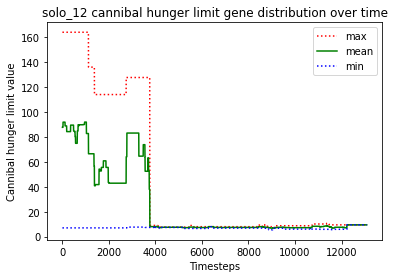

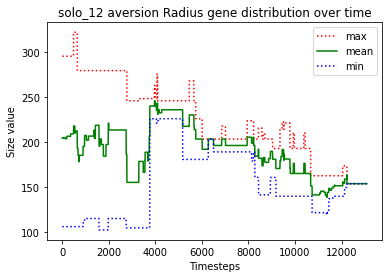

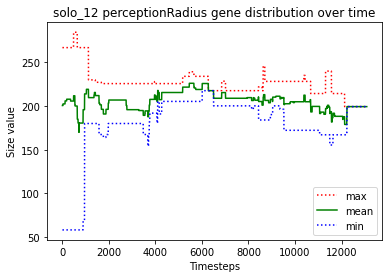

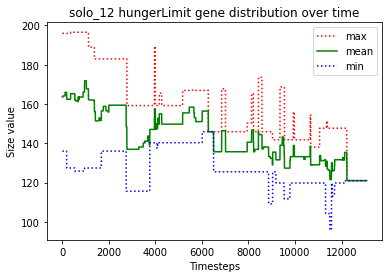





						SOLO_13

predator_1 just gave birth to predator_10
predator_1 killed predator_3
predator_0 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_12 starved to death
predator_8 just gave birth to predator_16
predator_15 ate the carcass of predator_12_carcass
predator_8 killed predator_16
predator_0 starved to death
predator_11 just gave birth to predator_17
predator_15 ate the carcass of predator_0_carcass
predator_17 starved to death
predator_11 starved to death
predator_10 ate the carcass of predator_17_carcass
predator_1 ate the carcass of predator_11_carcass
predator_14 starved to death
predator_15 ate the carcass of predator_14_carcass
predator_8 just gave birth to predator_18
predator_6 just gave birth to predator_19
predator_19 just gave birth to predator_20
predator_18 starved to death
predator_10 ate the carcass of 

predator_68 killed predator_66
predator_58 just gave birth to predator_70
predator_69 just gave birth to predator_71
predator_68 killed predator_71
predator_58 just gave birth to predator_72
predator_58 starved to death
predator_68 ate the carcass of predator_58_carcass
predator_65 starved to death
predator_54 just gave birth to predator_73
predator_70 ate the carcass of predator_65_carcass
predator_73 starved to death
predator_72 ate the carcass of predator_73_carcass
predator_60 just gave birth to predator_74
predator_60 just gave birth to predator_75
predator_75 starved to death
predator_68 ate the carcass of predator_75_carcass
predator_54 just gave birth to predator_76
predator_74 starved to death
predator_68 ate the carcass of predator_74_carcass
predator_76 just gave birth to predator_77
predator_77 killed predator_60
predator_68 just gave birth to predator_78
predator_72 just gave birth to predator_79
predator_72 starved to death
predator_79 starved to death
predator_70 ate the

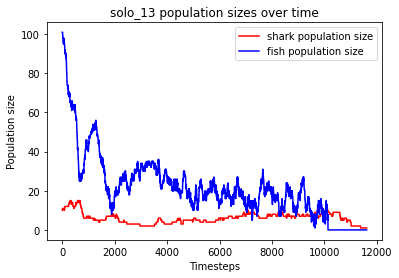

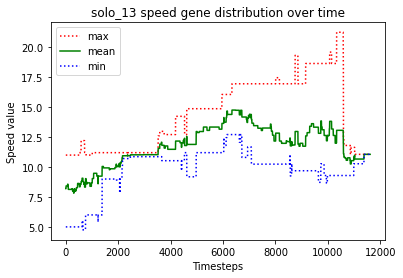

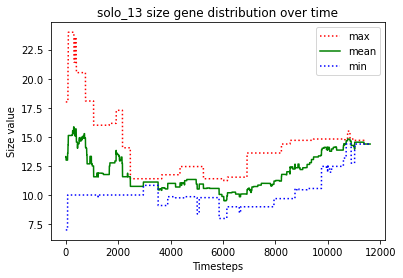

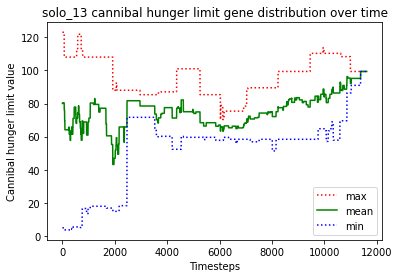

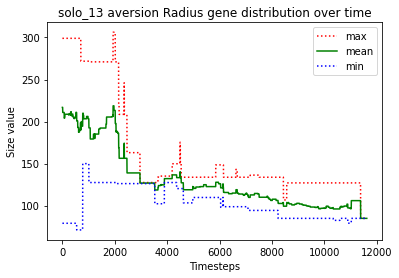

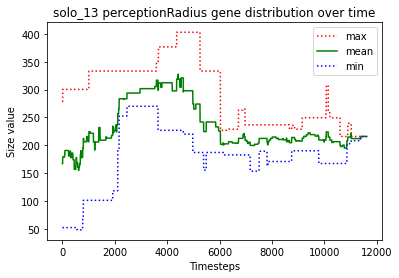

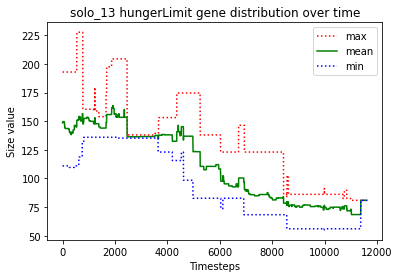





						SOLO_14

predator_4 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_0 killed predator_13
predator_6 just gave birth to predator_14
predator_1 just gave birth to predator_15
predator_1 killed predator_12
predator_5 killed predator_10
predator_1 killed predator_4
predator_5 just gave birth to predator_16
predator_1 just gave birth to predator_17
predator_9 just gave birth to predator_18
predator_1 just gave birth to predator_19
predator_15 killed predator_7
predator_3 just gave birth to predator_20
predator_2 just gave birth to predator_21
predator_20 starved to death
predator_3 ate the carcass of predator_20_carcass
predator_1 starved to death
predator_19 starved to death
predator_11 starved to death
predator_16 ate the carcass of predator_1_carcass
predator_18 ate the carcass of predator_19_carcass
predator_3 ate the carcass of predator_11_carcass
predator_2 j

predator_34 just gave birth to predator_73
predator_41 just gave birth to predator_74
predator_60 just gave birth to predator_75
predator_65 just gave birth to predator_76
predator_65 just gave birth to predator_77
predator_71 starved to death
predator_77 starved to death
predator_66 ate the carcass of predator_71_carcass
predator_60 ate the carcass of predator_77_carcass
predator_74 killed predator_35
predator_76 starved to death
predator_72 starved to death
predator_55 ate the carcass of predator_72_carcass
predator_73 starved to death
predator_60 ate the carcass of predator_76_carcass
predator_65 starved to death
predator_74 ate the carcass of predator_65_carcass
predator_74 ate the carcass of predator_73_carcass
predator_74 killed predator_55
predator_74 just gave birth to predator_78
predator_34 just gave birth to predator_79
predator_78 starved to death
predator_75 just gave birth to predator_80
predator_41 ate the carcass of predator_78_carcass
predator_79 killed predator_66
pre

predator_132 just gave birth to predator_135
predator_60 just gave birth to predator_136
predator_135 starved to death
predator_96 ate the carcass of predator_135_carcass
predator_134 just gave birth to predator_137
predator_128 just gave birth to predator_138
predator_130 just gave birth to predator_139
predator_139 just gave birth to predator_140
predator_140 just gave birth to predator_141
predator_140 starved to death
predator_141 starved to death
predator_132 ate the carcass of predator_140_carcass
predator_136 starved to death
predator_139 starved to death
predator_132 ate the carcass of predator_141_carcass
predator_128 ate the carcass of predator_139_carcass
predator_137 ate the carcass of predator_136_carcass
predator_134 starved to death
predator_96 ate the carcass of predator_134_carcass
predator_132 just gave birth to predator_142
predator_142 just gave birth to predator_143
predator_143 starved to death
predator_125 ate the carcass of predator_143_carcass
predator_137 star

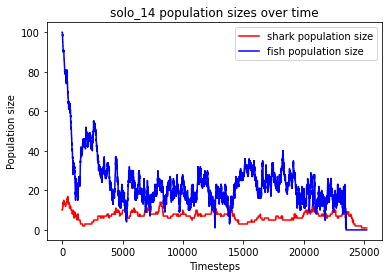

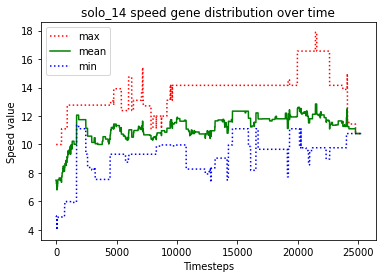

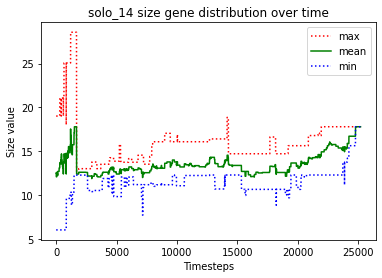

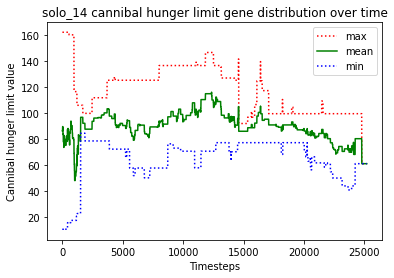

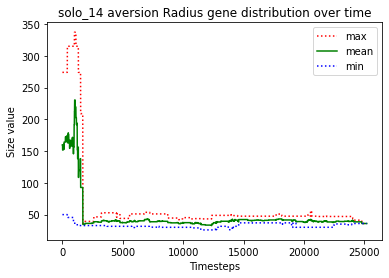

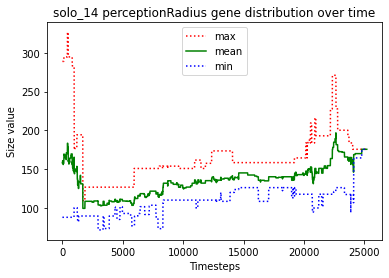

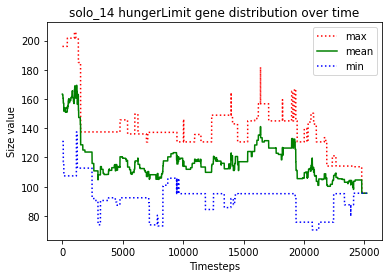





						SOLO_15

predator_9 killed predator_7
predator_9 killed predator_4
predator_6 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_12 killed predator_6
predator_11 killed predator_2
predator_8 killed predator_0
predator_3 just gave birth to predator_13
predator_8 killed predator_5
predator_13 just gave birth to predator_14
predator_13 starved to death
predator_14 ate the carcass of predator_13_carcass
predator_3 starved to death
predator_9 ate the carcass of predator_3_carcass
predator_14 starved to death
predator_1 ate the carcass of predator_14_carcass
predator_1 just gave birth to predator_15
predator_12 just gave birth to predator_16
predator_12 starved to death
predator_16 starved to death
predator_10 starved to death
predator_9 ate the carcass of predator_12_carcass
predator_15 just gave birth to predator_17
predator_1 ate the carcass of predator_10_carcass
predator_9 ate the carcass of predator_16_

predator_19 just gave birth to predator_71
predator_69 starved to death
predator_70 starved to death
predator_64 ate the carcass of predator_70_carcass
predator_19 ate the carcass of predator_69_carcass
predator_19 just gave birth to predator_72
predator_71 killed predator_55
predator_72 just gave birth to predator_73
predator_72 just gave birth to predator_74
predator_73 killed predator_58
predator_74 starved to death
predator_19 ate the carcass of predator_74_carcass
predator_71 starved to death
predator_73 ate the carcass of predator_71_carcass
predator_19 just gave birth to predator_75
predator_75 starved to death
predator_19 ate the carcass of predator_75_carcass
predator_72 starved to death
predator_73 ate the carcass of predator_72_carcass
predator_19 just gave birth to predator_76
predator_62 just gave birth to predator_77
predator_76 starved to death
predator_62 ate the carcass of predator_76_carcass
predator_64 just gave birth to predator_78
predator_19 just gave birth to pre

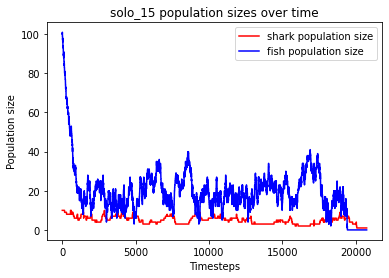

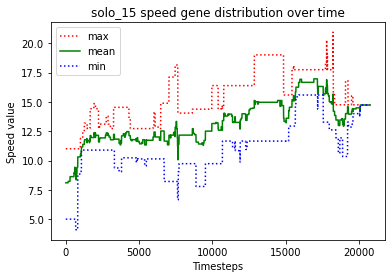

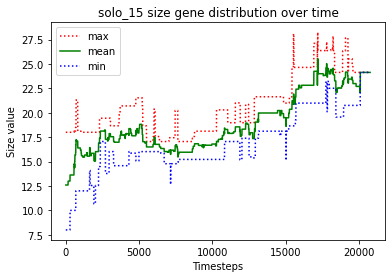

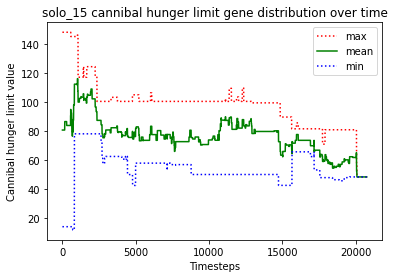

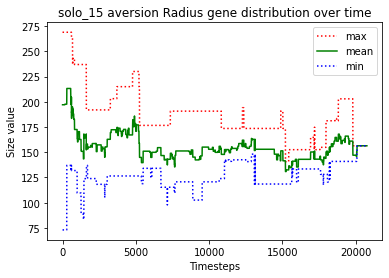

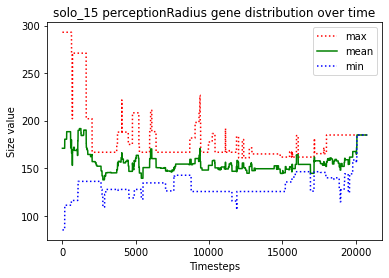

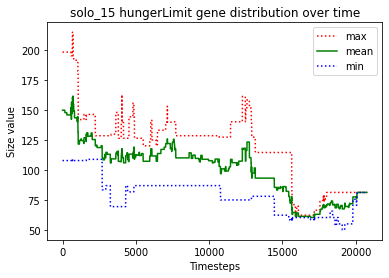





						SOLO_16

predator_4 killed predator_7
predator_2 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_10 starved to death
predator_11 starved to death
predator_0 ate the carcass of predator_10_carcass
predator_6 just gave birth to predator_12
predator_5 ate the carcass of predator_11_carcass
predator_0 just gave birth to predator_13
predator_13 starved to death
predator_3 just gave birth to predator_14
predator_4 ate the carcass of predator_13_carcass
predator_0 starved to death
predator_9 ate the carcass of predator_0_carcass
predator_5 starved to death
predator_2 starved to death
predator_12 ate the carcass of predator_2_carcass
predator_6 ate the carcass of predator_5_carcass
predator_9 just gave birth to predator_15
predator_3 just gave birth to predator_16
predator_3 just gave birth to predator_17
predator_17 starved to death
predator_3 starved to death
predator_16 ate the carcass of predator_3_carcass
predator_14 killed predator_15
predator

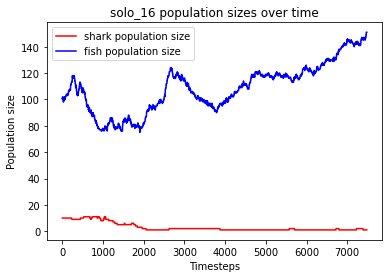

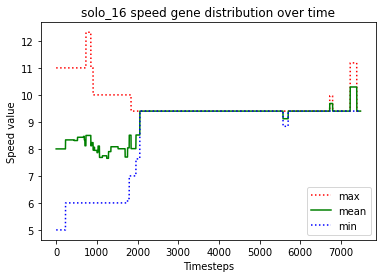

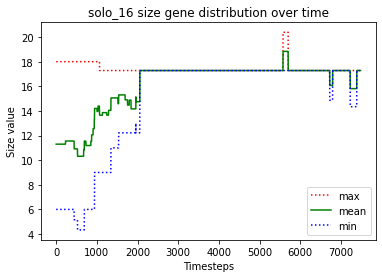

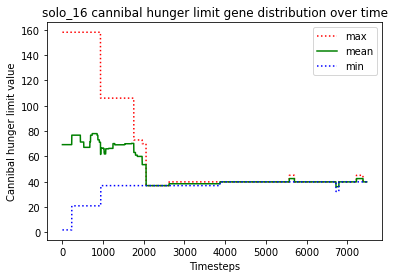

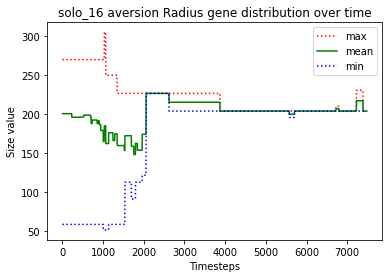

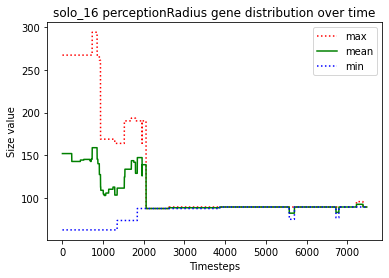

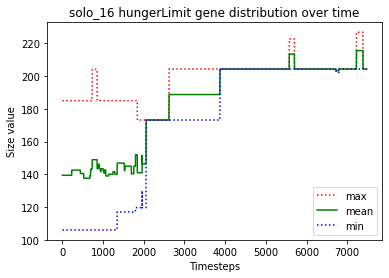





						SOLO_17

predator_9 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_3 killed predator_2
predator_12 starved to death
predator_1 just gave birth to predator_15
predator_10 ate the carcass of predator_12_carcass
predator_5 just gave birth to predator_16
predator_0 just gave birth to predator_17
predator_4 just gave birth to predator_18
predator_1 starved to death
predator_16 ate the carcass of predator_1_carcass
predator_15 starved to death
predator_4 just gave birth to predator_19
predator_17 killed predator_3
predator_5 starved to death
predator_11 ate the carcass of predator_5_carcass
predator_19 starved to death
predator_10 ate the carcass of predator_15_carcass
predator_16 starved to death
predator_10 ate the carcass of predator_16_carcass
predator_0 just gave birth to predator_20
predator_20 killed predator_8
preda

predator_52 just gave birth to predator_66
predator_66 starved to death
predator_55 ate the carcass of predator_66_carcass
predator_52 just gave birth to predator_67
predator_67 starved to death
predator_62 ate the carcass of predator_67_carcass
predator_52 starved to death
predator_62 ate the carcass of predator_52_carcass
predator_62 just gave birth to predator_68
predator_68 starved to death
predator_55 ate the carcass of predator_68_carcass
predator_62 just gave birth to predator_69
predator_69 starved to death
predator_55 ate the carcass of predator_69_carcass
predator_56 just gave birth to predator_70
predator_62 just gave birth to predator_71
predator_62 starved to death
predator_71 ate the carcass of predator_62_carcass
predator_56 just gave birth to predator_72
predator_56 just gave birth to predator_73
predator_73 starved to death
predator_56 ate the carcass of predator_73_carcass
predator_71 starved to death
predator_70 starved to death
predator_56 ate the carcass of predato

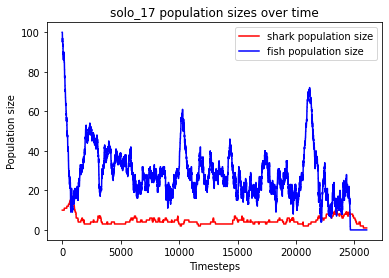

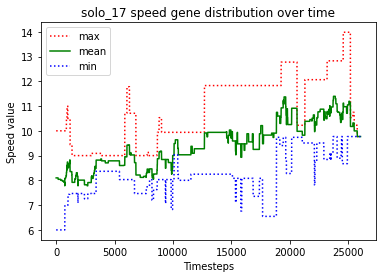

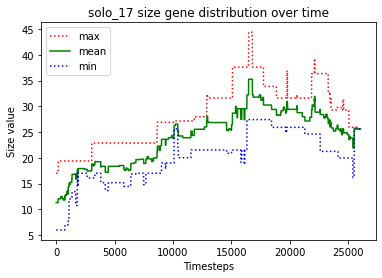

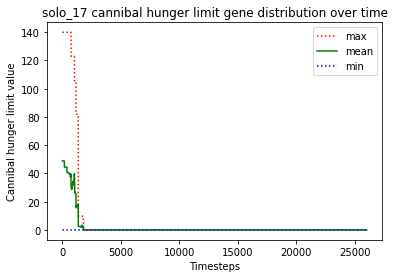

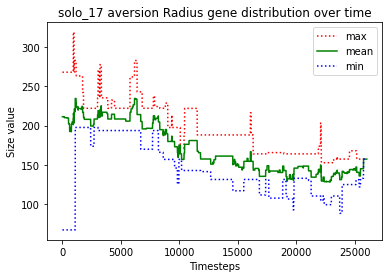

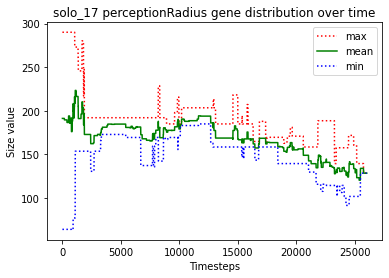

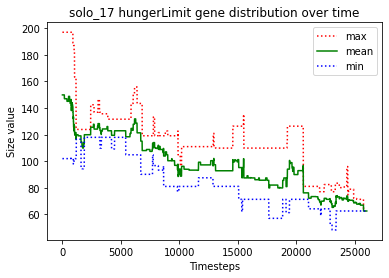





						SOLO_18

predator_8 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_6 killed predator_3
predator_0 just gave birth to predator_12
predator_10 starved to death
predator_4 just gave birth to predator_13
predator_6 ate the carcass of predator_10_carcass
predator_8 starved to death
predator_6 just gave birth to predator_14
predator_14 killed predator_1
predator_5 ate the carcass of predator_8_carcass
predator_14 killed predator_0
predator_6 killed predator_12
predator_11 starved to death
predator_14 ate the carcass of predator_11_carcass
predator_9 starved to death
predator_7 ate the carcass of predator_9_carcass
predator_4 starved to death
predator_14 ate the carcass of predator_4_carcass
predator_14 just gave birth to predator_15
predator_7 starved to death
predator_5 just gave birth to predator_16
predator_5 killed predator_16
predator_14 killed predator_15
predator_6 ate the carcass of predator_7_carcass
predator_13 starved to death
predator_

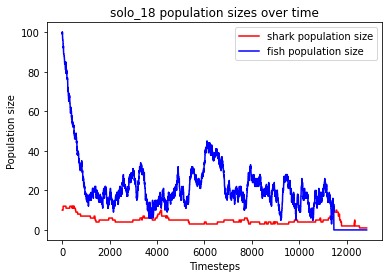

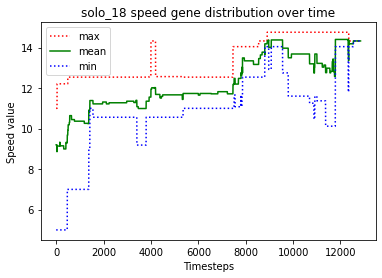

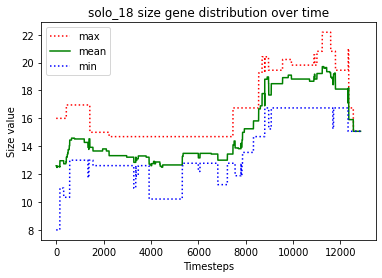

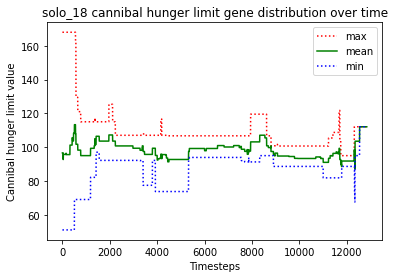

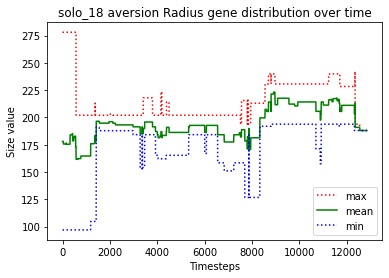

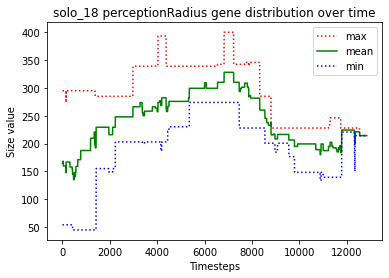

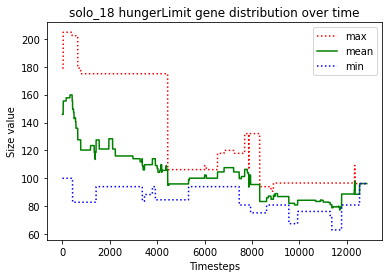





						SOLO_19

predator_0 just gave birth to predator_10
predator_0 killed predator_10
predator_0 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_13 just gave birth to predator_15
predator_11 killed predator_2
predator_7 just gave birth to predator_16
predator_6 killed predator_9
predator_12 starved to death
predator_13 ate the carcass of predator_12_carcass
predator_14 starved to death
predator_16 starved to death
predator_3 ate the carcass of predator_16_carcass
predator_8 ate the carcass of predator_14_carcass
predator_7 starved to death
predator_3 ate the carcass of predator_7_carcass
predator_15 starved to death
predator_8 ate the carcass of predator_15_carcass
predator_8 just gave birth to predator_17
predator_13 just gave birth to predator_18
predator_13 starved to death
predator_18 ate the carcass of predator_13_carcass
predator_1 starved to death
predator_3

predator_67 starved to death
predator_62 ate the carcass of predator_67_carcass
predator_65 just gave birth to predator_68
predator_46 just gave birth to predator_69
predator_43 starved to death
predator_69 ate the carcass of predator_43_carcass
predator_62 starved to death
predator_65 ate the carcass of predator_62_carcass
predator_68 starved to death
predator_46 ate the carcass of predator_68_carcass
predator_46 just gave birth to predator_70
predator_70 starved to death
predator_65 ate the carcass of predator_70_carcass
predator_69 just gave birth to predator_71
predator_46 just gave birth to predator_72
predator_71 killed predator_65
predator_72 just gave birth to predator_73
predator_72 killed predator_73
predator_72 starved to death
predator_71 just gave birth to predator_74
predator_71 killed predator_74
predator_71 just gave birth to predator_75
predator_71 starved to death
predator_75 starved to death
predator_46 ate the carcass of predator_75_carcass
predator_69 ate the carca

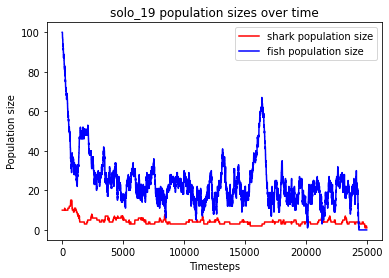

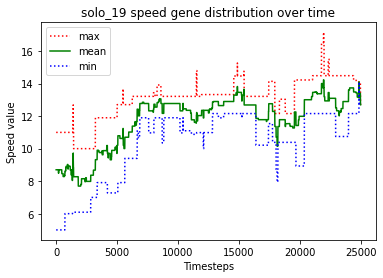

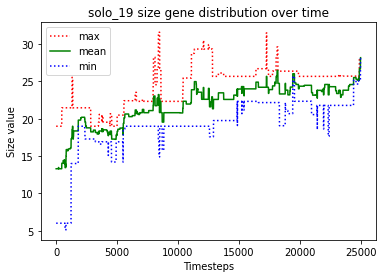

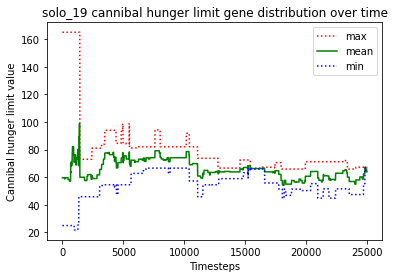

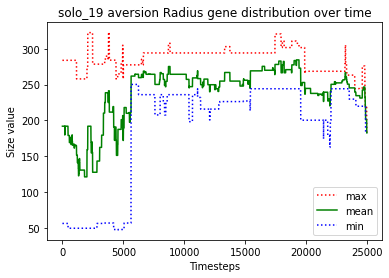

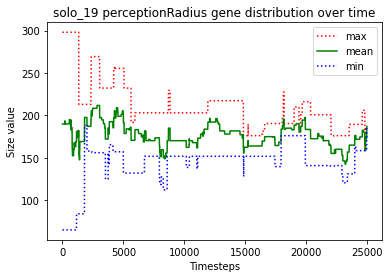

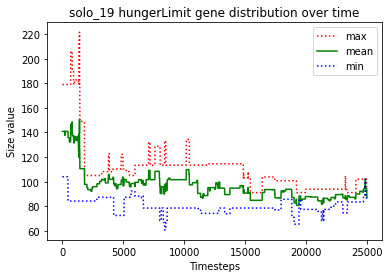





						SOLO_20

predator_5 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_4 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_11 starved to death
predator_5 starved to death
predator_13 killed predator_8
predator_2 ate the carcass of predator_11_carcass
predator_1 ate the carcass of predator_5_carcass
predator_10 killed predator_6
predator_1 just gave birth to predator_14
predator_1 killed predator_0
predator_14 just gave birth to predator_15
predator_14 killed predator_9
predator_1 killed predator_13
predator_12 just gave birth to predator_16
predator_15 starved to death
predator_14 starved to death
predator_1 ate the carcass of predator_14_carcass
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_1 ate the carcass of predator_15_carcass
predator_3 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_16 starved to death
predator_18 ate the carcass o

predator_63 just gave birth to predator_70
predator_66 starved to death
predator_63 ate the carcass of predator_66_carcass
predator_67 just gave birth to predator_71
predator_71 starved to death
predator_67 starved to death
predator_63 ate the carcass of predator_71_carcass
predator_70 ate the carcass of predator_67_carcass
predator_70 just gave birth to predator_72
predator_65 just gave birth to predator_73
predator_65 just gave birth to predator_74
predator_72 starved to death
predator_73 ate the carcass of predator_72_carcass
predator_70 just gave birth to predator_75
predator_74 just gave birth to predator_76
predator_65 starved to death
predator_75 just gave birth to predator_77
predator_76 starved to death
predator_63 ate the carcass of predator_65_carcass
predator_74 ate the carcass of predator_76_carcass
predator_74 just gave birth to predator_78
predator_75 starved to death
predator_51 ate the carcass of predator_75_carcass
predator_78 starved to death
predator_51 ate the carc

predator_131 starved to death
predator_104 ate the carcass of predator_131_carcass
predator_119 starved to death
predator_104 ate the carcass of predator_119_carcass
predator_104 killed predator_123
predator_51 just gave birth to predator_132
predator_104 starved to death
predator_113 ate the carcass of predator_104_carcass
predator_122 just gave birth to predator_133
predator_133 starved to death
predator_130 ate the carcass of predator_133_carcass
predator_122 starved to death
predator_129 ate the carcass of predator_122_carcass
predator_51 just gave birth to predator_134
predator_134 just gave birth to predator_135
predator_134 killed predator_135
predator_132 starved to death
predator_51 starved to death
predator_129 just gave birth to predator_136
predator_134 ate the carcass of predator_132_carcass
predator_136 just gave birth to predator_137
predator_137 ate the carcass of predator_51_carcass
predator_134 just gave birth to predator_138
predator_130 starved to death
predator_137

predator_185 starved to death
predator_187 ate the carcass of predator_185_carcass
predator_184 just gave birth to predator_188
predator_186 just gave birth to predator_189
predator_164 just gave birth to predator_190
predator_184 starved to death
predator_186 starved to death
predator_189 ate the carcass of predator_186_carcass
predator_164 ate the carcass of predator_184_carcass
predator_190 starved to death
predator_172 ate the carcass of predator_190_carcass
predator_188 starved to death
predator_172 ate the carcass of predator_188_carcass
predator_164 just gave birth to predator_191
predator_164 starved to death
predator_187 ate the carcass of predator_164_carcass
predator_191 starved to death
predator_187 ate the carcass of predator_191_carcass
predator_189 just gave birth to predator_192
predator_192 starved to death
predator_189 ate the carcass of predator_192_carcass
predator_189 just gave birth to predator_193
predator_189 starved to death
predator_193 ate the carcass of pred

predator_233 ate the carcass of predator_240_carcass
predator_243 just gave birth to predator_246
predator_246 just gave birth to predator_247
predator_247 just gave birth to predator_248
predator_247 starved to death
predator_248 starved to death
predator_233 ate the carcass of predator_248_carcass
predator_246 ate the carcass of predator_247_carcass
predator_246 just gave birth to predator_249
predator_233 just gave birth to predator_250
predator_227 starved to death
predator_250 starved to death
predator_233 ate the carcass of predator_227_carcass
predator_246 ate the carcass of predator_250_carcass
predator_239 starved to death
predator_243 just gave birth to predator_251
predator_249 killed predator_251
predator_246 ate the carcass of predator_239_carcass
predator_243 just gave birth to predator_252
predator_252 starved to death
predator_233 ate the carcass of predator_252_carcass
predator_249 just gave birth to predator_253
predator_253 just gave birth to predator_254
predator_25

predator_306 starved to death
predator_297 just gave birth to predator_307
predator_297 killed predator_307
predator_298 ate the carcass of predator_306_carcass
predator_288 ate the carcass of predator_300_carcass
predator_298 just gave birth to predator_308
predator_280 just gave birth to predator_309
predator_298 just gave birth to predator_310
predator_297 just gave birth to predator_311
predator_298 starved to death
predator_290 starved to death
predator_280 ate the carcass of predator_290_carcass
predator_311 starved to death
predator_288 just gave birth to predator_312
predator_288 killed predator_312
predator_308 ate the carcass of predator_311_carcass
predator_288 ate the carcass of predator_298_carcass
predator_280 just gave birth to predator_313
predator_288 just gave birth to predator_314
predator_309 just gave birth to predator_315
predator_280 just gave birth to predator_316
predator_308 starved to death
predator_280 starved to death
predator_309 ate the carcass of predato

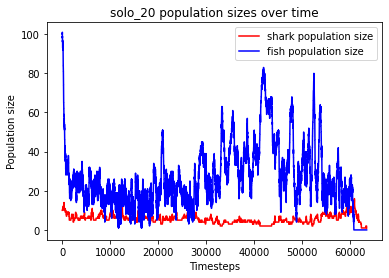

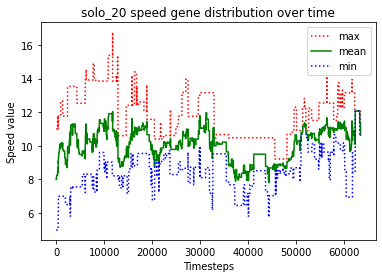

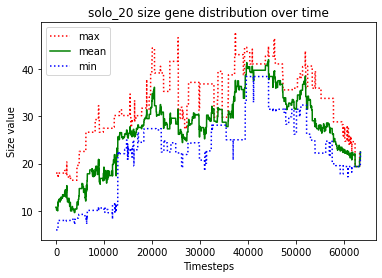

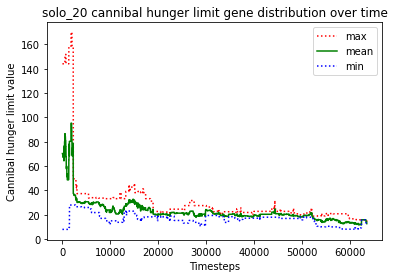

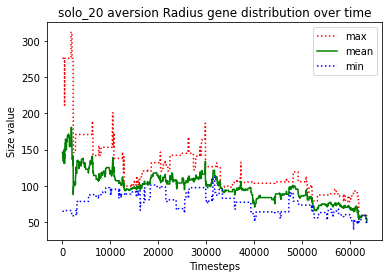

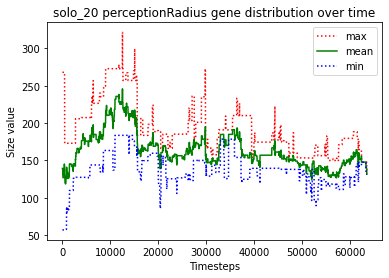

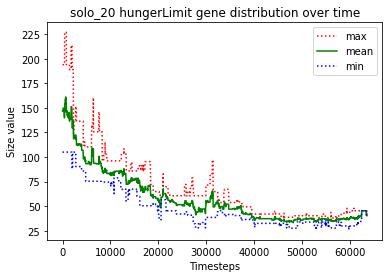





						SOLO_21

predator_9 killed predator_5
predator_8 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_11 killed predator_12
predator_10 just gave birth to predator_14
predator_10 killed predator_14
predator_8 killed predator_1
predator_9 just gave birth to predator_15
predator_8 killed predator_13
predator_0 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_10 just gave birth to predator_18
predator_10 killed predator_18
predator_10 killed predator_4
predator_7 just gave birth to predator_19
predator_7 starved to death
predator_19 starved to death
predator_8 ate the carcass of predator_19_carcass
predator_17 ate the carcass of predator_7_carcass
predator_0 killed predator_2
predator_9 just gave birth to predator_20
predator_8 just gave birth to predator_21
predator_11 just gave birth to predator_22
predator_10 starved to death
preda

predator_70 starved to death
predator_67 ate the carcass of predator_70_carcass
predator_59 starved to death
predator_68 ate the carcass of predator_59_carcass
predator_58 just gave birth to predator_71
predator_71 killed predator_69
predator_58 just gave birth to predator_72
predator_71 starved to death
predator_67 ate the carcass of predator_71_carcass
predator_72 just gave birth to predator_73
predator_73 starved to death
predator_58 ate the carcass of predator_73_carcass
predator_72 starved to death
predator_58 ate the carcass of predator_72_carcass
predator_67 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_75 starved to death
predator_58 ate the carcass of predator_75_carcass
predator_74 just gave birth to predator_76
predator_74 starved to death
predator_58 ate the carcass of predator_74_carcass
predator_76 starved to death
predator_58 ate the carcass of predator_76_carcass
predator_58 just gave birth to predator_77
predator_68 just gave birth 

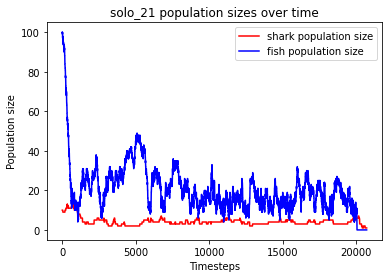

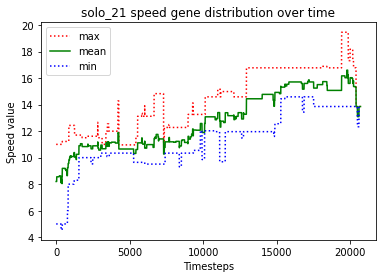

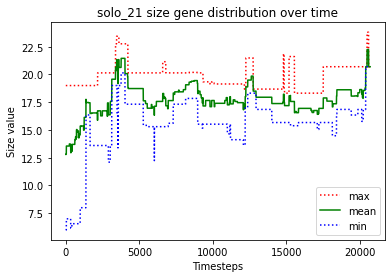

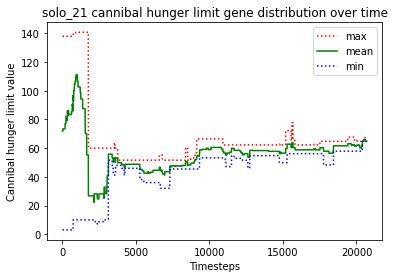

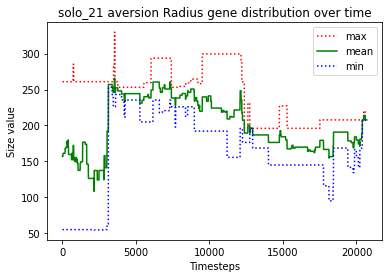

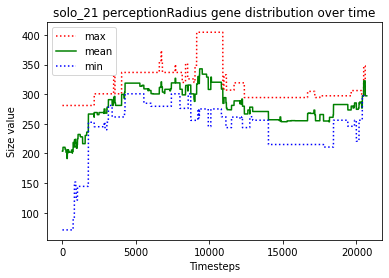

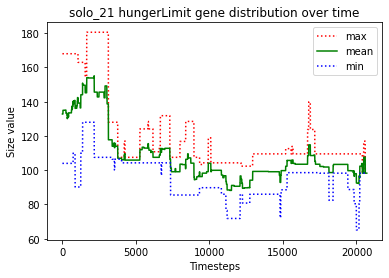





						SOLO_22

predator_0 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_4 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_12 starved to death
predator_2 ate the carcass of predator_12_carcass
predator_13 starved to death
predator_1 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_0 ate the carcass of predator_1_carcass
predator_15 starved to death
predator_14 ate the carcass of predator_15_carcass
predator_4 starved to death
predator_6 ate the carcass of predator_4_carcass
predator_0 just gave birth to predator_17
predator_5 starved to death
predator_2 ate the carcass of predator_5_carcass
predator_17 just gave birth to predator_18
predator_17 starved to death
predator_18 starved to death
predator_0 ate the carcass of predator_17_carcass
predator_0 ate the carca

predator_60 just gave birth to predator_67
predator_64 starved to death
predator_63 ate the carcass of predator_64_carcass
predator_60 starved to death
predator_59 ate the carcass of predator_60_carcass
predator_63 just gave birth to predator_68
predator_63 just gave birth to predator_69
predator_68 just gave birth to predator_70
predator_70 starved to death
predator_69 starved to death
predator_68 ate the carcass of predator_70_carcass
predator_68 ate the carcass of predator_69_carcass
predator_67 just gave birth to predator_71
predator_71 starved to death
predator_59 ate the carcass of predator_71_carcass
predator_67 starved to death
predator_68 ate the carcass of predator_67_carcass
predator_63 just gave birth to predator_72
predator_63 starved to death
predator_68 just gave birth to predator_73
predator_72 ate the carcass of predator_63_carcass
predator_73 just gave birth to predator_74
predator_74 starved to death
predator_68 just gave birth to predator_75
predator_73 killed preda

predator_129 starved to death
predator_127 ate the carcass of predator_126_carcass
predator_123 just gave birth to predator_130
predator_130 just gave birth to predator_131
predator_131 starved to death
predator_130 starved to death
predator_95 ate the carcass of predator_129_carcass
predator_127 ate the carcass of predator_130_carcass
predator_123 starved to death
predator_127 ate the carcass of predator_131_carcass
predator_120 just gave birth to predator_132
predator_120 ate the carcass of predator_123_carcass
predator_120 just gave birth to predator_133
predator_120 killed predator_133
predator_117 just gave birth to predator_134
predator_132 just gave birth to predator_135
predator_120 just gave birth to predator_136
predator_120 killed predator_136
predator_120 just gave birth to predator_137
predator_95 just gave birth to predator_138
predator_135 starved to death
predator_117 just gave birth to predator_139
predator_138 starved to death
predator_139 ate the carcass of predator_

predator_120 just gave birth to predator_188
predator_188 killed predator_185
predator_186 just gave birth to predator_189
predator_120 just gave birth to predator_190
predator_186 just gave birth to predator_191
predator_188 just gave birth to predator_192
predator_120 just gave birth to predator_193
predator_120 starved to death
predator_190 just gave birth to predator_194
predator_194 starved to death
predator_190 ate the carcass of predator_194_carcass
predator_191 starved to death
predator_176 ate the carcass of predator_191_carcass
predator_188 ate the carcass of predator_120_carcass
predator_189 starved to death
predator_188 ate the carcass of predator_189_carcass
predator_188 just gave birth to predator_195
predator_195 just gave birth to predator_196
predator_186 just gave birth to predator_197
predator_197 just gave birth to predator_198
predator_197 starved to death
predator_198 starved to death
predator_186 starved to death
predator_188 ate the carcass of predator_186_carca

predator_246 just gave birth to predator_249
predator_249 starved to death
predator_246 ate the carcass of predator_249_carcass
predator_246 just gave birth to predator_250
predator_247 starved to death
predator_250 ate the carcass of predator_247_carcass
predator_239 starved to death
predator_246 ate the carcass of predator_239_carcass
predator_250 starved to death
predator_240 starved to death
predator_243 ate the carcass of predator_250_carcass
predator_246 ate the carcass of predator_240_carcass
predator_243 just gave birth to predator_251
predator_243 just gave birth to predator_252
predator_252 starved to death
predator_243 ate the carcass of predator_252_carcass
predator_243 just gave birth to predator_253
predator_243 starved to death
predator_246 just gave birth to predator_254
predator_246 ate the carcass of predator_243_carcass
predator_254 starved to death
predator_251 ate the carcass of predator_254_carcass
predator_246 just gave birth to predator_255
predator_246 just gav

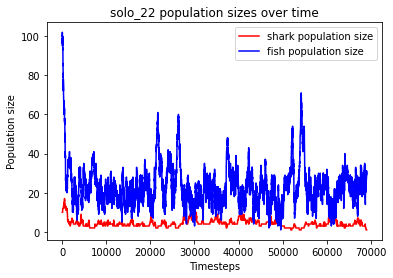

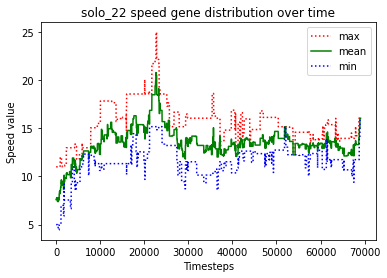

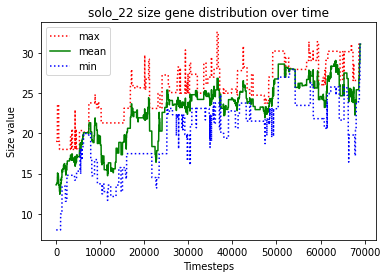

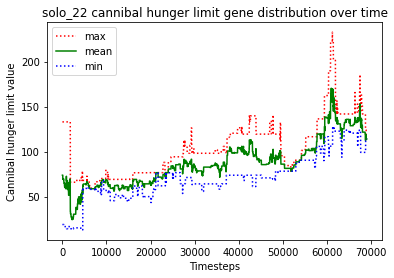

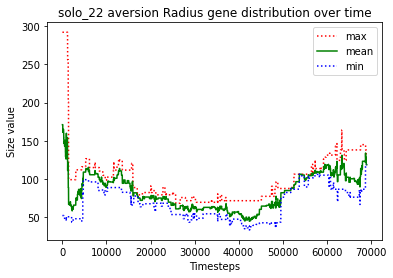

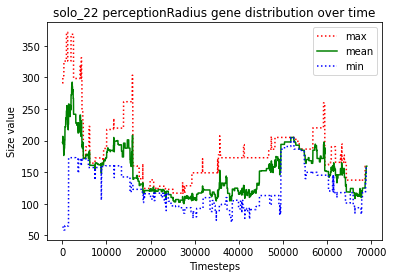

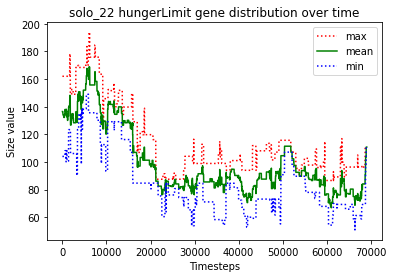





						SOLO_23

predator_1 just gave birth to predator_10
predator_1 killed predator_0
predator_4 just gave birth to predator_11
predator_1 killed predator_9
predator_11 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_12 starved to death
predator_7 ate the carcass of predator_12_carcass
predator_11 starved to death
predator_13 ate the carcass of predator_11_carcass
predator_7 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_7 just gave birth to predator_16
predator_4 starved to death
predator_6 ate the carcass of predator_4_carcass
predator_15 killed predator_7
predator_15 killed predator_14
predator_8 killed predator_16
predator_8 killed predator_5
predator_1 just gave birth to predator_17
predator_15 killed predator_2
predator_1 killed predator_17
predator_6 just gave birth to predator_18
predator_1 starved to death
predator_8 ate the carcass of predator_1_carcass
predator_13 starved to death
predator_8 ate the car

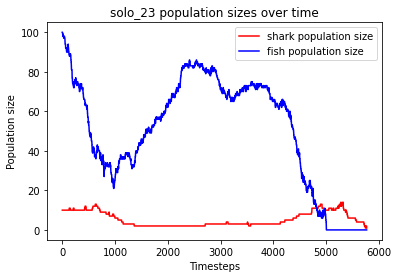

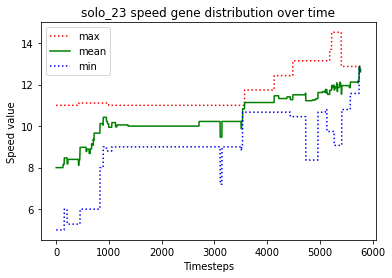

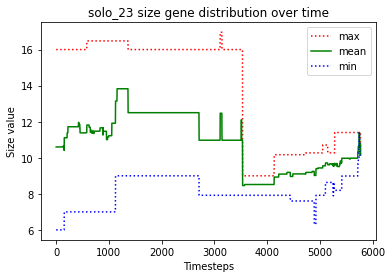

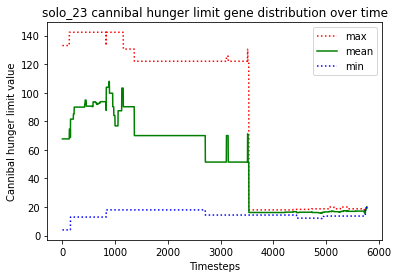

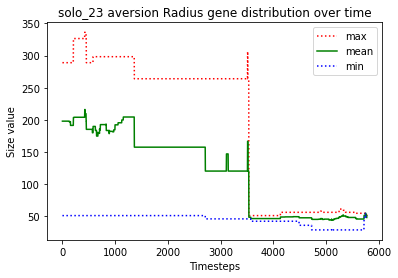

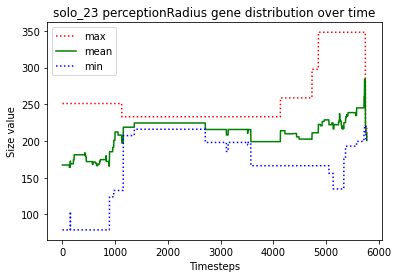

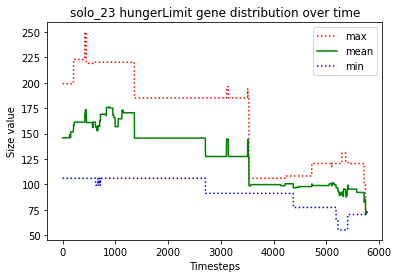





						SOLO_24

predator_4 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_10 killed predator_11
predator_4 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_4 starved to death
predator_2 ate the carcass of predator_4_carcass
predator_13 starved to death
predator_12 just gave birth to predator_15
predator_14 starved to death
predator_9 ate the carcass of predator_13_carcass
predator_6 ate the carcass of predator_14_carcass
predator_0 starved to death
predator_15 starved to death
predator_2 ate the carcass of predator_0_carcass
predator_3 ate the carcass of predator_15_carcass
predator_12 starved to death
predator_5 ate the carcass of predator_12_carcass
predator_10 starved to death
predator_6 just gave birth to predator_16
predator_7 ate the carcass of predator_10_carcass
predator_2 just gave birth to predator_17
predator_8 just gave birth to predator_18
predator_5 killed pred

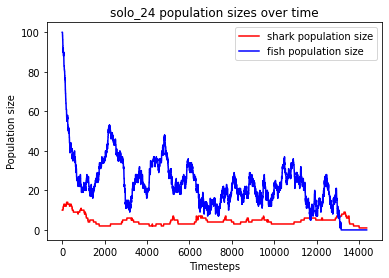

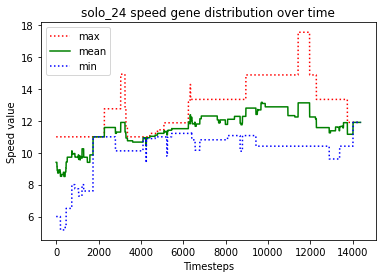

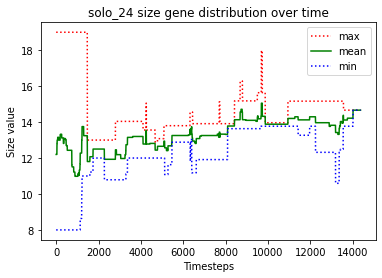

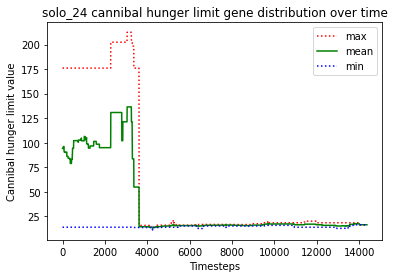

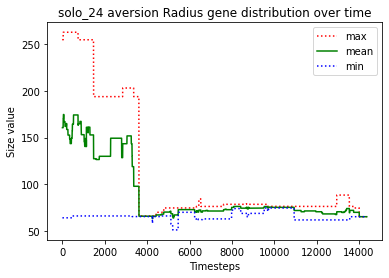

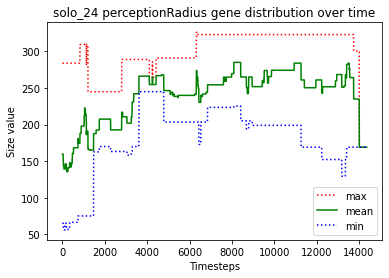

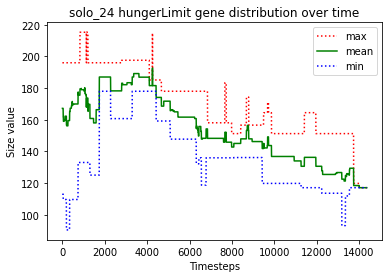





						SOLO_25

predator_1 just gave birth to predator_10
predator_0 killed predator_7
predator_10 starved to death
predator_8 ate the carcass of predator_10_carcass
predator_1 starved to death
predator_4 ate the carcass of predator_1_carcass
predator_5 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_5 just gave birth to predator_15
predator_5 killed predator_15
predator_6 starved to death
predator_2 just gave birth to predator_16
predator_8 ate the carcass of predator_6_carcass
predator_4 starved to death
predator_0 just gave birth to predator_17
predator_9 ate the carcass of predator_4_carcass
predator_3 just gave birth to predator_18
predator_2 starved to death
predator_16 starved to death
predator_9 ate the carcass of predator_2_carcass
predator_17 ate the carcass of predator_16_carcass
predator_11 starved to death
predator_13 ate the carcass of predator_11_carca

predator_55 just gave birth to predator_67
predator_66 starved to death
predator_67 just gave birth to predator_68
predator_68 ate the carcass of predator_66_carcass
predator_60 just gave birth to predator_69
predator_38 just gave birth to predator_70
predator_57 just gave birth to predator_71
predator_60 just gave birth to predator_72
no fish to move
predator_55 starved to death
predator_71 ate the carcass of predator_55_carcass
predator_72 just gave birth to predator_73
predator_60 starved to death
predator_73 starved to death
predator_68 ate the carcass of predator_60_carcass
predator_72 starved to death
predator_71 just gave birth to predator_74
predator_57 ate the carcass of predator_72_carcass
predator_38 ate the carcass of predator_73_carcass
predator_69 starved to death
predator_71 ate the carcass of predator_69_carcass
predator_68 just gave birth to predator_75
predator_67 starved to death
predator_74 ate the carcass of predator_67_carcass
predator_70 starved to death
predator

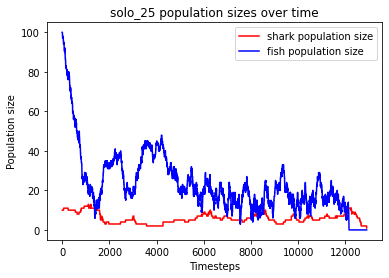

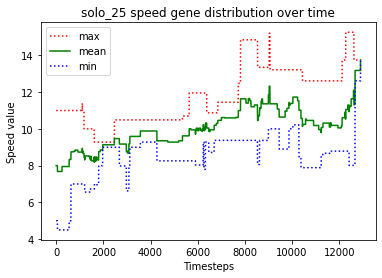

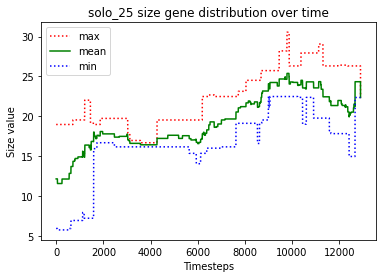

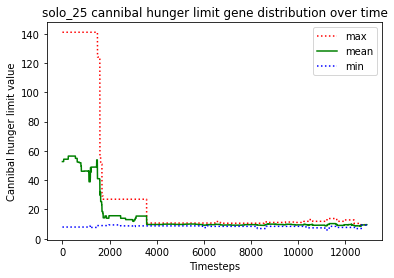

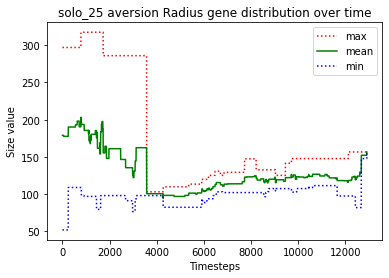

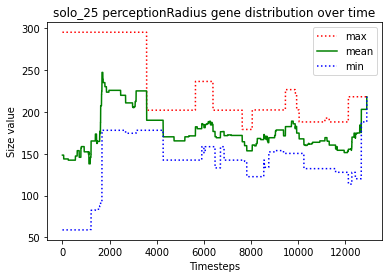

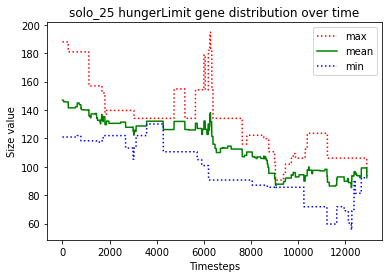





						SOLO_26

predator_9 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_4 killed predator_0
predator_6 killed predator_7
predator_1 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_11 starved to death
predator_4 killed predator_14
predator_13 killed predator_10
predator_13 just gave birth to predator_15
predator_9 ate the carcass of predator_11_carcass
predator_15 just gave birth to predator_16
predator_16 killed predator_6
predator_15 starved to death
predator_13 ate the carcass of predator_15_carcass
predator_12 starved to death
predator_16 starved to death
predator_13 ate the carcass of predator_12_carcass
predator_3 just gave birth to predator_17
predator_13 ate the carcass of predator_16_carcass
predator_13 just gave birth to predator_18
predator_18 killed predator_5
predator_2 just gave birth to predator_19
predator_9 starved to death
predator_13 starved to death
pre

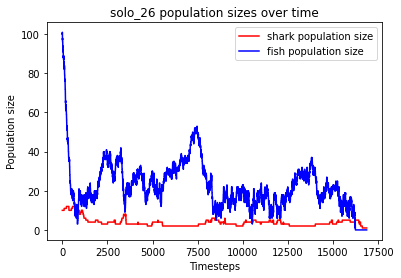

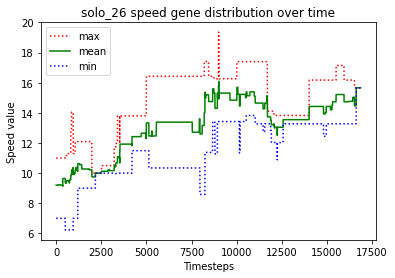

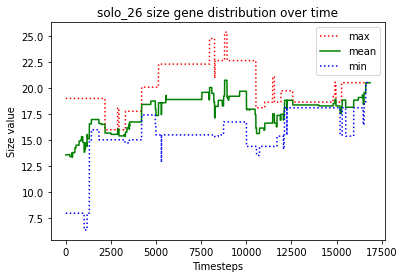

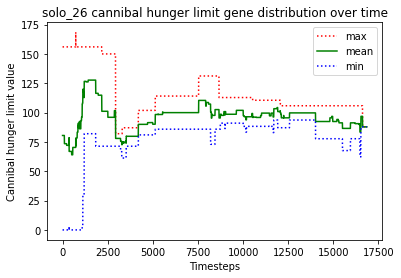

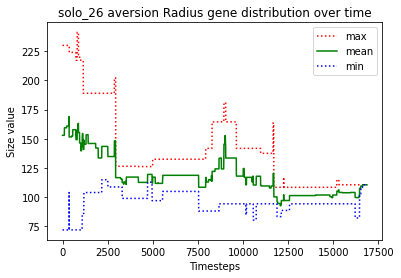

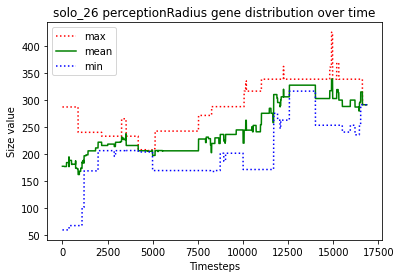

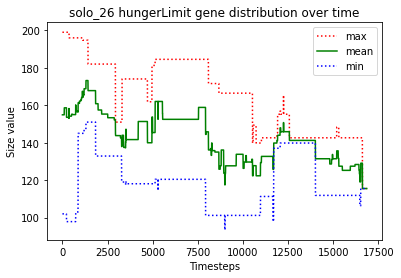





						SOLO_27

predator_1 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_12 killed predator_0
predator_12 just gave birth to predator_14
predator_12 starved to death
predator_14 ate the carcass of predator_12_carcass
predator_5 just gave birth to predator_15
predator_8 just gave birth to predator_16
predator_11 just gave birth to predator_17
predator_15 just gave birth to predator_18
predator_5 just gave birth to predator_19
predator_11 starved to death
predator_17 starved to death
predator_16 ate the carcass of predator_17_carcass
predator_13 starved to death
predator_16 ate the carcass of predator_11_carcass
predator_4 ate the carcass of predator_13_carcass
predator_1 starved to death
predator_10 ate the carcass of predator_1_carcass
predator_14 killed predator_15
predator_8 starved to death
predator_6 ate the carcass of predator_8_carcass
predator_10 starved to

predator_55 starved to death
predator_59 ate the carcass of predator_55_carcass
predator_69 starved to death
predator_66 ate the carcass of predator_69_carcass
predator_70 just gave birth to predator_72
predator_59 just gave birth to predator_73
predator_73 starved to death
predator_66 ate the carcass of predator_73_carcass
predator_59 starved to death
predator_62 ate the carcass of predator_59_carcass
predator_66 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_74 starved to death
predator_62 ate the carcass of predator_74_carcass
predator_66 just gave birth to predator_76
predator_76 starved to death
predator_66 starved to death
predator_70 ate the carcass of predator_76_carcass
predator_75 starved to death
predator_37 ate the carcass of predator_66_carcass
predator_70 just gave birth to predator_77
predator_77 ate the carcass of predator_75_carcass
predator_77 just gave birth to predator_78
predator_70 killed predator_78
predator_62 just gave birth 

predator_120 just gave birth to predator_132
no fish to move
predator_125 just gave birth to predator_133
predator_120 starved to death
predator_131 just gave birth to predator_134
predator_134 ate the carcass of predator_120_carcass
predator_131 starved to death
predator_129 ate the carcass of predator_131_carcass
predator_124 starved to death
predator_132 ate the carcass of predator_124_carcass
predator_134 starved to death
predator_129 ate the carcass of predator_134_carcass
predator_129 just gave birth to predator_135
predator_133 starved to death
predator_132 ate the carcass of predator_133_carcass
predator_125 starved to death
predator_135 ate the carcass of predator_125_carcass
predator_132 just gave birth to predator_136
predator_129 starved to death
predator_132 ate the carcass of predator_129_carcass
predator_136 starved to death
predator_132 ate the carcass of predator_136_carcass
predator_96 starved to death
predator_135 starved to death
predator_132 starved to death


fini

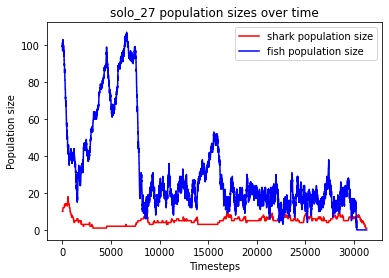

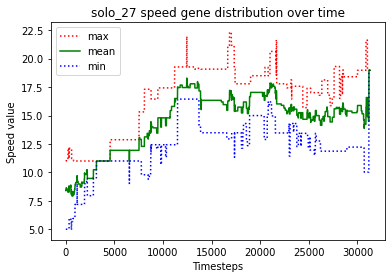

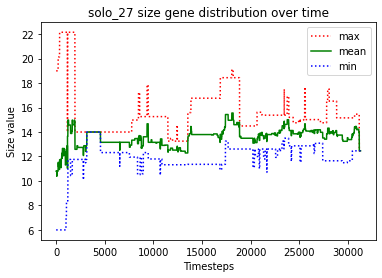

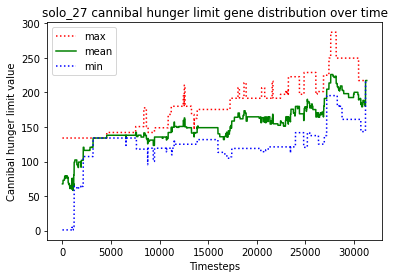

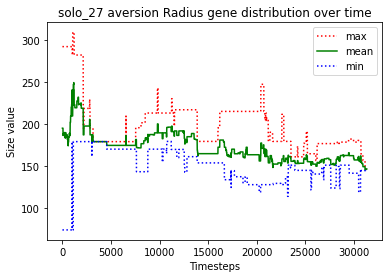

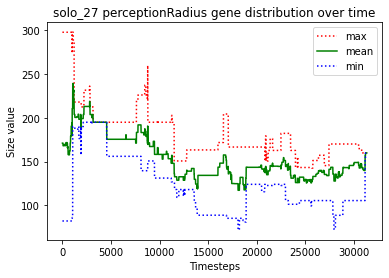

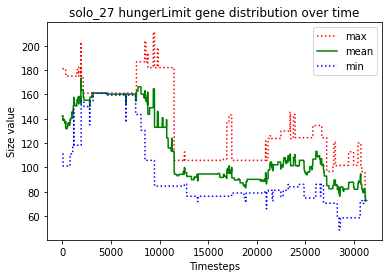





						SOLO_28

predator_8 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_10 killed predator_9
predator_8 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_8 killed predator_7
predator_10 starved to death
predator_8 ate the carcass of predator_10_carcass
predator_11 starved to death
predator_1 ate the carcass of predator_11_carcass
predator_6 starved to death
predator_14 starved to death
predator_13 just gave birth to predator_15
predator_8 ate the carcass of predator_6_carcass
predator_2 starved to death
predator_13 killed predator_12
predator_1 ate the carcass of predator_2_carcass
predator_15 starved to death
predator_13 ate the carcass of predator_15_carcass
predator_3 ate the carcass of predator_14_carcass
predator_13 killed predator_1
predator_13 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_0 starved to death
predator_4 ate the carcass of 

predator_69 ate the carcass of predator_46_carcass
predator_71 killed predator_25
predator_71 killed predator_56
predator_62 just gave birth to predator_72
predator_63 just gave birth to predator_73
predator_62 starved to death
predator_63 ate the carcass of predator_62_carcass
predator_71 killed predator_73
predator_72 starved to death
predator_69 ate the carcass of predator_72_carcass
predator_70 just gave birth to predator_74
predator_43 starved to death
predator_74 just gave birth to predator_75
predator_75 starved to death
predator_74 starved to death
predator_63 ate the carcass of predator_74_carcass
predator_63 ate the carcass of predator_75_carcass
predator_71 ate the carcass of predator_43_carcass
predator_70 just gave birth to predator_76
predator_69 just gave birth to predator_77
predator_77 killed predator_76
predator_70 starved to death
predator_63 just gave birth to predator_78
predator_77 killed predator_78
predator_69 ate the carcass of predator_70_carcass
predator_69 j

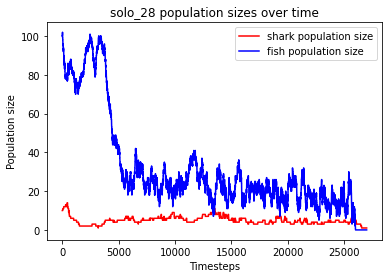

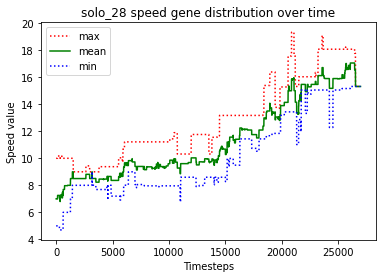

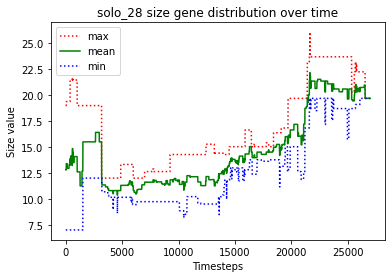

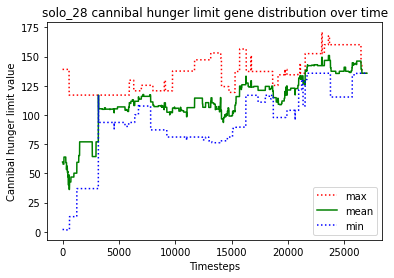

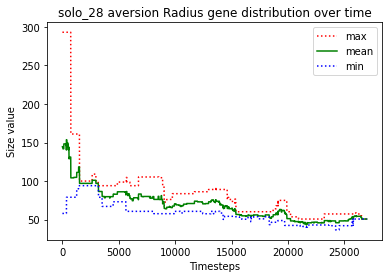

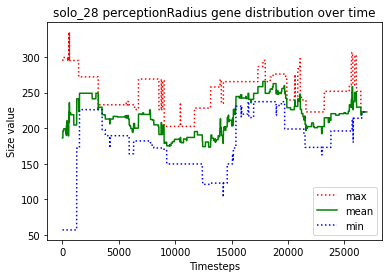

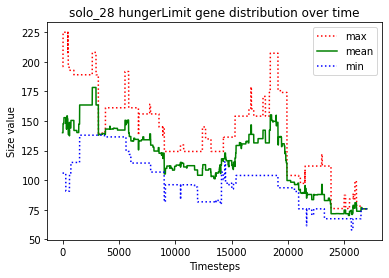





						SOLO_29

predator_8 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_5 killed predator_2
predator_5 killed predator_4
predator_1 just gave birth to predator_15
predator_5 killed predator_9
predator_3 just gave birth to predator_16
predator_5 killed predator_13
predator_7 just gave birth to predator_17
predator_6 just gave birth to predator_18
predator_3 just gave birth to predator_19
predator_10 starved to death
predator_6 ate the carcass of predator_10_carcass
predator_5 killed predator_1
predator_0 starved to death
predator_8 just gave birth to predator_20
predator_15 starved to death
predator_5 ate the carcass of predator_0_carcass
predator_14 starved to death
predator_12 just gave birth to predator_21
predator_17 ate the carcass of predator_14_carcass
predator_7 ate the carcass of predator_15_carcass
predator_18 st

predator_66 just gave birth to predator_73
predator_73 starved to death
predator_70 ate the carcass of predator_73_carcass
predator_66 starved to death
predator_57 ate the carcass of predator_66_carcass
predator_72 starved to death
predator_70 ate the carcass of predator_72_carcass
predator_52 starved to death
predator_54 ate the carcass of predator_52_carcass
predator_70 starved to death
predator_71 ate the carcass of predator_70_carcass
predator_54 just gave birth to predator_74
predator_57 starved to death
predator_54 ate the carcass of predator_57_carcass
predator_71 starved to death
predator_54 just gave birth to predator_75
predator_74 starved to death
predator_54 starved to death
predator_75 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 76
Timesteps passed: 12153
Fish went extinct at timestep 11457
Sharks went extinct at timestep 12153


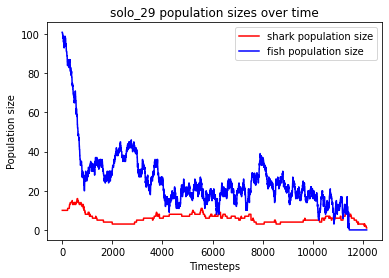

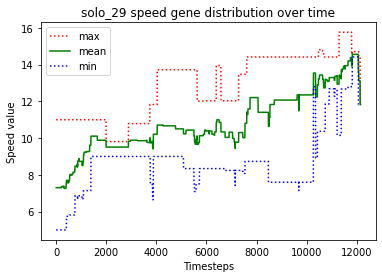

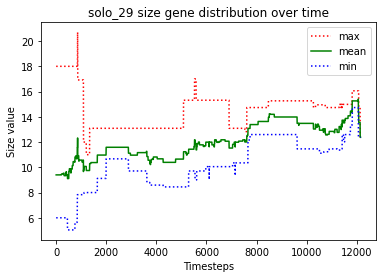

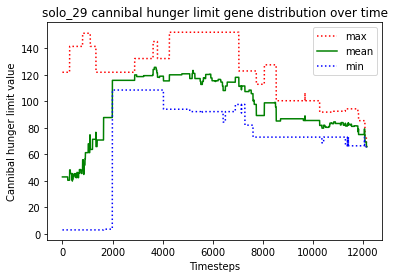

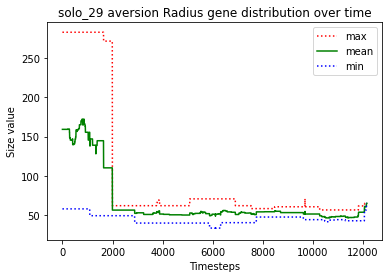

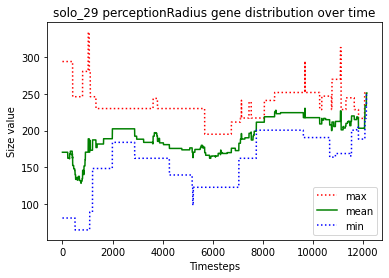

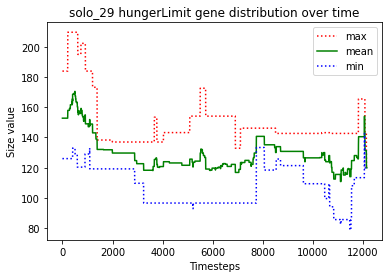





						SOLO_30

predator_1 just gave birth to predator_10
predator_1 killed predator_5
predator_1 killed predator_8
predator_1 killed predator_4
predator_1 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_12 starved to death
predator_0 just gave birth to predator_13
predator_0 ate the carcass of predator_12_carcass
predator_1 starved to death
predator_10 ate the carcass of predator_1_carcass
predator_11 starved to death
predator_2 ate the carcass of predator_11_carcass
predator_13 starved to death
predator_3 ate the carcass of predator_13_carcass
predator_2 starved to death
predator_6 ate the carcass of predator_2_carcass
predator_6 starved to death
predator_3 ate the carcass of predator_6_carcass
predator_7 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_0 starved to death
predator_9 starved to death
predator_14 ate the carcass of predator_0_carcass
predator_10 ate the carcass of predator_9_carcass
predator_14 just

predator_66 ate the carcass of predator_64_carcass
predator_62 ate the carcass of predator_49_carcass
predator_40 just gave birth to predator_69
predator_68 starved to death
predator_62 ate the carcass of predator_68_carcass
predator_66 just gave birth to predator_70
predator_62 just gave birth to predator_71
predator_70 starved to death
predator_66 starved to death
predator_69 just gave birth to predator_72
predator_62 ate the carcass of predator_70_carcass
predator_62 just gave birth to predator_73
predator_72 ate the carcass of predator_66_carcass
predator_69 starved to death
predator_71 ate the carcass of predator_69_carcass
predator_72 starved to death
predator_73 ate the carcass of predator_72_carcass
predator_41 just gave birth to predator_74
predator_62 starved to death
predator_73 ate the carcass of predator_62_carcass
predator_73 just gave birth to predator_75
predator_75 just gave birth to predator_76
predator_74 starved to death
predator_41 starved to death
predator_71 star

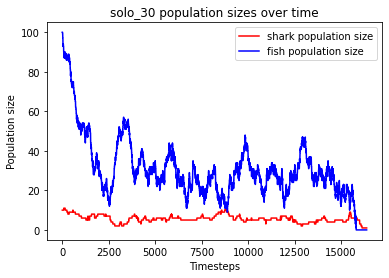

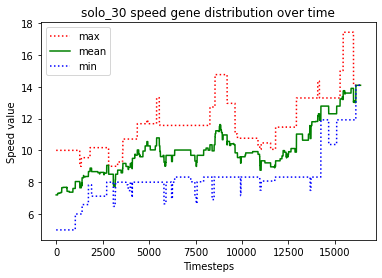

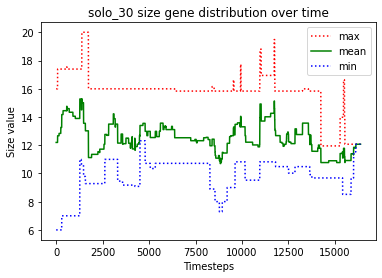

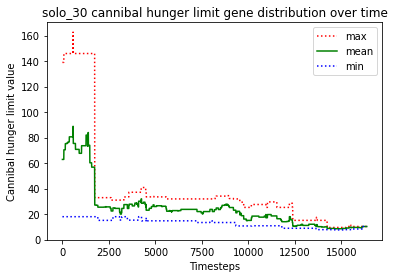

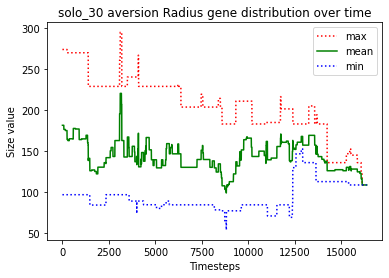

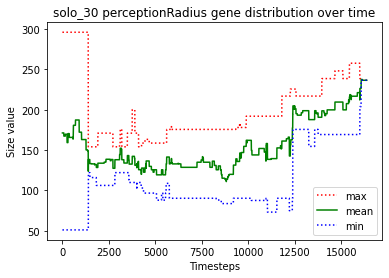

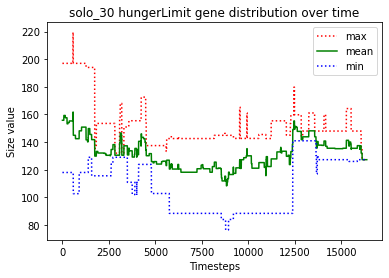





						SOLO_31

predator_1 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_1 starved to death
predator_7 killed predator_8
predator_0 ate the carcass of predator_1_carcass
predator_9 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_7 just gave birth to predator_16
predator_13 starved to death
predator_7 starved to death
predator_11 ate the carcass of predator_7_carcass
predator_12 killed predator_0
predator_16 starved to death
predator_9 ate the carcass of predator_16_carcass
predator_4 just gave birth to predator_17
predator_12 killed predator_15
predator_4 ate the carcass of predator_13_carcass
predator_9 just gave birth to predator_18
predator_11 just gave birth to predator_19
predator_12 starved to death
predator_17 ate the carcass of predator_12_carcass
predator_10 starved to death
predator_11 just gave birth to predator_20
preda

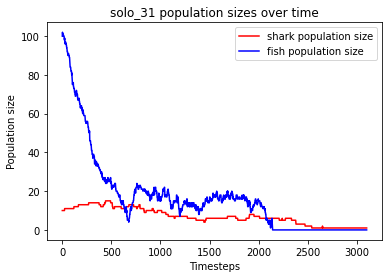

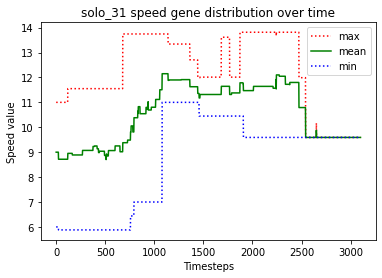

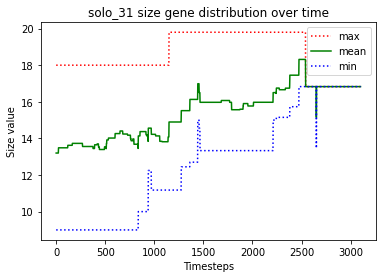

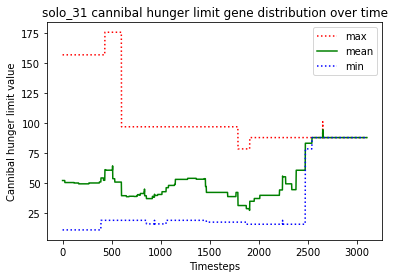

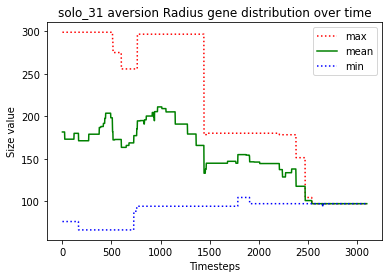

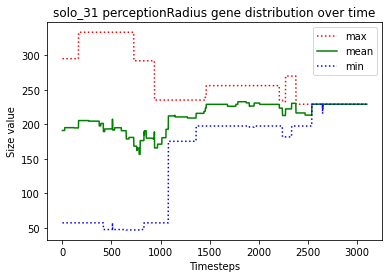

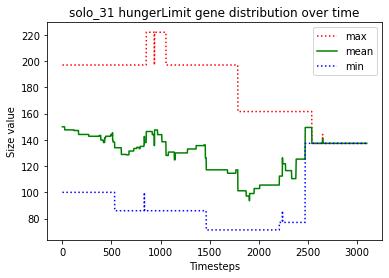





						SOLO_32

predator_5 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_14 killed predator_10
predator_3 killed predator_7
predator_11 starved to death
predator_3 ate the carcass of predator_11_carcass
predator_12 starved to death
predator_3 ate the carcass of predator_12_carcass
predator_14 killed predator_8
predator_5 starved to death
predator_14 ate the carcass of predator_5_carcass
predator_4 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_16 killed predator_15
predator_1 killed predator_9
predator_6 just gave birth to predator_17
predator_17 just gave birth to predator_18
predator_4 starved to death
predator_18 just gave birth to predator_19
predator_19 killed predator_17
predator_19 ate the carcass of predator_4_carcass
predator_18 starved to death
predator_19 ate the carcass of pr

predator_45 just gave birth to predator_69
predator_50 just gave birth to predator_70
predator_70 just gave birth to predator_71
predator_71 starved to death
predator_69 ate the carcass of predator_71_carcass
predator_50 starved to death
predator_52 ate the carcass of predator_50_carcass
predator_52 just gave birth to predator_72
predator_52 killed predator_72
predator_63 starved to death
predator_55 just gave birth to predator_73
predator_68 just gave birth to predator_74
predator_55 ate the carcass of predator_63_carcass
predator_74 starved to death
predator_45 ate the carcass of predator_74_carcass
predator_68 just gave birth to predator_75
predator_68 starved to death
predator_75 starved to death
predator_70 just gave birth to predator_76
predator_70 ate the carcass of predator_75_carcass
predator_76 ate the carcass of predator_68_carcass
predator_76 just gave birth to predator_77
predator_76 killed predator_55
predator_69 just gave birth to predator_78
predator_77 killed predator_

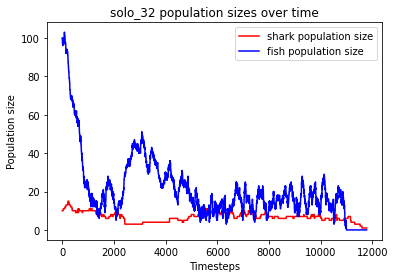

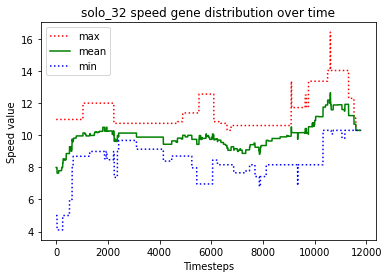

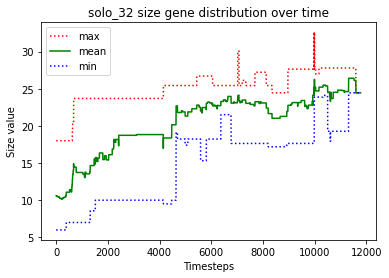

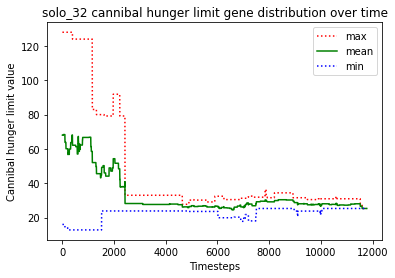

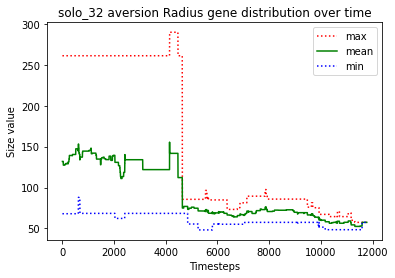

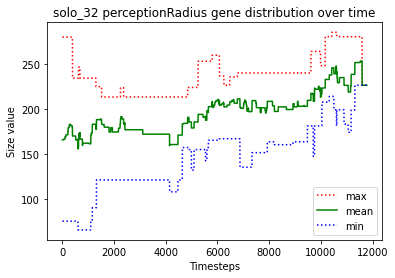

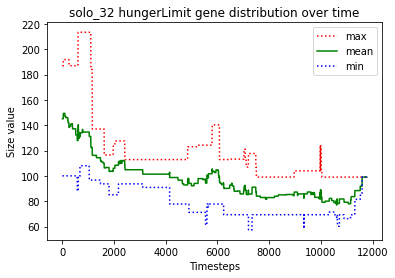





						SOLO_33

predator_6 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_11 killed predator_1
predator_10 killed predator_2
predator_8 just gave birth to predator_12
predator_11 killed predator_3
predator_0 just gave birth to predator_13
predator_10 killed predator_7
predator_10 starved to death
predator_13 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_0 starved to death
predator_13 starved to death
predator_14 starved to death
predator_4 ate the carcass of predator_10_carcass
predator_4 ate the carcass of predator_0_carcass
predator_4 ate the carcass of predator_13_carcass
predator_4 ate the carcass of predator_14_carcass
predator_15 just gave birth to predator_16
predator_9 starved to death
predator_15 ate the carcass of predator_9_carcass
predator_16 killed predator_4
predator_11 just gave birth to predator_17
predator_11 starved to death
predator_17 starved to death
predator_6 ate the carcass of predator_11

predator_64 ate the carcass of predator_65_carcass
predator_64 ate the carcass of predator_48_carcass
predator_49 just gave birth to predator_67
predator_49 just gave birth to predator_68
predator_49 just gave birth to predator_69
predator_64 starved to death
predator_68 ate the carcass of predator_64_carcass
predator_49 just gave birth to predator_70
predator_69 starved to death
predator_67 ate the carcass of predator_69_carcass
predator_70 starved to death
predator_67 ate the carcass of predator_70_carcass
predator_67 just gave birth to predator_71
predator_68 starved to death
predator_57 ate the carcass of predator_68_carcass
predator_57 just gave birth to predator_72
predator_67 just gave birth to predator_73
predator_67 starved to death
predator_73 starved to death
predator_72 ate the carcass of predator_67_carcass
predator_72 ate the carcass of predator_73_carcass
predator_49 just gave birth to predator_74
predator_49 killed predator_74
predator_49 just gave birth to predator_75


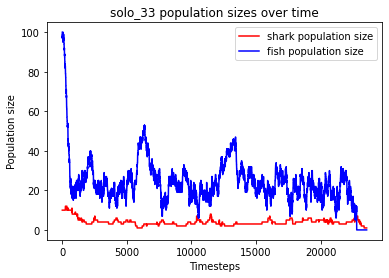

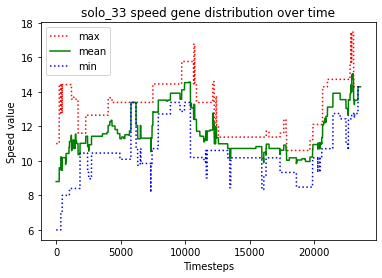

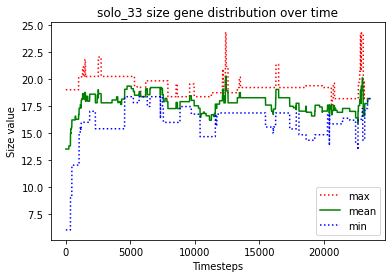

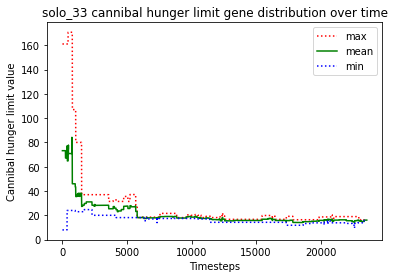

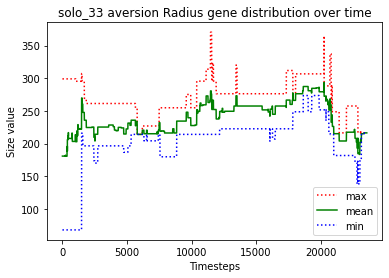

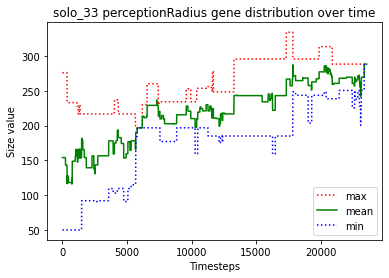

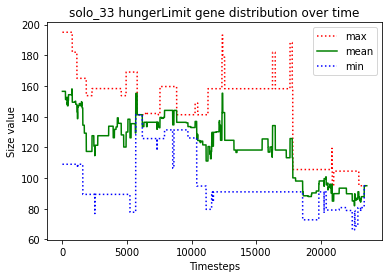





						SOLO_34

predator_6 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_13 killed predator_11
predator_1 killed predator_7
predator_6 starved to death
predator_2 ate the carcass of predator_6_carcass
predator_10 starved to death
predator_13 ate the carcass of predator_10_carcass
predator_4 just gave birth to predator_14
predator_2 just gave birth to predator_15
predator_0 starved to death
predator_8 starved to death
predator_13 ate the carcass of predator_0_carcass
predator_2 ate the carcass of predator_8_carcass
predator_1 killed predator_14
predator_4 starved to death
predator_9 starved to death
predator_12 starved to death
predator_5 ate the carcass of predator_9_carcass
predator_2 ate the carcass of predator_12_carcass
predator_3 ate the carcass of predator_4_carcass
predator_13 killed predator_15
predator_5 just gave birth to predator_16
predator_5 just gave 

predator_50 just gave birth to predator_72
predator_64 just gave birth to predator_73
predator_64 just gave birth to predator_74
no fish to move
predator_50 just gave birth to predator_75
predator_75 starved to death
predator_50 starved to death
predator_61 ate the carcass of predator_75_carcass
predator_61 ate the carcass of predator_50_carcass
predator_73 just gave birth to predator_76
predator_74 starved to death
predator_76 starved to death
predator_73 starved to death
predator_64 starved to death
predator_72 just gave birth to predator_77
predator_77 just gave birth to predator_78
predator_77 starved to death
predator_78 starved to death
predator_72 starved to death
predator_61 ate the carcass of predator_64_carcass
predator_61 ate the carcass of predator_78_carcass
predator_61 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 79
Timesteps passed: 18288
Fish went extinct at timestep 17316
Sharks went extinct at timestep 18

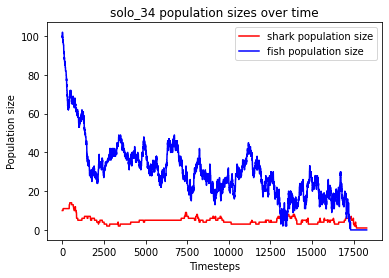

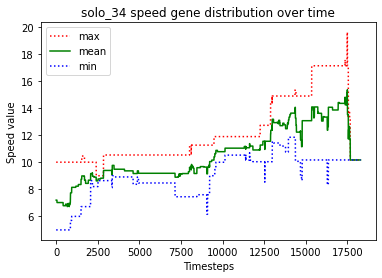

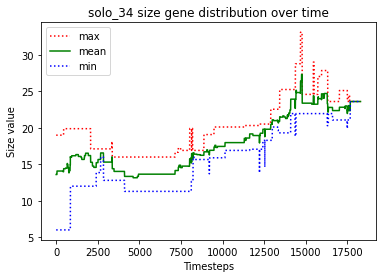

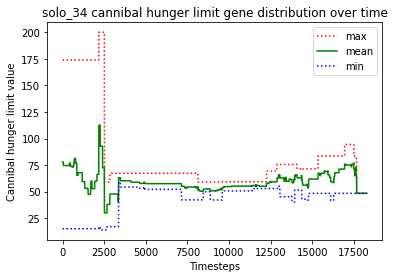

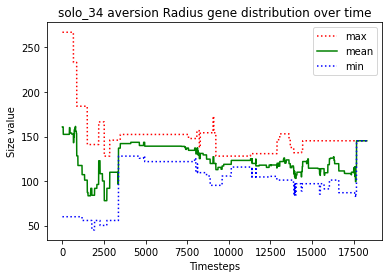

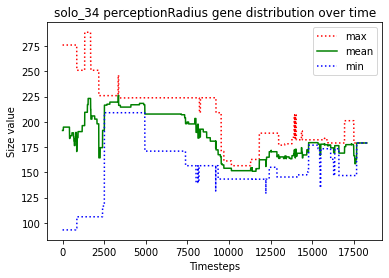

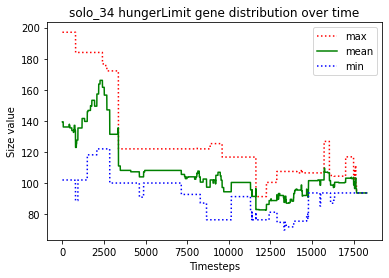





						SOLO_35

predator_7 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_11 killed predator_9
predator_6 killed predator_10
predator_2 killed predator_7
predator_11 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_11 killed predator_5
predator_4 just gave birth to predator_14
predator_12 killed predator_4
predator_13 starved to death
predator_3 just gave birth to predator_15
predator_1 ate the carcass of predator_13_carcass
predator_0 starved to death
predator_3 ate the carcass of predator_0_carcass
predator_14 just gave birth to predator_16
predator_16 just gave birth to predator_17
predator_16 killed predator_17
predator_1 just gave birth to predator_18
predator_12 starved to death
predator_6 ate the carcass of predator_12_carcass
predator_14 starved to death
predator_18 ate the carcass of predator_14_carcass
predator_16 starved to death
predator_6 ate the carcass of predator_16_carcass
predator_1 starved to deat

predator_65 starved to death
predator_61 ate the carcass of predator_65_carcass
predator_68 just gave birth to predator_70
predator_70 starved to death
predator_68 ate the carcass of predator_70_carcass
predator_68 just gave birth to predator_71
predator_61 just gave birth to predator_72
predator_71 starved to death
predator_61 just gave birth to predator_73
predator_68 starved to death
predator_73 ate the carcass of predator_68_carcass
predator_72 ate the carcass of predator_71_carcass
predator_73 just gave birth to predator_74
predator_61 starved to death
predator_64 just gave birth to predator_75
predator_64 killed predator_75
predator_69 ate the carcass of predator_61_carcass
predator_73 starved to death
predator_74 ate the carcass of predator_73_carcass
predator_64 just gave birth to predator_76
predator_74 just gave birth to predator_77
predator_72 starved to death
predator_76 ate the carcass of predator_72_carcass
predator_74 starved to death
predator_64 ate the carcass of preda

predator_121 ate the carcass of predator_127_carcass
predator_119 starved to death
predator_121 ate the carcass of predator_119_carcass
predator_121 just gave birth to predator_129
predator_126 just gave birth to predator_130
predator_126 killed predator_129
predator_130 starved to death
predator_125 ate the carcass of predator_130_carcass
predator_126 just gave birth to predator_131
predator_126 starved to death
predator_125 ate the carcass of predator_126_carcass
predator_131 starved to death
predator_125 ate the carcass of predator_131_carcass
predator_125 just gave birth to predator_132
predator_121 just gave birth to predator_133
predator_125 just gave birth to predator_134
predator_134 starved to death
predator_133 ate the carcass of predator_134_carcass
predator_121 starved to death
predator_133 ate the carcass of predator_121_carcass
predator_133 just gave birth to predator_135
predator_133 just gave birth to predator_136
predator_136 starved to death
predator_133 ate the carca

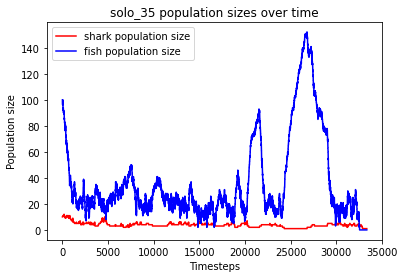

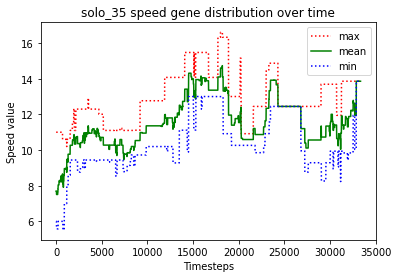

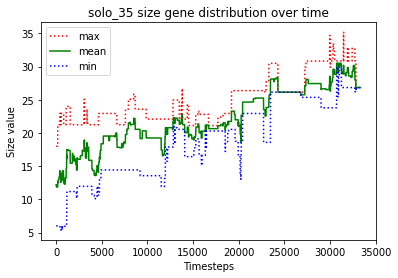

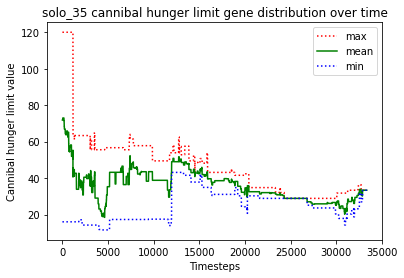

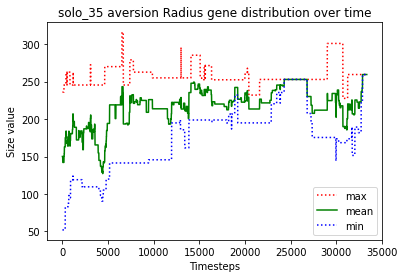

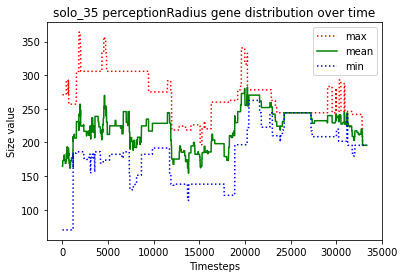

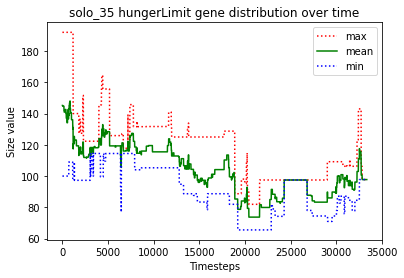





						SOLO_36

predator_2 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_13 starved to death
predator_10 starved to death
predator_0 just gave birth to predator_14
predator_0 ate the carcass of predator_13_carcass
predator_0 ate the carcass of predator_10_carcass
predator_11 killed predator_7
predator_2 starved to death
predator_11 ate the carcass of predator_2_carcass
predator_12 starved to death
predator_8 starved to death
predator_11 killed predator_6
predator_9 ate the carcass of predator_12_carcass
predator_0 just gave birth to predator_15
predator_9 ate the carcass of predator_8_carcass
predator_4 just gave birth to predator_16
predator_0 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_16 starved to death
predator_15 ate the carcass of predator_16_carcass
predator_18 starved to death
predator_9 ate the carcass of predator_1

predator_63 ate the carcass of predator_62_carcass
predator_50 starved to death
predator_68 starved to death
predator_58 ate the carcass of predator_68_carcass
predator_66 starved to death
predator_64 ate the carcass of predator_66_carcass
predator_63 just gave birth to predator_69
predator_64 just gave birth to predator_70
predator_58 ate the carcass of predator_50_carcass
predator_49 starved to death
predator_63 ate the carcass of predator_49_carcass
predator_64 starved to death
predator_70 starved to death
predator_69 starved to death
predator_58 ate the carcass of predator_64_carcass
predator_58 ate the carcass of predator_69_carcass
predator_63 starved to death
predator_58 ate the carcass of predator_63_carcass
predator_58 ate the carcass of predator_70_carcass
predator_58 just gave birth to predator_71
predator_58 starved to death
predator_71 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 72
Timesteps passed: 12477
Fis

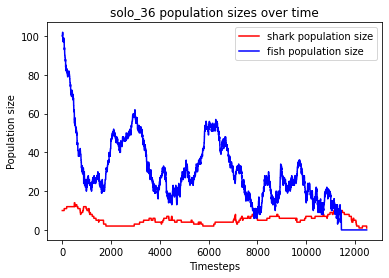

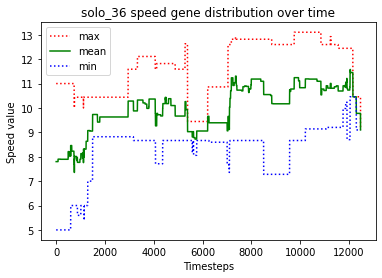

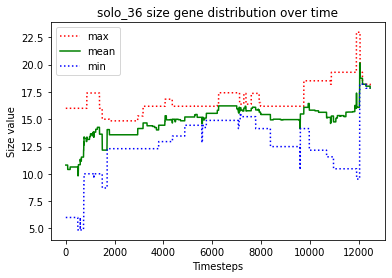

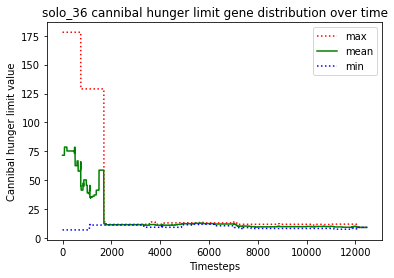

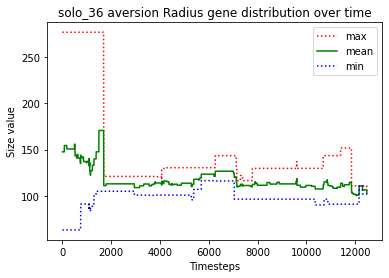

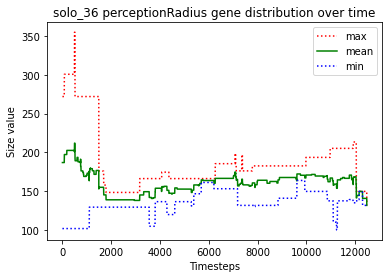

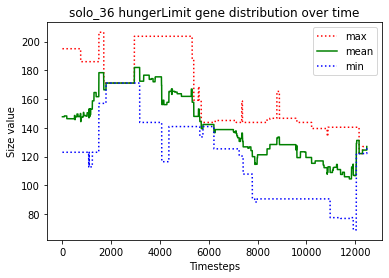





						SOLO_37

predator_6 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_4 just gave birth to predator_15
predator_4 killed predator_10
predator_2 just gave birth to predator_16
predator_4 just gave birth to predator_17
predator_16 killed predator_11
predator_7 just gave birth to predator_18
predator_5 just gave birth to predator_19
predator_6 starved to death
predator_9 ate the carcass of predator_6_carcass
predator_2 killed predator_5
predator_4 starved to death
predator_13 starved to death
predator_17 starved to death
predator_12 ate the carcass of predator_4_carcass
predator_16 ate the carcass of predator_13_carcass
predator_12 ate the carcass of predator_17_carcass
predator_2 killed predator_19
predator_15 starved to death
predator_18 starved to death
predator_7 ate the carcass of predator_15_carcass
predator_2 killed

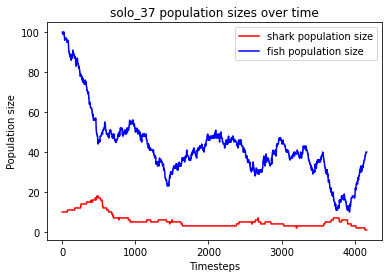

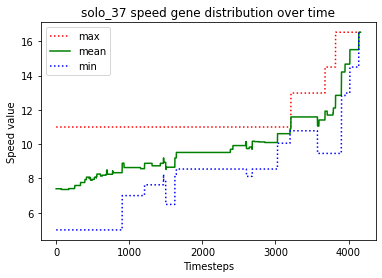

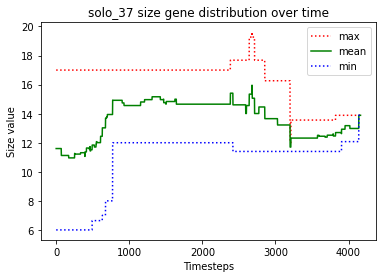

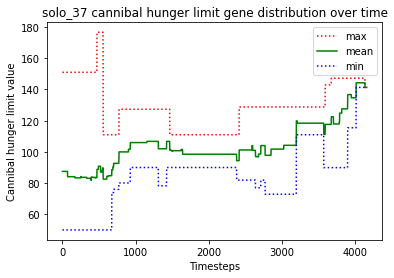

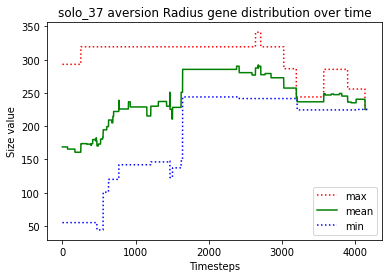

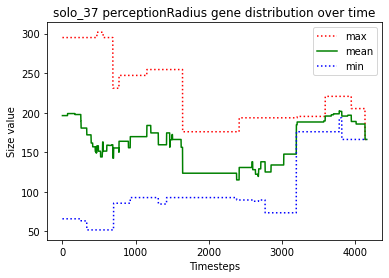

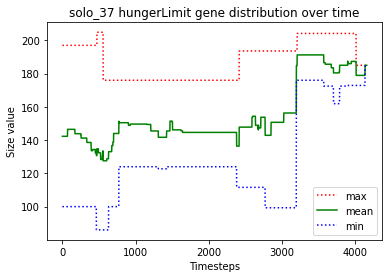





						SOLO_38

predator_2 killed predator_9
predator_2 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_10 killed predator_6
predator_10 killed predator_11
predator_10 killed predator_3
predator_10 killed predator_0
predator_7 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_8 starved to death
predator_5 ate the carcass of predator_8_carcass
predator_13 starved to death
predator_15 killed predator_1
predator_14 ate the carcass of predator_13_carcass
predator_7 starved to death
predator_5 ate the carcass of predator_7_carcass
predator_5 just gave birth to predator_16
predator_12 starved to death
predator_14 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_5 ate the carcass of predator_12_carcass
predator_14 just gave birth to predator_19
predator_4 just gave birth to predator_20
predator_17 just gave 

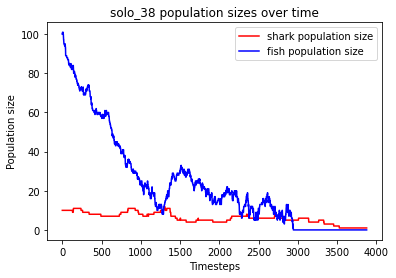

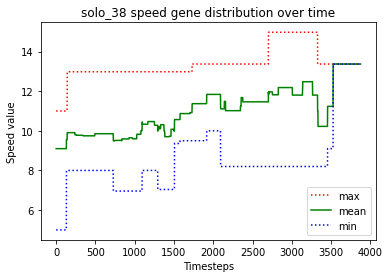

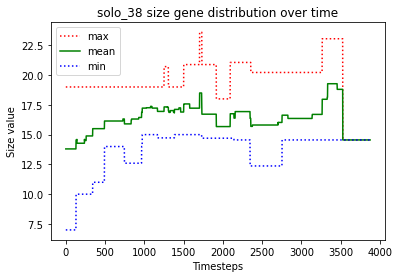

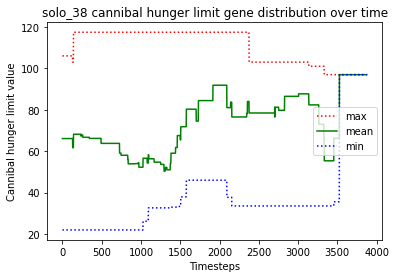

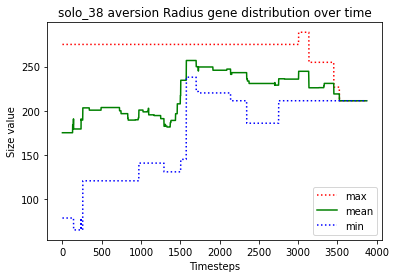

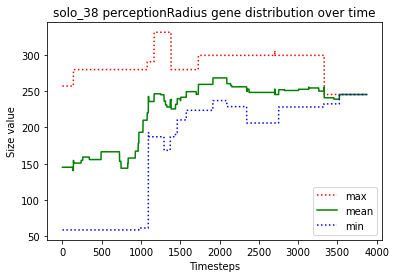

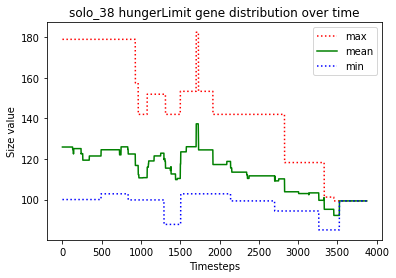





						SOLO_39

predator_7 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_10 killed predator_8
predator_7 just gave birth to predator_13
predator_11 starved to death
predator_7 ate the carcass of predator_11_carcass
predator_2 just gave birth to predator_14
predator_12 killed predator_9
predator_13 starved to death
predator_0 ate the carcass of predator_13_carcass
predator_4 just gave birth to predator_15
predator_12 killed predator_2
predator_1 killed predator_3
predator_12 just gave birth to predator_16
predator_12 killed predator_14
predator_4 just gave birth to predator_17
predator_0 just gave birth to predator_18
predator_5 just gave birth to predator_19
predator_4 starved to death
predator_17 ate the carcass of predator_4_carcass
predator_7 starved to death
predator_0 ate the carcass of predator_7_carcass
predator_15 starved to death
predator_17 starved to death
predator_1 ate the carcass of predator_

predator_54 just gave birth to predator_68
predator_68 just gave birth to predator_69
predator_68 just gave birth to predator_70
predator_68 starved to death
predator_69 ate the carcass of predator_68_carcass
predator_54 starved to death
predator_69 ate the carcass of predator_54_carcass
predator_70 just gave birth to predator_71
predator_70 just gave birth to predator_72
predator_69 just gave birth to predator_73
predator_70 just gave birth to predator_74
predator_74 starved to death
predator_73 ate the carcass of predator_74_carcass
predator_72 starved to death
predator_69 ate the carcass of predator_72_carcass
predator_73 just gave birth to predator_75
predator_69 starved to death
predator_70 ate the carcass of predator_69_carcass
predator_75 starved to death
predator_73 ate the carcass of predator_75_carcass
predator_73 just gave birth to predator_76
predator_76 starved to death
predator_73 ate the carcass of predator_76_carcass
predator_70 just gave birth to predator_77
predator_7

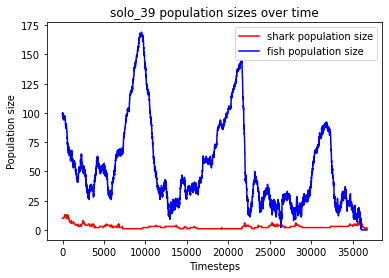

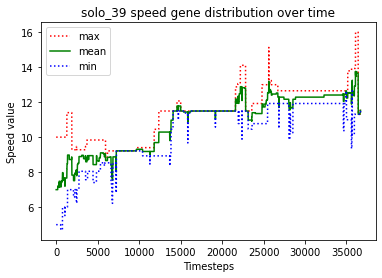

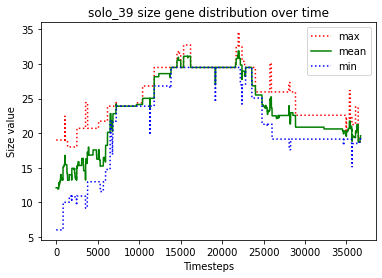

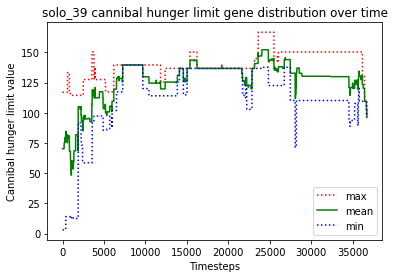

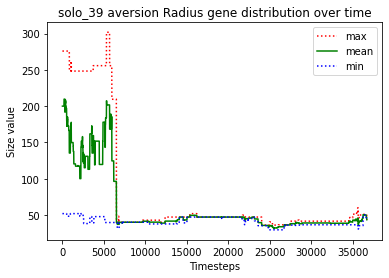

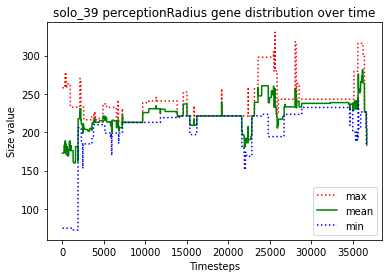

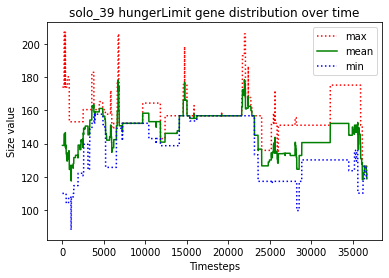





						SOLO_40

predator_1 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_1 just gave birth to predator_14
predator_13 starved to death
predator_3 killed predator_12
predator_2 ate the carcass of predator_13_carcass
predator_0 starved to death
predator_9 ate the carcass of predator_0_carcass
predator_7 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_2 starved to death
predator_7 killed predator_14
predator_11 ate the carcass of predator_2_carcass
predator_15 just gave birth to predator_17
predator_6 just gave birth to predator_18
predator_17 just gave birth to predator_19
predator_15 killed predator_1
predator_17 starved to death
predator_6 ate the carcass of predator_17_carcass
predator_6 killed predator_10
predator_18 just gave birth to predator_20
predator_9 just gave birth to predator_21
predator_6 killed predator_20
predator_3 

predator_66 starved to death
predator_67 ate the carcass of predator_66_carcass
predator_72 starved to death
predator_67 ate the carcass of predator_72_carcass
predator_63 starved to death
predator_67 ate the carcass of predator_63_carcass
predator_67 just gave birth to predator_73
predator_73 just gave birth to predator_74
predator_59 starved to death
predator_48 starved to death
predator_62 ate the carcass of predator_48_carcass
predator_73 starved to death
predator_58 ate the carcass of predator_59_carcass
predator_67 ate the carcass of predator_73_carcass
predator_62 just gave birth to predator_75
predator_74 killed predator_58
predator_75 starved to death
predator_62 ate the carcass of predator_75_carcass
predator_67 starved to death
predator_74 ate the carcass of predator_67_carcass
predator_74 just gave birth to predator_76
predator_76 just gave birth to predator_77
predator_62 just gave birth to predator_78
predator_78 just gave birth to predator_79
predator_78 killed predator_

predator_128 just gave birth to predator_132
predator_123 just gave birth to predator_133
no fish to move
predator_133 starved to death
predator_132 ate the carcass of predator_133_carcass
predator_128 just gave birth to predator_134
predator_128 starved to death
predator_134 starved to death
predator_123 just gave birth to predator_135
predator_117 ate the carcass of predator_128_carcass
predator_117 ate the carcass of predator_134_carcass
predator_135 starved to death
predator_123 starved to death
predator_117 ate the carcass of predator_135_carcass
predator_132 ate the carcass of predator_123_carcass
predator_124 starved to death
predator_132 starved to death
predator_117 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 136
Timesteps passed: 30086
Fish went extinct at timestep 29275
Sharks went extinct at timestep 30086


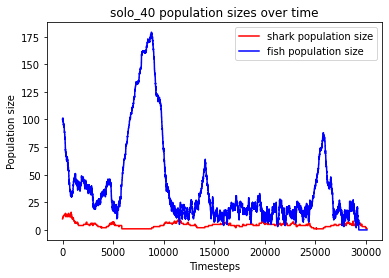

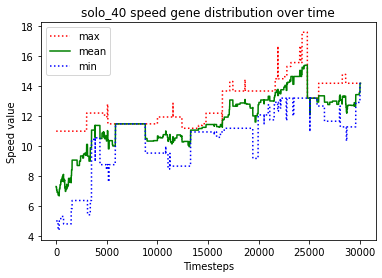

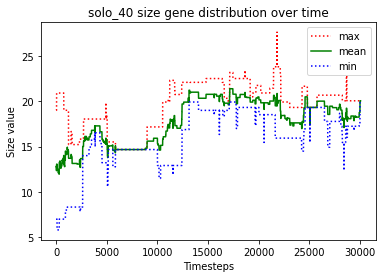

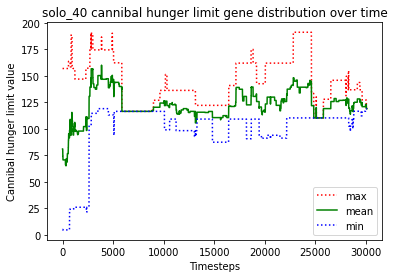

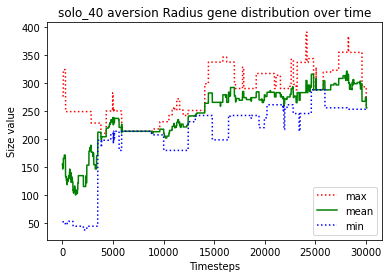

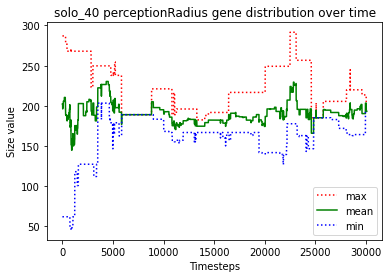

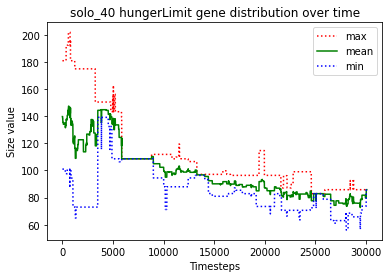





						SOLO_41

predator_7 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_12 killed predator_0
predator_8 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_12 killed predator_2
predator_6 killed predator_8
predator_12 killed predator_14
predator_6 killed predator_7
predator_1 just gave birth to predator_15
predator_1 killed predator_15
predator_9 just gave birth to predator_16
predator_6 killed predator_1
predator_16 just gave birth to predator_17
predator_9 just gave birth to predator_18
predator_12 killed predator_5
predator_13 starved to death
predator_11 ate the carcass of predator_13_carcass
predator_17 starved to death
predator_18 ate the carcass of predator_17_carcass
predator_16 starved to death
predator_6 ate the carcass of predator_16_carcass
predator_12 starved to death
predator_11 ate the carcass of predator_12_carcass
predator_18 starved to death
predator_3 ate t

predator_54 ate the carcass of predator_61_carcass
predator_54 just gave birth to predator_68
predator_38 just gave birth to predator_69
predator_69 starved to death
predator_68 just gave birth to predator_70
predator_68 killed predator_70
predator_54 ate the carcass of predator_69_carcass
predator_38 starved to death
predator_64 ate the carcass of predator_38_carcass
predator_54 just gave birth to predator_71
predator_68 just gave birth to predator_72
predator_68 starved to death
predator_72 ate the carcass of predator_68_carcass
predator_71 just gave birth to predator_73
predator_71 starved to death
predator_64 ate the carcass of predator_71_carcass
predator_73 starved to death
predator_54 ate the carcass of predator_73_carcass
predator_72 just gave birth to predator_74
predator_54 just gave birth to predator_75
predator_74 just gave birth to predator_76
predator_72 just gave birth to predator_77
predator_76 starved to death
predator_54 ate the carcass of predator_76_carcass
predator

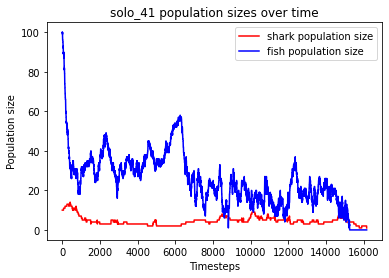

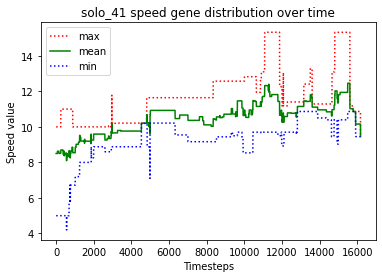

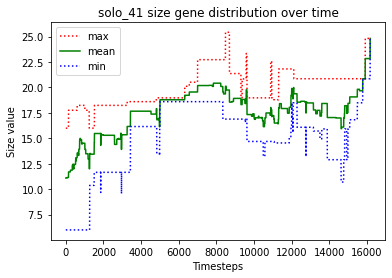

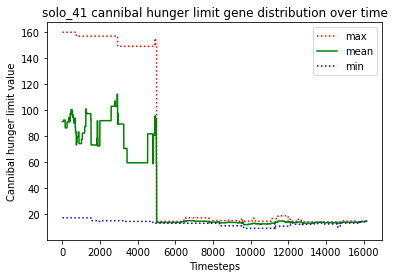

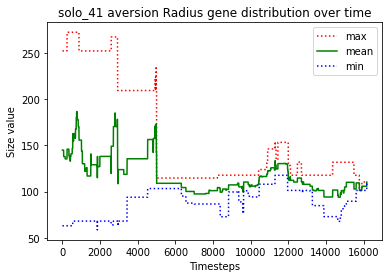

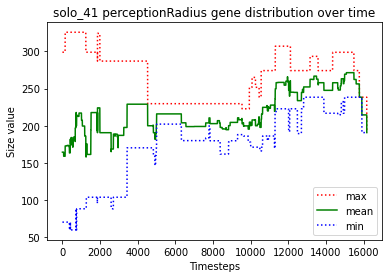

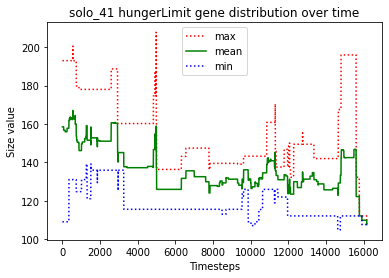





						SOLO_42

predator_8 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_13 killed predator_7
predator_9 just gave birth to predator_15
predator_4 killed predator_0
predator_4 just gave birth to predator_16
predator_13 starved to death
predator_16 ate the carcass of predator_13_carcass
predator_6 starved to death
predator_16 ate the carcass of predator_6_carcass
predator_4 killed predator_9
predator_16 killed predator_12
predator_8 just gave birth to predator_17
predator_10 starved to death
predator_14 ate the carcass of predator_10_carcass
predator_4 killed predator_15
predator_14 killed predator_17
predator_4 starved to death
predator_8 ate the carcass of predator_4_carcass
predator_11 just gave birth to predator_18
predator_11 just gave birth to predator_19
predator_1 killed predator_2
predator_8 starved to death
predato

predator_70 ate the carcass of predator_63_carcass
predator_70 ate the carcass of predator_73_carcass
predator_71 starved to death
predator_70 ate the carcass of predator_71_carcass
predator_72 starved to death
predator_64 ate the carcass of predator_72_carcass
predator_69 starved to death
predator_70 just gave birth to predator_74
predator_56 just gave birth to predator_75
predator_64 ate the carcass of predator_69_carcass
predator_56 just gave birth to predator_76
predator_76 just gave birth to predator_77
predator_76 starved to death
predator_77 starved to death
predator_70 ate the carcass of predator_77_carcass
predator_56 ate the carcass of predator_76_carcass
predator_75 just gave birth to predator_78
predator_78 starved to death
predator_75 starved to death
predator_64 ate the carcass of predator_75_carcass
predator_64 ate the carcass of predator_78_carcass
predator_74 starved to death
predator_70 just gave birth to predator_79
predator_64 ate the carcass of predator_74_carcass


predator_132 just gave birth to predator_133
predator_128 ate the carcass of predator_115_carcass
predator_133 starved to death
predator_128 just gave birth to predator_134
predator_128 ate the carcass of predator_133_carcass
predator_128 just gave birth to predator_135
predator_132 starved to death
predator_128 just gave birth to predator_136
predator_136 just gave birth to predator_137
predator_135 just gave birth to predator_138
predator_137 starved to death
predator_128 ate the carcass of predator_137_carcass
predator_135 starved to death
predator_138 starved to death
predator_136 just gave birth to predator_139
predator_129 ate the carcass of predator_132_carcass
predator_134 just gave birth to predator_140
predator_134 killed predator_140
predator_134 ate the carcass of predator_135_carcass
predator_134 ate the carcass of predator_138_carcass
predator_136 just gave birth to predator_141
predator_127 killed predator_139
predator_134 just gave birth to predator_142
predator_129 jus

predator_164 just gave birth to predator_192
predator_188 just gave birth to predator_193
predator_188 ate the carcass of predator_136_carcass
predator_193 killed predator_164
predator_193 killed predator_191
predator_193 killed predator_175
predator_190 starved to death
predator_192 ate the carcass of predator_190_carcass
predator_193 just gave birth to predator_194
predator_193 just gave birth to predator_195
predator_195 starved to death
predator_192 just gave birth to predator_196
predator_192 killed predator_196
predator_194 ate the carcass of predator_195_carcass
predator_192 just gave birth to predator_197
predator_192 just gave birth to predator_198
predator_188 just gave birth to predator_199
predator_198 starved to death
predator_192 starved to death
predator_194 ate the carcass of predator_192_carcass
predator_193 ate the carcass of predator_198_carcass
predator_199 just gave birth to predator_200
predator_200 starved to death
predator_199 ate the carcass of predator_200_car

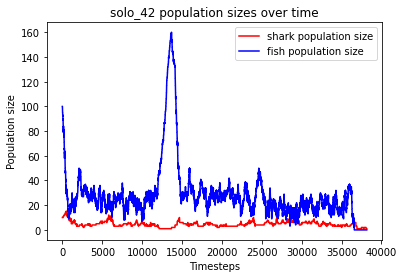

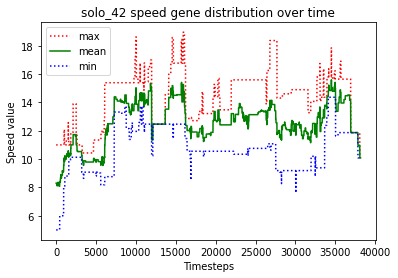

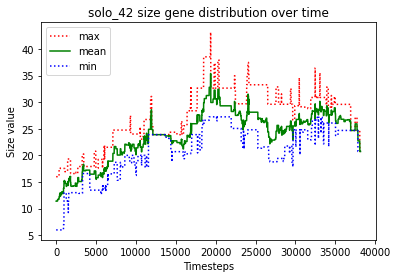

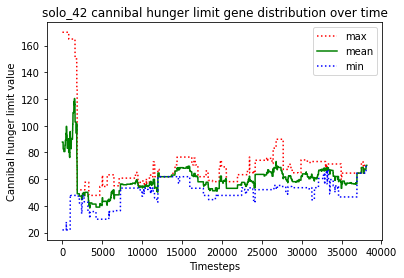

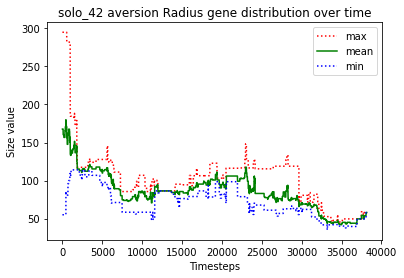

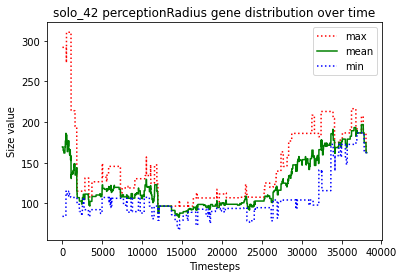

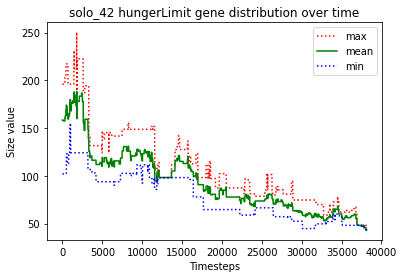





						SOLO_43

predator_3 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_1 killed predator_11
predator_1 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_1 starved to death
predator_12 starved to death
predator_10 ate the carcass of predator_12_carcass
predator_7 starved to death
predator_14 ate the carcass of predator_7_carcass
predator_0 ate the carcass of predator_1_carcass
predator_2 just gave birth to predator_15
predator_14 starved to death
predator_2 ate the carcass of predator_14_carcass
predator_13 starved to death
predator_15 ate the carcass of predator_13_carcass
predator_4 just gave birth to predator_16
predator_5 just gave birth to predator_17
predator_9 just gave birth to predator_18
predator_3 starved to death
predator_2 ate the carcass of predator_3_carcass
predator_18 just gave birth to predator_19
predator_9 just gave birth to predator_20
predator_10 starv

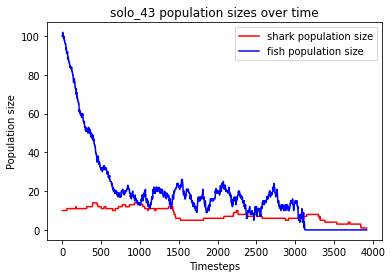

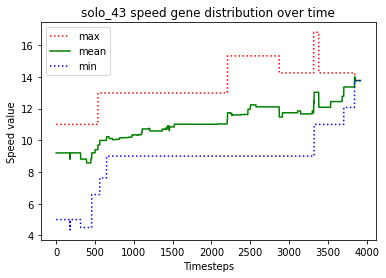

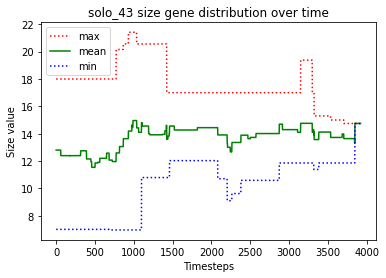

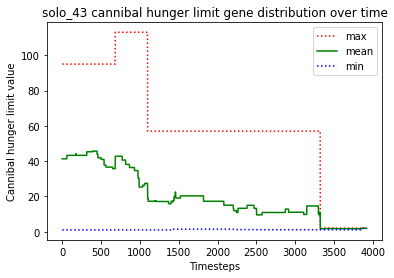

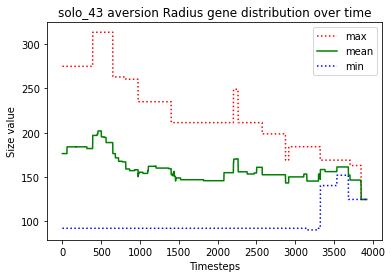

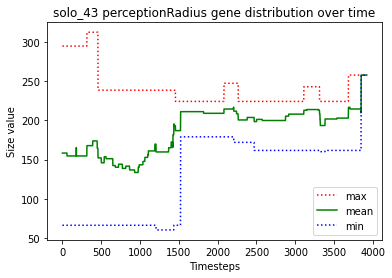

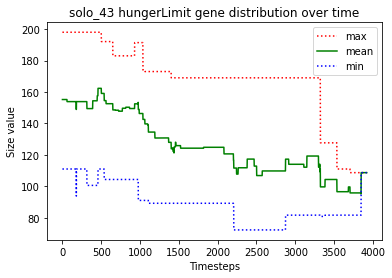





						SOLO_44

predator_6 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_3 killed predator_13
predator_0 just gave birth to predator_14
predator_11 killed predator_5
predator_3 killed predator_7
predator_2 just gave birth to predator_15
predator_6 starved to death
predator_0 ate the carcass of predator_6_carcass
predator_11 killed predator_12
predator_10 starved to death
predator_0 ate the carcass of predator_10_carcass
predator_11 starved to death
predator_14 ate the carcass of predator_11_carcass
predator_3 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_9 just gave birth to predator_18
predator_18 just gave birth to predator_19
predator_3 starved to death
predator_16 starved to death
predator_18 just gave birth to predator_20
predator_4 ate the carcass of predator_3_carcass
predator_20 starved to death
predator_18 starved to dea

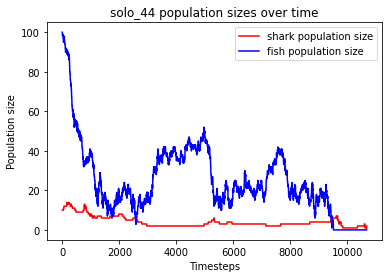

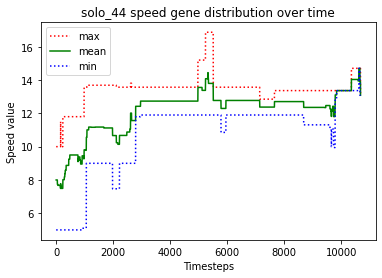

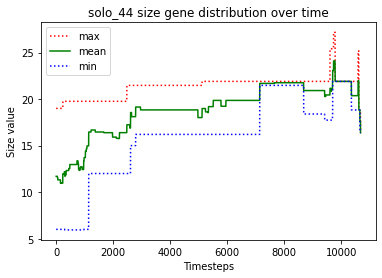

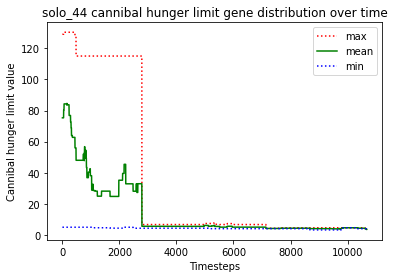

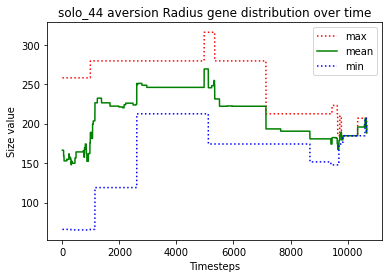

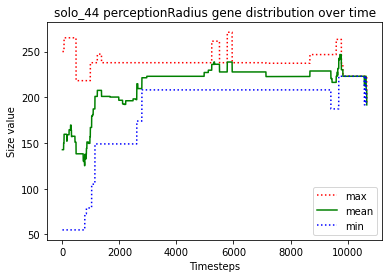

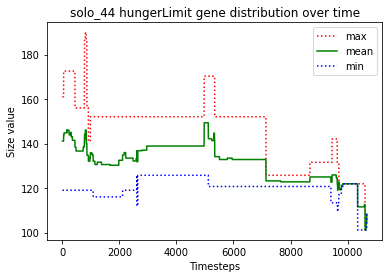





						SOLO_45

predator_8 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_11 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_10 starved to death
predator_4 ate the carcass of predator_10_carcass
predator_4 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_8 just gave birth to predator_16
predator_8 starved to death
predator_2 ate the carcass of predator_8_carcass
predator_14 killed predator_15
predator_16 starved to death
predator_13 ate the carcass of predator_16_carcass
predator_6 just gave birth to predator_17
predator_14 just gave birth to predator_18
predator_7 just gave birth to predator_19
predator_12 starved to death
predator_9 ate the carcass of predator_12_carcass
predator_14 starved to death
predator_13 ate the carcass of predator_14_carcass
predator_3 just gave birth to predator_20
predator_4 s

predator_57 just gave birth to predator_70
predator_70 just gave birth to predator_71
predator_70 just gave birth to predator_72
predator_72 starved to death
predator_70 starved to death
predator_71 starved to death
predator_64 ate the carcass of predator_72_carcass
predator_64 ate the carcass of predator_70_carcass
predator_52 starved to death
predator_67 ate the carcass of predator_52_carcass
predator_64 ate the carcass of predator_71_carcass
predator_57 just gave birth to predator_73
predator_64 just gave birth to predator_74
predator_57 starved to death
predator_67 ate the carcass of predator_57_carcass
predator_74 just gave birth to predator_75
predator_74 just gave birth to predator_76
predator_67 just gave birth to predator_77
predator_67 killed predator_74
predator_67 killed predator_75
predator_67 killed predator_76
predator_77 just gave birth to predator_78
predator_78 just gave birth to predator_79
predator_78 starved to death
predator_79 ate the carcass of predator_78_carca

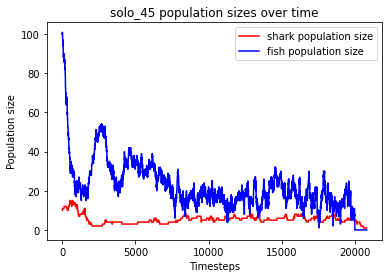

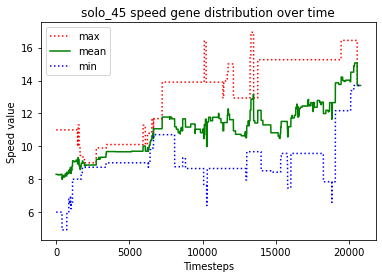

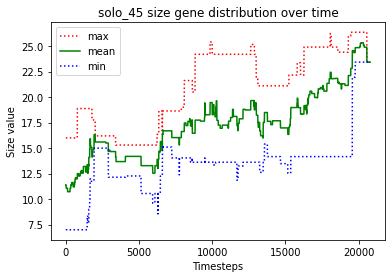

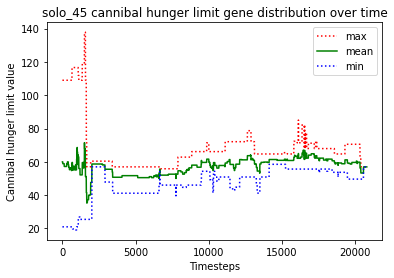

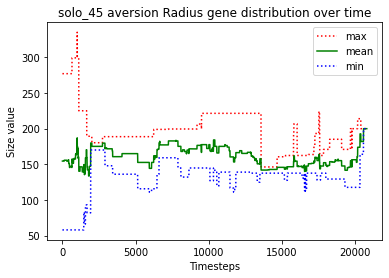

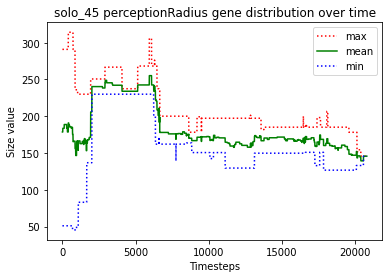

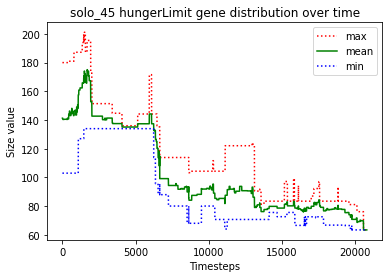





						SOLO_46

predator_9 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_12 just gave birth to predator_15
predator_12 killed predator_15
predator_14 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_14 killed predator_2
predator_16 killed predator_0
predator_14 killed predator_5
predator_1 just gave birth to predator_18
predator_16 just gave birth to predator_19
predator_16 killed predator_19
predator_14 killed predator_1
predator_16 killed predator_13
predator_9 starved to death
predator_14 ate the carcass of predator_9_carcass
predator_17 starved to death
predator_8 starved to death
predator_14 ate the carcass of predator_17_carcass
predator_11 starved to death
predator_18 ate the carcass of predator_11_carcass
predator_14 ate the carcass of predator_8_carcass
predator_7 starved to death
p

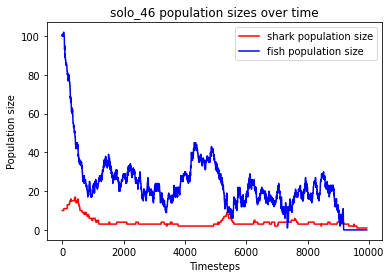

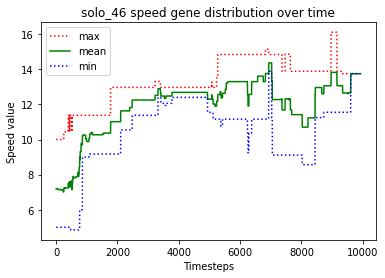

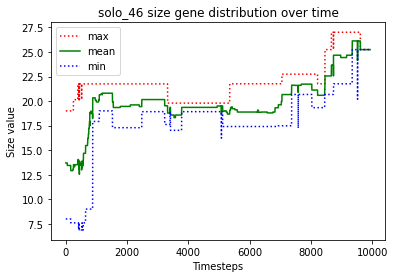

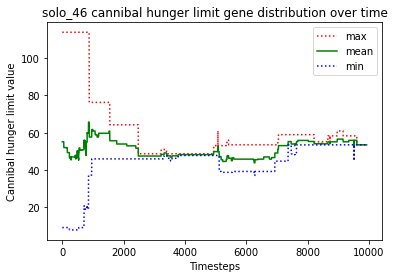

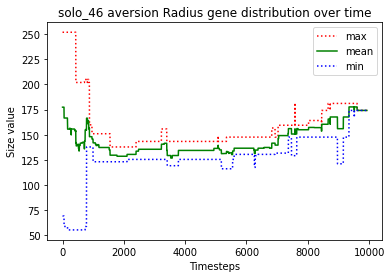

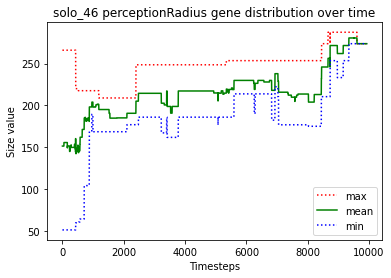

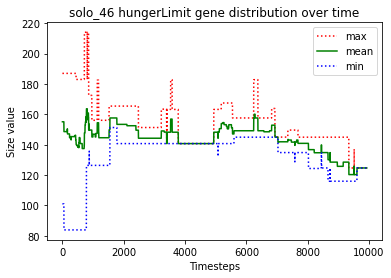





						SOLO_47

predator_3 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_7 killed predator_12
predator_7 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_14 starved to death
predator_7 starved to death
predator_3 ate the carcass of predator_7_carcass
predator_6 just gave birth to predator_15
predator_13 starved to death
predator_5 ate the carcass of predator_13_carcass
predator_5 just gave birth to predator_16
predator_2 just gave birth to predator_17
predator_5 ate the carcass of predator_14_carcass
predator_4 just gave birth to predator_18
predator_4 killed predator_18
predator_17 killed predator_1
predator_4 killed predator_0
predator_10 starved to death
predator_6 starved to death
predator_16 just gave birth to predator_19
predator_5 ate the carcass of predator_10_carcass
predator_8 ate the carcass of predator_6_carcass
predator_3 starved to death
predator_11 killed pre

predator_68 just gave birth to predator_73
predator_72 killed predator_71
predator_69 killed predator_73
predator_58 ate the carcass of predator_63_carcass
predator_68 starved to death
predator_70 ate the carcass of predator_68_carcass
predator_69 starved to death
predator_72 starved to death
predator_58 just gave birth to predator_74
predator_70 ate the carcass of predator_72_carcass
predator_45 just gave birth to predator_75
predator_45 just gave birth to predator_76
predator_45 starved to death
predator_70 ate the carcass of predator_45_carcass
predator_76 starved to death
predator_58 starved to death
predator_75 starved to death
predator_70 ate the carcass of predator_69_carcass
predator_74 starved to death
predator_70 ate the carcass of predator_58_carcass
predator_66 ate the carcass of predator_76_carcass
predator_70 ate the carcass of predator_74_carcass
predator_66 ate the carcass of predator_75_carcass
predator_70 just gave birth to predator_77
predator_70 just gave birth to p

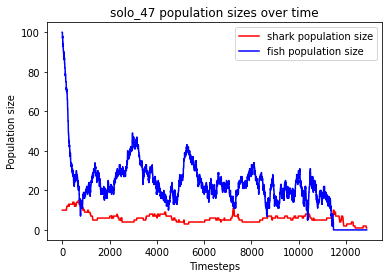

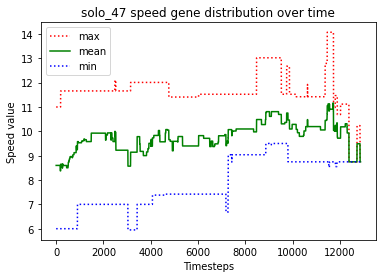

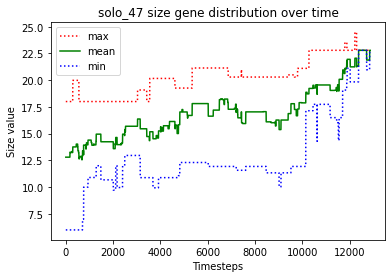

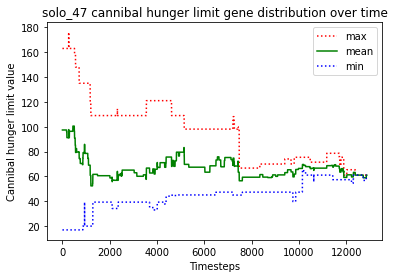

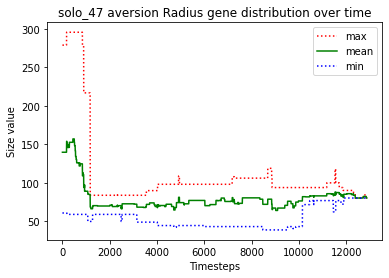

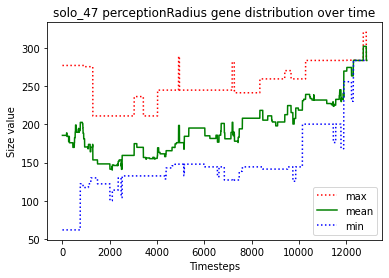

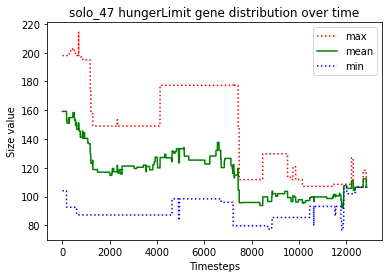





						SOLO_48

predator_6 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_12 starved to death
predator_2 ate the carcass of predator_12_carcass
predator_11 just gave birth to predator_14
predator_11 killed predator_14
predator_7 starved to death
predator_13 ate the carcass of predator_7_carcass
predator_10 starved to death
predator_13 ate the carcass of predator_10_carcass
predator_6 starved to death
predator_3 ate the carcass of predator_6_carcass
predator_11 starved to death
predator_0 ate the carcass of predator_11_carcass
predator_4 just gave birth to predator_15
predator_15 just gave birth to predator_16
predator_16 starved to death
predator_15 ate the carcass of predator_16_carcass
predator_8 just gave birth to predator_17
predator_13 starved to death
predator_5 starved to death
predator_4 starved to death
predator_15 starved to death
predator_9 ate the carcas

predator_62 ate the carcass of predator_69_carcass
predator_70 starved to death
predator_63 ate the carcass of predator_70_carcass
predator_67 just gave birth to predator_71
predator_63 just gave birth to predator_72
no fish to move
predator_71 starved to death
predator_62 ate the carcass of predator_71_carcass
predator_66 just gave birth to predator_73
predator_66 starved to death
predator_73 starved to death
predator_67 ate the carcass of predator_73_carcass
predator_67 ate the carcass of predator_66_carcass
predator_67 just gave birth to predator_74
predator_72 starved to death
predator_63 starved to death
predator_62 ate the carcass of predator_72_carcass
predator_74 starved to death
predator_62 ate the carcass of predator_74_carcass
predator_67 starved to death
predator_62 ate the carcass of predator_67_carcass
predator_62 ate the carcass of predator_63_carcass
predator_62 just gave birth to predator_75
predator_75 starved to death
predator_62 starved to death


finished this run 

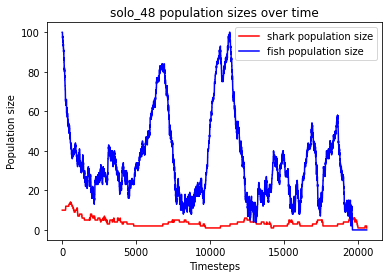

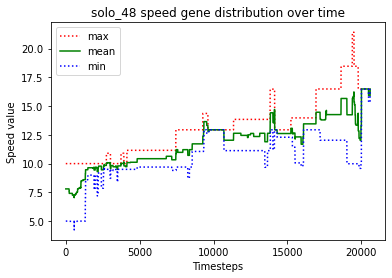

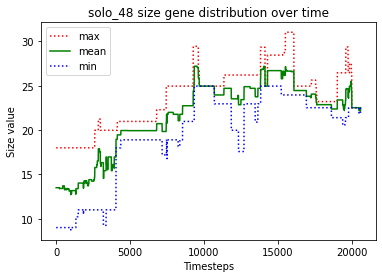

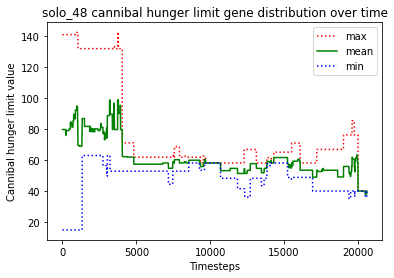

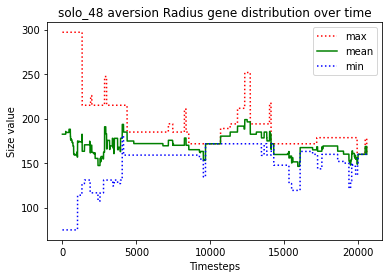

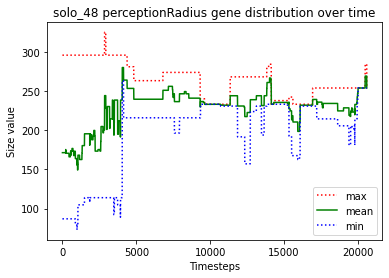

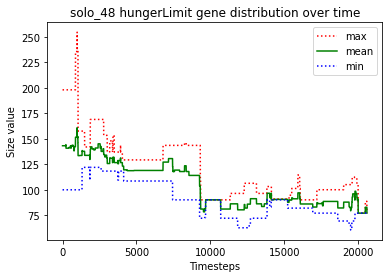





						SOLO_49

predator_3 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_13 starved to death
predator_14 starved to death
predator_12 starved to death
predator_0 ate the carcass of predator_12_carcass
predator_5 ate the carcass of predator_14_carcass
predator_9 ate the carcass of predator_13_carcass
predator_9 just gave birth to predator_15
predator_7 just gave birth to predator_16
predator_0 starved to death
predator_1 just gave birth to predator_17
predator_10 starved to death
predator_9 ate the carcass of predator_10_carcass
predator_8 just gave birth to predator_18
predator_2 ate the carcass of predator_0_carcass
predator_11 starved to death
predator_5 ate the carcass of predator_11_carcass
predator_5 starved to death
predator_3 ate the carcass of predator_5_carcass
predator_15 starved to death
predator_9 ate the carc

predator_62 starved to death
predator_60 ate the carcass of predator_62_carcass
predator_67 killed predator_63
predator_65 starved to death
predator_27 ate the carcass of predator_65_carcass
predator_60 just gave birth to predator_68
predator_38 just gave birth to predator_69
predator_68 just gave birth to predator_70
predator_70 just gave birth to predator_71
predator_71 starved to death
predator_68 ate the carcass of predator_71_carcass
predator_70 starved to death
predator_68 ate the carcass of predator_70_carcass
predator_38 just gave birth to predator_72
predator_60 just gave birth to predator_73
predator_66 starved to death
predator_69 starved to death
predator_72 starved to death
predator_67 ate the carcass of predator_72_carcass
predator_68 ate the carcass of predator_69_carcass
predator_67 ate the carcass of predator_66_carcass
predator_60 starved to death
predator_57 ate the carcass of predator_60_carcass
predator_68 starved to death
predator_57 ate the carcass of predator_68

predator_121 just gave birth to predator_130
predator_128 ate the carcass of predator_125_carcass
predator_114 starved to death
predator_119 starved to death
predator_130 ate the carcass of predator_119_carcass
predator_127 just gave birth to predator_131
predator_121 starved to death
predator_128 ate the carcass of predator_121_carcass
predator_100 just gave birth to predator_132
predator_106 just gave birth to predator_133
predator_112 starved to death
predator_100 starved to death
predator_132 ate the carcass of predator_100_carcass
predator_113 just gave birth to predator_134
predator_124 ate the carcass of predator_112_carcass
predator_131 just gave birth to predator_135
predator_131 starved to death
predator_135 starved to death
predator_130 ate the carcass of predator_135_carcass
predator_130 ate the carcass of predator_131_carcass
predator_127 starved to death
predator_122 starved to death
predator_124 ate the carcass of predator_122_carcass
predator_106 starved to death
predat

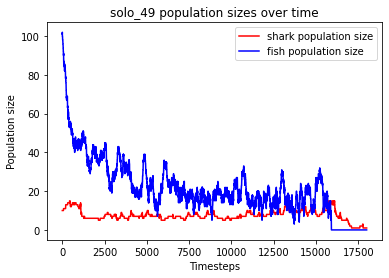

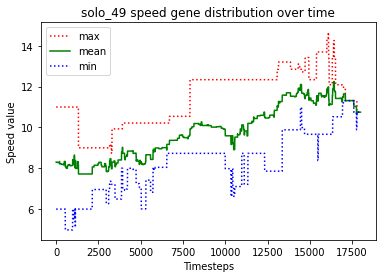

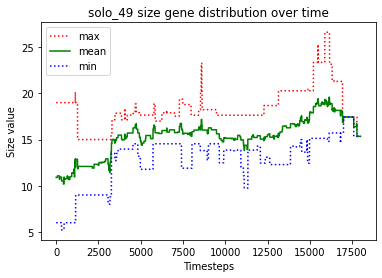

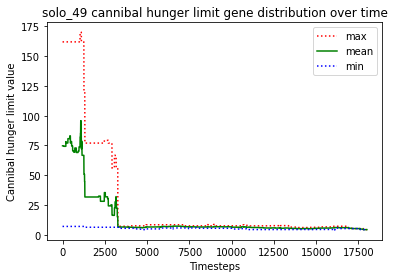

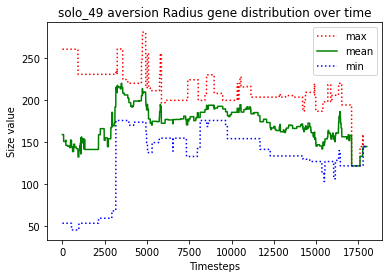

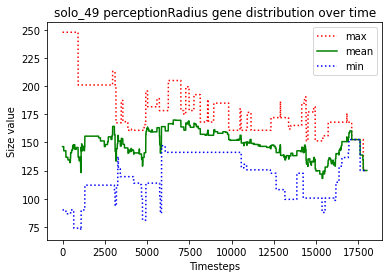

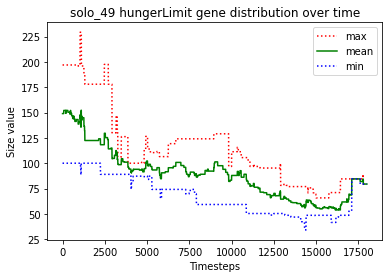





						SOLO_50

predator_6 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_11 killed predator_8
predator_15 starved to death
predator_0 ate the carcass of predator_15_carcass
predator_13 starved to death
predator_1 ate the carcass of predator_13_carcass
predator_12 starved to death
predator_4 ate the carcass of predator_12_carcass
predator_0 starved to death
predator_14 starved to death
predator_1 ate the carcass of predator_0_carcass
predator_4 ate the carcass of predator_14_carcass
predator_1 just gave birth to predator_16
predator_6 just gave birth to predator_17
predator_2 starved to death
predator_1 ate the carcass of predator_2_carcass
predator_5 starved to death
predator_9 ate the carcass of predator_5_carcass
predator_7 just gave birth to predator_18
predator_3 just gave birt

predator_59 ate the carcass of predator_67_carcass
predator_68 starved to death
predator_53 ate the carcass of predator_68_carcass
predator_70 just gave birth to predator_71
predator_59 just gave birth to predator_72
predator_70 starved to death
predator_53 ate the carcass of predator_70_carcass
predator_72 just gave birth to predator_73
predator_73 just gave birth to predator_74
predator_73 starved to death
predator_59 just gave birth to predator_75
predator_75 just gave birth to predator_76
predator_59 ate the carcass of predator_73_carcass
predator_74 starved to death
predator_71 ate the carcass of predator_74_carcass
predator_76 starved to death
predator_71 ate the carcass of predator_76_carcass
predator_72 just gave birth to predator_77
predator_71 just gave birth to predator_78
predator_53 just gave birth to predator_79
predator_72 starved to death
predator_77 ate the carcass of predator_72_carcass
predator_78 starved to death
predator_71 ate the carcass of predator_78_carcass
pr

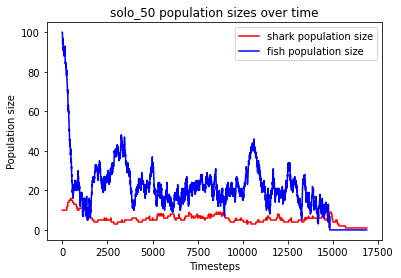

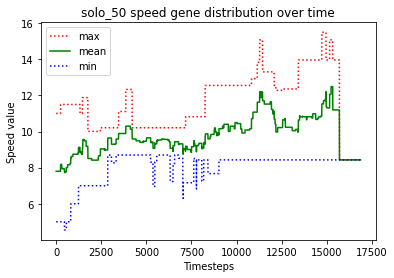

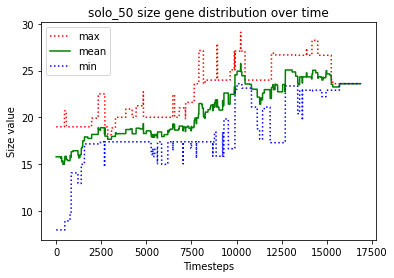

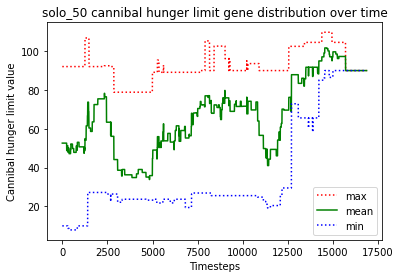

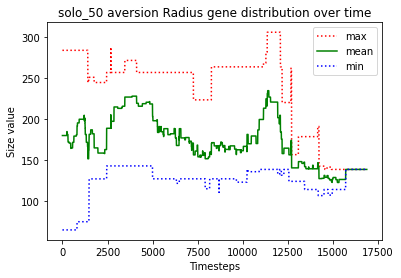

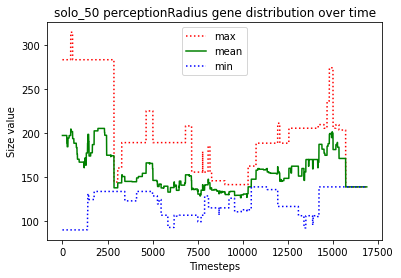

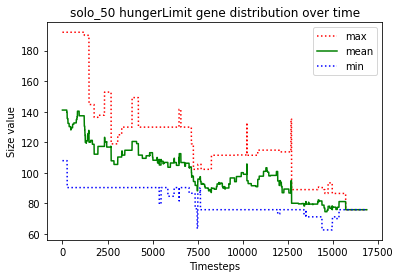





						SOLO_51

predator_4 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_6 just gave birth to predator_15
predator_10 starved to death
predator_13 ate the carcass of predator_10_carcass
predator_7 killed predator_13
predator_14 starved to death
predator_6 ate the carcass of predator_14_carcass
predator_4 starved to death
predator_2 just gave birth to predator_16
predator_7 ate the carcass of predator_4_carcass
predator_16 just gave birth to predator_17
predator_11 starved to death
predator_9 ate the carcass of predator_11_carcass
predator_17 just gave birth to predator_18
predator_3 just gave birth to predator_19
predator_17 starved to death
predator_18 starved to death
predator_16 starved to death
predator_6 ate the carcass of predator_16_carcass
predator_8 ate the carcass of predator_17_carcass
predator_19 starved to de

predator_68 just gave birth to predator_69
predator_69 just gave birth to predator_70
predator_69 starved to death
predator_65 ate the carcass of predator_69_carcass
predator_36 just gave birth to predator_71
predator_70 starved to death
predator_39 ate the carcass of predator_70_carcass
predator_39 just gave birth to predator_72
predator_65 just gave birth to predator_73
predator_39 just gave birth to predator_74
predator_72 just gave birth to predator_75
predator_65 just gave birth to predator_76
predator_74 starved to death
predator_36 ate the carcass of predator_74_carcass
predator_72 starved to death
predator_75 starved to death
predator_63 ate the carcass of predator_72_carcass
predator_73 ate the carcass of predator_75_carcass
predator_39 starved to death
predator_76 ate the carcass of predator_39_carcass
predator_50 starved to death
predator_65 starved to death
predator_76 ate the carcass of predator_50_carcass
predator_73 ate the carcass of predator_65_carcass
predator_73 just

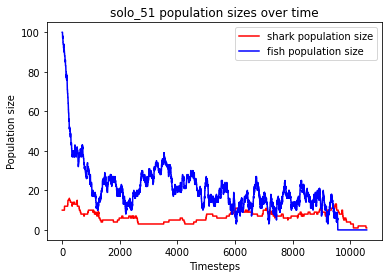

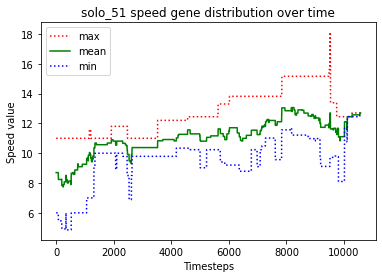

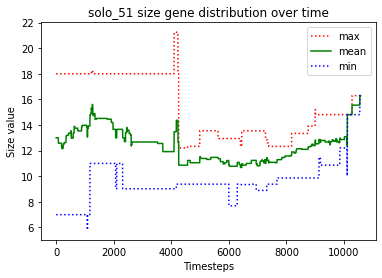

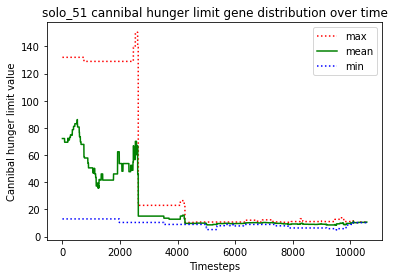

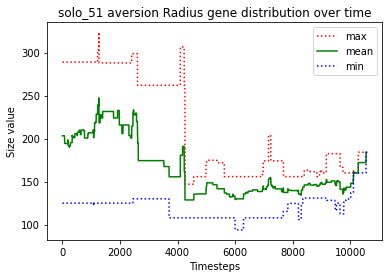

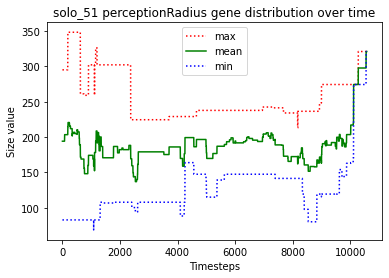

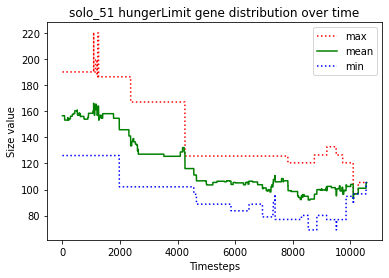





						SOLO_52

predator_4 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_7 killed predator_9
predator_12 killed predator_4
predator_7 killed predator_6
predator_11 starved to death
predator_7 ate the carcass of predator_11_carcass
predator_5 just gave birth to predator_14
predator_0 killed predator_1
predator_5 just gave birth to predator_15
predator_7 killed predator_13
predator_5 just gave birth to predator_16
predator_7 killed predator_15
predator_5 just gave birth to predator_17
predator_5 starved to death
predator_17 starved to death
predator_16 ate the carcass of predator_5_carcass
predator_0 killed predator_8
predator_16 ate the carcass of predator_17_carcass
predator_12 killed predator_3
predator_14 starved to death
predator_12 ate the carcass of predator_14_carcass
predator_10 starved to death
predator_12 ate the carcass of predator_10_carcass
predator_12 

predator_68 just gave birth to predator_71
predator_68 starved to death
predator_69 ate the carcass of predator_68_carcass
predator_70 starved to death
predator_61 ate the carcass of predator_70_carcass
predator_71 just gave birth to predator_72
predator_71 starved to death
predator_69 ate the carcass of predator_71_carcass
predator_72 starved to death
predator_61 ate the carcass of predator_72_carcass
predator_58 just gave birth to predator_73
predator_58 just gave birth to predator_74
predator_69 just gave birth to predator_75
predator_69 just gave birth to predator_76
predator_75 killed predator_73
predator_75 killed predator_58
predator_69 just gave birth to predator_77
predator_69 killed predator_77
predator_75 killed predator_74
predator_75 just gave birth to predator_78
predator_69 just gave birth to predator_79
predator_69 killed predator_79
predator_78 killed predator_61
predator_76 just gave birth to predator_80
predator_69 just gave birth to predator_81
predator_80 starved t

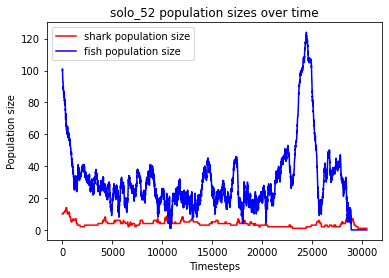

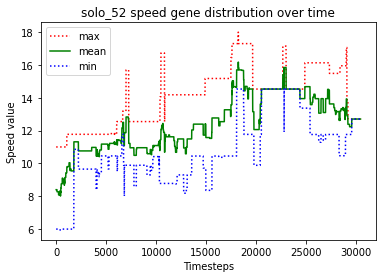

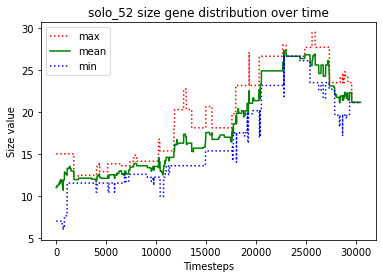

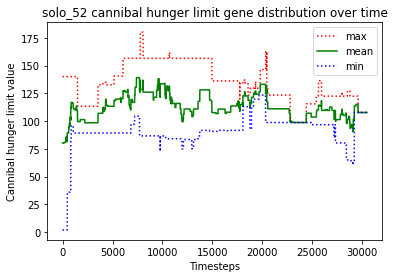

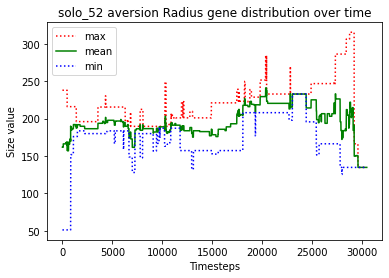

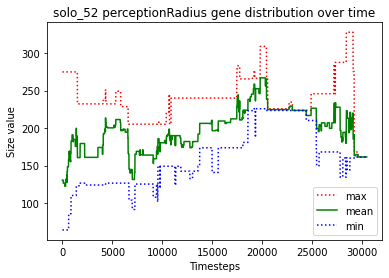

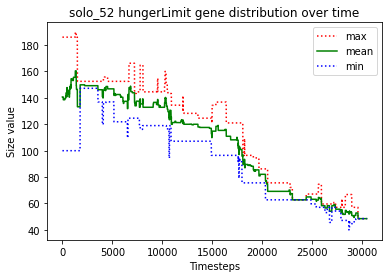





						SOLO_53

predator_6 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_12 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_0 just gave birth to predator_17
predator_13 starved to death
predator_11 ate the carcass of predator_13_carcass
predator_0 just gave birth to predator_18
predator_15 killed predator_3
predator_1 killed predator_7
predator_16 starved to death
predator_6 just gave birth to predator_19
predator_6 killed predator_19
predator_10 starved to death
predator_5 ate the carcass of predator_16_carcass
predator_18 just gave birth to predator_20
predator_14 starved to death
predator_2 ate the carcass of predator_14_carcass
predator_11 just gave birth to predator_21
predator_12 starved to death
predator_18 starved to death
predator_20 starved to death
predator_4 ate the carcass of p

predator_27 just gave birth to predator_69
predator_69 just gave birth to predator_70
predator_27 just gave birth to predator_71
predator_69 just gave birth to predator_72
predator_35 just gave birth to predator_73
predator_69 starved to death
predator_68 just gave birth to predator_74
predator_57 just gave birth to predator_75
predator_71 starved to death
predator_72 ate the carcass of predator_71_carcass
predator_68 starved to death
predator_27 ate the carcass of predator_68_carcass
predator_73 starved to death
predator_35 just gave birth to predator_76
predator_74 starved to death
predator_27 ate the carcass of predator_74_carcass
predator_35 ate the carcass of predator_69_carcass
predator_72 starved to death
predator_35 ate the carcass of predator_72_carcass
predator_75 ate the carcass of predator_73_carcass
predator_76 starved to death
predator_27 starved to death
predator_35 ate the carcass of predator_76_carcass
predator_37 ate the carcass of predator_27_carcass
predator_35 just

predator_117 just gave birth to predator_132
predator_131 ate the carcass of predator_129_carcass
predator_98 just gave birth to predator_133
predator_131 killed predator_132
predator_128 just gave birth to predator_134
predator_128 killed predator_98
predator_120 starved to death
predator_133 ate the carcass of predator_120_carcass
predator_107 just gave birth to predator_135
predator_131 killed predator_93
predator_134 starved to death
predator_117 just gave birth to predator_136
predator_126 starved to death
predator_131 ate the carcass of predator_134_carcass
predator_133 ate the carcass of predator_126_carcass
predator_128 starved to death
predator_135 ate the carcass of predator_128_carcass
predator_136 starved to death
predator_117 ate the carcass of predator_136_carcass
predator_117 just gave birth to predator_137
predator_130 just gave birth to predator_138
predator_138 starved to death
predator_131 ate the carcass of predator_138_carcass
predator_130 starved to death
predator

predator_190 just gave birth to predator_191
predator_163 just gave birth to predator_192
predator_192 just gave birth to predator_193
predator_157 just gave birth to predator_194
predator_148 just gave birth to predator_195
predator_193 starved to death
predator_175 just gave birth to predator_196
predator_175 starved to death
predator_196 starved to death
predator_194 ate the carcass of predator_196_carcass
predator_148 ate the carcass of predator_175_carcass
predator_195 starved to death
predator_186 ate the carcass of predator_193_carcass
predator_157 just gave birth to predator_197
predator_190 just gave birth to predator_198
predator_186 just gave birth to predator_199
predator_192 starved to death
predator_190 starved to death
predator_191 ate the carcass of predator_195_carcass
predator_197 ate the carcass of predator_190_carcass
predator_198 starved to death
predator_189 starved to death
predator_194 ate the carcass of predator_198_carcass
predator_188 ate the carcass of preda

predator_236 just gave birth to predator_249
predator_248 just gave birth to predator_250
predator_246 starved to death
predator_219 ate the carcass of predator_246_carcass
predator_219 just gave birth to predator_251
predator_235 starved to death
predator_250 starved to death
predator_251 ate the carcass of predator_235_carcass
predator_248 starved to death
predator_219 ate the carcass of predator_248_carcass
predator_244 ate the carcass of predator_250_carcass
predator_233 just gave birth to predator_252
predator_233 just gave birth to predator_253
predator_233 just gave birth to predator_254
predator_233 starved to death
predator_236 ate the carcass of predator_233_carcass
predator_252 killed predator_249
predator_251 starved to death
predator_252 ate the carcass of predator_251_carcass
predator_254 starved to death
predator_219 starved to death
predator_252 ate the carcass of predator_254_carcass
predator_253 starved to death
predator_247 ate the carcass of predator_219_carcass
pre

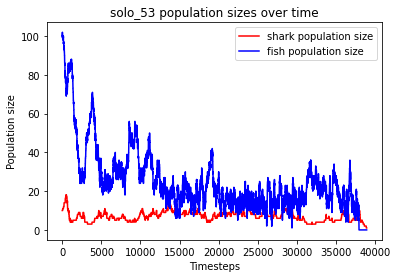

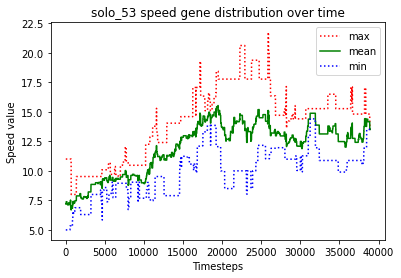

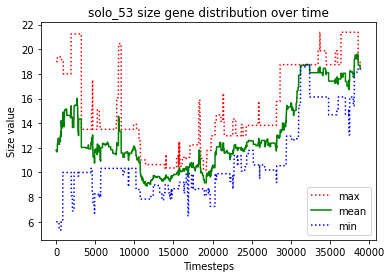

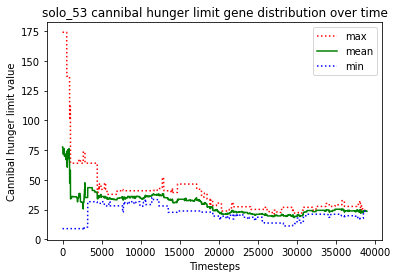

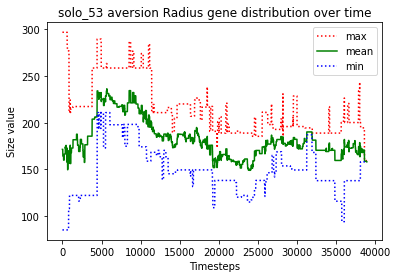

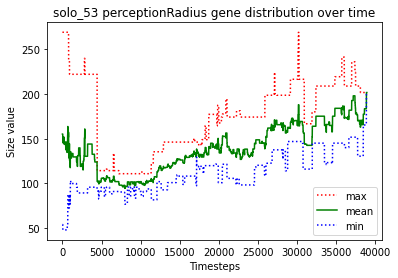

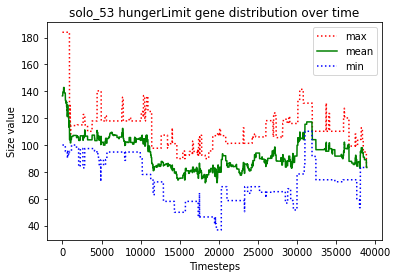





						SOLO_54

predator_3 just gave birth to predator_10
predator_10 killed predator_4
predator_3 killed predator_9
predator_10 killed predator_8
predator_3 killed predator_6
predator_0 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_14 killed predator_0
predator_3 killed predator_13
predator_10 killed predator_12
predator_1 just gave birth to predator_15
predator_10 just gave birth to predator_16
predator_3 killed predator_11
predator_3 just gave birth to predator_17
predator_10 killed predator_1
predator_16 killed predator_15
predator_10 just gave birth to predator_18
predator_7 just gave birth to predator_19
predator_3 just gave birth to predator_20
predator_16 killed predator_18
predator_2 just gave birth to predator_21
predator_17 starved to death
predator_16 ate the carcass of predator_17_carcass
predator_5 just gave birth to predator_22
predator_14 starved t

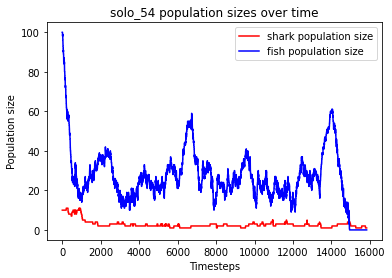

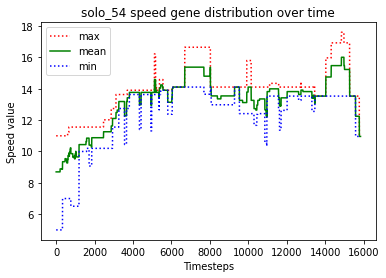

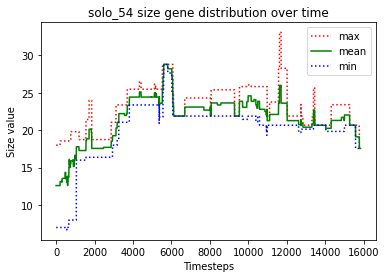

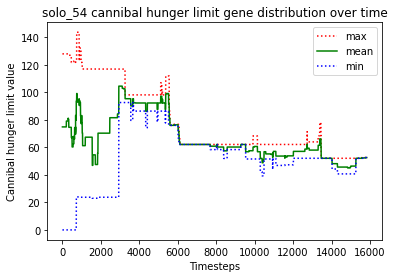

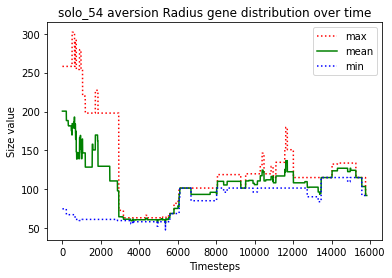

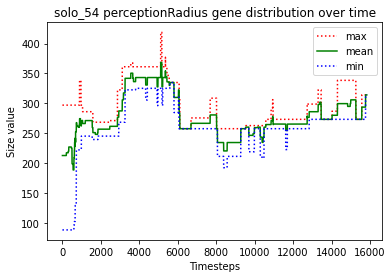

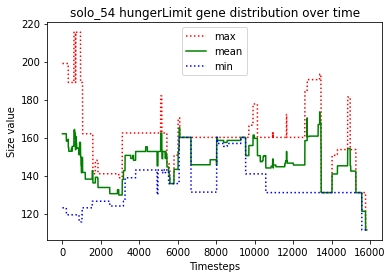





						SOLO_55

predator_0 just gave birth to predator_10
predator_9 killed predator_2
predator_5 killed predator_10
predator_3 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_7 killed predator_13
predator_4 just gave birth to predator_14
predator_0 starved to death
predator_1 ate the carcass of predator_0_carcass
predator_11 starved to death
predator_14 ate the carcass of predator_11_carcass
predator_14 just gave birth to predator_15
predator_15 killed predator_12
predator_3 starved to death
predator_4 just gave birth to predator_16
predator_4 killed predator_16
predator_6 ate the carcass of predator_3_carcass
predator_7 starved to death
predator_1 just gave birth to predator_17
predator_8 ate the carcass of predator_7_carcass
predator_17 just gave birth to predator_18
predator_18 just gave birth to predator_19
predator_18 killed predator_5
predator_4 starved to death
predator_1 ate the carcass of predator

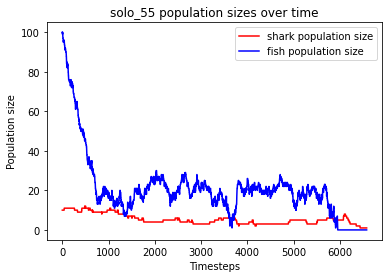

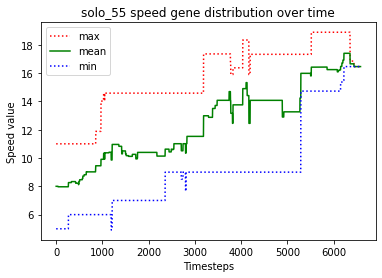

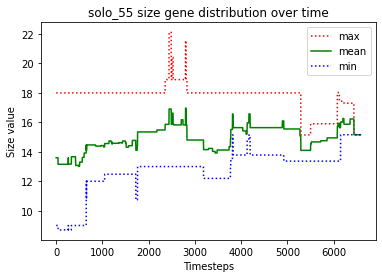

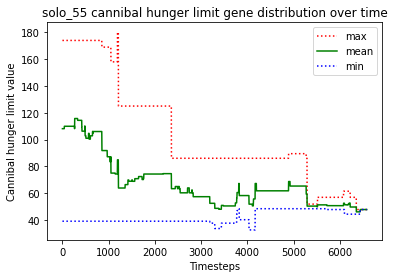

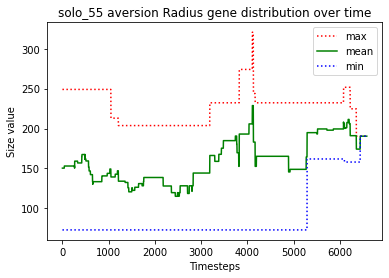

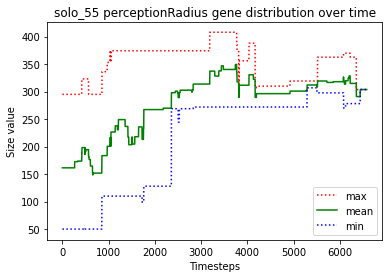

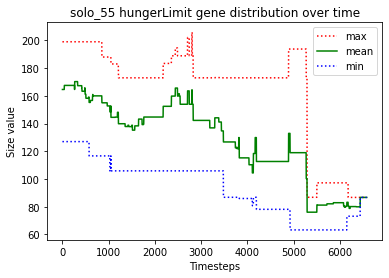





						SOLO_56

predator_8 just gave birth to predator_10
predator_8 killed predator_10
predator_9 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_8 killed predator_1
predator_7 just gave birth to predator_14
predator_12 just gave birth to predator_15
predator_15 starved to death
predator_12 starved to death
predator_13 just gave birth to predator_16
predator_4 just gave birth to predator_17
predator_13 starved to death
predator_16 starved to death
predator_6 ate the carcass of predator_13_carcass
predator_8 ate the carcass of predator_12_carcass
predator_11 just gave birth to predator_18
predator_11 killed predator_18
predator_8 ate the carcass of predator_15_carcass
predator_7 starved to death
predator_11 ate the carcass of predator_7_carcass
predator_9 just gave birth to predator_19
predator_19 starved to death
predator_9 starved to death
predator_0 ate the carcass of predator_16_carcass
predator_17 ate 

no fish to move
predator_69 starved to death
predator_65 ate the carcass of predator_69_carcass
predator_68 starved to death
predator_65 ate the carcass of predator_68_carcass
predator_65 just gave birth to predator_70
predator_58 starved to death
predator_65 ate the carcass of predator_58_carcass
predator_70 starved to death
predator_64 ate the carcass of predator_70_carcass
predator_65 starved to death
predator_64 just gave birth to predator_71
predator_71 just gave birth to predator_72
predator_72 starved to death
predator_71 starved to death
predator_64 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 73
Timesteps passed: 18578
Fish went extinct at timestep 18066
Sharks went extinct at timestep 18578


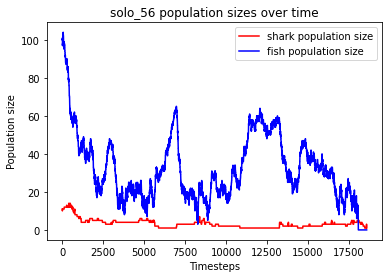

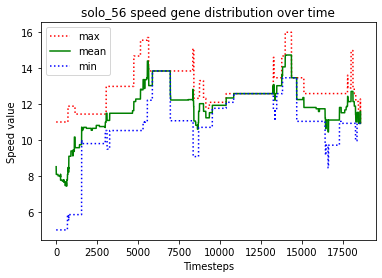

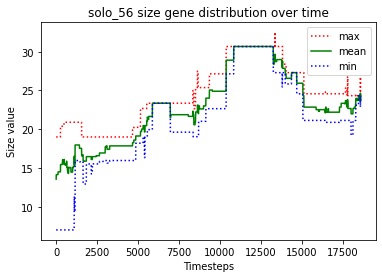

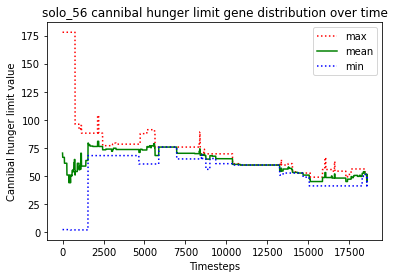

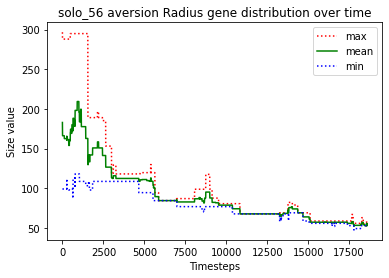

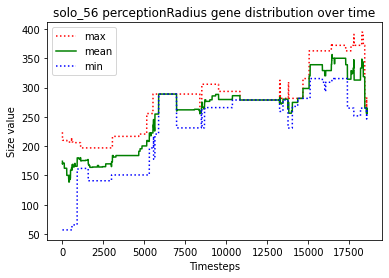

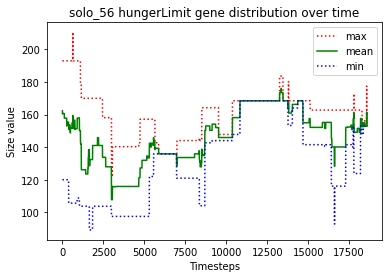





						SOLO_57

predator_2 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_10 killed predator_0
predator_8 just gave birth to predator_12
predator_12 killed predator_10
predator_11 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_14 starved to death
predator_13 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_2 starved to death
predator_5 ate the carcass of predator_14_carcass
predator_11 ate the carcass of predator_2_carcass
predator_12 killed predator_7
predator_3 just gave birth to predator_15
predator_12 just gave birth to predator_16
predator_4 starved to death
predator_5 ate the carcass of predator_4_carcass
predator_16 killed predator_1
predator_6 just gave birth to predator_17
predator_11 starved to death
predator_16 ate the carcass of predator_11_carcass
predator_6 just gave birth to predator_18
predator_16 killed predator_9
predator_12 killed predator_3
predator_16 killed predato

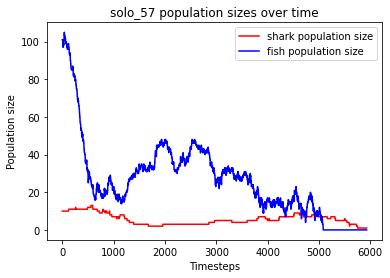

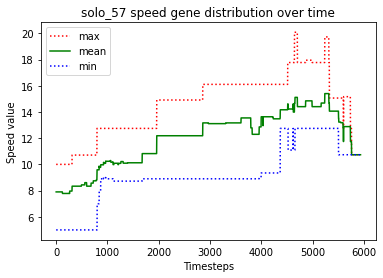

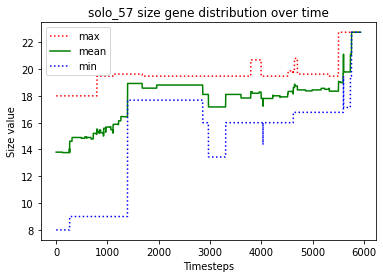

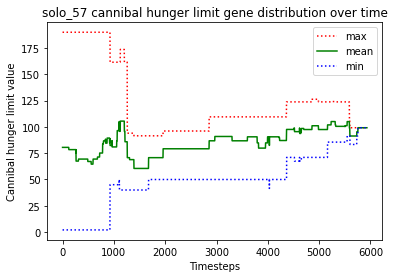

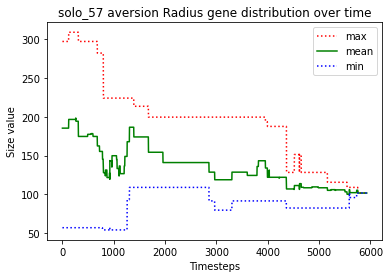

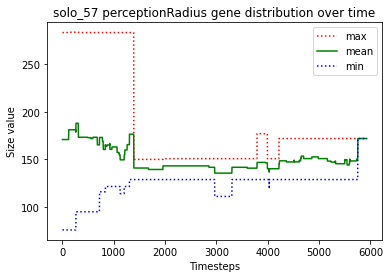

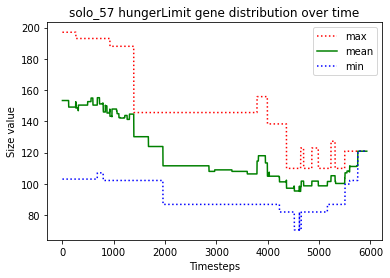





						SOLO_58

predator_5 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_11 starved to death
predator_13 starved to death
predator_2 just gave birth to predator_15
predator_0 ate the carcass of predator_13_carcass
predator_2 ate the carcass of predator_11_carcass
predator_8 just gave birth to predator_16
predator_15 killed predator_12
predator_2 killed predator_8
predator_10 starved to death
predator_0 just gave birth to predator_17
predator_16 starved to death
predator_6 ate the carcass of predator_10_carcass
predator_15 ate the carcass of predator_16_carcass
predator_7 just gave birth to predator_18
predator_15 just gave birth to predator_19
predator_17 killed predator_19
predator_5 starved to death
predator_17 killed predator_15
predator_7 ate the carcass of predator_5_carcass
predator_4 starved to death
predator_9 ate

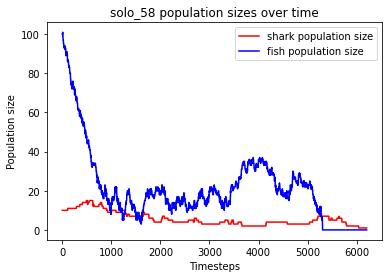

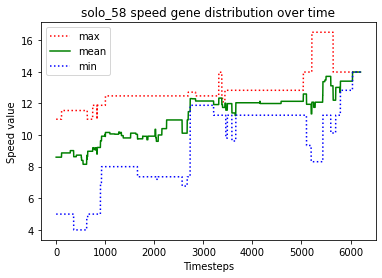

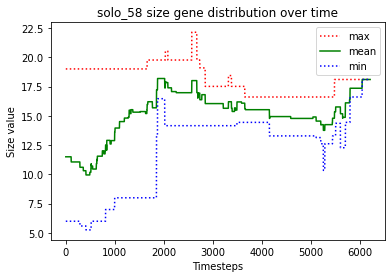

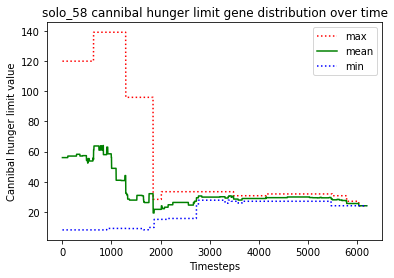

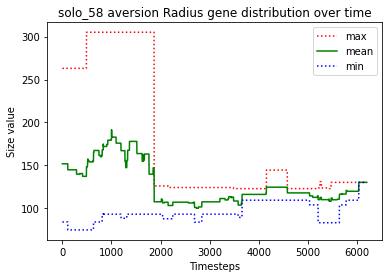

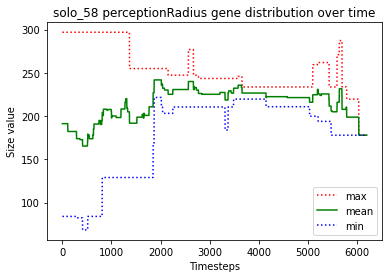

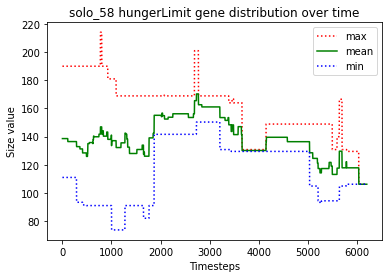





						SOLO_59

predator_3 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_7 killed predator_10
predator_3 starved to death
predator_4 just gave birth to predator_14
predator_11 starved to death
predator_8 starved to death
predator_5 ate the carcass of predator_3_carcass
predator_5 ate the carcass of predator_11_carcass
predator_4 killed predator_13
predator_2 starved to death
predator_6 just gave birth to predator_15
predator_5 ate the carcass of predator_8_carcass
predator_4 ate the carcass of predator_2_carcass
predator_6 killed predator_0
predator_12 killed predator_9
predator_5 just gave birth to predator_16
predator_5 killed predator_16
predator_14 just gave birth to predator_17
predator_5 killed predator_12
predator_17 starved to death
predator_14 starved to death
predator_15 ate the carcass of predator_14_carcass
predator_7 ate the carcass of predator_17_carc

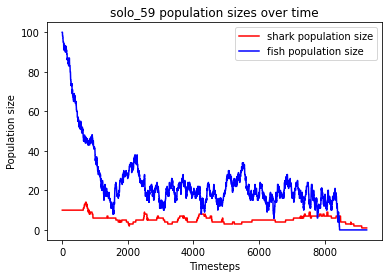

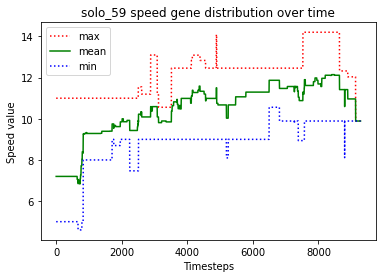

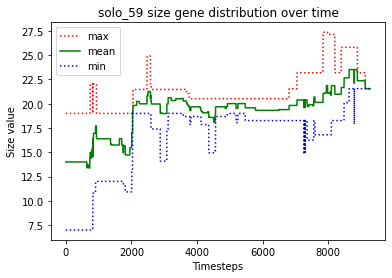

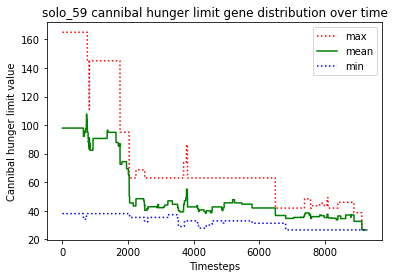

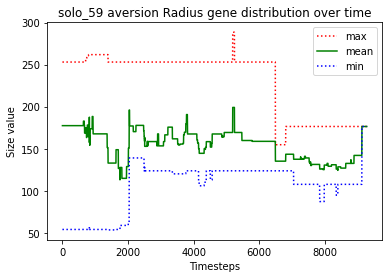

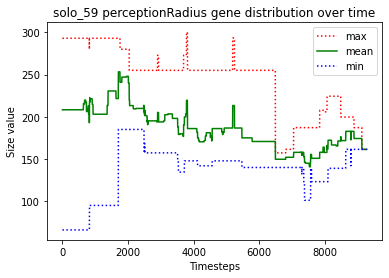

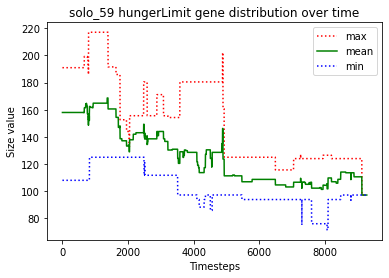





						SOLO_60

predator_7 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_10 starved to death
predator_12 ate the carcass of predator_10_carcass
predator_12 starved to death
predator_11 starved to death
predator_8 just gave birth to predator_14
predator_4 ate the carcass of predator_12_carcass
predator_6 ate the carcass of predator_11_carcass
predator_1 just gave birth to predator_15
predator_13 just gave birth to predator_16
predator_1 killed predator_7
predator_13 starved to death
predator_3 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_5 ate the carcass of predator_13_carcass
predator_16 starved to death
predator_18 starved to death
predator_5 ate the carcass of predator_18_carcass
predator_5 ate the carcass of predator_16_carcass
predator_3 killed predator_2
predator_1 killed predator_5
predator_1 killed predator_6
predator

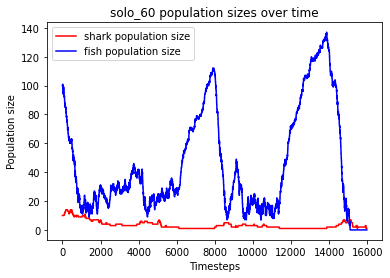

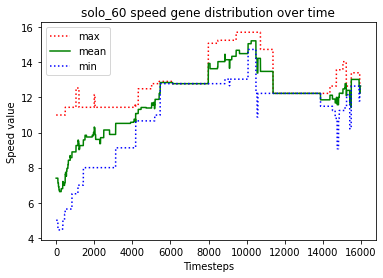

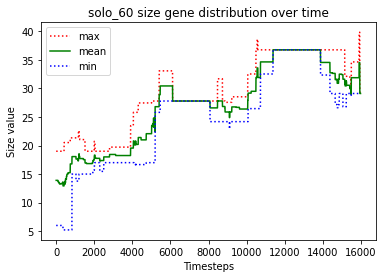

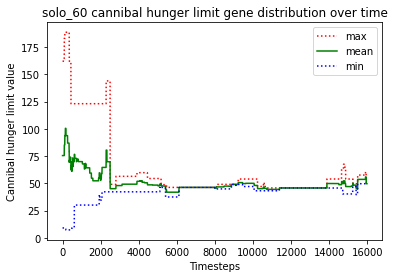

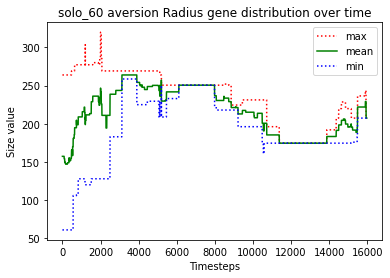

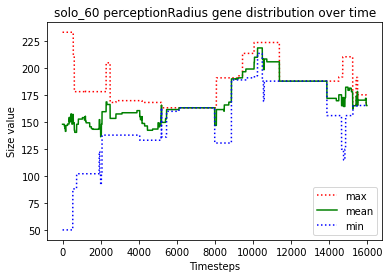

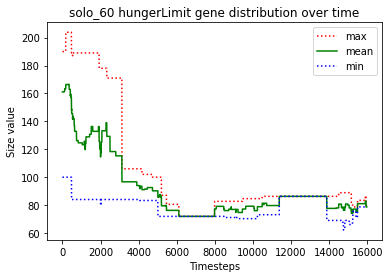





						SOLO_61

predator_5 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_11 just gave birth to predator_15
predator_2 just gave birth to predator_16
predator_11 starved to death
predator_12 ate the carcass of predator_11_carcass
predator_1 just gave birth to predator_17
predator_3 starved to death
predator_14 ate the carcass of predator_3_carcass
predator_15 killed predator_8
predator_15 killed predator_5
predator_13 just gave birth to predator_18
predator_13 just gave birth to predator_19
predator_18 starved to death
predator_13 starved to death
predator_19 starved to death
predator_12 starved to death
predator_17 starved to death
predator_1 ate the carcass of predator_18_carcass
predator_10 ate the carcass of predator_19_carcass
predator_1 ate the carcass of predator_17_carcass
predator_15 ate the carcass of predator_12_c

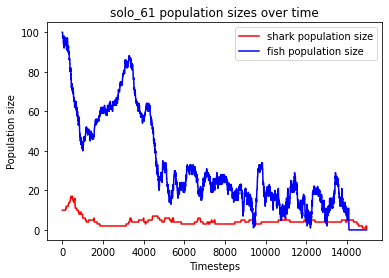

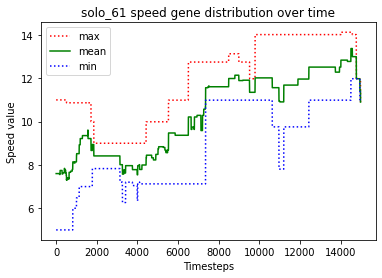

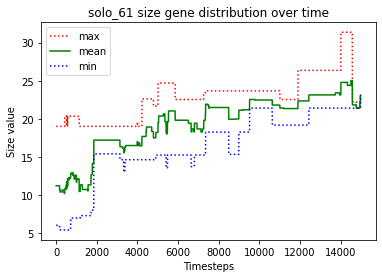

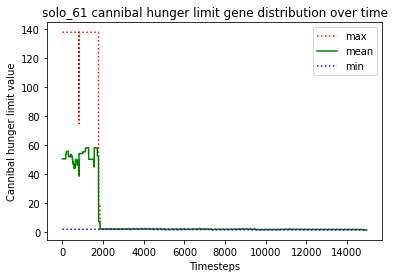

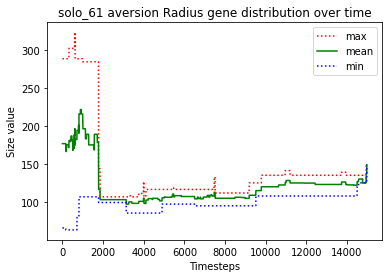

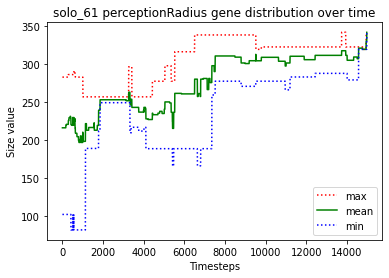

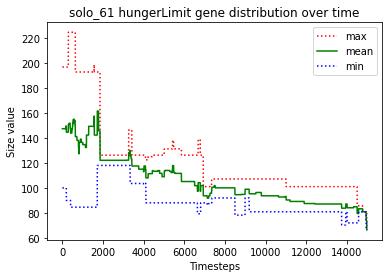





						SOLO_62

predator_7 killed predator_9
predator_7 killed predator_8
predator_7 killed predator_1
predator_7 killed predator_6
predator_0 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_4 just gave birth to predator_12
predator_7 killed predator_2
predator_7 killed predator_11
predator_3 just gave birth to predator_13
predator_5 starved to death
predator_4 ate the carcass of predator_5_carcass
predator_13 just gave birth to predator_14
predator_7 killed predator_10
predator_4 killed predator_14
predator_3 starved to death
predator_13 ate the carcass of predator_3_carcass
predator_12 killed predator_13
predator_4 just gave birth to predator_15
predator_4 starved to death
predator_0 just gave birth to predator_16
predator_12 starved to death
predator_7 ate the carcass of predator_4_carcass
predator_16 starved to death
predator_15 starved to death
predator_7 ate the carcass of predator_12_carcass
predator_0 ate the carcass of predator_15_carcass
p

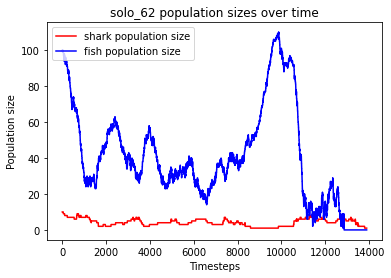

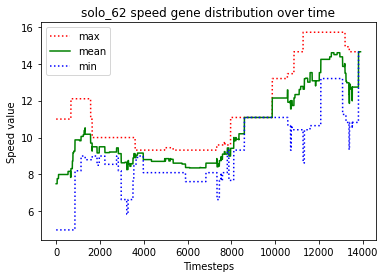

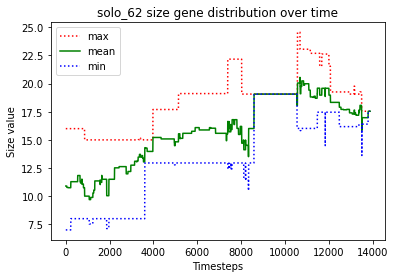

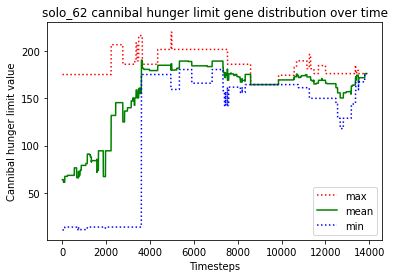

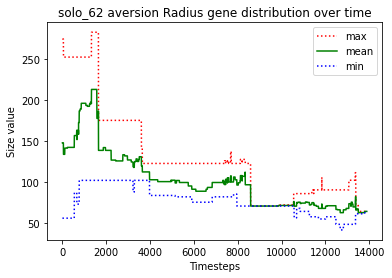

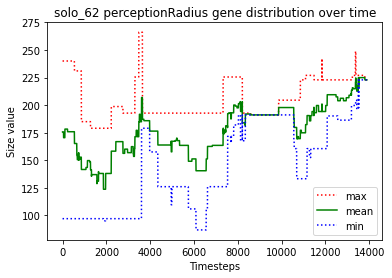

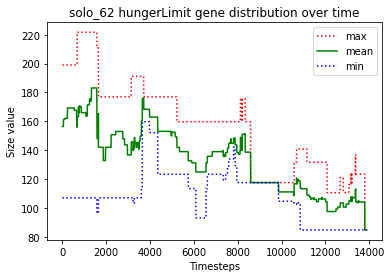





						SOLO_63

predator_2 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_1 just gave birth to predator_14
predator_2 just gave birth to predator_15
predator_3 starved to death
predator_15 ate the carcass of predator_3_carcass
predator_12 starved to death
predator_8 just gave birth to predator_16
predator_2 killed predator_9
predator_10 just gave birth to predator_17
predator_10 ate the carcass of predator_12_carcass
predator_14 just gave birth to predator_18
predator_13 starved to death
predator_11 starved to death
predator_16 ate the carcass of predator_11_carcass
predator_7 ate the carcass of predator_13_carcass
predator_4 just gave birth to predator_19
predator_1 just gave birth to predator_20
predator_4 killed predator_14
predator_15 killed predator_17
predator_18 starved to death
predator_7 ate the carcass of predator_18_carcass
predator_20 starved to death
p

predator_66 killed predator_62
predator_67 starved to death
predator_58 ate the carcass of predator_67_carcass
predator_58 just gave birth to predator_69
predator_58 starved to death
predator_69 ate the carcass of predator_58_carcass
predator_69 just gave birth to predator_70
predator_70 starved to death
predator_69 ate the carcass of predator_70_carcass
predator_66 just gave birth to predator_71
predator_63 just gave birth to predator_72
predator_72 just gave birth to predator_73
predator_71 just gave birth to predator_74
predator_74 killed predator_63
predator_69 starved to death
predator_73 ate the carcass of predator_69_carcass
predator_71 starved to death
predator_73 ate the carcass of predator_71_carcass
predator_74 just gave birth to predator_75
predator_66 starved to death
predator_73 ate the carcass of predator_66_carcass
predator_74 just gave birth to predator_76
predator_76 just gave birth to predator_77
predator_77 starved to death
predator_76 starved to death
predator_74 a

predator_127 killed predator_133
predator_130 killed predator_129
predator_128 just gave birth to predator_134
predator_134 ate the carcass of predator_132_carcass
predator_128 starved to death
predator_127 ate the carcass of predator_128_carcass
predator_125 ate the carcass of predator_131_carcass
predator_134 starved to death
predator_107 ate the carcass of predator_134_carcass
predator_125 just gave birth to predator_135
predator_127 just gave birth to predator_136
predator_125 just gave birth to predator_137
predator_136 starved to death
predator_107 ate the carcass of predator_136_carcass
predator_127 starved to death
predator_125 just gave birth to predator_138
predator_138 just gave birth to predator_139
predator_138 starved to death
predator_107 just gave birth to predator_140
predator_140 ate the carcass of predator_127_carcass
predator_107 ate the carcass of predator_138_carcass
predator_107 killed predator_135
predator_139 starved to death
predator_137 ate the carcass of pre

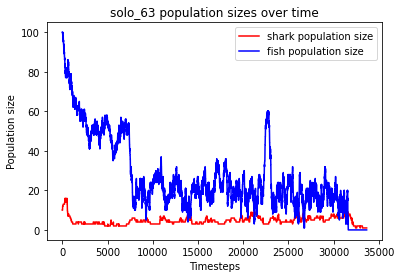

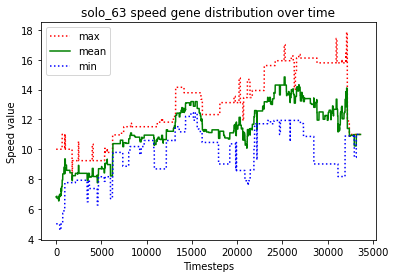

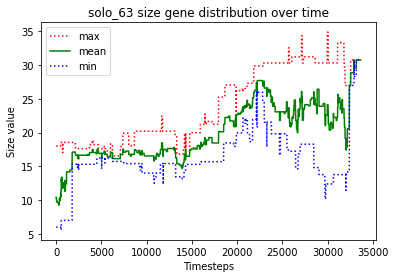

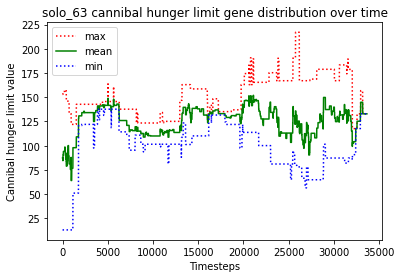

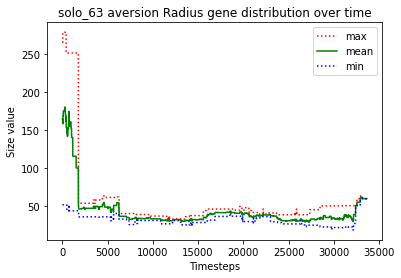

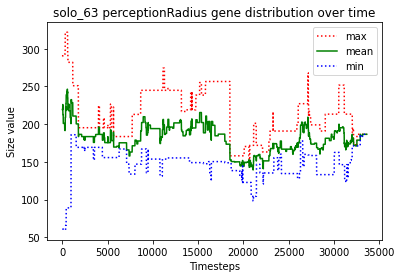

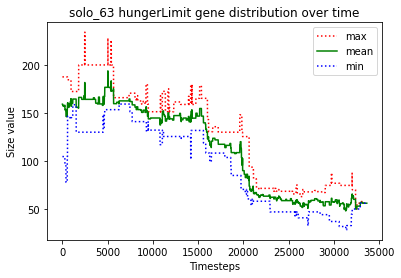





						SOLO_64

predator_1 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_2 just gave birth to predator_15
predator_3 just gave birth to predator_16
predator_13 just gave birth to predator_17
predator_14 just gave birth to predator_18
predator_13 starved to death
predator_11 starved to death
predator_17 ate the carcass of predator_13_carcass
predator_7 just gave birth to predator_19
predator_18 starved to death
predator_12 ate the carcass of predator_11_carcass
predator_1 ate the carcass of predator_18_carcass
predator_17 starved to death
predator_16 ate the carcass of predator_17_carcass
predator_15 just gave birth to predator_20
predator_15 starved to death
predator_20 starved to death
predator_14 starved to death
predator_2 ate the carcass of predator_20_carcass
predator_12 just gave birth to predator_21
predator_6 ate 

predator_54 starved to death
predator_63 ate the carcass of predator_54_carcass
predator_47 just gave birth to predator_66
predator_55 just gave birth to predator_67
predator_66 starved to death
predator_67 just gave birth to predator_68
predator_67 ate the carcass of predator_66_carcass
predator_67 just gave birth to predator_69
predator_68 starved to death
predator_63 ate the carcass of predator_68_carcass
predator_47 starved to death
predator_69 ate the carcass of predator_47_carcass
predator_63 just gave birth to predator_70
predator_70 starved to death
predator_67 ate the carcass of predator_70_carcass
predator_63 just gave birth to predator_71
predator_71 starved to death
predator_55 ate the carcass of predator_71_carcass
predator_63 starved to death
predator_65 ate the carcass of predator_63_carcass
predator_69 starved to death
predator_67 just gave birth to predator_72
predator_65 ate the carcass of predator_69_carcass
predator_67 just gave birth to predator_73
predator_73 star

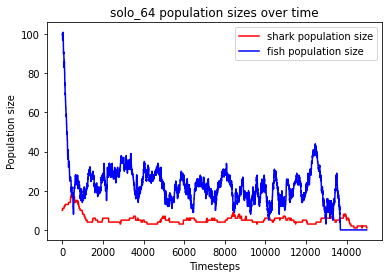

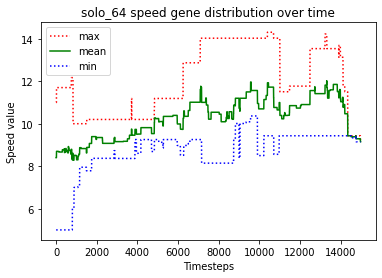

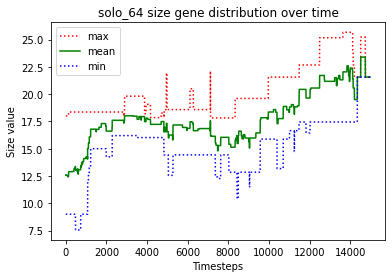

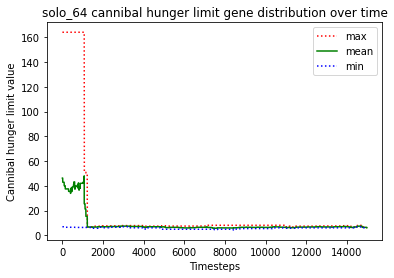

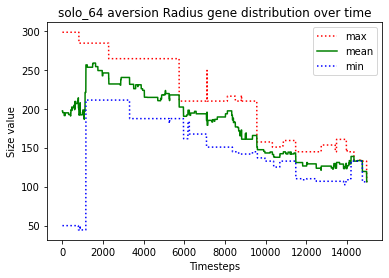

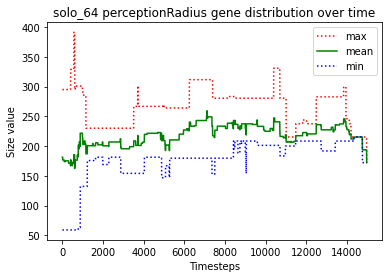

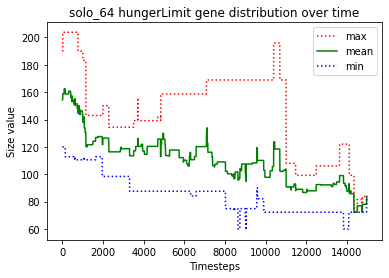





						SOLO_65

predator_7 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_7 starved to death
predator_11 ate the carcass of predator_7_carcass
predator_10 starved to death
predator_8 ate the carcass of predator_10_carcass
predator_5 just gave birth to predator_12
predator_2 starved to death
predator_11 just gave birth to predator_13
predator_1 ate the carcass of predator_2_carcass
predator_6 just gave birth to predator_14
predator_0 starved to death
predator_12 ate the carcass of predator_0_carcass
predator_11 starved to death
predator_13 starved to death
predator_8 just gave birth to predator_15
predator_3 ate the carcass of predator_11_carcass
predator_3 ate the carcass of predator_13_carcass
predator_8 killed predator_14
predator_6 just gave birth to predator_16
predator_3 just gave birth to predator_17
predator_3 just gave birth to predator_18
predator_5 just gave birth to predator_19
predator_5 killed predator_19
predator_5 starved to death
pr

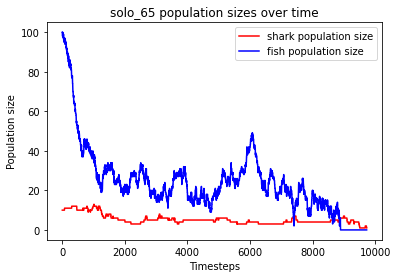

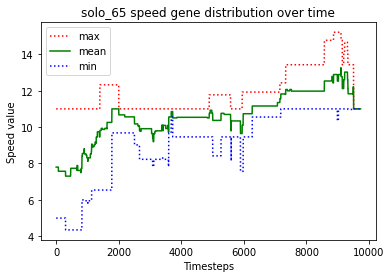

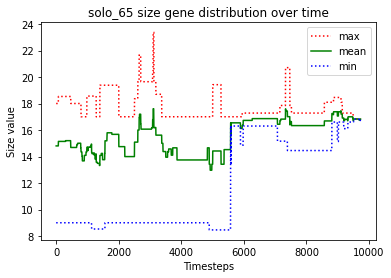

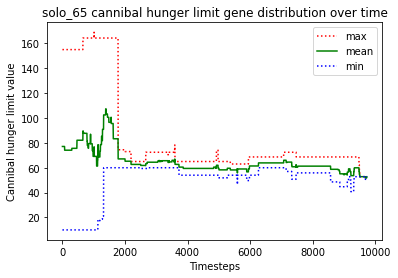

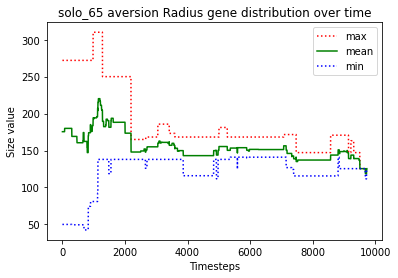

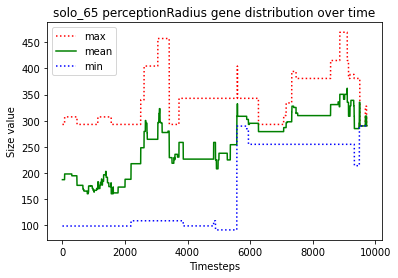

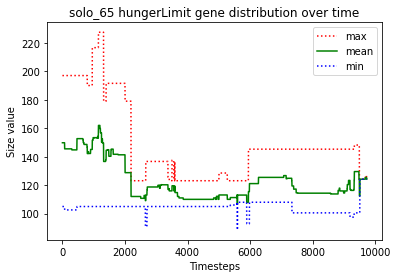





						SOLO_66

predator_6 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_12 starved to death
predator_8 ate the carcass of predator_12_carcass
predator_3 just gave birth to predator_14
predator_10 starved to death
predator_3 ate the carcass of predator_10_carcass
predator_13 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_3 killed predator_7
predator_0 starved to death
predator_5 just gave birth to predator_15
predator_3 ate the carcass of predator_0_carcass
predator_14 starved to death
predator_3 ate the carcass of predator_14_carcass
predator_11 starved to death
predator_8 ate the carcass of predator_11_carcass
predator_15 starved to death
predator_5 starved to death
predator_8 ate the carcass of predator_15_carcass
predator_9 ate the carcass of predator_5_carcass
predator_6 starved to death
predator_3 starved to death
predator_8 just

predator_56 just gave birth to predator_67
predator_65 just gave birth to predator_68
predator_68 killed predator_62
predator_65 just gave birth to predator_69
predator_65 starved to death
predator_69 ate the carcass of predator_65_carcass
predator_69 just gave birth to predator_70
predator_68 killed predator_70
predator_67 just gave birth to predator_71
predator_69 starved to death
predator_68 ate the carcass of predator_69_carcass
predator_71 starved to death
predator_67 starved to death
predator_56 just gave birth to predator_72
predator_68 ate the carcass of predator_67_carcass
predator_56 just gave birth to predator_73
predator_72 ate the carcass of predator_71_carcass
predator_73 starved to death
predator_72 just gave birth to predator_74
predator_68 ate the carcass of predator_73_carcass
predator_74 just gave birth to predator_75
predator_56 starved to death
predator_68 ate the carcass of predator_56_carcass
predator_74 starved to death
predator_58 ate the carcass of predator_74

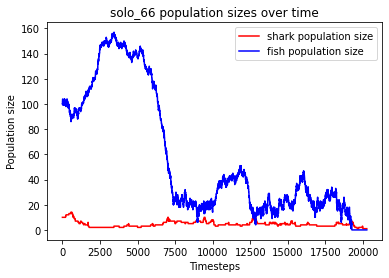

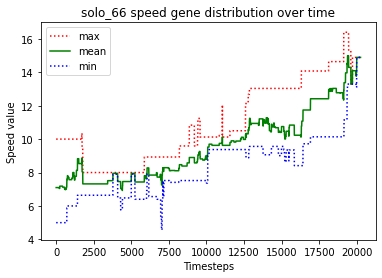

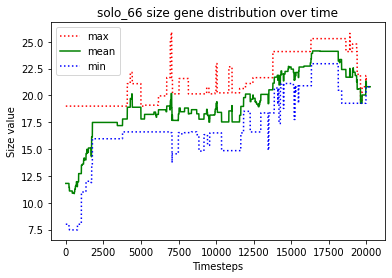

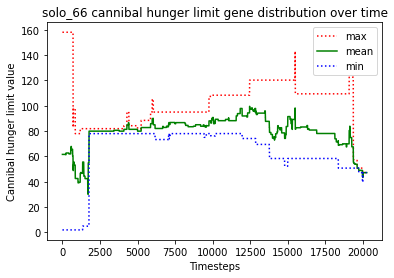

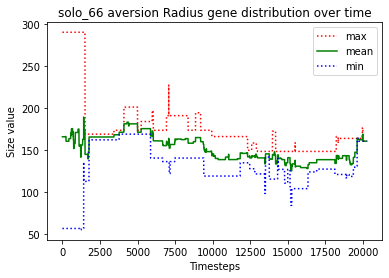

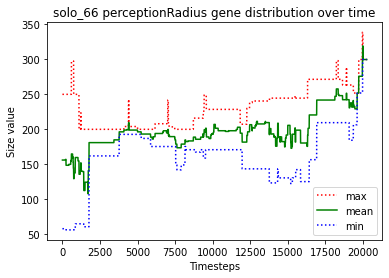

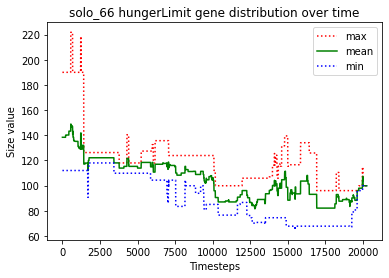





						SOLO_67

predator_8 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_9 killed predator_4
predator_13 killed predator_3
predator_13 killed predator_0
predator_10 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_10 killed predator_5
predator_13 killed predator_2
predator_14 starved to death
predator_15 ate the carcass of predator_14_carcass
predator_6 just gave birth to predator_16
predator_15 starved to death
predator_12 starved to death
predator_6 just gave birth to predator_17
predator_10 ate the carcass of predator_12_carcass
predator_13 ate the carcass of predator_15_carcass
predator_9 just gave birth to predator_18
predator_13 just gave birth to predator_19
predator_10 starved to death
predator_13 just gave birth to predator_20
predator_1 starved to death
predator_20 starved to death
predator_17 starved to death
predator_9

predator_67 starved to death
predator_70 just gave birth to predator_71
predator_71 starved to death
predator_70 starved to death
predator_60 ate the carcass of predator_67_carcass
predator_53 ate the carcass of predator_71_carcass
predator_63 just gave birth to predator_72
predator_53 ate the carcass of predator_70_carcass
predator_60 just gave birth to predator_73
predator_72 starved to death
predator_60 ate the carcass of predator_72_carcass
predator_73 starved to death
predator_53 ate the carcass of predator_73_carcass
predator_63 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_63 starved to death
predator_75 starved to death
predator_53 ate the carcass of predator_63_carcass
predator_74 starved to death
predator_53 ate the carcass of predator_75_carcass
predator_60 just gave birth to predator_76
predator_60 ate the carcass of predator_74_carcass
predator_76 starved to death
predator_53 ate the carcass of predator_76_carcass
predator_60 just gave 

predator_131 starved to death
predator_120 starved to death
predator_125 ate the carcass of predator_131_carcass
predator_133 just gave birth to predator_135
predator_134 starved to death
predator_135 just gave birth to predator_136
predator_135 starved to death
predator_136 ate the carcass of predator_135_carcass
predator_133 starved to death
predator_130 ate the carcass of predator_120_carcass
predator_136 ate the carcass of predator_133_carcass
predator_130 ate the carcass of predator_134_carcass
predator_136 just gave birth to predator_137
predator_137 starved to death
predator_136 starved to death
predator_125 ate the carcass of predator_136_carcass
predator_130 just gave birth to predator_138
predator_113 starved to death
predator_138 ate the carcass of predator_113_carcass
predator_130 ate the carcass of predator_137_carcass
predator_125 just gave birth to predator_139
predator_139 just gave birth to predator_140
predator_139 killed predator_140
predator_138 starved to death
pre

predator_173 ate the carcass of predator_186_carcass
predator_189 ate the carcass of predator_183_carcass
predator_192 starved to death
predator_188 just gave birth to predator_193
predator_173 ate the carcass of predator_192_carcass
predator_180 just gave birth to predator_194
predator_194 starved to death
predator_189 ate the carcass of predator_194_carcass
predator_188 just gave birth to predator_195
predator_195 starved to death
predator_188 starved to death
predator_189 ate the carcass of predator_195_carcass
predator_173 ate the carcass of predator_188_carcass
predator_193 just gave birth to predator_196
predator_196 just gave birth to predator_197
predator_197 starved to death
predator_189 ate the carcass of predator_197_carcass
predator_193 starved to death
predator_173 ate the carcass of predator_193_carcass
predator_196 starved to death
predator_180 ate the carcass of predator_196_carcass
predator_180 just gave birth to predator_198
predator_198 just gave birth to predator_19

predator_213 just gave birth to predator_252
predator_213 ate the carcass of predator_250_carcass
predator_213 ate the carcass of predator_251_carcass
predator_247 killed predator_252
predator_213 just gave birth to predator_253
predator_213 just gave birth to predator_254
predator_254 starved to death
predator_213 starved to death
predator_247 ate the carcass of predator_254_carcass
predator_248 starved to death
predator_253 starved to death
predator_247 ate the carcass of predator_248_carcass
predator_247 just gave birth to predator_255
predator_247 killed predator_255
predator_247 ate the carcass of predator_253_carcass
predator_247 ate the carcass of predator_213_carcass
predator_247 just gave birth to predator_256
predator_247 just gave birth to predator_257
predator_247 just gave birth to predator_258
predator_256 just gave birth to predator_259
predator_256 killed predator_259
predator_247 just gave birth to predator_260
predator_260 starved to death
predator_247 ate the carcass

predator_284 starved to death
predator_309 ate the carcass of predator_284_carcass
predator_290 just gave birth to predator_311
predator_290 starved to death
predator_307 ate the carcass of predator_290_carcass
predator_307 just gave birth to predator_312
predator_307 killed predator_312
predator_311 just gave birth to predator_313
predator_309 just gave birth to predator_314
predator_309 killed predator_314
predator_311 starved to death
predator_313 starved to death
predator_309 ate the carcass of predator_311_carcass
predator_307 ate the carcass of predator_313_carcass
predator_309 just gave birth to predator_315
predator_315 just gave birth to predator_316
predator_316 just gave birth to predator_317
predator_317 killed predator_315
predator_317 killed predator_309
predator_317 killed predator_307
predator_317 starved to death
predator_316 ate the carcass of predator_317_carcass
predator_316 just gave birth to predator_318
predator_316 just gave birth to predator_319
predator_319 ju

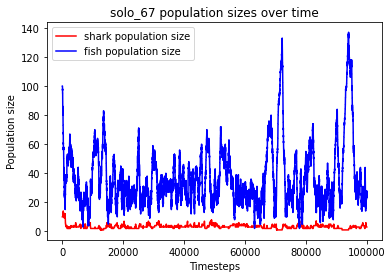

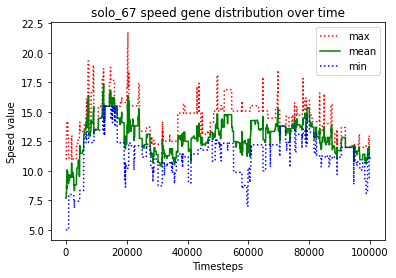

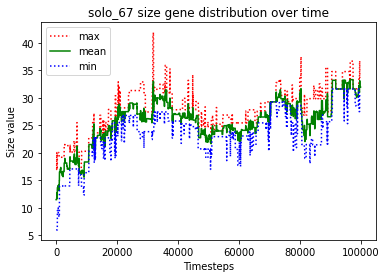

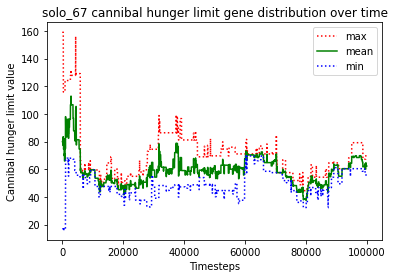

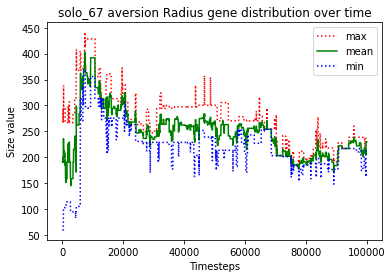

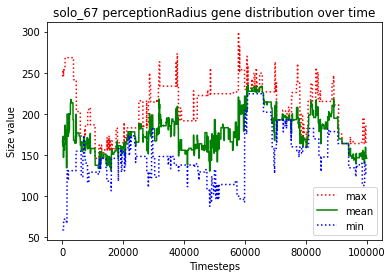

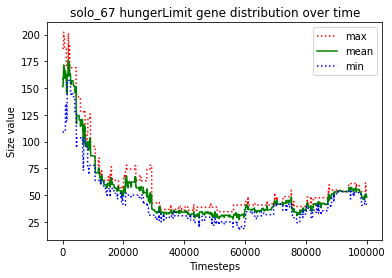





						SOLO_68

predator_8 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_11 just gave birth to predator_15
predator_9 killed predator_7
predator_9 killed predator_5
predator_0 just gave birth to predator_16
predator_0 just gave birth to predator_17
predator_16 starved to death
predator_0 starved to death
predator_17 starved to death
predator_1 ate the carcass of predator_16_carcass
predator_8 ate the carcass of predator_17_carcass
predator_8 ate the carcass of predator_0_carcass
predator_4 killed predator_10
predator_14 starved to death
predator_9 ate the carcass of predator_14_carcass
predator_6 just gave birth to predator_18
predator_13 just gave birth to predator_19
predator_12 starved to death
predator_13 just gave birth to predator_20
predator_9 just gave birth to predator_21
predator_6 ate the carcass of predator_12_c

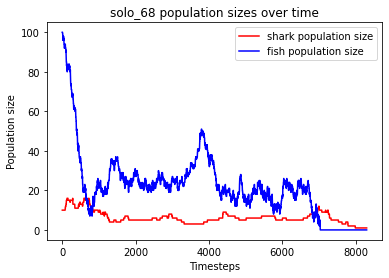

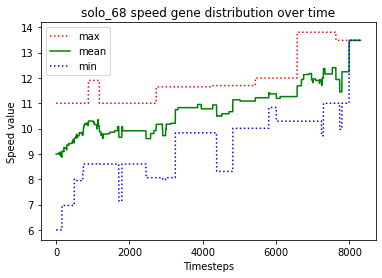

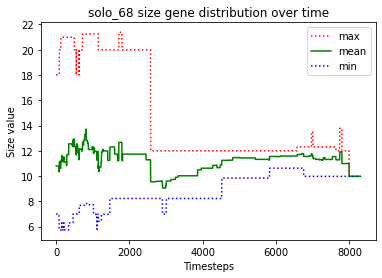

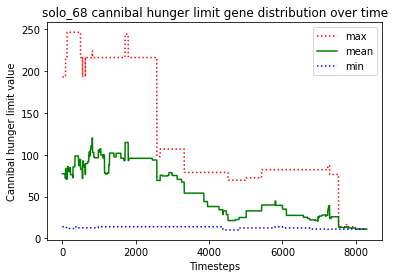

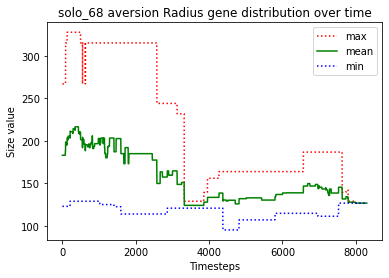

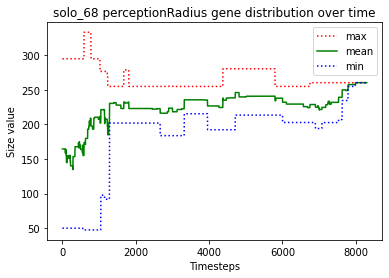

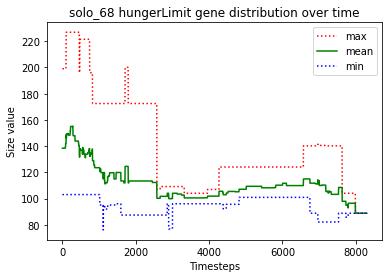





						SOLO_69

predator_1 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_11 killed predator_2
predator_9 just gave birth to predator_12
predator_8 killed predator_1
predator_10 killed predator_4
predator_7 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_8 killed predator_14
predator_8 killed predator_0
predator_8 killed predator_5
predator_10 just gave birth to predator_15
predator_8 killed predator_13
predator_9 starved to death
predator_15 ate the carcass of predator_9_carcass
predator_8 killed predator_7
predator_12 starved to death
predator_6 just gave birth to predator_16
predator_6 ate the carcass of predator_12_carcass
predator_8 just gave birth to predator_17
predator_3 starved to death
predator_6 ate the carcass of predator_3_carcass
predator_8 just gave birth to predator_18
predator_15 starved to death
predator_8 ate the carcass of predator_15_carcass
predator_10 starved to death
predator_11 ate the car

predator_72 starved to death
predator_67 ate the carcass of predator_72_carcass
predator_67 just gave birth to predator_73
predator_67 just gave birth to predator_74
predator_74 killed predator_73
predator_68 just gave birth to predator_75
predator_74 starved to death
predator_67 ate the carcass of predator_74_carcass
predator_75 starved to death
predator_67 ate the carcass of predator_75_carcass
predator_68 starved to death
predator_67 ate the carcass of predator_68_carcass
predator_67 just gave birth to predator_76
predator_67 killed predator_76
predator_67 just gave birth to predator_77
predator_67 just gave birth to predator_78
predator_78 killed predator_77
predator_67 just gave birth to predator_79
predator_79 just gave birth to predator_80
predator_78 just gave birth to predator_81
predator_79 starved to death
predator_81 ate the carcass of predator_79_carcass
predator_67 starved to death
predator_78 ate the carcass of predator_67_carcass
predator_78 just gave birth to predator_

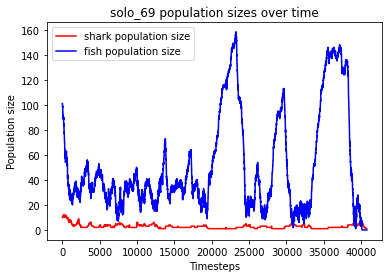

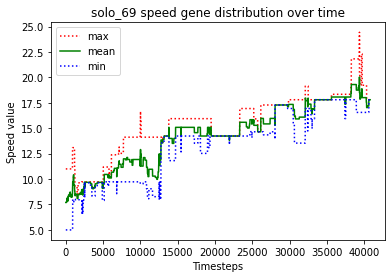

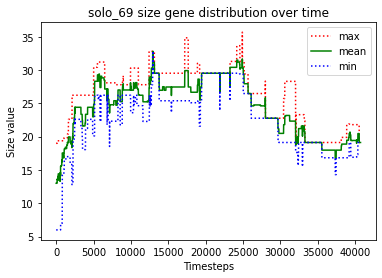

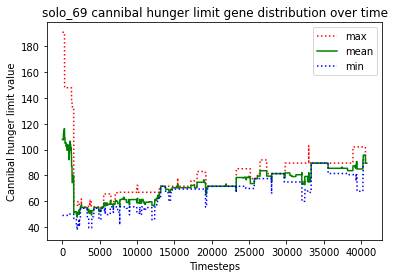

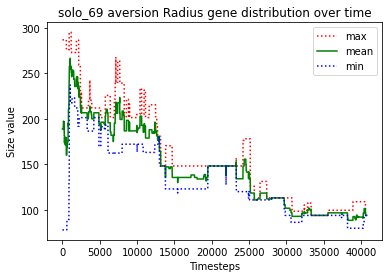

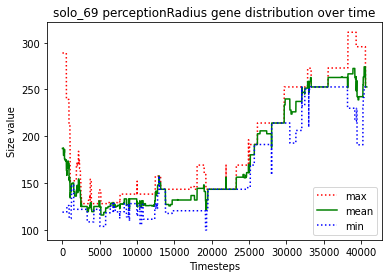

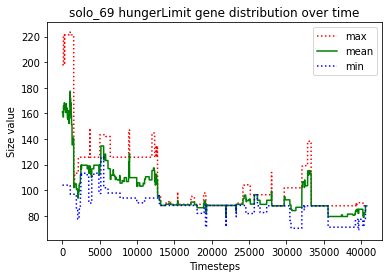





						SOLO_70

predator_1 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_14 killed predator_8
predator_14 killed predator_9
predator_4 killed predator_1
predator_14 killed predator_10
predator_14 killed predator_6
predator_4 killed predator_0
predator_12 killed predator_3
predator_14 killed predator_12
predator_14 killed predator_5
predator_13 starved to death
predator_14 killed predator_11
predator_7 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_15 just gave birth to predator_17
predator_16 starved to death
predator_2 ate the carcass of predator_16_carcass
predator_15 starved to death
predator_14 ate the carcass of predator_13_carcass
predator_7 just gave birth to predator_18
predator_17 starved to death
predator_18 starved to death
predator_7 starved to death
predator_2 ate the carcass 

predator_68 starved to death
predator_69 starved to death
predator_60 ate the carcass of predator_69_carcass
predator_60 ate the carcass of predator_68_carcass
predator_54 just gave birth to predator_71
predator_71 starved to death
predator_60 just gave birth to predator_72
predator_64 just gave birth to predator_73
predator_73 just gave birth to predator_74
predator_54 ate the carcass of predator_71_carcass
predator_72 killed predator_73
predator_60 just gave birth to predator_75
predator_60 just gave birth to predator_76
predator_60 starved to death
predator_76 starved to death
predator_72 ate the carcass of predator_76_carcass
predator_54 ate the carcass of predator_60_carcass
predator_64 starved to death
predator_72 ate the carcass of predator_64_carcass
predator_75 just gave birth to predator_77
predator_72 killed predator_77
predator_72 just gave birth to predator_78
predator_74 just gave birth to predator_79
predator_78 starved to death
predator_74 ate the carcass of predator_78

predator_133 starved to death
predator_134 just gave birth to predator_135
predator_134 just gave birth to predator_136
predator_131 killed predator_135
predator_132 ate the carcass of predator_133_carcass
predator_134 starved to death
predator_136 starved to death
predator_129 starved to death
predator_131 ate the carcass of predator_134_carcass
predator_116 ate the carcass of predator_136_carcass
predator_123 starved to death
predator_116 ate the carcass of predator_129_carcass
predator_116 just gave birth to predator_137
predator_116 ate the carcass of predator_123_carcass
predator_131 just gave birth to predator_138
predator_132 just gave birth to predator_139
predator_116 killed predator_137
predator_138 just gave birth to predator_140
predator_140 starved to death
predator_138 ate the carcass of predator_140_carcass
predator_116 just gave birth to predator_141
predator_131 just gave birth to predator_142
predator_132 starved to death
predator_142 starved to death
predator_131 ate

predator_191 starved to death
predator_188 ate the carcass of predator_192_carcass
predator_193 ate the carcass of predator_191_carcass
predator_189 starved to death
predator_185 ate the carcass of predator_189_carcass
predator_186 starved to death
predator_190 ate the carcass of predator_186_carcass
predator_188 just gave birth to predator_194
predator_188 starved to death
predator_190 ate the carcass of predator_188_carcass
predator_194 starved to death
predator_190 ate the carcass of predator_194_carcass
predator_193 starved to death
predator_185 just gave birth to predator_195
predator_195 ate the carcass of predator_193_carcass
predator_185 just gave birth to predator_196
predator_196 just gave birth to predator_197
predator_195 just gave birth to predator_198
predator_195 starved to death
predator_196 just gave birth to predator_199
predator_199 just gave birth to predator_200
predator_200 starved to death
predator_197 ate the carcass of predator_195_carcass
predator_198 ate the 

predator_248 ate the carcass of predator_249_carcass
predator_250 starved to death
predator_232 just gave birth to predator_252
predator_232 ate the carcass of predator_250_carcass
predator_251 starved to death
predator_248 killed predator_252
predator_240 ate the carcass of predator_251_carcass
predator_248 starved to death
predator_240 ate the carcass of predator_248_carcass
predator_232 just gave birth to predator_253
predator_240 just gave birth to predator_254
predator_240 starved to death
predator_253 ate the carcass of predator_240_carcass
predator_254 just gave birth to predator_255
predator_232 just gave birth to predator_256
predator_254 just gave birth to predator_257
predator_256 starved to death
predator_232 ate the carcass of predator_256_carcass
predator_255 killed predator_257
predator_254 just gave birth to predator_258
predator_255 starved to death
predator_253 ate the carcass of predator_255_carcass
predator_258 starved to death
predator_253 ate the carcass of predat

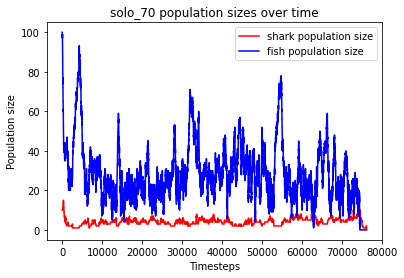

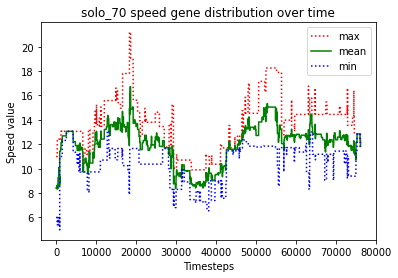

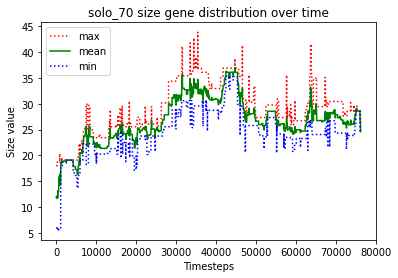

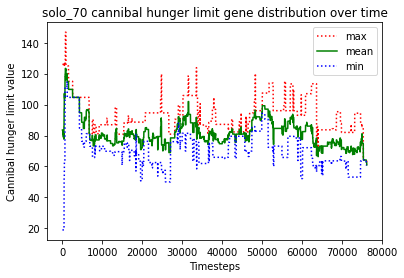

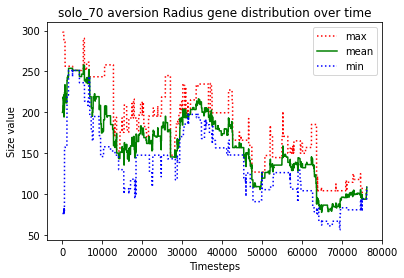

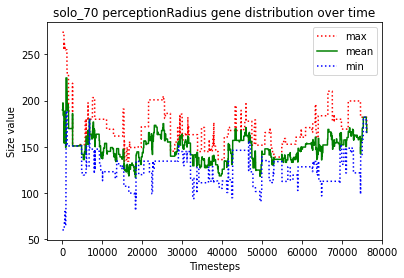

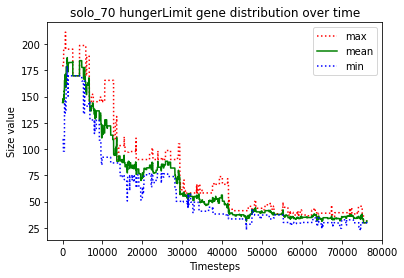





						SOLO_71

predator_9 just gave birth to predator_10
predator_9 killed predator_0
predator_9 killed predator_8
predator_1 just gave birth to predator_11
predator_1 killed predator_11
predator_9 killed predator_3
predator_1 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_12 killed predator_5
predator_10 starved to death
predator_1 ate the carcass of predator_10_carcass
predator_13 just gave birth to predator_15
predator_9 starved to death
predator_14 ate the carcass of predator_9_carcass
predator_13 starved to death
predator_7 ate the carcass of predator_13_carcass
predator_14 starved to death
predator_15 ate the carcass of predator_14_carcass
predator_1 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_1 just gave birth to predator_18
predator_1 just gave birth to predator_19
predator_18 just gave birth to predator_20
predator_17 just gave birth to predator_21
predator_1

predator_65 ate the carcass of predator_63_carcass
predator_46 just gave birth to predator_71
predator_38 just gave birth to predator_72
predator_71 just gave birth to predator_73
predator_67 just gave birth to predator_74
predator_67 just gave birth to predator_75
predator_73 just gave birth to predator_76
predator_71 starved to death
predator_46 killed predator_72
predator_76 starved to death
predator_38 ate the carcass of predator_71_carcass
predator_73 starved to death
predator_67 starved to death
predator_75 starved to death
predator_38 ate the carcass of predator_75_carcass
predator_38 ate the carcass of predator_67_carcass
predator_46 ate the carcass of predator_73_carcass
predator_69 ate the carcass of predator_76_carcass
predator_74 starved to death
predator_38 just gave birth to predator_77
predator_58 ate the carcass of predator_74_carcass
predator_38 just gave birth to predator_78
predator_78 starved to death
predator_58 ate the carcass of predator_78_carcass
predator_77 st

predator_100 just gave birth to predator_129
predator_127 killed predator_129
predator_123 just gave birth to predator_130
predator_130 killed predator_100
predator_123 just gave birth to predator_131
predator_131 starved to death
predator_130 ate the carcass of predator_131_carcass
predator_130 starved to death
predator_113 ate the carcass of predator_130_carcass
predator_113 just gave birth to predator_132
predator_105 just gave birth to predator_133
predator_113 starved to death
predator_132 ate the carcass of predator_113_carcass
predator_123 just gave birth to predator_134
predator_123 killed predator_134
predator_133 just gave birth to predator_135
predator_127 starved to death
predator_135 just gave birth to predator_136
predator_123 just gave birth to predator_137
predator_132 ate the carcass of predator_127_carcass
predator_136 just gave birth to predator_138
predator_105 just gave birth to predator_139
predator_138 starved to death
predator_136 starved to death
predator_133 s

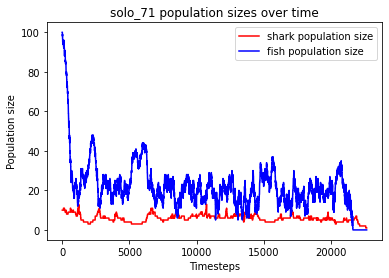

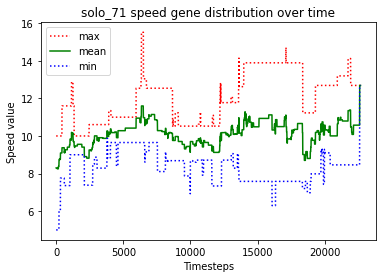

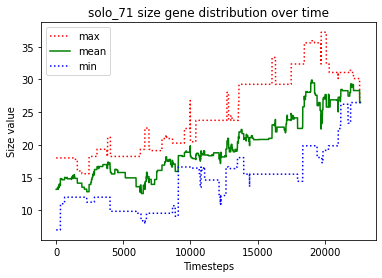

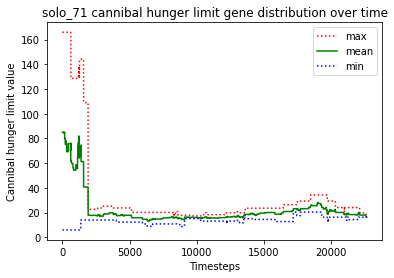

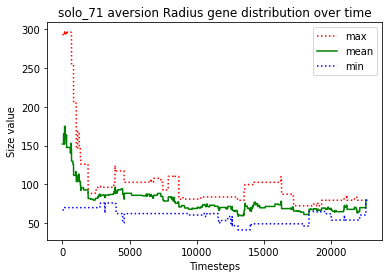

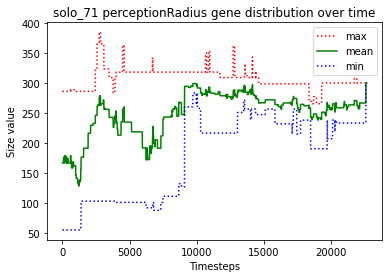

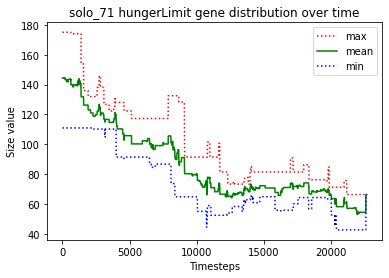





						SOLO_72

predator_3 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_3 killed predator_12
predator_6 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_2 just gave birth to predator_15
predator_10 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_3 starved to death
predator_14 starved to death
predator_1 ate the carcass of predator_14_carcass
predator_6 ate the carcass of predator_3_carcass
predator_10 starved to death
predator_16 starved to death
predator_8 just gave birth to predator_18
predator_13 starved to death
predator_11 ate the carcass of predator_13_carcass
predator_11 ate the carcass of predator_10_carcass
predator_15 starved to death
predator_18 ate the carcass of predator_15_carcass
predator_11 ate the carcass of predator_16_carcass
predator_2 starved to death
predator_8 starved to death
predator_4 ate the carcass of predator_2

predator_51 just gave birth to predator_68
predator_54 just gave birth to predator_69
predator_54 just gave birth to predator_70
predator_65 starved to death
predator_51 ate the carcass of predator_65_carcass
predator_68 starved to death
predator_54 starved to death
predator_62 starved to death
predator_69 ate the carcass of predator_62_carcass
predator_58 ate the carcass of predator_54_carcass
predator_51 ate the carcass of predator_68_carcass
predator_40 just gave birth to predator_71
predator_71 just gave birth to predator_72
predator_69 just gave birth to predator_73
predator_71 starved to death
predator_70 ate the carcass of predator_71_carcass
predator_72 just gave birth to predator_74
predator_74 starved to death
predator_72 starved to death
predator_70 ate the carcass of predator_74_carcass
predator_40 just gave birth to predator_75
predator_51 ate the carcass of predator_72_carcass
predator_75 starved to death
predator_40 starved to death
predator_51 ate the carcass of predato

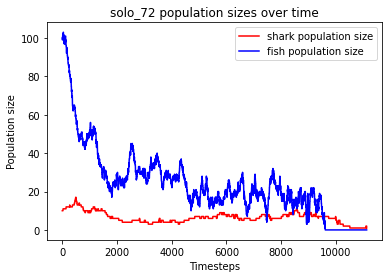

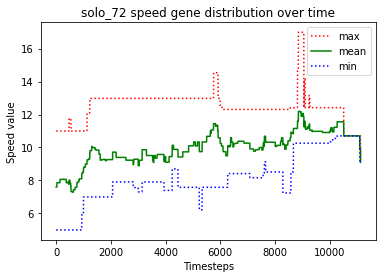

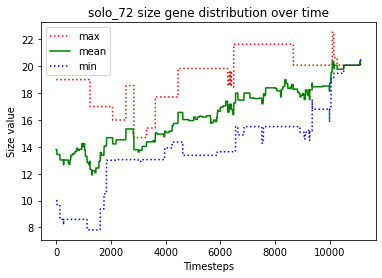

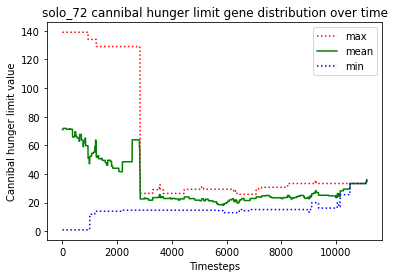

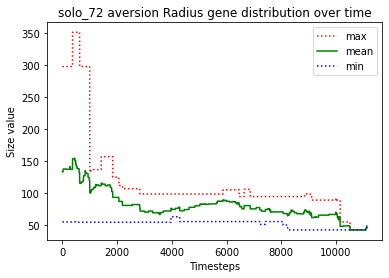

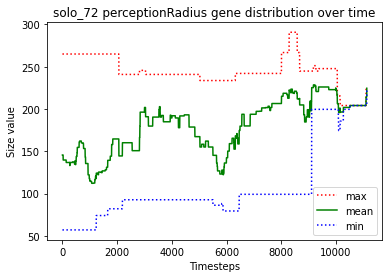

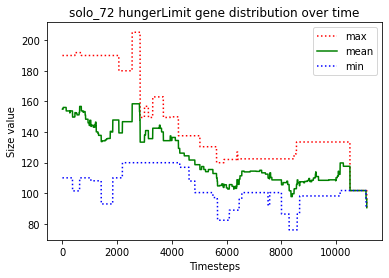





						SOLO_73

predator_3 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_10 killed predator_1
predator_3 just gave birth to predator_14
predator_3 just gave birth to predator_15
predator_14 just gave birth to predator_16
predator_2 killed predator_9
predator_16 just gave birth to predator_17
predator_16 starved to death
predator_17 ate the carcass of predator_16_carcass
predator_5 just gave birth to predator_18
predator_12 starved to death
predator_10 ate the carcass of predator_12_carcass
predator_14 just gave birth to predator_19
predator_10 killed predator_7
predator_15 starved to death
predator_14 starved to death
predator_19 starved to death
predator_10 ate the carcass of predator_19_carcass
predator_3 starved to death
predator_4 ate the carcass of predator_14_carcass
predator_18 ate the carcass of predator_15_carcass
predator_2 just gave birth to predator_20


predator_69 starved to death
predator_49 ate the carcass of predator_69_carcass
predator_66 just gave birth to predator_71
predator_71 just gave birth to predator_72
no fish to move
predator_62 starved to death
predator_45 ate the carcass of predator_62_carcass
predator_45 just gave birth to predator_73
predator_72 starved to death
predator_49 ate the carcass of predator_72_carcass
predator_66 just gave birth to predator_74
predator_66 just gave birth to predator_75
predator_71 starved to death
predator_66 ate the carcass of predator_71_carcass
predator_73 starved to death
predator_66 ate the carcass of predator_73_carcass
predator_68 starved to death
predator_45 starved to death
predator_75 starved to death
predator_49 ate the carcass of predator_68_carcass
predator_47 ate the carcass of predator_75_carcass
predator_74 starved to death
predator_49 ate the carcass of predator_45_carcass
predator_47 starved to death
predator_66 ate the carcass of predator_74_carcass
predator_49 ate the 

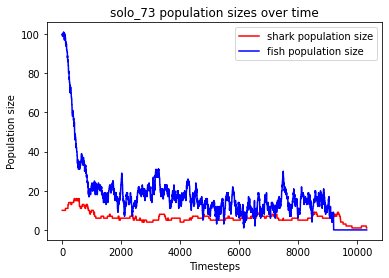

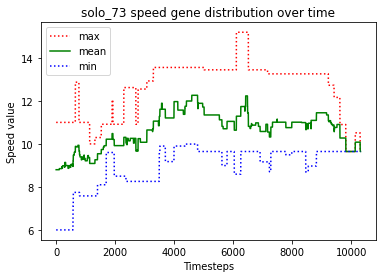

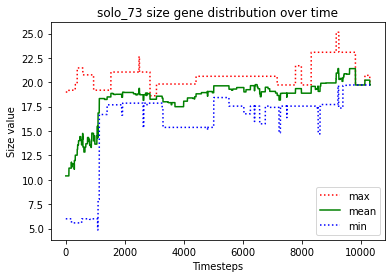

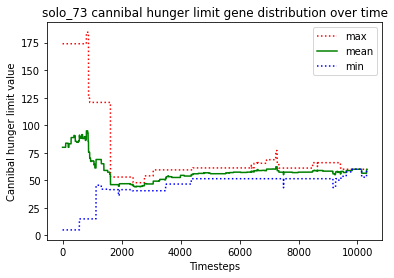

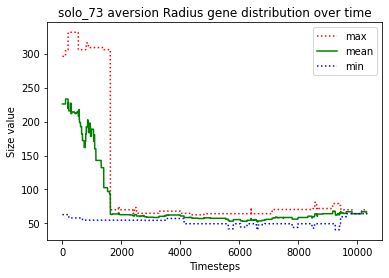

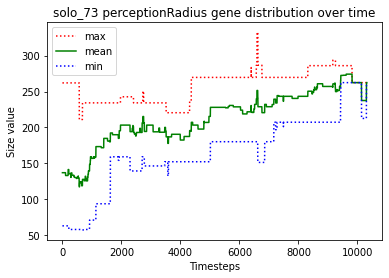

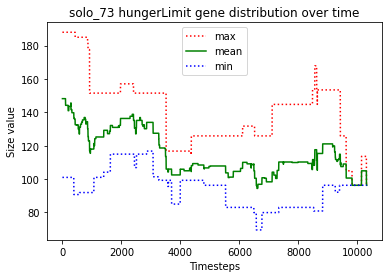





						SOLO_74

predator_3 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_10 starved to death
predator_5 ate the carcass of predator_10_carcass
predator_14 just gave birth to predator_15
predator_14 starved to death
predator_15 ate the carcass of predator_14_carcass
predator_4 just gave birth to predator_16
predator_13 just gave birth to predator_17
predator_13 just gave birth to predator_18
predator_12 starved to death
predator_15 starved to death
predator_9 ate the carcass of predator_12_carcass
predator_3 starved to death
predator_1 starved to death
predator_8 starved to death
predator_4 ate the carcass of predator_15_carcass
predator_17 just gave birth to predator_19
predator_16 starved to death
predator_4 ate the carcass of predator_1_carcass
predator_18 killed predator_6
predator_2 ate the carcass of predator_16_carcas

predator_43 ate the carcass of predator_56_carcass
predator_68 starved to death
predator_58 ate the carcass of predator_68_carcass
predator_49 starved to death
predator_58 ate the carcass of predator_49_carcass
predator_61 ate the carcass of predator_36_carcass
predator_67 starved to death
predator_58 ate the carcass of predator_67_carcass
predator_43 ate the carcass of predator_70_carcass
predator_43 ate the carcass of predator_48_carcass
predator_61 starved to death
predator_43 just gave birth to predator_72
predator_58 ate the carcass of predator_61_carcass
predator_43 starved to death
predator_72 starved to death
predator_58 ate the carcass of predator_43_carcass
predator_58 just gave birth to predator_73
predator_58 starved to death
predator_73 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 74
Timesteps passed: 11931
Fish went extinct at timestep 9946
Sharks went extinct at timestep 11931


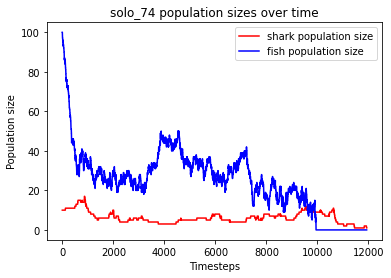

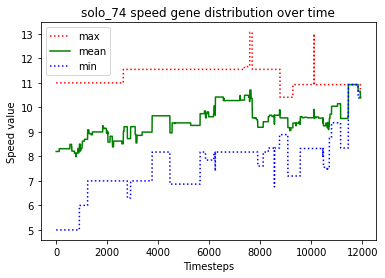

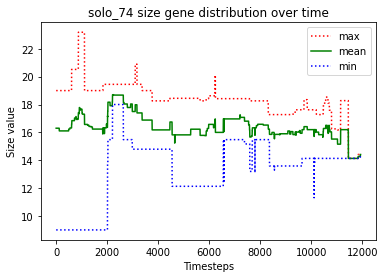

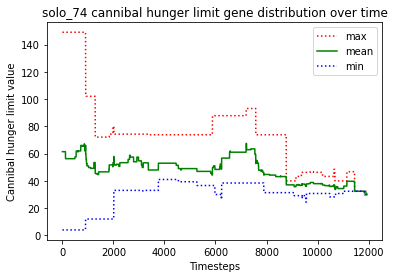

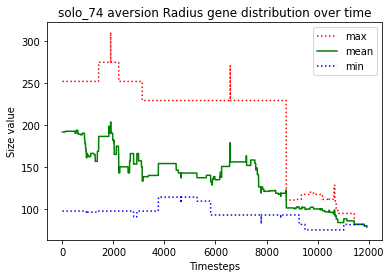

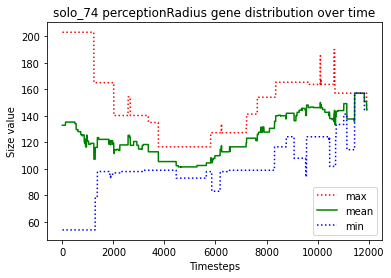

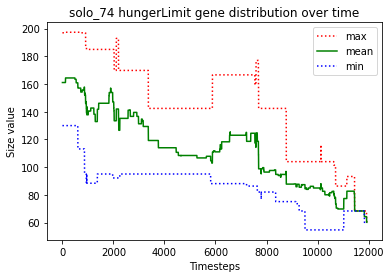





						SOLO_75

predator_4 killed predator_7
predator_4 killed predator_5
predator_6 just gave birth to predator_10
predator_6 killed predator_0
predator_2 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_6 killed predator_9
predator_11 starved to death
predator_14 ate the carcass of predator_11_carcass
predator_8 killed predator_1
predator_12 starved to death
predator_6 ate the carcass of predator_12_carcass
predator_3 just gave birth to predator_15
predator_10 just gave birth to predator_16
predator_16 killed predator_8
predator_3 just gave birth to predator_17
predator_13 starved to death
predator_2 ate the carcass of predator_13_carcass
predator_4 just gave birth to predator_18
predator_3 just gave birth to predator_19
predator_16 just gave birth to predator_20
predator_4 just gave birth to predator_21
predator_14 starved to death
predator_19 starved to death
pr

predator_63 just gave birth to predator_74
predator_67 starved to death
predator_73 starved to death
predator_62 ate the carcass of predator_67_carcass
predator_72 just gave birth to predator_75
predator_71 ate the carcass of predator_73_carcass
predator_72 killed predator_68
predator_75 killed predator_71
predator_74 killed predator_65
predator_63 starved to death
predator_62 just gave birth to predator_76
predator_72 ate the carcass of predator_63_carcass
predator_75 killed predator_62
predator_58 just gave birth to predator_77
predator_75 killed predator_76
predator_72 just gave birth to predator_78
predator_74 just gave birth to predator_79
predator_74 killed predator_79
predator_70 just gave birth to predator_80
predator_75 starved to death
predator_58 starved to death
predator_80 ate the carcass of predator_58_carcass
predator_78 ate the carcass of predator_75_carcass
predator_74 starved to death
predator_70 ate the carcass of predator_74_carcass
predator_78 just gave birth to pr

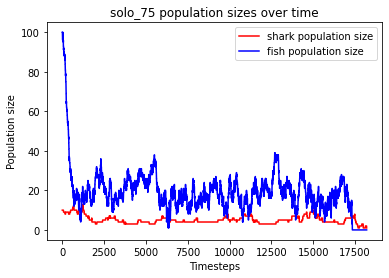

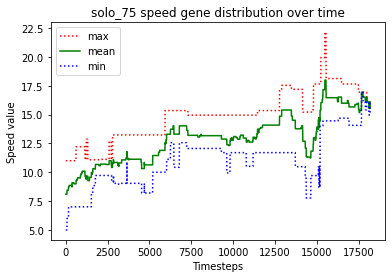

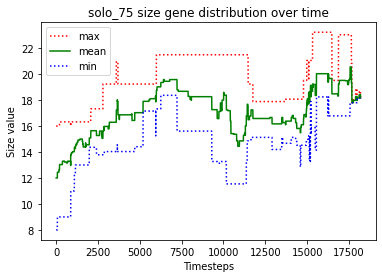

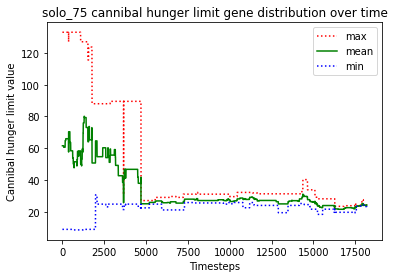

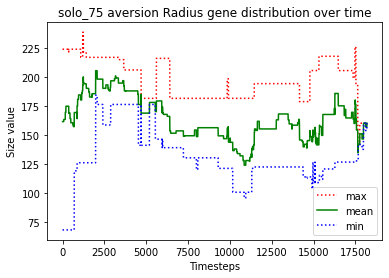

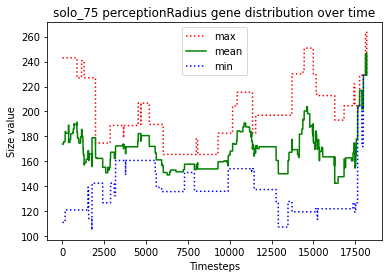

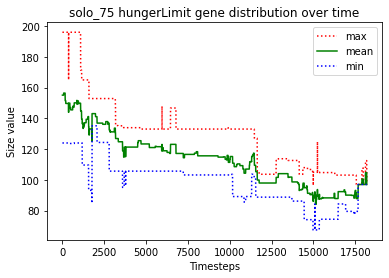





						SOLO_76

predator_9 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_1 just gave birth to predator_14
predator_11 killed predator_10
predator_0 just gave birth to predator_15
predator_3 just gave birth to predator_16
predator_13 starved to death
predator_15 killed predator_9
predator_7 just gave birth to predator_17
predator_4 ate the carcass of predator_13_carcass
predator_11 starved to death
predator_14 ate the carcass of predator_11_carcass
predator_7 starved to death
predator_2 ate the carcass of predator_7_carcass
predator_17 starved to death
predator_1 just gave birth to predator_18
predator_2 ate the carcass of predator_17_carcass
predator_18 starved to death
predator_1 starved to death
predator_3 ate the carcass of predator_18_carcass
predator_12 just gave birth to predator_19
predator_12 killed predator_19
predator_4 ate the carcass of predator_1_carc

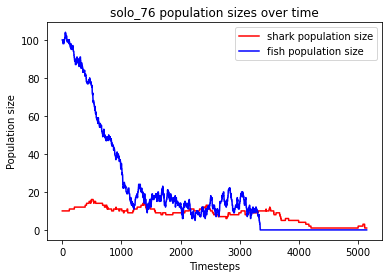

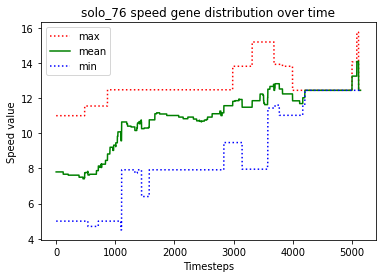

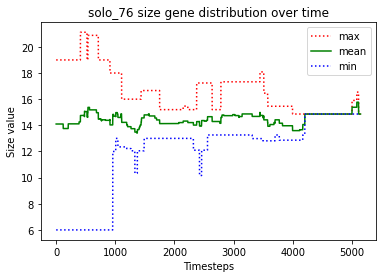

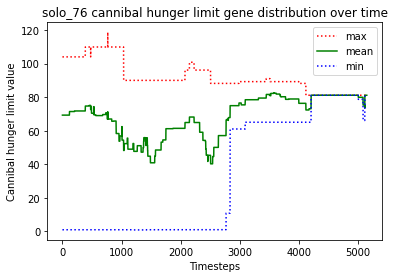

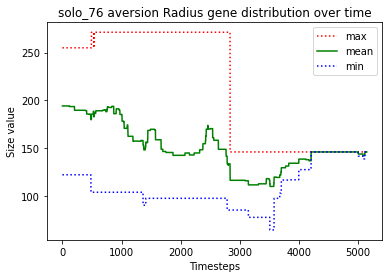

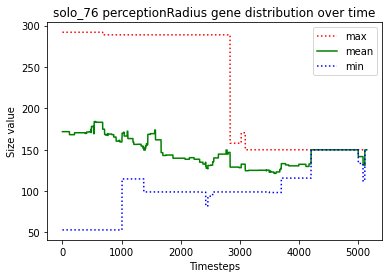

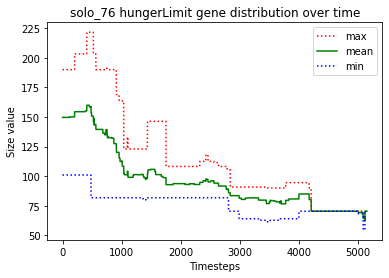





						SOLO_77

predator_3 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_10 killed predator_5
predator_2 just gave birth to predator_13
predator_3 killed predator_11
predator_10 killed predator_7
predator_13 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_10 killed predator_15
predator_1 just gave birth to predator_16
predator_10 just gave birth to predator_17
predator_3 just gave birth to predator_18
predator_13 starved to death
predator_14 starved to death
predator_4 starved to death
predator_8 ate the carcass of predator_14_carcass
predator_8 ate the carcass of predator_4_carcass
predator_17 just gave birth to predator_19
predator_12 just gave birth to predator_20
predator_3 starved to death
predator_0 ate the carcass of predator_13_carcass
predator_18 starved to death
predator_17 starved to death
predator_12 just gave birth to predator_21
predator_10 just gave birth t

predator_64 ate the carcass of predator_68_carcass
predator_67 starved to death
predator_60 ate the carcass of predator_67_carcass
predator_35 starved to death
predator_64 ate the carcass of predator_35_carcass
predator_70 just gave birth to predator_71
predator_71 starved to death
predator_60 ate the carcass of predator_71_carcass
predator_70 starved to death
predator_26 ate the carcass of predator_70_carcass
predator_69 just gave birth to predator_72
predator_69 just gave birth to predator_73
predator_72 starved to death
predator_55 just gave birth to predator_74
predator_60 ate the carcass of predator_72_carcass
predator_69 starved to death
predator_60 ate the carcass of predator_69_carcass
predator_74 just gave birth to predator_75
predator_74 just gave birth to predator_76
predator_76 starved to death
predator_74 starved to death
predator_26 ate the carcass of predator_76_carcass
predator_26 ate the carcass of predator_74_carcass
predator_75 starved to death
predator_61 just gave 

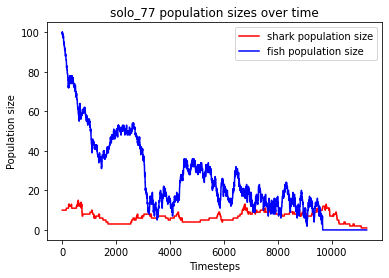

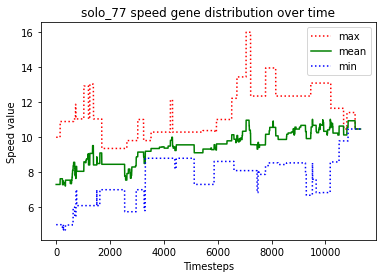

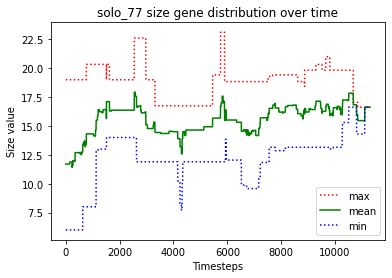

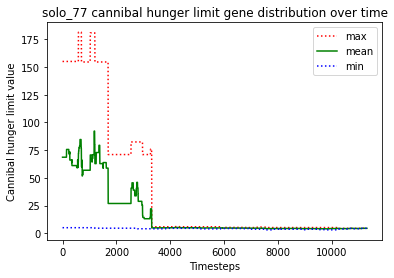

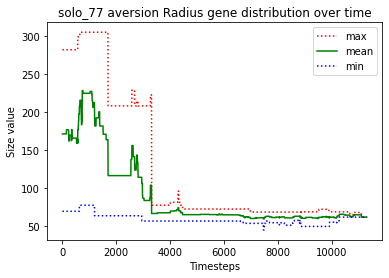

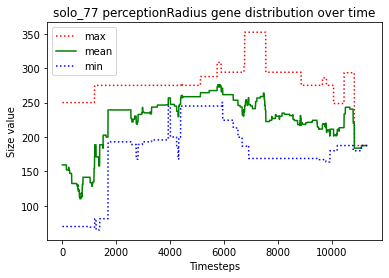

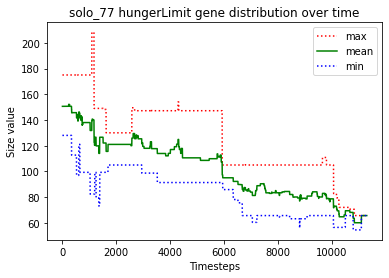





						SOLO_78

predator_3 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_11 killed predator_5
predator_3 just gave birth to predator_14
predator_13 just gave birth to predator_15
predator_2 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_15 starved to death
predator_3 ate the carcass of predator_15_carcass
predator_13 starved to death
predator_10 ate the carcass of predator_13_carcass
predator_8 just gave birth to predator_18
predator_10 just gave birth to predator_19
predator_9 starved to death
predator_6 starved to death
predator_17 just gave birth to predator_20
predator_20 starved to death
predator_3 ate the carcass of predator_6_carcass
predator_14 ate the carcass of predator_9_carcass
predator_19 ate the carcass of predator_20_carcass
predator_14 killed predator_1
predator_18 just gave birth to predator_21
predator_16 starve

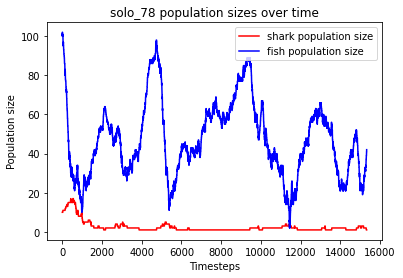

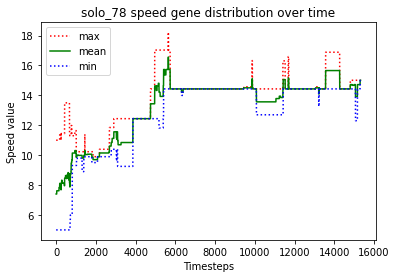

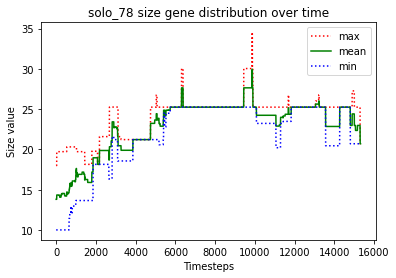

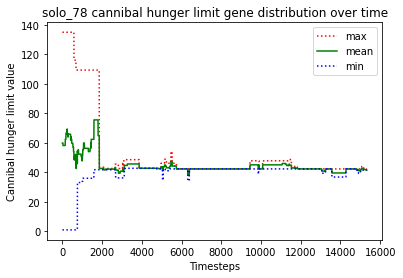

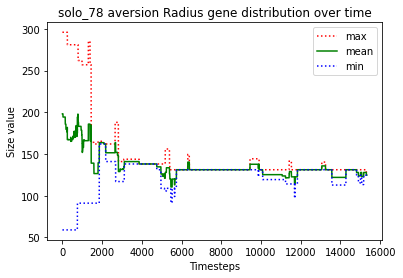

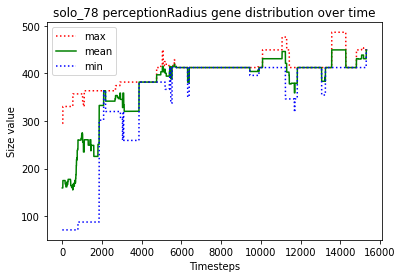

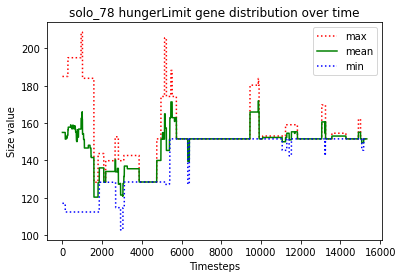





						SOLO_79

predator_5 killed predator_3
predator_5 killed predator_8
predator_2 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_10 starved to death
predator_12 starved to death
predator_2 ate the carcass of predator_10_carcass
predator_2 ate the carcass of predator_12_carcass
predator_11 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_2 starved to death
predator_5 killed predator_7
predator_6 ate the carcass of predator_2_carcass
predator_5 killed predator_9
predator_0 just gave birth to predator_15
predator_14 starved to death
predator_5 just gave birth to predator_16
predator_13 ate the carcass of predator_14_carcass
predator_13 killed predator_1
predator_15 just gave birth to predator_17
predator_17 starved to death
predator_15 starved to death
predator_0 ate the carcass of predator_15_carcass
predator_16 ate the carcass of predator_17_carcass
predator_0 starved to

predator_71 ate the carcass of predator_66_carcass
predator_43 starved to death
predator_70 starved to death
predator_42 ate the carcass of predator_70_carcass
predator_59 starved to death
predator_71 ate the carcass of predator_69_carcass
predator_71 ate the carcass of predator_59_carcass
predator_57 ate the carcass of predator_43_carcass
predator_42 starved to death
predator_71 ate the carcass of predator_42_carcass
predator_57 starved to death
predator_71 just gave birth to predator_72
predator_71 killed predator_72
predator_71 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 73
Timesteps passed: 12840
Fish went extinct at timestep 12111
Sharks went extinct at timestep 12840


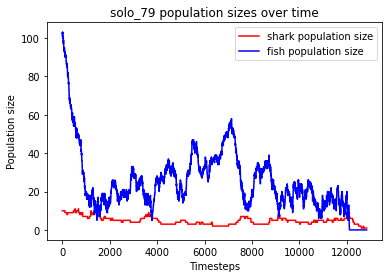

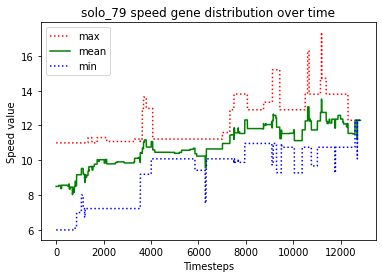

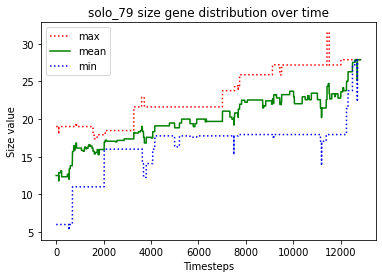

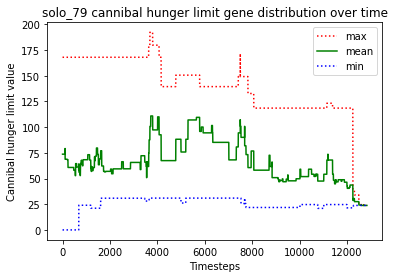

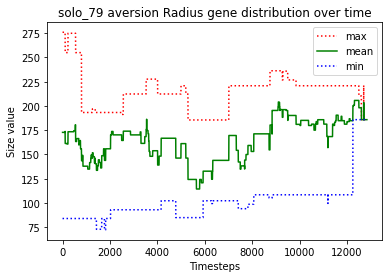

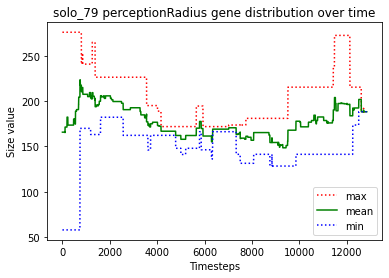

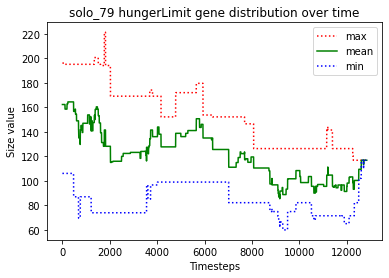





						SOLO_80

predator_1 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_1 killed predator_11
predator_1 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_1 starved to death
predator_2 just gave birth to predator_14
predator_5 ate the carcass of predator_1_carcass
predator_12 starved to death
predator_2 killed predator_0
predator_14 killed predator_9
predator_3 ate the carcass of predator_12_carcass
predator_5 just gave birth to predator_15
predator_10 starved to death
predator_8 ate the carcass of predator_10_carcass
predator_5 killed predator_13
predator_6 just gave birth to predator_16
predator_2 just gave birth to predator_17
predator_17 starved to death
predator_6 ate the carcass of predator_17_carcass
predator_14 starved to death
predator_8 starved to death
predator_4 ate the carcass of predator_14_carcass
predator_2 starved to death
predator_16 just gave birth to predator_18
predator_6 ate the carcass of pred

predator_62 just gave birth to predator_68
predator_67 starved to death
predator_68 ate the carcass of predator_67_carcass
predator_66 just gave birth to predator_69
predator_66 starved to death
predator_56 just gave birth to predator_70
predator_62 ate the carcass of predator_66_carcass
predator_69 starved to death
predator_56 killed predator_68
predator_64 just gave birth to predator_71
predator_70 starved to death
predator_62 ate the carcass of predator_69_carcass
predator_71 ate the carcass of predator_70_carcass
predator_62 just gave birth to predator_72
predator_56 just gave birth to predator_73
predator_64 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_75 starved to death
predator_73 ate the carcass of predator_75_carcass
predator_56 just gave birth to predator_76
predator_76 starved to death
predator_56 starved to death
predator_62 just gave birth to predator_77
predator_64 ate the carcass of predator_56_carcass
predator_77 just gave birth to

predator_113 starved to death
predator_96 ate the carcass of predator_125_carcass
predator_127 starved to death
predator_117 ate the carcass of predator_127_carcass
predator_87 ate the carcass of predator_106_carcass
predator_87 ate the carcass of predator_112_carcass
predator_117 starved to death
predator_87 ate the carcass of predator_117_carcass
predator_122 starved to death
predator_96 starved to death
predator_87 ate the carcass of predator_122_carcass
predator_87 just gave birth to predator_128
predator_87 ate the carcass of predator_113_carcass
predator_87 just gave birth to predator_129
predator_128 ate the carcass of predator_96_carcass
predator_87 starved to death
predator_129 starved to death
predator_128 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 130
Timesteps passed: 23512
Fish went extinct at timestep 21613
Sharks went extinct at timestep 23512


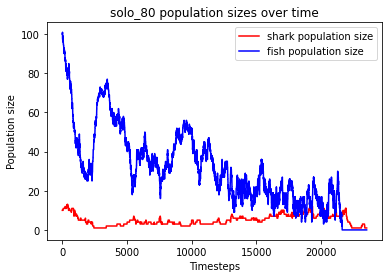

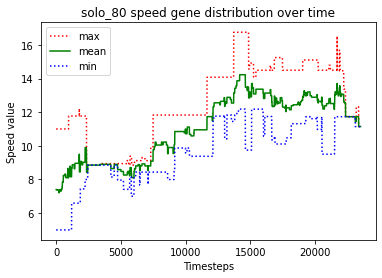

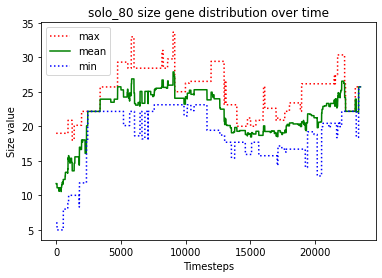

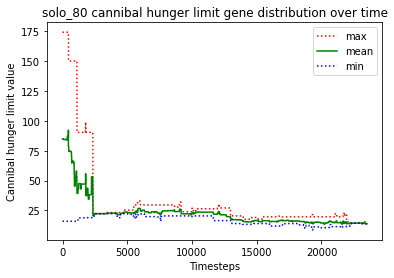

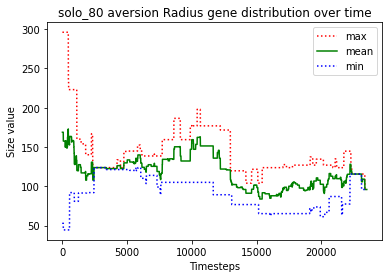

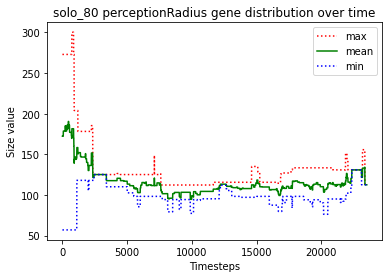

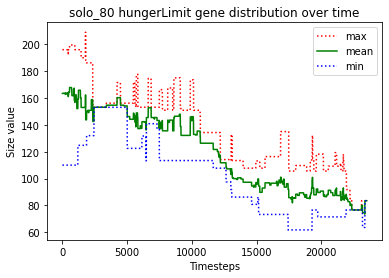





						SOLO_81

predator_5 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_2 killed predator_9
predator_2 just gave birth to predator_14
predator_14 killed predator_5
predator_14 killed predator_1
predator_2 killed predator_10
predator_13 just gave birth to predator_15
predator_8 just gave birth to predator_16
predator_2 killed predator_4
predator_14 killed predator_6
predator_0 just gave birth to predator_17
predator_2 killed predator_11
predator_13 starved to death
predator_14 ate the carcass of predator_13_carcass
predator_15 starved to death
predator_14 killed predator_7
predator_2 killed predator_16
predator_12 ate the carcass of predator_15_carcass
predator_8 starved to death
predator_0 ate the carcass of predator_8_carcass
predator_17 starved to death
predator_2 ate the carcass of predator_17_carcass
predator_0 starved to death
predator_14 ate the carcass of p

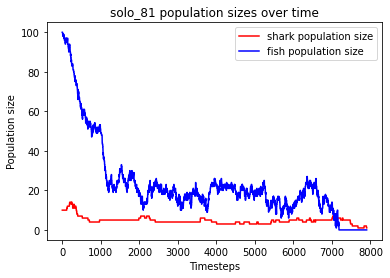

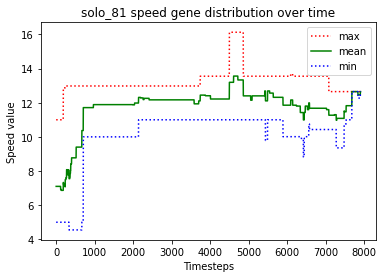

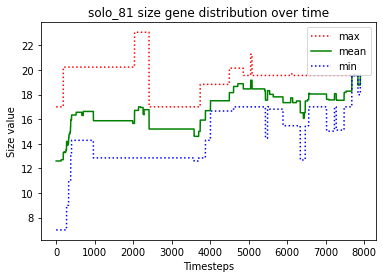

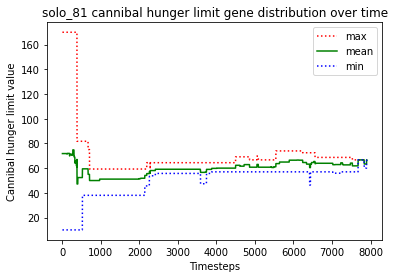

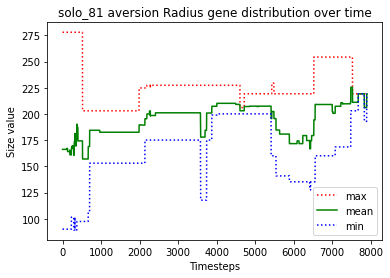

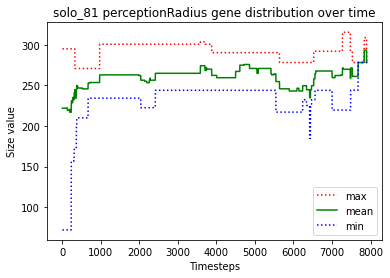

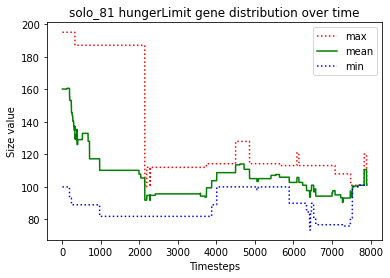





						SOLO_82

predator_6 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_13 starved to death
predator_6 starved to death
predator_5 just gave birth to predator_14
predator_3 ate the carcass of predator_6_carcass
predator_3 ate the carcass of predator_13_carcass
predator_8 just gave birth to predator_15
predator_15 just gave birth to predator_16
predator_10 starved to death
predator_3 just gave birth to predator_17
predator_8 ate the carcass of predator_10_carcass
predator_12 starved to death
predator_16 ate the carcass of predator_12_carcass
predator_15 just gave birth to predator_18
predator_3 just gave birth to predator_19
predator_16 just gave birth to predator_20
predator_15 starved to death
predator_18 starved to death
predator_3 starved to death
predator_19 starved to death
predator_9 ate the carcass of predator_18_carcass
predator_7 ate the carcass of predat

predator_69 just gave birth to predator_71
predator_68 starved to death
predator_70 ate the carcass of predator_68_carcass
predator_62 just gave birth to predator_72
predator_69 ate the carcass of predator_60_carcass
predator_71 starved to death
predator_69 ate the carcass of predator_61_carcass
predator_72 ate the carcass of predator_71_carcass
predator_72 killed predator_55
predator_70 just gave birth to predator_73
predator_70 just gave birth to predator_74
predator_62 starved to death
predator_70 ate the carcass of predator_62_carcass
predator_67 starved to death
predator_66 ate the carcass of predator_67_carcass
predator_37 starved to death
predator_72 starved to death
predator_69 ate the carcass of predator_72_carcass
predator_69 just gave birth to predator_75
predator_70 starved to death
predator_66 ate the carcass of predator_70_carcass
predator_66 ate the carcass of predator_37_carcass
predator_73 just gave birth to predator_76
predator_73 starved to death
predator_76 starved 

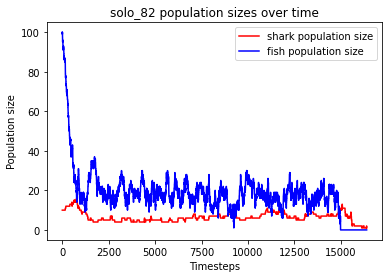

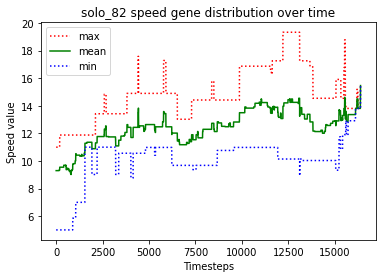

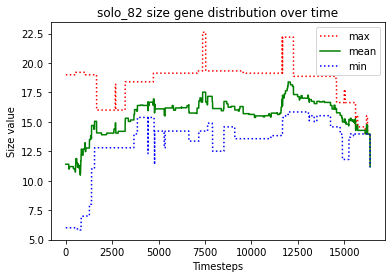

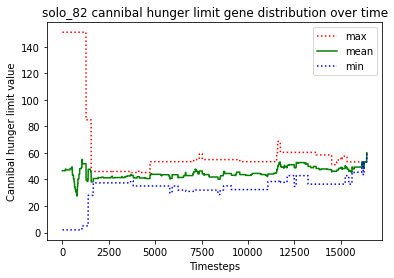

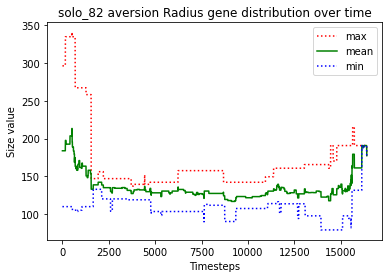

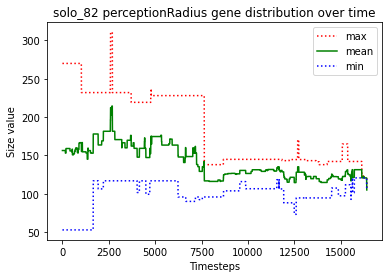

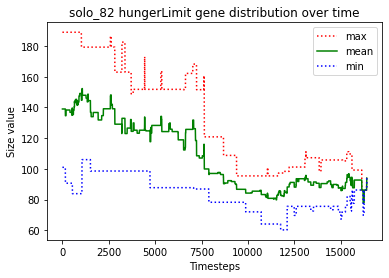





						SOLO_83

predator_5 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_1 just gave birth to predator_14
predator_7 killed predator_13
predator_1 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_1 killed predator_2
predator_15 killed predator_16
predator_12 starved to death
predator_7 just gave birth to predator_17
predator_0 just gave birth to predator_18
predator_7 just gave birth to predator_19
predator_3 just gave birth to predator_20
predator_3 ate the carcass of predator_12_carcass
predator_7 killed predator_6
predator_20 starved to death
predator_19 ate the carcass of predator_20_carcass
predator_17 killed predator_8
predator_1 starved to death
predator_3 starved to death
predator_10 just gave birth to predator_21
predator_21 killed predator_5
predator_11 ate the carcass of predator_1_carcass
predator_15 ate the carcass of p

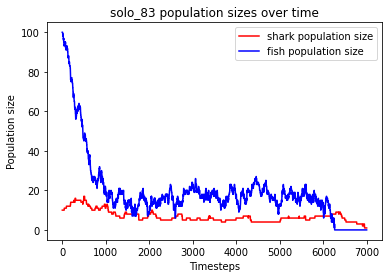

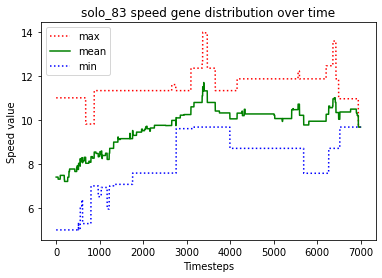

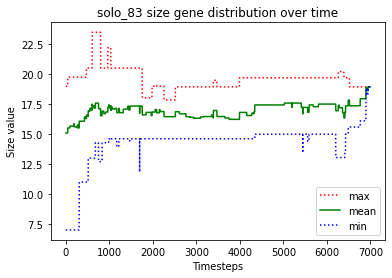

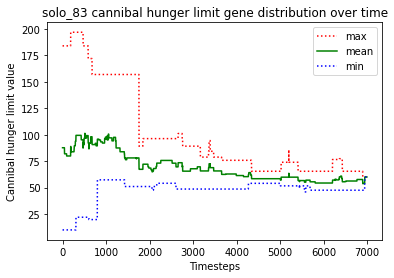

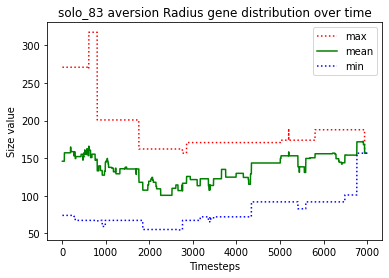

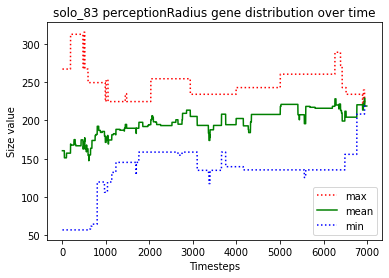

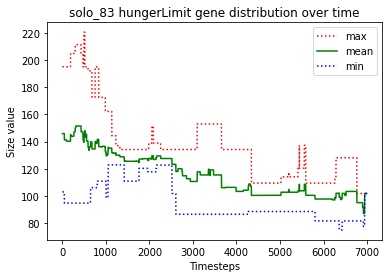





						SOLO_84

predator_4 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_8 just gave birth to predator_16
predator_16 killed predator_6
predator_2 starved to death
predator_13 starved to death
predator_7 ate the carcass of predator_2_carcass
predator_4 ate the carcass of predator_13_carcass
predator_5 starved to death
predator_4 ate the carcass of predator_5_carcass
predator_14 starved to death
predator_11 starved to death
predator_8 starved to death
predator_10 ate the carcass of predator_11_carcass
predator_3 starved to death
predator_9 ate the carcass of predator_14_carcass
predator_15 ate the carcass of predator_8_carcass
predator_7 ate the carcass of predator_3_carcass
predator_0 just gave birth to predator_17
predator_17 starved to death
predator_0 starved to death
predator_1

predator_70 killed predator_66
predator_56 just gave birth to predator_72
predator_68 just gave birth to predator_73
predator_69 starved to death
predator_70 killed predator_68
no fish to move
predator_72 starved to death
predator_70 ate the carcass of predator_72_carcass
predator_56 ate the carcass of predator_69_carcass
predator_70 starved to death
predator_71 ate the carcass of predator_70_carcass
predator_56 starved to death
predator_71 ate the carcass of predator_56_carcass
predator_73 starved to death
predator_62 just gave birth to predator_74
predator_67 ate the carcass of predator_73_carcass
predator_67 killed predator_74
predator_67 just gave birth to predator_75
predator_67 starved to death
predator_75 starved to death
predator_71 ate the carcass of predator_75_carcass
predator_71 ate the carcass of predator_67_carcass
predator_62 starved to death
predator_71 ate the carcass of predator_62_carcass
predator_71 starved to death


finished this run because predators went extinct

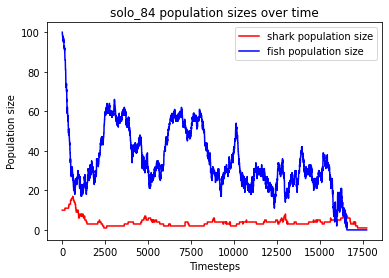

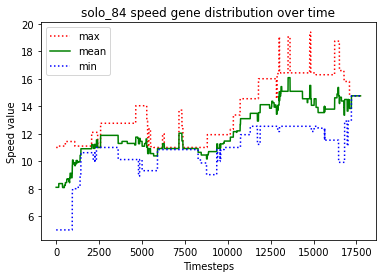

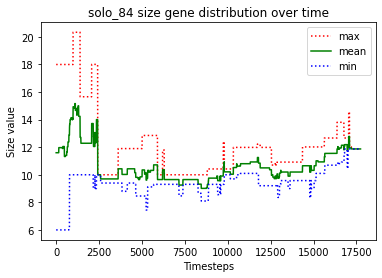

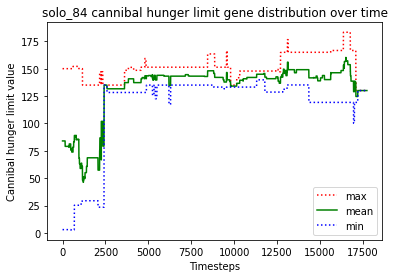

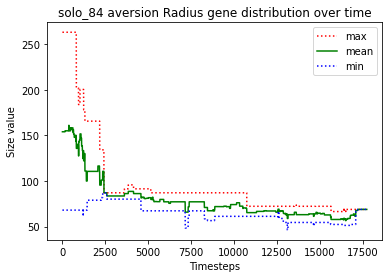

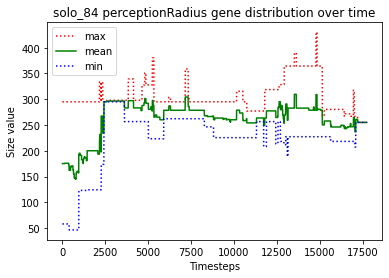

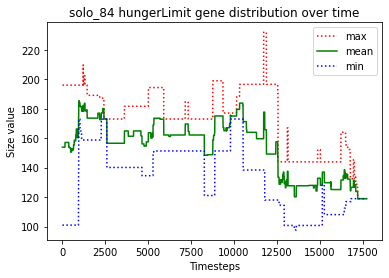





						SOLO_85

predator_6 just gave birth to predator_10
predator_10 killed predator_4
predator_10 killed predator_5
predator_6 killed predator_2
predator_9 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_11 killed predator_3
predator_12 starved to death
predator_10 just gave birth to predator_13
predator_1 ate the carcass of predator_12_carcass
predator_11 just gave birth to predator_14
predator_6 just gave birth to predator_15
predator_9 starved to death
predator_15 ate the carcass of predator_9_carcass
no fish to move
predator_11 starved to death
predator_6 ate the carcass of predator_11_carcass
predator_14 starved to death
predator_10 ate the carcass of predator_14_carcass
predator_15 just gave birth to predator_16
predator_7 killed predator_0
predator_15 just gave birth to predator_17
predator_17 starved to death
predator_15 starved to death
predator_16 starved to death
predator_13 ate the carcass of predator_17_carcass
predator_13 ate the car

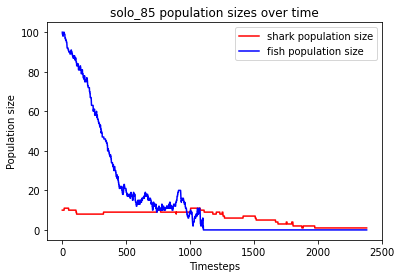

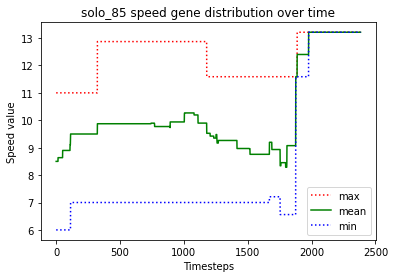

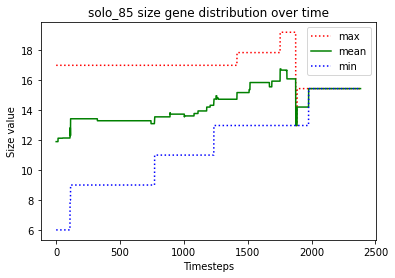

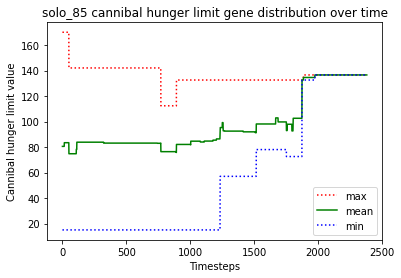

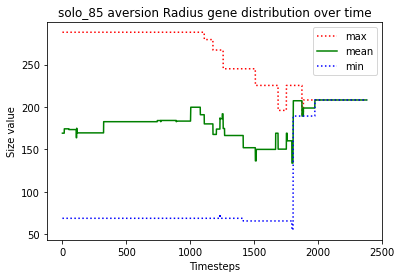

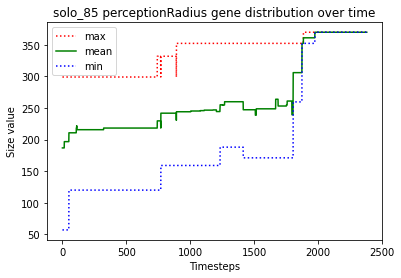

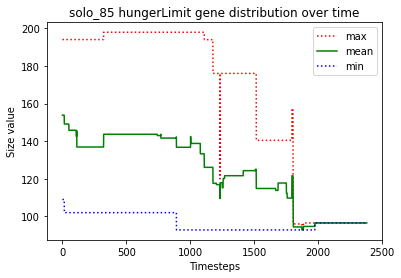





						SOLO_86

predator_8 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_10 starved to death
predator_1 ate the carcass of predator_10_carcass
predator_7 killed predator_2
predator_8 starved to death
predator_1 ate the carcass of predator_8_carcass
predator_6 just gave birth to predator_12
predator_6 killed predator_1
predator_4 just gave birth to predator_13
predator_6 killed predator_7
predator_13 just gave birth to predator_14
predator_13 just gave birth to predator_15
predator_13 starved to death
predator_15 starved to death
predator_12 ate the carcass of predator_13_carcass
predator_12 ate the carcass of predator_15_carcass
predator_14 starved to death
predator_4 ate the carcass of predator_14_carcass
predator_6 killed predator_11
predator_9 just gave birth to predator_16
predator_12 killed predator_3
predator_9 starved to death
predator_12 ate the carcass of predator_9_carcass
predator_16 starved to death
predator_4 starved to death
predator

predator_59 just gave birth to predator_71
predator_71 just gave birth to predator_72
predator_71 starved to death
predator_72 starved to death
predator_45 ate the carcass of predator_72_carcass
predator_69 ate the carcass of predator_71_carcass
predator_59 starved to death
predator_69 ate the carcass of predator_59_carcass
predator_68 just gave birth to predator_73
predator_73 killed predator_45
predator_73 just gave birth to predator_74
predator_69 just gave birth to predator_75
predator_68 just gave birth to predator_76
predator_74 starved to death
predator_75 ate the carcass of predator_74_carcass
predator_68 just gave birth to predator_77
predator_77 just gave birth to predator_78
predator_69 just gave birth to predator_79
predator_77 starved to death
predator_78 starved to death
predator_68 ate the carcass of predator_77_carcass
predator_73 starved to death
predator_79 just gave birth to predator_80
predator_80 ate the carcass of predator_73_carcass
predator_76 ate the carcass of

predator_134 starved to death
predator_124 starved to death
predator_125 ate the carcass of predator_124_carcass
predator_123 starved to death
predator_121 ate the carcass of predator_123_carcass
predator_125 just gave birth to predator_136
predator_121 killed predator_136
predator_121 just gave birth to predator_137
predator_137 ate the carcass of predator_134_carcass
predator_125 just gave birth to predator_138
predator_121 just gave birth to predator_139
predator_138 just gave birth to predator_140
predator_121 killed predator_140
predator_138 just gave birth to predator_141
predator_121 just gave birth to predator_142
predator_142 just gave birth to predator_143
predator_139 just gave birth to predator_144
predator_142 starved to death
predator_121 ate the carcass of predator_142_carcass
predator_143 starved to death
predator_121 just gave birth to predator_145
predator_145 ate the carcass of predator_143_carcass
predator_144 starved to death
predator_137 ate the carcass of predato

predator_192 ate the carcass of predator_191_carcass
predator_192 just gave birth to predator_195
predator_192 just gave birth to predator_196
predator_196 starved to death
predator_195 starved to death
predator_188 ate the carcass of predator_196_carcass
predator_188 ate the carcass of predator_195_carcass
predator_192 just gave birth to predator_197
predator_197 just gave birth to predator_198
predator_197 starved to death
predator_198 starved to death
predator_192 ate the carcass of predator_197_carcass
predator_185 ate the carcass of predator_198_carcass
predator_178 just gave birth to predator_199
predator_188 just gave birth to predator_200
predator_183 just gave birth to predator_201
predator_201 killed predator_199
predator_178 starved to death
predator_201 ate the carcass of predator_178_carcass
predator_183 just gave birth to predator_202
predator_183 starved to death
predator_202 starved to death
predator_188 starved to death
predator_185 ate the carcass of predator_202_carc

predator_246 just gave birth to predator_254
predator_253 just gave birth to predator_255
predator_253 just gave birth to predator_256
predator_256 starved to death
predator_253 starved to death
predator_254 just gave birth to predator_257
predator_257 starved to death
predator_254 starved to death
predator_240 ate the carcass of predator_256_carcass
predator_255 ate the carcass of predator_257_carcass
predator_240 ate the carcass of predator_253_carcass
predator_255 ate the carcass of predator_254_carcass
predator_240 just gave birth to predator_258
predator_244 just gave birth to predator_259
predator_244 just gave birth to predator_260
predator_259 just gave birth to predator_261
predator_245 killed predator_261
predator_258 starved to death
predator_244 ate the carcass of predator_258_carcass
predator_260 starved to death
predator_240 just gave birth to predator_262
predator_245 just gave birth to predator_263
predator_244 ate the carcass of predator_260_carcass
predator_245 starve

predator_312 starved to death
predator_307 ate the carcass of predator_312_carcass
predator_310 starved to death
predator_307 just gave birth to predator_314
predator_314 ate the carcass of predator_310_carcass
predator_307 starved to death
predator_313 ate the carcass of predator_307_carcass
predator_314 just gave birth to predator_315
predator_315 starved to death
predator_314 starved to death
predator_292 ate the carcass of predator_315_carcass
predator_311 ate the carcass of predator_314_carcass
predator_313 just gave birth to predator_316
predator_292 just gave birth to predator_317
predator_311 just gave birth to predator_318
predator_311 starved to death
predator_318 starved to death
predator_313 ate the carcass of predator_311_carcass
predator_316 ate the carcass of predator_318_carcass
predator_313 just gave birth to predator_319
predator_292 just gave birth to predator_320
predator_319 killed predator_317
predator_313 just gave birth to predator_321
predator_320 starved to de

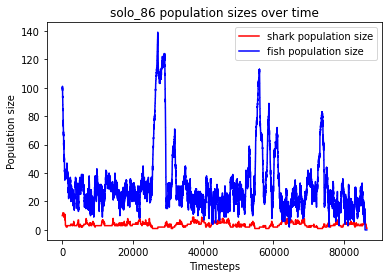

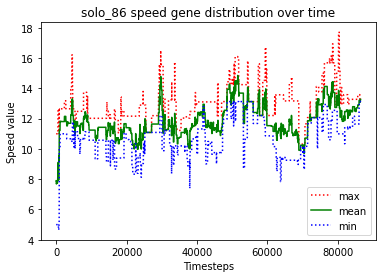

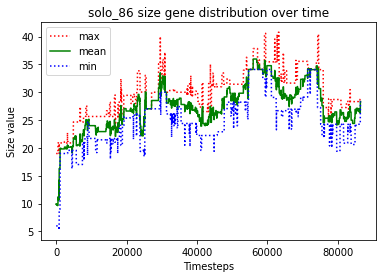

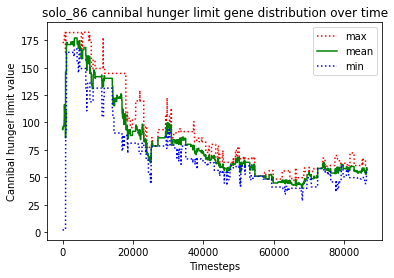

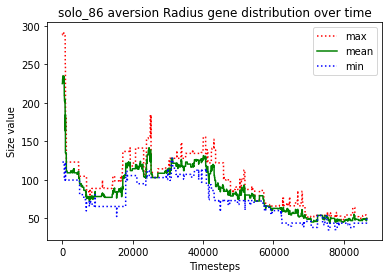

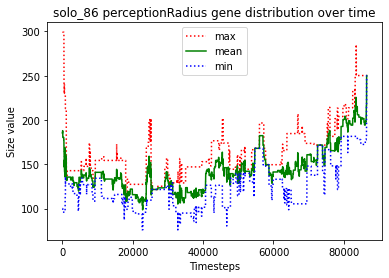

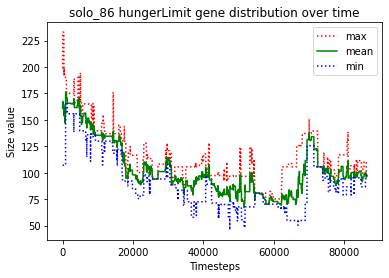





						SOLO_87

predator_7 just gave birth to predator_10
predator_7 killed predator_1
predator_6 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_12 killed predator_3
predator_2 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_14 killed predator_2
predator_7 just gave birth to predator_15
predator_12 killed predator_6
predator_15 starved to death
predator_13 just gave birth to predator_16
predator_13 starved to death
predator_14 starved to death
predator_16 starved to death
predator_7 ate the carcass of predator_15_carcass
predator_9 just gave birth to predator_17
predator_8 ate the carcass of predator_14_carcass
predator_8 ate the carcass of predator_13_carcass
predator_0 ate the carcass of predator_16_carcass
predator_0 killed predator_8
predator_11 just gave birth to predator_18
predator_7 starved to death
predator_5 ate the carcass of

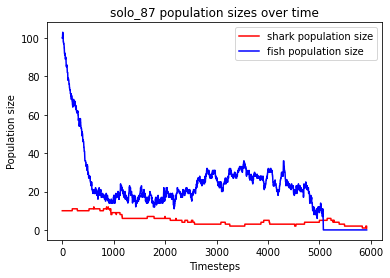

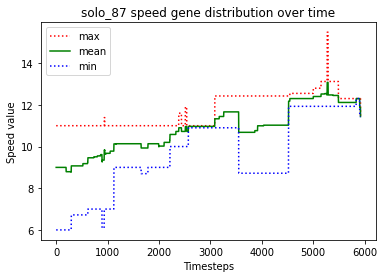

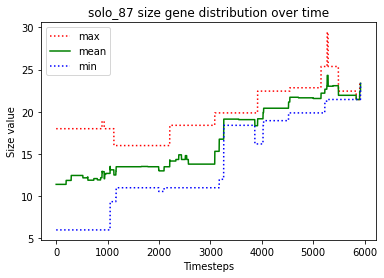

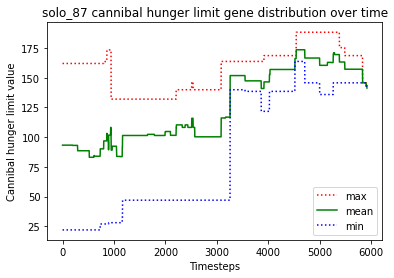

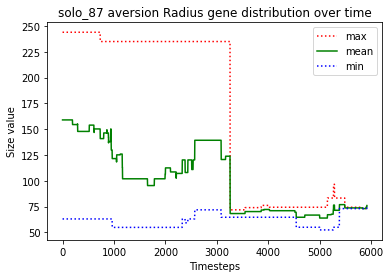

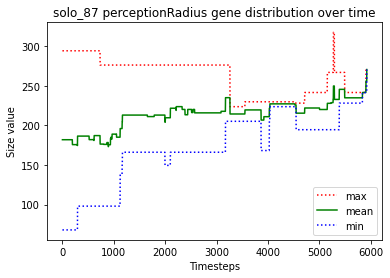

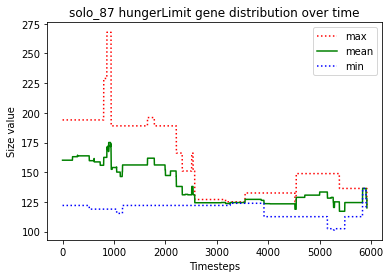





						SOLO_88

predator_4 just gave birth to predator_10
predator_9 killed predator_3
predator_5 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_9 killed predator_10
predator_7 just gave birth to predator_13
predator_9 killed predator_12
predator_11 starved to death
predator_8 ate the carcass of predator_11_carcass
predator_2 killed predator_4
predator_9 killed predator_8
predator_5 starved to death
predator_6 ate the carcass of predator_5_carcass
predator_0 just gave birth to predator_14
predator_9 killed predator_13
predator_9 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_1 killed predator_16
predator_1 just gave birth to predator_17
predator_1 killed predator_7
predator_14 starved to death
predator_15 ate the carcass of predator_14_carcass
predator_0 starved to death
predator_9 starved to death
predator_1 ate the carcass of predator_9_carcass
predator_15 just gave birth to predator_18
predator_6 ate the carcas

predator_68 killed predator_50
predator_68 killed predator_70
predator_68 starved to death
predator_71 starved to death
predator_51 ate the carcass of predator_71_carcass
predator_51 ate the carcass of predator_68_carcass
predator_51 just gave birth to predator_72
predator_51 just gave birth to predator_73
predator_72 starved to death
predator_51 ate the carcass of predator_72_carcass
predator_51 just gave birth to predator_74
predator_73 starved to death
predator_51 ate the carcass of predator_73_carcass
predator_51 just gave birth to predator_75
predator_74 just gave birth to predator_76
predator_75 just gave birth to predator_77
predator_74 just gave birth to predator_78
predator_78 just gave birth to predator_79
predator_77 starved to death
predator_75 just gave birth to predator_80
predator_76 ate the carcass of predator_77_carcass
predator_79 starved to death
predator_76 ate the carcass of predator_79_carcass
predator_78 starved to death
predator_80 starved to death
predator_75 s

predator_125 just gave birth to predator_134
predator_123 ate the carcass of predator_130_carcass
predator_128 starved to death
predator_134 ate the carcass of predator_128_carcass
predator_117 ate the carcass of predator_132_carcass
predator_117 ate the carcass of predator_131_carcass
predator_117 just gave birth to predator_135
predator_133 just gave birth to predator_136
predator_134 just gave birth to predator_137
predator_135 killed predator_125
predator_117 just gave birth to predator_138
predator_137 starved to death
predator_134 starved to death
predator_138 starved to death
predator_117 ate the carcass of predator_138_carcass
predator_136 just gave birth to predator_139
predator_123 ate the carcass of predator_134_carcass
predator_136 starved to death
predator_133 ate the carcass of predator_137_carcass
predator_139 starved to death
predator_117 ate the carcass of predator_139_carcass
predator_133 ate the carcass of predator_136_carcass
predator_117 just gave birth to predator

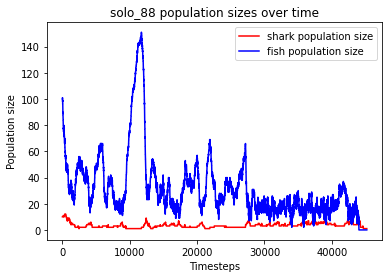

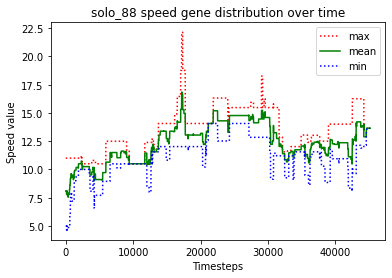

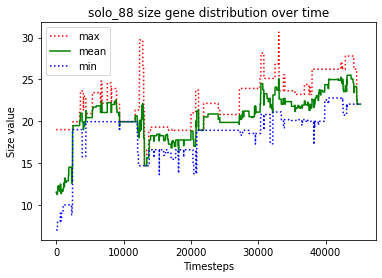

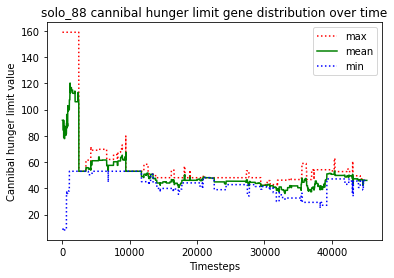

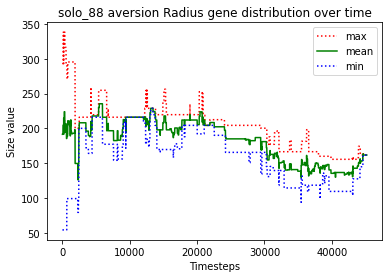

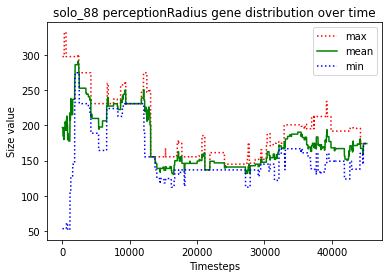

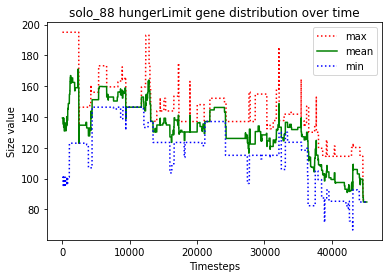





						SOLO_89

predator_7 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_11 killed predator_6
predator_11 killed predator_2
predator_0 just gave birth to predator_12
predator_7 killed predator_8
predator_10 just gave birth to predator_13
predator_13 starved to death
predator_10 starved to death
predator_11 ate the carcass of predator_10_carcass
predator_3 ate the carcass of predator_13_carcass
predator_5 just gave birth to predator_14
predator_14 starved to death
predator_5 ate the carcass of predator_14_carcass
predator_11 just gave birth to predator_15
predator_7 starved to death
predator_15 just gave birth to predator_16
predator_15 killed predator_12
predator_16 starved to death
predator_5 starved to death
predator_0 ate the carcass of predator_5_carcass
predator_11 ate the carcass of predator_16_carcass
predator_15 starved to death
predator_3 ate the carcass of predator_15_carcass
predator_11 ate the carcass of predator_7_carcass
predator_0 j

predator_62 just gave birth to predator_69
predator_50 ate the carcass of predator_63_carcass
predator_68 just gave birth to predator_70
predator_70 starved to death
predator_59 ate the carcass of predator_70_carcass
predator_50 just gave birth to predator_71
predator_50 killed predator_71
predator_66 starved to death
predator_50 ate the carcass of predator_66_carcass
predator_50 just gave birth to predator_72
predator_69 starved to death
predator_68 just gave birth to predator_73
predator_72 starved to death
predator_68 ate the carcass of predator_72_carcass
predator_39 starved to death
predator_68 ate the carcass of predator_69_carcass
predator_49 just gave birth to predator_74
predator_50 ate the carcass of predator_39_carcass
predator_73 just gave birth to predator_75
predator_75 just gave birth to predator_76
predator_75 killed predator_76
predator_50 starved to death
predator_59 ate the carcass of predator_50_carcass
predator_75 just gave birth to predator_77
predator_75 just gav

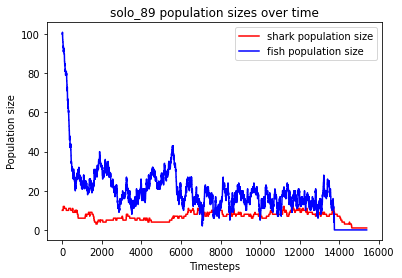

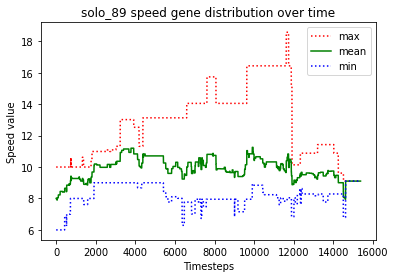

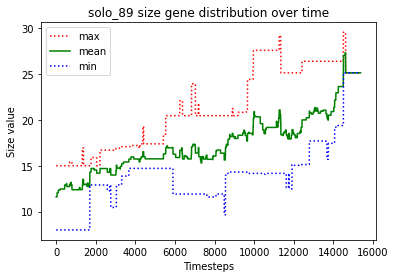

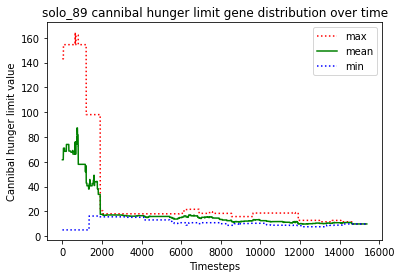

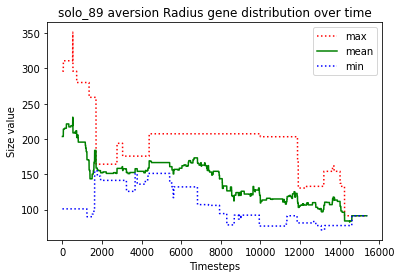

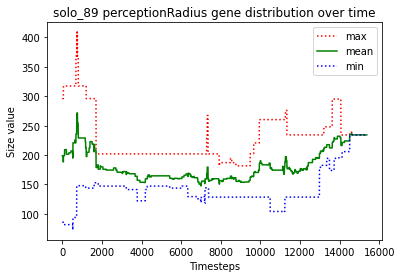

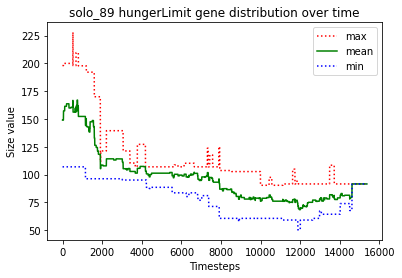





						SOLO_90

predator_4 just gave birth to predator_10
predator_10 killed predator_3
predator_0 just gave birth to predator_11
predator_4 killed predator_6
predator_4 killed predator_7
predator_10 killed predator_1
predator_0 just gave birth to predator_12
predator_12 starved to death
predator_0 ate the carcass of predator_12_carcass
predator_8 just gave birth to predator_13
predator_4 killed predator_2
predator_11 starved to death
predator_9 ate the carcass of predator_11_carcass
predator_0 starved to death
predator_13 just gave birth to predator_14
predator_13 starved to death
predator_10 ate the carcass of predator_0_carcass
predator_14 starved to death
predator_4 ate the carcass of predator_14_carcass
predator_4 just gave birth to predator_15
predator_4 ate the carcass of predator_13_carcass
predator_8 starved to death
predator_4 ate the carcass of predator_8_carcass
predator_9 just gave birth to predator_16
predator_16 just gave birth to predator_17
predator_17 starved to de

predator_57 ate the carcass of predator_64_carcass
predator_57 ate the carcass of predator_66_carcass
predator_57 ate the carcass of predator_56_carcass
predator_57 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 67
Timesteps passed: 23204
Fish went extinct at timestep 22545
Sharks went extinct at timestep 23204


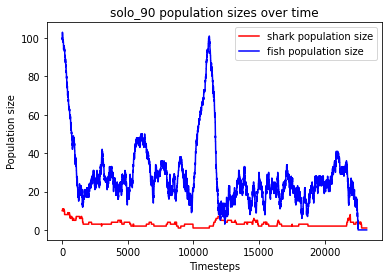

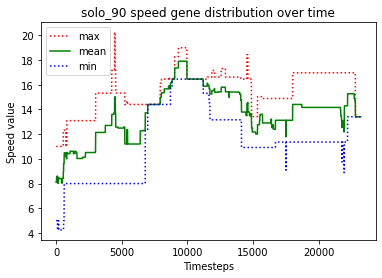

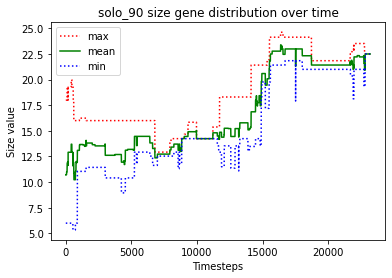

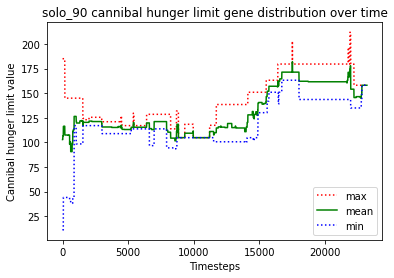

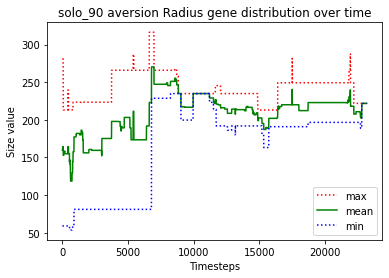

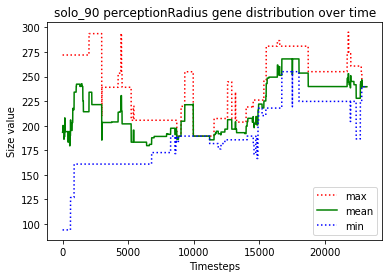

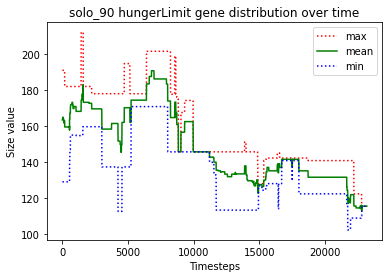





						SOLO_91

predator_0 just gave birth to predator_10
predator_8 killed predator_6
predator_3 just gave birth to predator_11
predator_8 killed predator_11
predator_8 just gave birth to predator_12
predator_12 killed predator_3
predator_5 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_5 just gave birth to predator_15
predator_14 killed predator_8
predator_10 just gave birth to predator_16
predator_5 starved to death
predator_7 ate the carcass of predator_5_carcass
predator_4 starved to death
predator_15 starved to death
predator_14 ate the carcass of predator_4_carcass
predator_13 starved to death
predator_7 ate the carcass of predator_13_carcass
predator_0 ate the carcass of predator_15_carcass
predator_12 starved to death
predator_16 ate the carcass of predator_12_carcass
predator_0 just gave birth to predator_17
predator_14 killed predator_17
predator_16 just gave birth to predator_18
predator_18 just gave birth to predator_19
predator_18 ju

predator_69 just gave birth to predator_72
predator_72 just gave birth to predator_73
predator_73 starved to death
predator_72 starved to death
predator_41 ate the carcass of predator_73_carcass
predator_41 ate the carcass of predator_72_carcass
predator_34 starved to death
predator_41 ate the carcass of predator_34_carcass
predator_68 just gave birth to predator_74
predator_74 starved to death
predator_68 starved to death
predator_41 ate the carcass of predator_74_carcass
predator_69 ate the carcass of predator_68_carcass
predator_41 just gave birth to predator_75
predator_41 killed predator_75
predator_53 just gave birth to predator_76
predator_76 just gave birth to predator_77
predator_77 just gave birth to predator_78
predator_76 just gave birth to predator_79
predator_77 just gave birth to predator_80
predator_80 starved to death
predator_78 starved to death
predator_79 ate the carcass of predator_78_carcass
predator_79 ate the carcass of predator_80_carcass
predator_41 starved to

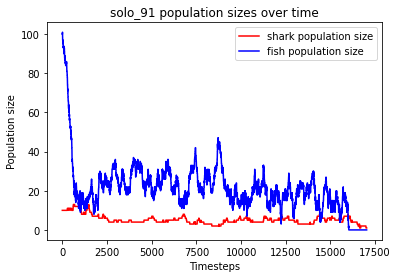

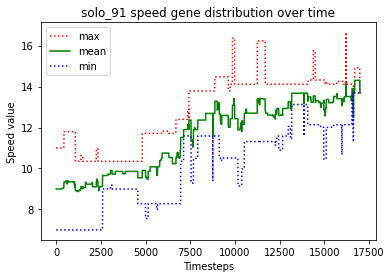

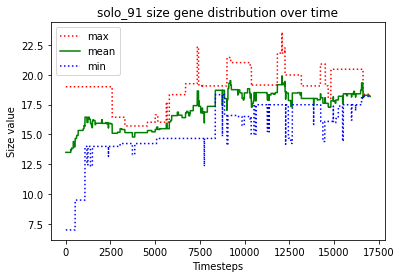

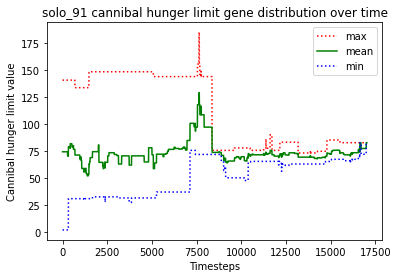

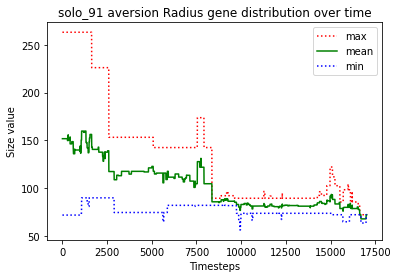

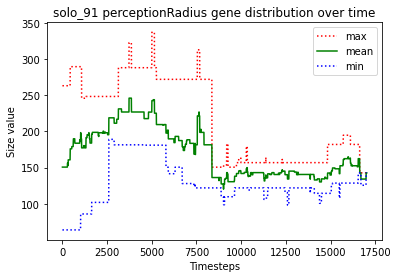

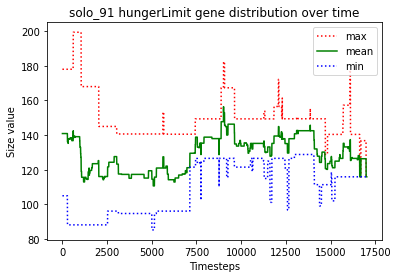





						SOLO_92

predator_7 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_1 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_11 killed predator_4
predator_15 starved to death
predator_10 starved to death
predator_3 ate the carcass of predator_10_carcass
predator_9 ate the carcass of predator_15_carcass
predator_16 just gave birth to predator_17
predator_8 just gave birth to predator_18
predator_5 killed predator_8
predator_9 just gave birth to predator_19
predator_12 starved to death
predator_7 starved to death
predator_3 ate the carcass of predator_12_carcass
predator_17 killed predator_11
predator_1 starved to death
predator_18 ate the carcass of predator_1_carcass
predator_13 ate the carcass of predator_7_carcass
predator_6 just gave birth to predator_20
predator_16 starved to death
pred

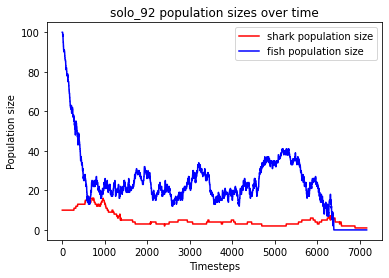

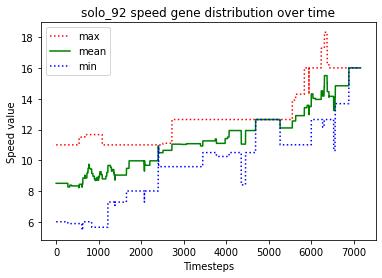

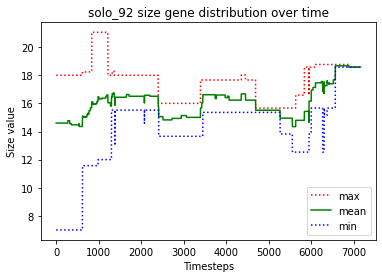

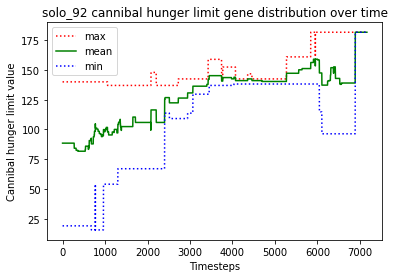

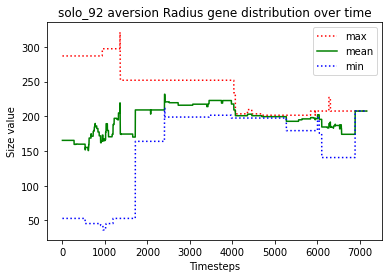

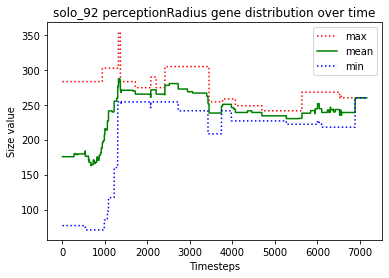

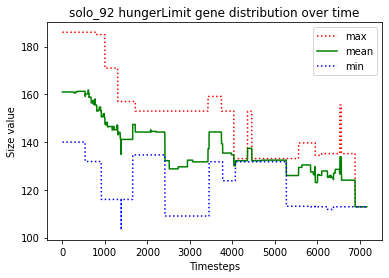





						SOLO_93

predator_8 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_12 killed predator_7
predator_10 killed predator_2
predator_10 just gave birth to predator_15
predator_14 starved to death
predator_5 ate the carcass of predator_14_carcass
predator_11 just gave birth to predator_16
predator_4 starved to death
predator_10 ate the carcass of predator_4_carcass
predator_15 just gave birth to predator_17
predator_10 killed predator_17
predator_16 starved to death
predator_10 ate the carcass of predator_16_carcass
predator_15 starved to death
predator_6 ate the carcass of predator_15_carcass
predator_11 starved to death
predator_10 ate the carcass of predator_11_carcass
predator_3 just gave birth to predator_18
predator_13 starved to death
predator_1 ate the carcass of predator_13_carcass
predator_9 starved to death
predat

predator_69 starved to death
predator_61 ate the carcass of predator_69_carcass
predator_65 starved to death
predator_61 ate the carcass of predator_65_carcass
predator_37 just gave birth to predator_70
predator_70 just gave birth to predator_71
predator_71 starved to death
predator_37 ate the carcass of predator_71_carcass
predator_68 starved to death
predator_67 ate the carcass of predator_68_carcass
predator_70 starved to death
predator_67 just gave birth to predator_72
predator_72 ate the carcass of predator_70_carcass
predator_37 just gave birth to predator_73
predator_67 starved to death
predator_37 ate the carcass of predator_67_carcass
predator_41 just gave birth to predator_74
predator_74 starved to death
predator_73 just gave birth to predator_75
predator_73 ate the carcass of predator_74_carcass
predator_41 just gave birth to predator_76
predator_41 starved to death
predator_73 ate the carcass of predator_41_carcass
predator_75 starved to death
predator_72 ate the carcass of

predator_123 just gave birth to predator_130
predator_122 just gave birth to predator_131
predator_129 starved to death
predator_127 starved to death
predator_122 ate the carcass of predator_129_carcass
predator_131 ate the carcass of predator_127_carcass
predator_123 starved to death
predator_121 ate the carcass of predator_123_carcass
predator_130 just gave birth to predator_132
predator_132 starved to death
predator_131 ate the carcass of predator_132_carcass
predator_130 starved to death
predator_121 ate the carcass of predator_130_carcass
predator_131 just gave birth to predator_133
predator_133 just gave birth to predator_134
predator_121 killed predator_134
predator_133 just gave birth to predator_135
predator_122 just gave birth to predator_136
predator_122 killed predator_136
predator_135 killed predator_131
predator_135 just gave birth to predator_137
predator_137 just gave birth to predator_138
predator_138 starved to death
predator_135 ate the carcass of predator_138_carcas

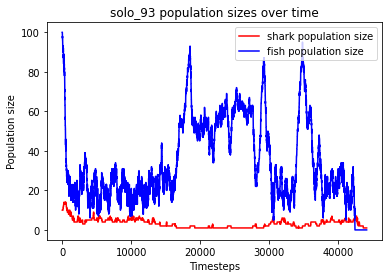

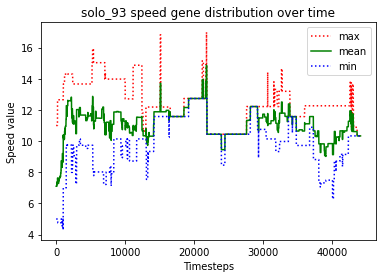

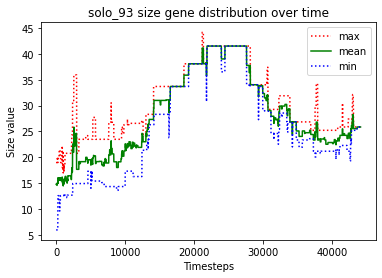

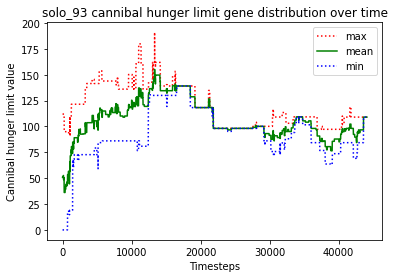

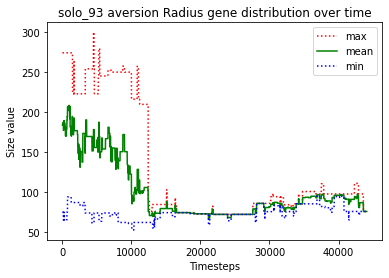

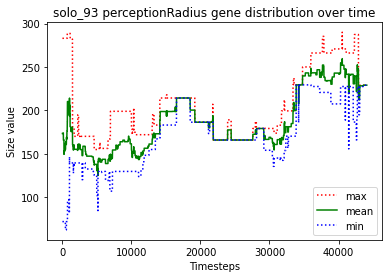

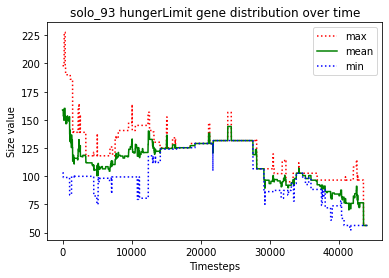





						SOLO_94

predator_2 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_11 starved to death
predator_7 killed predator_4
predator_1 ate the carcass of predator_11_carcass
predator_7 killed predator_6
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_2 starved to death
predator_13 just gave birth to predator_15
predator_14 starved to death
predator_13 ate the carcass of predator_2_carcass
predator_12 starved to death
predator_9 ate the carcass of predator_12_carcass
predator_9 ate the carcass of predator_14_carcass
predator_7 just gave birth to predator_16
predator_7 killed predator_5
predator_3 just gave birth to predator_17
predator_7 just gave birth to predator_18
predator_9 starved to death
predator_3 ate the carcass of predator_9_carcass
predator_8 starved to death
predator_16 just

predator_59 just gave birth to predator_68
predator_66 starved to death
predator_48 ate the carcass of predator_66_carcass
predator_68 just gave birth to predator_69
predator_59 just gave birth to predator_70
predator_69 starved to death
predator_68 ate the carcass of predator_69_carcass
predator_67 just gave birth to predator_71
predator_71 starved to death
predator_67 starved to death
predator_48 ate the carcass of predator_67_carcass
predator_48 ate the carcass of predator_71_carcass
predator_70 starved to death
predator_48 ate the carcass of predator_70_carcass
predator_48 just gave birth to predator_72
predator_68 just gave birth to predator_73
predator_48 just gave birth to predator_74
predator_73 just gave birth to predator_75
predator_73 starved to death
predator_75 starved to death
predator_72 ate the carcass of predator_73_carcass
predator_72 ate the carcass of predator_75_carcass
predator_48 just gave birth to predator_76
predator_74 starved to death
predator_76 ate the carc

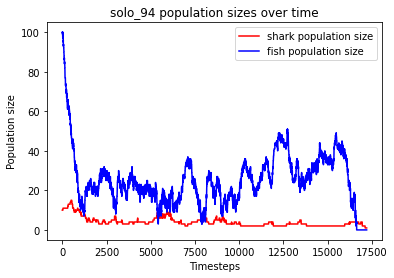

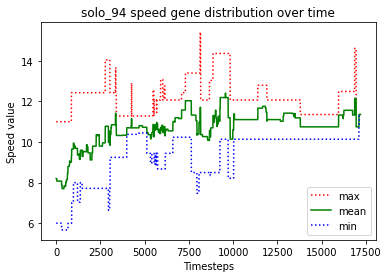

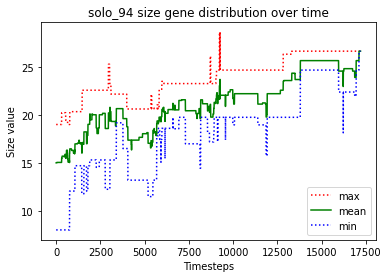

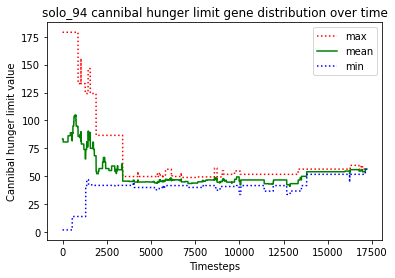

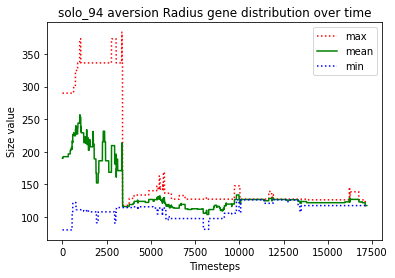

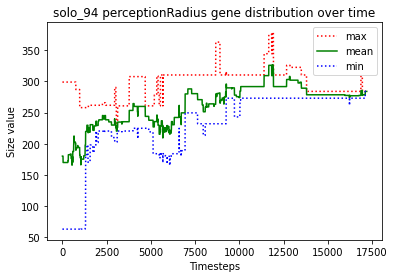

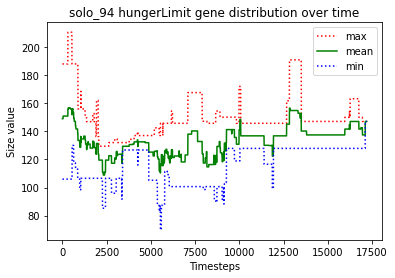





						SOLO_95

predator_4 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_4 just gave birth to predator_12
predator_4 killed predator_12
predator_5 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_14 killed predator_9
predator_4 killed predator_13
predator_10 killed predator_0
predator_8 just gave birth to predator_15
predator_11 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_8 killed predator_7
predator_4 killed predator_3
predator_8 killed predator_2
predator_15 just gave birth to predator_16
predator_4 killed predator_6
predator_14 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_5 starved to death
predator_4 ate the carcass of predator_5_carcass
predator_10 starved to death
predator_15 starved to death
predator_1 ate the carcass of predator_15_carcass
predator_17 starved to death
predator_14 starved to death
predator_18 starved to death
predator_8 a

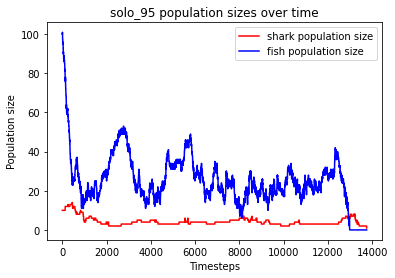

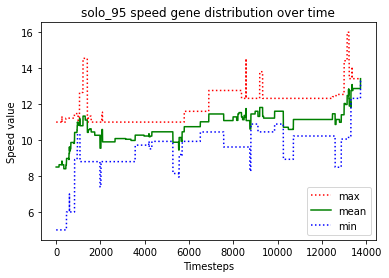

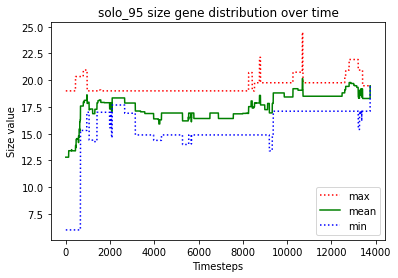

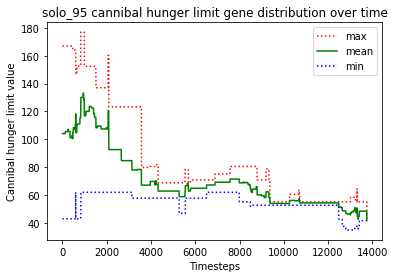

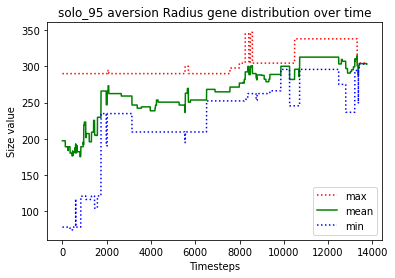

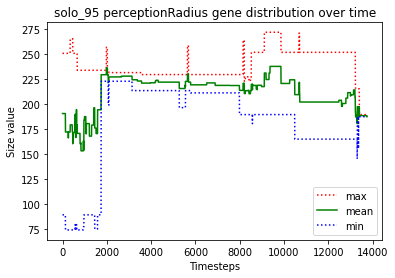

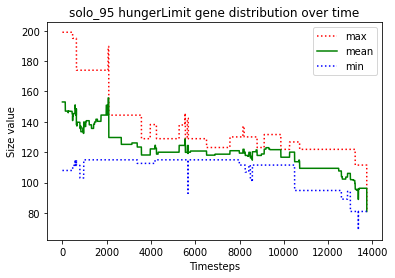





						SOLO_96

predator_4 killed predator_3
predator_8 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_10 killed predator_2
predator_7 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_7 just gave birth to predator_16
predator_4 killed predator_11
predator_8 killed predator_13
predator_10 killed predator_9
predator_16 starved to death
predator_15 killed predator_5
predator_7 ate the carcass of predator_16_carcass
predator_7 starved to death
predator_12 starved to death
predator_8 ate the carcass of predator_12_carcass
predator_6 starved to death
predator_14 starved to death
predator_1 ate the carcass of predator_6_carcass
predator_4 ate the carcass of predator_14_carcass
predator_0 ate the carcass of predator_7_carcass
predator_15 just gave birth to predator_17
predator_15 killed predator_1
predator_8 just gave birth to predator_18


predator_52 ate the carcass of predator_57_carcass
predator_37 just gave birth to predator_69
predator_68 just gave birth to predator_70
predator_47 just gave birth to predator_71
predator_71 just gave birth to predator_72
predator_70 starved to death
predator_71 ate the carcass of predator_70_carcass
predator_47 just gave birth to predator_73
predator_52 just gave birth to predator_74
predator_37 killed predator_68
predator_47 just gave birth to predator_75
predator_52 killed predator_72
predator_75 starved to death
predator_47 starved to death
predator_52 ate the carcass of predator_75_carcass
predator_74 just gave birth to predator_76
predator_73 ate the carcass of predator_47_carcass
predator_71 starved to death
predator_69 ate the carcass of predator_71_carcass
predator_76 starved to death
predator_74 just gave birth to predator_77
predator_77 starved to death
predator_73 starved to death
predator_74 starved to death
predator_52 ate the carcass of predator_76_carcass
predator_69 a

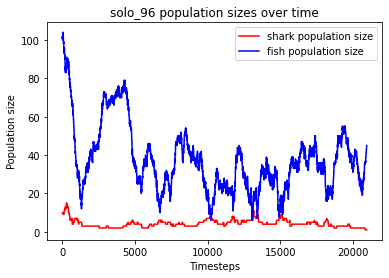

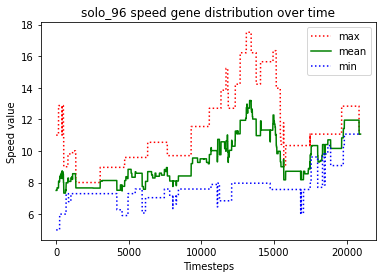

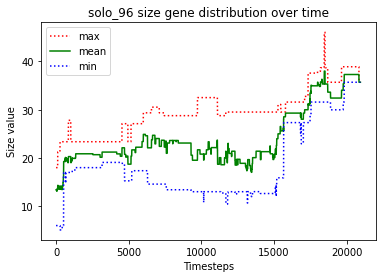

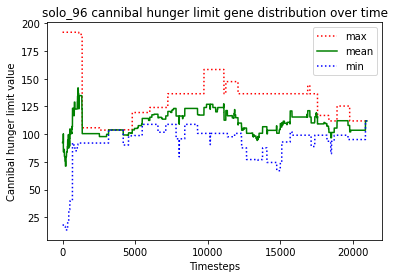

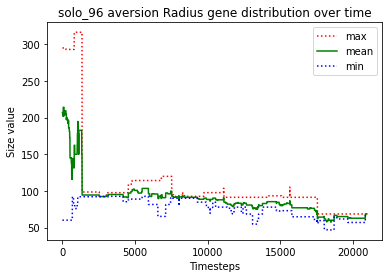

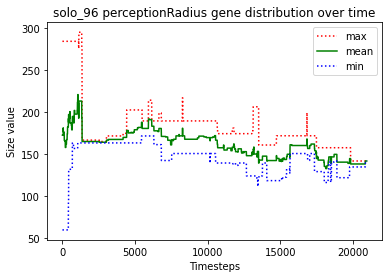

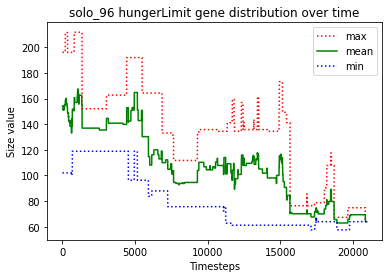





						SOLO_97

predator_1 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_13 starved to death
predator_11 just gave birth to predator_14
predator_10 starved to death
predator_0 ate the carcass of predator_13_carcass
predator_0 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_15 ate the carcass of predator_10_carcass
predator_14 starved to death
predator_1 ate the carcass of predator_14_carcass
predator_0 just gave birth to predator_17
predator_11 starved to death
predator_16 just gave birth to predator_18
predator_7 starved to death
predator_17 just gave birth to predator_19
predator_8 ate the carcass of predator_7_carcass
predator_4 ate the carcass of predator_11_carcass
predator_17 starved to death
predator_19 starved to death
predator_0 starved to death
predator_15 ate the carcass of predator_0_carcass
predator_12 starved to dea

predator_58 ate the carcass of predator_64_carcass
predator_67 just gave birth to predator_68
predator_68 just gave birth to predator_69
predator_68 starved to death
predator_58 ate the carcass of predator_68_carcass
predator_69 starved to death
predator_58 ate the carcass of predator_69_carcass
predator_58 just gave birth to predator_70
predator_67 killed predator_70
predator_67 starved to death
predator_58 ate the carcass of predator_67_carcass
predator_58 just gave birth to predator_71
predator_58 just gave birth to predator_72
predator_58 just gave birth to predator_73
predator_73 just gave birth to predator_74
predator_72 just gave birth to predator_75
predator_75 just gave birth to predator_76
predator_75 starved to death
predator_74 ate the carcass of predator_75_carcass
predator_58 just gave birth to predator_77
predator_73 just gave birth to predator_78
predator_76 starved to death
predator_74 ate the carcass of predator_76_carcass
predator_72 starved to death
predator_71 just

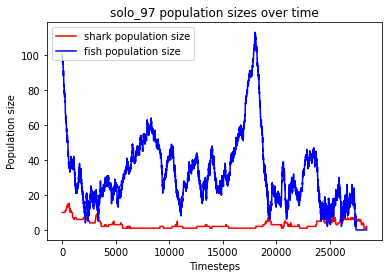

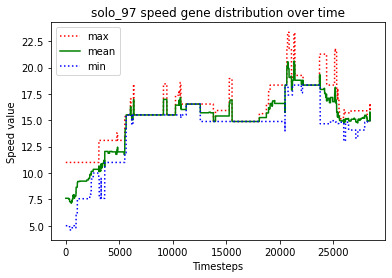

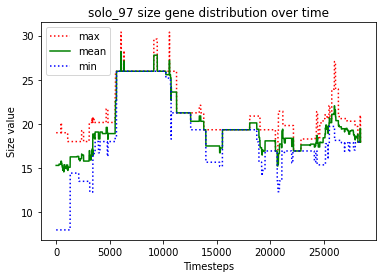

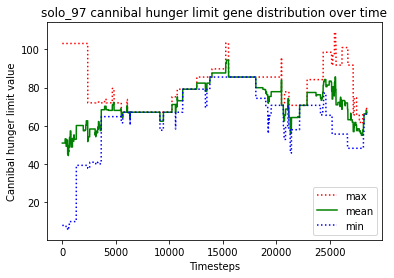

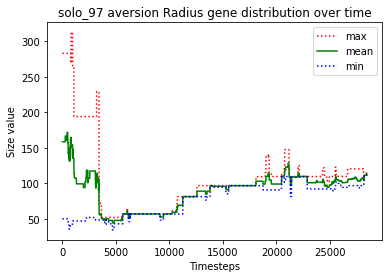

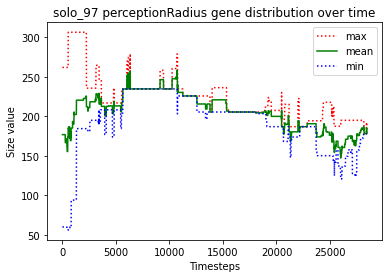

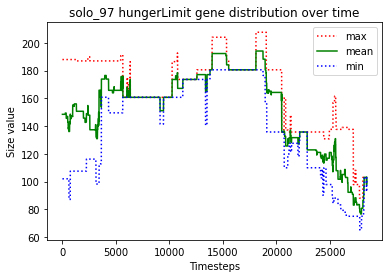





						SOLO_98

predator_8 just gave birth to predator_10
predator_8 killed predator_4
predator_8 killed predator_7
predator_8 killed predator_1
predator_0 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_3 starved to death
predator_10 ate the carcass of predator_3_carcass
predator_13 starved to death
predator_0 ate the carcass of predator_13_carcass
predator_11 just gave birth to predator_15
predator_11 starved to death
predator_9 ate the carcass of predator_11_carcass
predator_14 just gave birth to predator_16
predator_15 starved to death
predator_10 ate the carcass of predator_15_carcass
predator_0 starved to death
predator_12 just gave birth to predator_17
predator_6 just gave birth to predator_18
predator_8 ate the carcass of predator_0_carcass
predator_10 just gave birth to predator_19
predator_16 starved to death
predator_14 starved to death
predator_9 ate the 

predator_58 just gave birth to predator_73
predator_64 just gave birth to predator_74
predator_34 just gave birth to predator_75
predator_69 just gave birth to predator_76
predator_74 starved to death
predator_63 starved to death
predator_73 ate the carcass of predator_74_carcass
predator_73 ate the carcass of predator_63_carcass
predator_64 starved to death
predator_68 ate the carcass of predator_64_carcass
predator_34 just gave birth to predator_77
predator_75 starved to death
predator_76 starved to death
predator_73 just gave birth to predator_78
predator_77 starved to death
predator_38 ate the carcass of predator_75_carcass
predator_68 ate the carcass of predator_76_carcass
predator_38 just gave birth to predator_79
predator_72 ate the carcass of predator_77_carcass
predator_38 just gave birth to predator_80
predator_69 starved to death
predator_72 just gave birth to predator_81
predator_68 just gave birth to predator_82
predator_81 ate the carcass of predator_69_carcass
predator_7

predator_108 just gave birth to predator_137
predator_119 starved to death
predator_128 ate the carcass of predator_119_carcass
predator_130 just gave birth to predator_138
predator_136 just gave birth to predator_139
predator_135 just gave birth to predator_140
predator_137 starved to death
predator_128 just gave birth to predator_141
predator_135 just gave birth to predator_142
predator_139 ate the carcass of predator_137_carcass
predator_136 starved to death
predator_121 ate the carcass of predator_136_carcass
predator_142 starved to death
predator_132 ate the carcass of predator_142_carcass
predator_108 just gave birth to predator_143
predator_134 starved to death
predator_108 starved to death
predator_105 ate the carcass of predator_108_carcass
predator_143 starved to death
predator_138 just gave birth to predator_144
predator_130 starved to death
predator_132 ate the carcass of predator_143_carcass
predator_135 ate the carcass of predator_134_carcass
predator_144 ate the carcass 

predator_190 starved to death
predator_186 ate the carcass of predator_190_carcass
predator_163 just gave birth to predator_193
predator_186 just gave birth to predator_194
predator_194 killed predator_193
predator_194 just gave birth to predator_195
predator_194 starved to death
predator_195 starved to death
predator_186 ate the carcass of predator_195_carcass
predator_186 ate the carcass of predator_194_carcass
predator_186 just gave birth to predator_196
predator_163 just gave birth to predator_197
predator_197 just gave birth to predator_198
predator_163 killed predator_198
predator_197 starved to death
predator_196 ate the carcass of predator_197_carcass
predator_163 just gave birth to predator_199
predator_196 just gave birth to predator_200
predator_163 starved to death
predator_199 ate the carcass of predator_163_carcass
no fish to move
predator_199 starved to death
predator_196 ate the carcass of predator_199_carcass
predator_200 just gave birth to predator_201
predator_196 ki

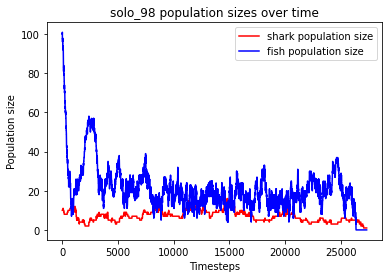

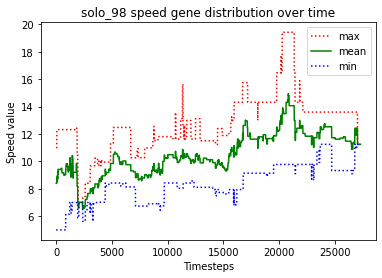

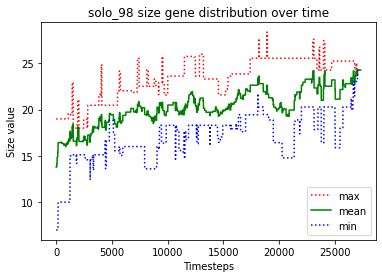

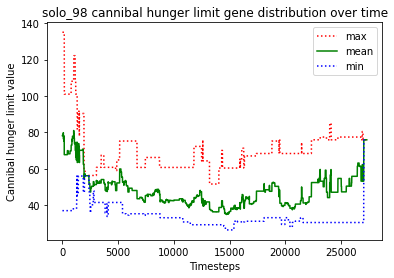

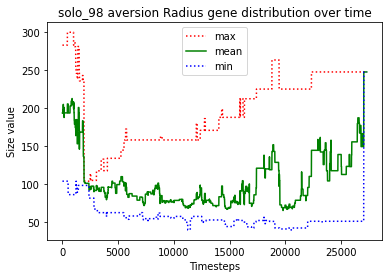

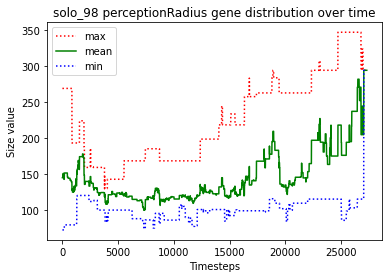

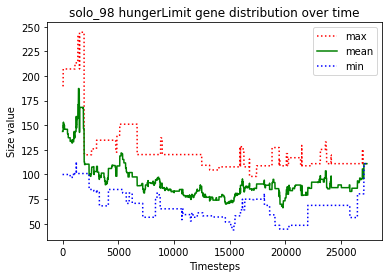





						SOLO_99

predator_0 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_0 killed predator_12
predator_4 just gave birth to predator_16
predator_13 killed predator_1
predator_10 just gave birth to predator_17
predator_5 killed predator_15
predator_13 starved to death
predator_0 ate the carcass of predator_13_carcass
predator_2 just gave birth to predator_18
predator_10 starved to death
predator_17 starved to death
predator_18 ate the carcass of predator_17_carcass
predator_5 ate the carcass of predator_10_carcass
predator_7 just gave birth to predator_19
predator_3 starved to death
predator_5 ate the carcass of predator_3_carcass
predator_2 starved to death
predator_7 ate the carcass of predator_2_carcass
predator_11 starved to death
predator_16 starved to death
predator_18 starved 

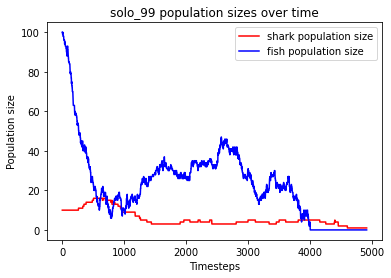

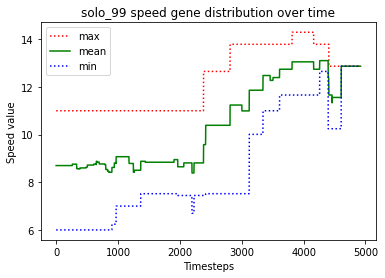

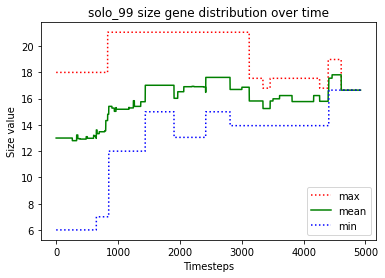

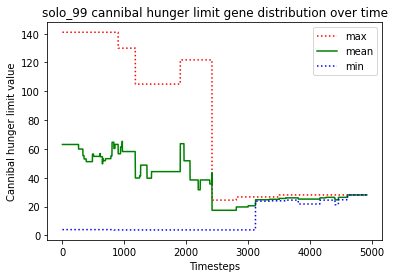

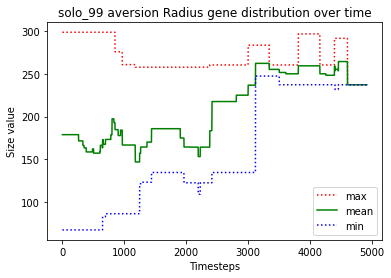

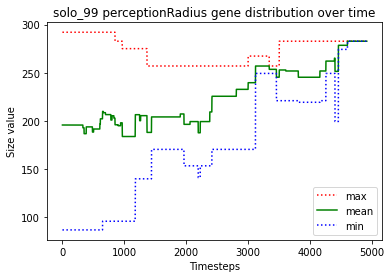

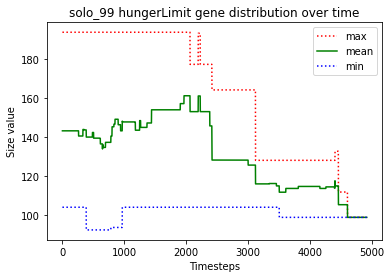

In [13]:
#### CONSTANTS ####
simulation_speed = 15
max_timesteps = 100000

### NUMBER OF AGENTS
#number of boids
num_boids = 100
#number of predators
num_preds = 10

### FISH BEHAVIOUR
#radius in which the fish swarm behaviour kicks in
perception_radius = 35
#minimum radius between each fish
minimum_radius = 25
#radius in which aversion behaviour kicks in
aversion_radius = 90

#### MAIN EXPERIMENT FUNCTION ####
def do_one_experiment(num_boids, perception_radius, minimum_radius, aversion_radius, num_preds, simulation_speed, max_timesteps, swarm_behavour, run_name):
    print(color.BOLD+f"\n\n\n\n\t\t\t\t\t\t{run_name.upper()}\n"+color.END)
    window = tk.Tk()
    canvas = initialise(window)
    count = Counter(max_timesteps) # run for 1000 time steps
    fishList = addFish(canvas, num_boids) ### Custom now taking num_boids as a parameter to be tuned
    predList = addPredators(canvas, num_preds) ### Custom adding preadtors
    moveFish(canvas,False, fishList, perception_radius, minimum_radius, aversion_radius, predList, simulation_speed, len(fishList), swarm_behaviour) ### Custom now taking perception and minimum radius as parameters to be tuned
    movePredators(canvas,window,count,predList, fishList, [], [], simulation_speed, len(predList), ([],[],[]), ([],[],[]), ([],[],[]), ([],[],[]), ([],[],[]), ([],[],[]), ([],[]), run_name, None, None) ### Custom moving predators
    writeTrackers(canvas, fishList, predList,count)
    window.mainloop()
    
    
#### running all experiments ####
# running with and without swarm behavour
for swarm_behaviour in (True, False):
    #running n experiments for each
    for i in range(num_of_experiments_for_each):
        run_name = ""
        run_name += f'boids_{i}' if swarm_behaviour else f'solo_{i}'
        do_one_experiment(num_boids, perception_radius, minimum_radius, aversion_radius, num_preds, simulation_speed, max_timesteps, swarm_behaviour, run_name)

# Inspecting totals from the experiments

## loading the stats from experiments

In [14]:
#loading the data for boids
boids_timesteps_passed=[]
boids_fish_extinct_timestep=[]
boids_shark_extinct_timestep=[]

boids_minMeanMax_speed=[]
boids_minMeanMax_size =[]
boids_minMeanMax_aversionRadius =[]
boids_minMeanMax_perceptionRadius =[]
boids_minMeanMax_hungerLimit =[]
boids_minMeanMax_canibalHunger =[]

boids_populationSizes=[]

for i in range(num_of_experiments_for_each):
    boids_timesteps_passed.append(pd.read_pickle(f"./boids_{i}/timesteps_passed.pickle"))
    boids_shark_extinct_timestep.append(pd.read_pickle(f"./boids_{i}/shark_extinct_timestep.pickle"))
    boids_fish_extinct_timestep.append(pd.read_pickle(f"./boids_{i}/fish_extinct_timestep.pickle"))

    boids_minMeanMax_speed.append(pd.read_pickle(f"./boids_{i}/minMeanMax_speed.pickle"))
    boids_minMeanMax_size.append(pd.read_pickle(f"./boids_{i}/minMeanMax_size.pickle"))
    boids_minMeanMax_aversionRadius.append(pd.read_pickle(f"./boids_{i}/minMeanMax_aversionRadius.pickle"))
    boids_minMeanMax_perceptionRadius.append(pd.read_pickle(f"./boids_{i}/minMeanMax_perceptionRadius.pickle"))
    boids_minMeanMax_hungerLimit.append(pd.read_pickle(f"./boids_{i}/minMeanMax_hungerLimit.pickle"))
    boids_minMeanMax_canibalHunger.append(pd.read_pickle(f"./boids_{i}/minMeanMax_canibalHunger.pickle"))
    
    boids_populationSizes.append(pd.read_pickle(f"./boids_{i}/populationSizes.pickle"))


    
    
    
#loading the data for solo
solo_timesteps_passed=[]
solo_fish_extinct_timestep=[]
solo_shark_extinct_timestep=[]

solo_minMeanMax_speed=[]
solo_minMeanMax_size =[]
solo_minMeanMax_aversionRadius =[]
solo_minMeanMax_perceptionRadius =[]
solo_minMeanMax_hungerLimit =[]
solo_minMeanMax_canibalHunger =[]

solo_populationSizes=[]

for i in range(num_of_experiments_for_each):
    solo_timesteps_passed.append(pd.read_pickle(f"./solo_{i}/timesteps_passed.pickle"))
    solo_shark_extinct_timestep.append(pd.read_pickle(f"./solo_{i}/shark_extinct_timestep.pickle"))
    solo_fish_extinct_timestep.append(pd.read_pickle(f"./solo_{i}/fish_extinct_timestep.pickle"))

    solo_minMeanMax_speed.append(pd.read_pickle(f"./solo_{i}/minMeanMax_speed.pickle"))
    solo_minMeanMax_size.append(pd.read_pickle(f"./solo_{i}/minMeanMax_size.pickle"))
    solo_minMeanMax_aversionRadius.append(pd.read_pickle(f"./solo_{i}/minMeanMax_aversionRadius.pickle"))
    solo_minMeanMax_perceptionRadius.append(pd.read_pickle(f"./solo_{i}/minMeanMax_perceptionRadius.pickle"))
    solo_minMeanMax_hungerLimit.append(pd.read_pickle(f"./solo_{i}/minMeanMax_hungerLimit.pickle"))
    solo_minMeanMax_canibalHunger.append(pd.read_pickle(f"./solo_{i}/minMeanMax_canibalHunger.pickle"))
    
    
    solo_populationSizes.append(pd.read_pickle(f"./solo_{i}/populationSizes.pickle"))

In [15]:
#making the directories if it doesn't already exist
if not os.path.exists('_all_solo/plots'):
    os.makedirs('_all_solo/plots')
if not os.path.exists('_all_boids/plots'):
    os.makedirs('_all_boids/plots')
if not os.path.exists('__boids_vs_solo/plots'):
    os.makedirs('__boids_vs_solo/plots')

## Inspecting population sizes over all experiments

### Solo population sizes

In [16]:
#getting the pred and fish popsizes
temp=pd.DataFrame(data = solo_populationSizes, columns = ["pred","fish"])
preds_popsizes = pd.DataFrame(data = temp["pred"].to_list()).replace(0, np.nan)
fish_popsizes = pd.DataFrame(data = temp["fish"].to_list())

In [17]:
# getting min/max/mean of all columns
min_fish = fish_popsizes.min()
max_fish = fish_popsizes.max()
mean_fish = fish_popsizes.mean()

min_shark = preds_popsizes.min()
max_shark = preds_popsizes.max()
mean_shark = preds_popsizes.mean()

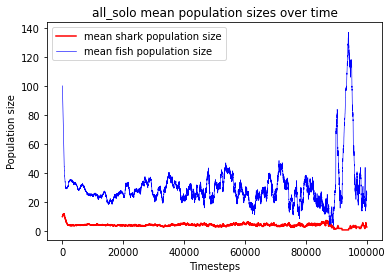

In [18]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo mean population sizes over time")
plt.xlabel("Timesteps")
plt.ylabel("Population size")
# plt.plot(max_shark, color='lime', linestyle='-', lw=0.4, label='max shark population size')
plt.plot(mean_shark, color='red', linestyle='-', label='mean shark population size')
# plt.plot(min_shark, color='magenta', linestyle='-', lw=0.4, label='min shark population size')

# plt.plot(max_fish, color='navy', linestyle=':', lw=0.2, label='max fish population size')
plt.plot(mean_fish, color='blue', linestyle='-', lw=0.6, label='mean fish population size')
# plt.plot(min_fish, color='darkolivegreen', linestyle=':', lw=0.2 label='min fish population size')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/_fish_vs_sharks_populations.png')
plt.close()

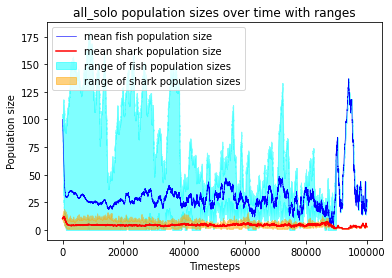

In [19]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo population sizes over time with ranges")
plt.xlabel("Timesteps")
plt.ylabel("Population size")

# plt.plot(max_fish, color='navy', linestyle=':', lw=0.2, label='max fish population size')
plt.plot(mean_fish, color='blue', linestyle='-', lw=0.6, label='mean fish population size')
# plt.plot(min_fish, color='darkolivegreen', linestyle=':', lw=0.2 label='min fish population size')
plt.fill_between(list(range(len(mean_fish))),min_fish, max_fish, color="cyan", alpha=.5, label='range of fish population sizes')

# plt.plot(max_shark, color='lime', linestyle='-', lw=0.4, label='max shark population size')
plt.plot(mean_shark, color='red', linestyle='-', label='mean shark population size')
# plt.plot(min_shark, color='magenta', linestyle='-', lw=0.4, label='min shark population size')
plt.fill_between(list(range(len(mean_fish))),min_shark, max_shark, color="orange", alpha=.5, label='range of shark population sizes')



plt.legend()
plt.show()
fig.savefig('_all_solo/plots/_fish_vs_sharks_populations_with_ranges.png')
plt.close()

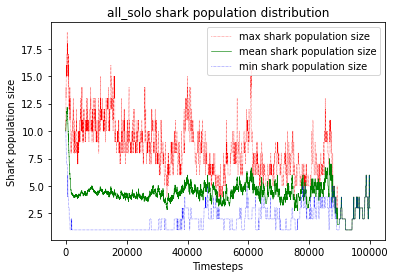

In [20]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo shark population distribution")
plt.xlabel("Timesteps")
plt.ylabel("Shark population size")
plt.plot(max_shark, color='r', linestyle=':', lw=0.5, label='max shark population size')
plt.plot(mean_shark, color='g', linestyle='-', lw=0.6, label='mean shark population size')
plt.plot(min_shark, color='b', linestyle=':', lw=0.5, label='min shark population size')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/sharks_populations.png')
plt.close()

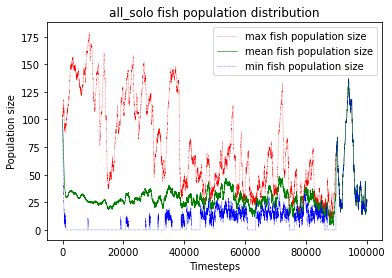

In [21]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo fish population distribution")
plt.xlabel("Timesteps")
plt.ylabel("Population size")


plt.plot(max_fish, color='r', linestyle=':', lw=0.5, label='max fish population size')
plt.plot(mean_fish, color='g', linestyle='-', lw=0.6, label='mean fish population size')
plt.plot(min_fish, color='b', linestyle=':', lw=0.5, label='min fish population size')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/fish_populations.png')
plt.close()

## Inspecting extinctions

In [22]:
#inspecting times of extinction

fish_never_went_extinct = solo_fish_extinct_timestep.count(None)
fish_no_none=solo_fish_extinct_timestep.copy()
while None in fish_no_none: fish_no_none.remove(None)

print("SOLO EXPERIMENT FISH EXTINCTION")
print("Minimum timesteps until fish went extinct is:",min(fish_no_none))
print("Mean timesteps until fish went extinct is:",round(np.mean(fish_no_none),2))
print("Max timesteps until fish went extinct is:",max(fish_no_none))
print("Median timesteps until fish went extinct is: ",round(np.median(fish_no_none),2))
print(f"Also, there were {fish_never_went_extinct} runs where fish never went extinct" if fish_never_went_extinct>0 else "Fish went extinct in every run" )




sharks_never_went_extinct = solo_shark_extinct_timestep.count(None)
sharks_no_none=solo_shark_extinct_timestep.copy()
while None in sharks_no_none: sharks_no_none.remove(None)

print("\nSOLO EXPERIMENT SHARK EXTINCTION")
print("Minimum timesteps until sharks went extinct is:",min(sharks_no_none))
print("Mean timesteps until sharks went extinct is:",np.mean(sharks_no_none))
print("Max timesteps until sharks went extinct is:",max(sharks_no_none))
print("Median timesteps until sharks went extinct is: ",round(np.median(sharks_no_none),2))
print(f"Also, there were {sharks_never_went_extinct} runs where sharks never went extinct" if sharks_never_went_extinct>0 else "Sharks went extinct in every run" )

SOLO EXPERIMENT FISH EXTINCTION
Minimum timesteps until fish went extinct is: 1106
Mean timesteps until fish went extinct is: 18722.11
Max timesteps until fish went extinct is: 87050
Median timesteps until fish went extinct is:  14966.0
Also, there were 6 runs where fish never went extinct

SOLO EXPERIMENT SHARK EXTINCTION
Minimum timesteps until sharks went extinct is: 2384
Mean timesteps until sharks went extinct is: 20021.949494949495
Max timesteps until sharks went extinct is: 89824
Median timesteps until sharks went extinct is:  15979.0
Also, there were 1 runs where sharks never went extinct


In [23]:
# REFERENCE : https://stackoverflow.com/questions/23461713/obtaining-values-used-in-boxplot-using-python-and-matplotlib

# function for annotating the box plots
def get_box_plot_data(labels, bp):
    rows_list = []

    for i in range(len(labels)):
        dict1 = {}
        dict1['label'] = labels[i].replace("\n", ": ")
        dict1['lower_whisker'] = bp['whiskers'][i*2].get_ydata()[1]
        dict1['lower_quartile'] = bp['boxes'][i].get_ydata()[1]
        dict1['median'] = bp['medians'][i].get_ydata()[1]
        dict1['mean'] = round(bp['means'][i].get_ydata()[0],2)
        dict1['upper_quartile'] = bp['boxes'][i].get_ydata()[2]
        dict1['upper_whisker'] = bp['whiskers'][(i*2)+1].get_ydata()[1]
        rows_list.append(dict1)

    return pd.DataFrame(rows_list)

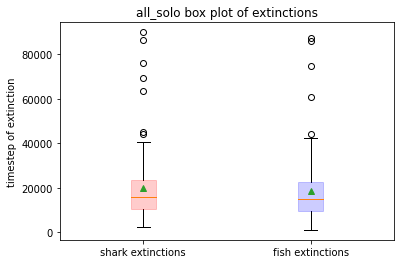

In [24]:
# box plot of extinctions
fig=plt.figure()
bp=plt.boxplot([sharks_no_none, fish_no_none], labels=["shark extinctions","fish extinctions"], showmeans=True, patch_artist=True)
i=0
for box in bp['boxes']:
    if i%2==1:
        box.set(color='blue', alpha=0.2) 
    else:
        box.set(color='red', alpha=0.2)
    i+=1

plt.ylabel("timestep of extinction")
plt.title("all_solo box plot of extinctions")
plt.show()
fig.savefig("_all_solo/plots/box_all_extinctions.png")

In [25]:
#just plotting without patch artist so below function works
bp=plt.boxplot([sharks_no_none, fish_no_none], labels=["solo\nshark extinctions","solo\nfish extinctions"], showmeans=True)
plt.close()
#getting the dataframe annotating the box plot
temp=get_box_plot_data(["solo\nshark extinctions","solo\nfish extinctions"], bp)
temp["max"]=[max(sharks_no_none),max(fish_no_none)]
temp["min"]=[min(sharks_no_none),min(fish_no_none)]
temp["number of runs without extinction"]=[solo_shark_extinct_timestep.count(None),solo_fish_extinct_timestep.count(None)]
temp

,label,lower_whisker,lower_quartile,median,mean,upper_quartile,upper_whisker,max,min,number of runs without extinction
0,solo: shark extinctions,2384.0,10625.50,15979.0,20021.95,23584.5,40762.0,89824,2384,1
1,solo: fish extinctions,1106.0,9580.75,14966.0,18722.11,22737.0,42397.0,87050,1106,6


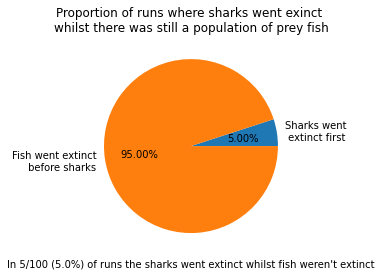

In [26]:
#Getting percentage of runs where sharks went extinct before fish
sharks_extinct_before_fish_counter=0
for i in range (num_of_experiments_for_each):
    if(solo_fish_extinct_timestep[i]==None and solo_shark_extinct_timestep[i]!=None):
        sharks_extinct_before_fish_counter+=1
        
fig = plt.figure()
counts=[sharks_extinct_before_fish_counter,num_of_experiments_for_each-sharks_extinct_before_fish_counter]
plt.pie(counts, labels = ["Sharks went\n extinct first", "Fish went extinct\n before sharks"], autopct='%1.2f%%')
plt.title("Proportion of runs where sharks went exinct \nwhilst there was still a population of prey fish")
plt.xlabel(f"In {str(sharks_extinct_before_fish_counter)}/{str(num_of_experiments_for_each)} ({str(round(sharks_extinct_before_fish_counter/num_of_experiments_for_each*100,2))}%) of runs the sharks went extinct whilst fish weren't extinct")
plt.show()
fig.savefig("_all_solo/plots/pie_shark_before_fish.png")
plt.close()

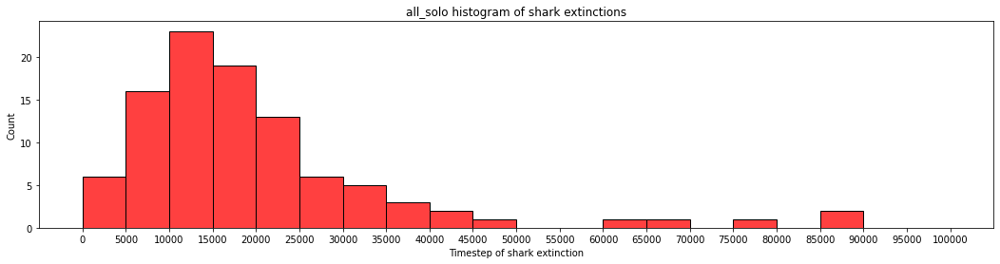

In [27]:
fig = plt.figure(figsize=(18,4))
ax=sns.histplot(data=sharks_no_none, bins=range(0,100001,5000), color = 'r')
ax.set_title("all_solo histogram of shark extinctions")
ax.set_xlabel("Timestep of shark extinction")
ax.set_xticks(range(0,100001,5000))
fig.savefig('_all_solo/plots/shark_extinctions.png')
plt.show()
plt.close()

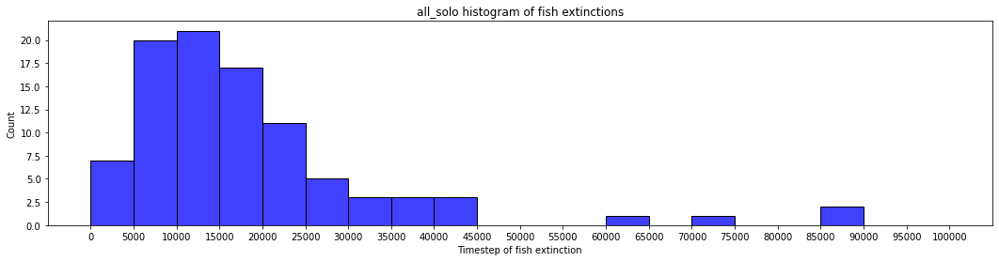

In [28]:
fig = plt.figure(figsize=(18,4))
ax=sns.histplot(data=fish_no_none, bins=range(0,100001,5000), color = 'b')
ax.set_title("all_solo histogram of fish extinctions")
ax.set_xlabel("Timestep of fish extinction")
ax.set_xticks(range(0,100001,5000))
fig.savefig('_all_solo/plots/fish_extinctions.png')
plt.show()
plt.close()

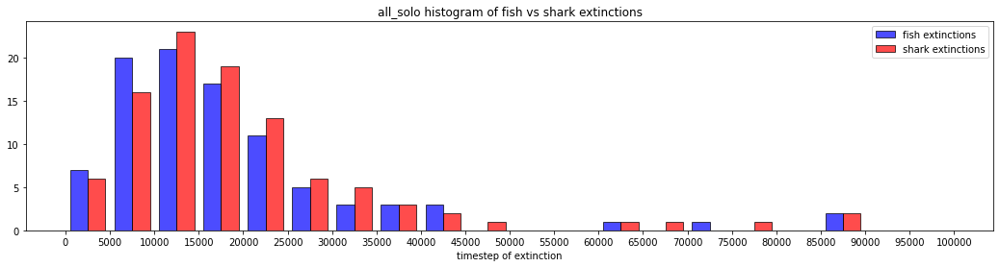

In [29]:
#plotting on top of each other
fig = plt.figure(figsize=(18,4))
plt.hist([fish_no_none, sharks_no_none], color=['b','r'], ec="k",alpha=0.7, bins=range(0,100001,5000))
plt.xticks(range(0,100001,5000))

handles = [Rectangle((0,0),1,1,color=c,ec="k", alpha=0.7) for c in ['b','r']]
labels=["fish extinctions","shark extinctions"]
plt.legend(handles, labels)

plt.title("all_solo histogram of fish vs shark extinctions")
plt.xlabel("timestep of extinction")

fig.savefig('_all_solo/plots/_all_extinctions.png')
plt.show()
plt.close()

### Boids population sizes

In [30]:
#getting the pred and fish popsizes
temp=pd.DataFrame(data = boids_populationSizes, columns = ["pred","fish"])
preds_popsizes = pd.DataFrame(data = temp["pred"].to_list()).replace(0, np.nan)
fish_popsizes = pd.DataFrame(data = temp["fish"].to_list())

In [31]:
# getting min/max/mean of all columns
min_fish = fish_popsizes.min()
max_fish = fish_popsizes.max()
mean_fish = fish_popsizes.mean()

min_shark = preds_popsizes.min()
max_shark = preds_popsizes.max()
mean_shark = preds_popsizes.mean()

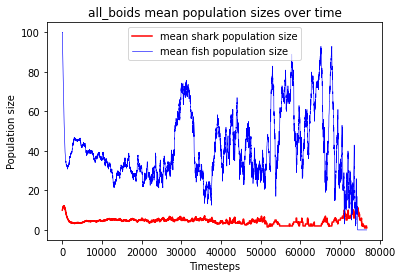

In [32]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids mean population sizes over time")
plt.xlabel("Timesteps")
plt.ylabel("Population size")
# plt.plot(max_shark, color='lime', linestyle='-', lw=0.4, label='max shark population size')
plt.plot(mean_shark, color='red', linestyle='-', label='mean shark population size')
# plt.plot(min_shark, color='magenta', linestyle='-', lw=0.4, label='min shark population size')

# plt.plot(max_fish, color='navy', linestyle=':', lw=0.2, label='max fish population size')
plt.plot(mean_fish, color='blue', linestyle='-', lw=0.6, label='mean fish population size')
# plt.plot(min_fish, color='darkolivegreen', linestyle=':', lw=0.2 label='min fish population size')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/_fish_vs_sharks_populations.png')
plt.close()

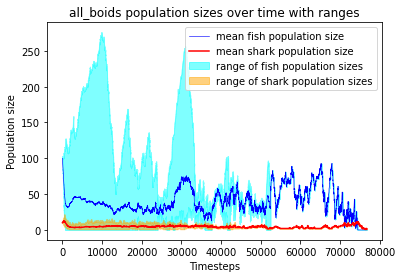

In [33]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids population sizes over time with ranges")
plt.xlabel("Timesteps")
plt.ylabel("Population size")

# plt.plot(max_fish, color='navy', linestyle=':', lw=0.2, label='max fish population size')
plt.plot(mean_fish, color='blue', linestyle='-', lw=0.6, label='mean fish population size')
# plt.plot(min_fish, color='darkolivegreen', linestyle=':', lw=0.2 label='min fish population size')
plt.fill_between(list(range(len(mean_fish))),min_fish, max_fish, color="cyan", alpha=.5, label='range of fish population sizes')

# plt.plot(max_shark, color='lime', linestyle='-', lw=0.4, label='max shark population size')
plt.plot(mean_shark, color='red', linestyle='-', label='mean shark population size')
# plt.plot(min_shark, color='magenta', linestyle='-', lw=0.4, label='min shark population size')
plt.fill_between(list(range(len(mean_fish))),min_shark, max_shark, color="orange", alpha=.5, label='range of shark population sizes')



plt.legend()
plt.show()
fig.savefig('_all_boids/plots/_fish_vs_sharks_populations_with_ranges.png')
plt.close()

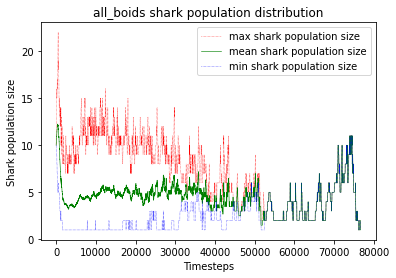

In [34]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids shark population distribution")
plt.xlabel("Timesteps")
plt.ylabel("Shark population size")
plt.plot(max_shark, color='r', linestyle=':', lw=0.5, label='max shark population size')
plt.plot(mean_shark, color='g', linestyle='-', lw=0.6, label='mean shark population size')
plt.plot(min_shark, color='b', linestyle=':', lw=0.5, label='min shark population size')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/sharks_populations.png')
plt.close()

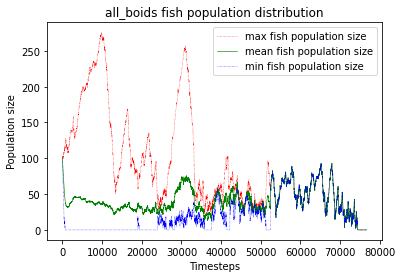

In [35]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids fish population distribution")
plt.xlabel("Timesteps")
plt.ylabel("Population size")


plt.plot(max_fish, color='r', linestyle=':', lw=0.5, label='max fish population size')
plt.plot(mean_fish, color='g', linestyle='-', lw=0.6, label='mean fish population size')
plt.plot(min_fish, color='b', linestyle=':', lw=0.5, label='min fish population size')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/fish_populations.png')
plt.close()

### Boids extinctions

In [36]:
#inspecting times of extinction

fish_never_went_extinct = boids_fish_extinct_timestep.count(None)
fish_no_none=boids_fish_extinct_timestep.copy()
while None in fish_no_none: fish_no_none.remove(None)

print("BOIDS EXPERIMENT FISH EXTINCTION")
print("Minimum timesteps until fish went extinct is:",min(fish_no_none))
print("Mean timesteps until fish went extinct is:",round(np.mean(fish_no_none), 2))
print("Max timesteps until fish went extinct is:",max(fish_no_none))
print("Median timesteps until fish went extinct is: ",round(np.median(fish_no_none),2))
print(f"Also, there were {fish_never_went_extinct} runs where fish never went extinct" if fish_never_went_extinct>0 else "Fish went extinct in every run" )




sharks_never_went_extinct = boids_shark_extinct_timestep.count(None)
sharks_no_none=boids_shark_extinct_timestep.copy()
while None in sharks_no_none: sharks_no_none.remove(None)

print("\nBOIDS EXPERIMENT SHARK EXTINCTION")
print("Minimum timesteps until sharks went extinct is:",min(sharks_no_none))
print("Mean timesteps until sharks went extinct is:",round(np.mean(sharks_no_none),2))
print("Max timesteps until sharks went extinct is:",max(sharks_no_none))
print("Median timesteps until sharks went extinct is: ",round(np.median(sharks_no_none),2))
print(f"Also, there were {sharks_never_went_extinct} runs where sharks never went extinct" if sharks_never_went_extinct>0 else "Sharks went extinct in every run" )

BOIDS EXPERIMENT FISH EXTINCTION
Minimum timesteps until fish went extinct is: 665
Mean timesteps until fish went extinct is: 12277.74
Max timesteps until fish went extinct is: 74386
Median timesteps until fish went extinct is:  9369.0
Also, there were 7 runs where fish never went extinct

BOIDS EXPERIMENT SHARK EXTINCTION
Minimum timesteps until sharks went extinct is: 1731
Mean timesteps until sharks went extinct is: 13006.87
Max timesteps until sharks went extinct is: 76706
Median timesteps until sharks went extinct is:  10072.0
Sharks went extinct in every run


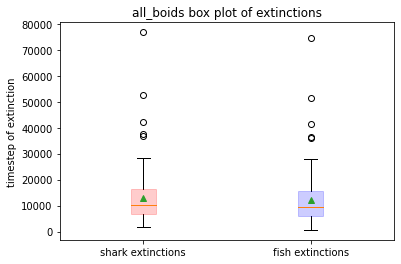

In [37]:
# box plot of extinctions
fig=plt.figure()
bp=plt.boxplot([sharks_no_none, fish_no_none], labels=["shark extinctions","fish extinctions"], showmeans=True, patch_artist=True)

i=0
for box in bp['boxes']:
    if i%2==1:
        box.set(color='blue', alpha=0.2) 
    else:
        box.set(color='red', alpha=0.2)
    i+=1

plt.ylabel("timestep of extinction")
plt.title("all_boids box plot of extinctions")
plt.show()
fig.savefig("_all_boids/plots/box_all_extinctions.png")

In [38]:
#just plotting without patch artist so below function works
bp=plt.boxplot([sharks_no_none, fish_no_none], labels=["boids\nshark extinctions","boids\nfish extinctions"], showmeans=True)
plt.close()
#getting the dataframe annotating the box plot
temp=get_box_plot_data(["boids\nshark extinctions","boids\nfish extinctions"], bp)
temp["max"]=[max(sharks_no_none),max(fish_no_none)]
temp["min"]=[min(sharks_no_none),min(fish_no_none)]
temp["number of runs without extinction"]=[boids_shark_extinct_timestep.count(None),boids_fish_extinct_timestep.count(None)]
temp

,label,lower_whisker,lower_quartile,median,mean,upper_quartile,upper_whisker,max,min,number of runs without extinction
0,boids: shark extinctions,1731.0,6834.0,10072.0,13006.87,16526.25,28278.0,76706,1731,0
1,boids: fish extinctions,665.0,6172.0,9369.0,12277.74,15585.00,27786.0,74386,665,7


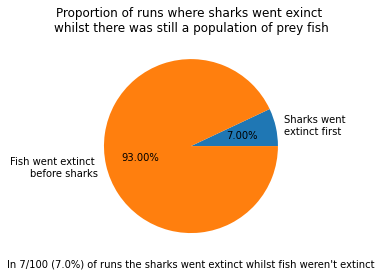

In [39]:
#Getting percentage of runs where sharks went extinct before fish
sharks_extinct_before_fish_counter=0
for i in range (num_of_experiments_for_each):
    if(boids_fish_extinct_timestep[i]==None and boids_shark_extinct_timestep[i]!=None):
        sharks_extinct_before_fish_counter+=1
        
fig = plt.figure()
counts=[sharks_extinct_before_fish_counter,num_of_experiments_for_each-sharks_extinct_before_fish_counter]
plt.pie(counts, labels = ["Sharks went \nextinct first", "Fish went extinct \nbefore sharks"], autopct='%1.2f%%')
plt.title("Proportion of runs where sharks went exinct \nwhilst there was still a population of prey fish")
plt.xlabel(f"In {str(sharks_extinct_before_fish_counter)}/{str(num_of_experiments_for_each)} ({str(round(sharks_extinct_before_fish_counter/num_of_experiments_for_each*100,2))}%) of runs the sharks went extinct whilst fish weren't extinct")
plt.show()
fig.savefig("_all_boids/plots/pie_shark_before_fish.png")
plt.close()

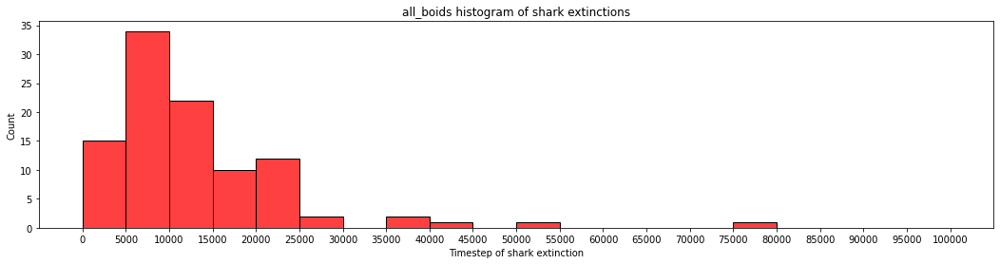

In [40]:
fig = plt.figure(figsize=(18,4))
ax=sns.histplot(data=sharks_no_none, bins=range(0,100001,5000), color = 'r')
ax.set_title("all_boids histogram of shark extinctions")
ax.set_xlabel("Timestep of shark extinction")
ax.set_xticks(range(0,100001,5000))
fig.savefig('_all_boids/plots/shark_extinctions.png')
plt.show()
plt.close()

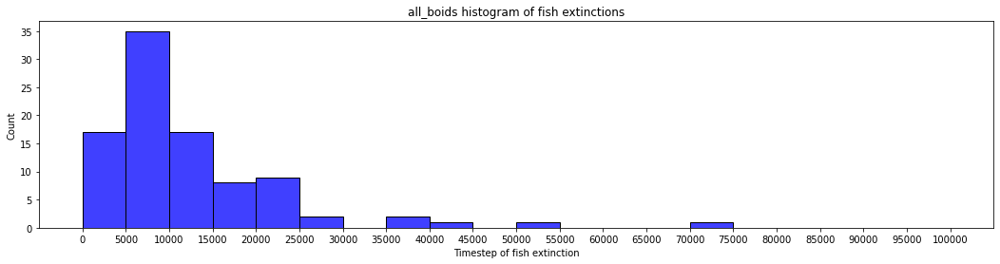

In [41]:
fig = plt.figure(figsize=(18,4))
ax=sns.histplot(data=fish_no_none, bins=range(0,100001,5000), color = 'b')
ax.set_title("all_boids histogram of fish extinctions")
ax.set_xlabel("Timestep of fish extinction")
ax.set_xticks(range(0,100001,5000))
fig.savefig('_all_boids/plots/fish_extinctions.png')
plt.show()
plt.close()

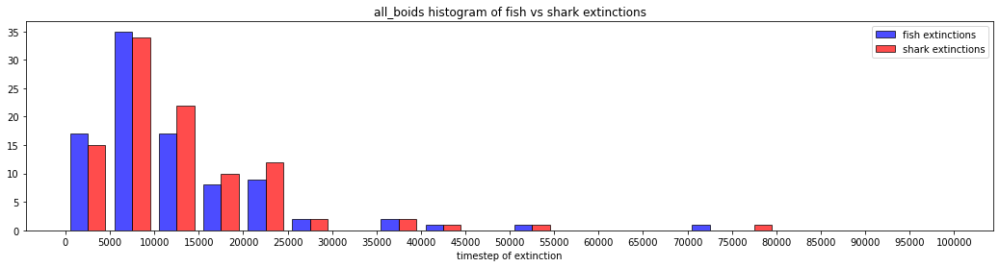

In [42]:
#plotting on top of each other
fig = plt.figure(figsize=(18,4))
plt.hist([fish_no_none, sharks_no_none], color=['b','r'], ec="k",alpha=0.7, bins=range(0,100001,5000))
plt.xticks(range(0,100001,5000))

handles = [Rectangle((0,0),1,1,color=c,ec="k", alpha=0.7) for c in ['b','r']]
labels=["fish extinctions","shark extinctions"]
plt.legend(handles, labels)

plt.title("all_boids histogram of fish vs shark extinctions")
plt.xlabel("timestep of extinction")

fig.savefig('_all_boids/plots/_all_extinctions.png')
plt.show()
plt.close()

## Inspecting mean genetic distribution over all experiments
### Solo fish

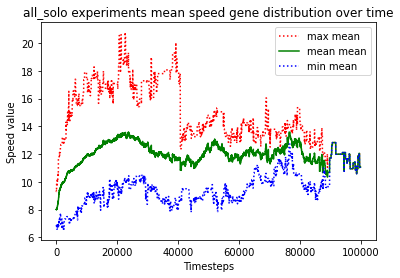

In [43]:
#getting the mean value for speed gene
temp=pd.DataFrame(data = solo_minMeanMax_speed)
mean_speed = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean speed for all columns
min_mean_speed = mean_speed.min()
mean_mean_speed = mean_speed.mean()
max_mean_speed = mean_speed.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo experiments mean speed gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Speed value")
plt.plot(max_mean_speed, ':r', label='max mean')
plt.plot(mean_mean_speed, '-g', label='mean mean')
plt.plot(min_mean_speed, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/speed.png')
plt.close()

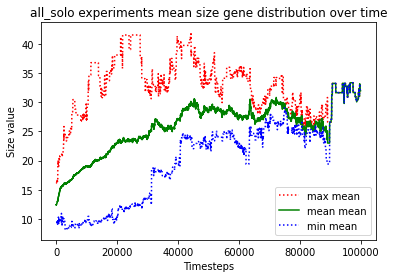

In [44]:
#getting the mean value for size gene
temp=pd.DataFrame(data = solo_minMeanMax_size)
mean_size = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean size for all columns
min_mean_size = mean_size.min()
mean_mean_size = mean_size.mean()
max_mean_size = mean_size.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo experiments mean size gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Size value")
plt.plot(max_mean_size, ':r', label='max mean')
plt.plot(mean_mean_size, '-g', label='mean mean')
plt.plot(min_mean_size, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/size.png')
plt.close()

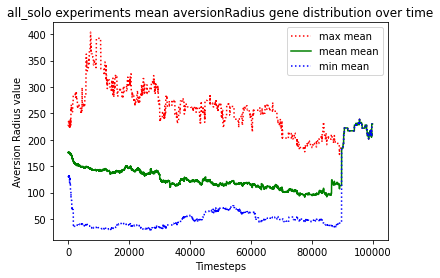

In [45]:
#getting the mean value for aversionRadius gene
temp=pd.DataFrame(data = solo_minMeanMax_aversionRadius)
mean_aversionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean aversionRadius for all columns
min_mean_aversionRadius = mean_aversionRadius.min()
mean_mean_aversionRadius = mean_aversionRadius.mean()
max_mean_aversionRadius = mean_aversionRadius.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo experiments mean aversionRadius gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Aversion Radius value")
plt.plot(max_mean_aversionRadius, ':r', label='max mean')
plt.plot(mean_mean_aversionRadius, '-g', label='mean mean')
plt.plot(min_mean_aversionRadius, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/aversionRadius.png')
plt.close()

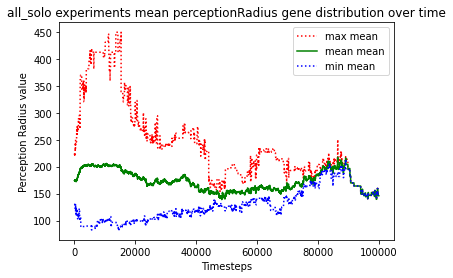

In [46]:
#getting the mean value for perceptionRadius gene
temp=pd.DataFrame(data = solo_minMeanMax_perceptionRadius)
mean_perceptionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean perceptionRadius for all columns
min_mean_perceptionRadius = mean_perceptionRadius.min()
mean_mean_perceptionRadius = mean_perceptionRadius.mean()
max_mean_perceptionRadius = mean_perceptionRadius.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo experiments mean perceptionRadius gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Perception Radius value")
plt.plot(max_mean_perceptionRadius, ':r', label='max mean')
plt.plot(mean_mean_perceptionRadius, '-g', label='mean mean')
plt.plot(min_mean_perceptionRadius, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/perceptionRadius.png')
plt.close()

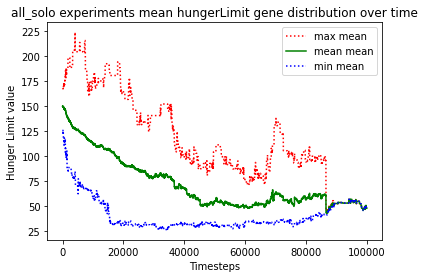

In [47]:
#getting the mean value for hungerLimit gene
temp=pd.DataFrame(data = solo_minMeanMax_hungerLimit)
mean_hungerLimit = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean hungerLimit for all columns
min_mean_hungerLimit = mean_hungerLimit.min()
mean_mean_hungerLimit = mean_hungerLimit.mean()
max_mean_hungerLimit = mean_hungerLimit.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo experiments mean hungerLimit gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Hunger Limit value")
plt.plot(max_mean_hungerLimit, ':r', label='max mean')
plt.plot(mean_mean_hungerLimit, '-g', label='mean mean')
plt.plot(min_mean_hungerLimit, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/hungerLimit.png')
plt.close()

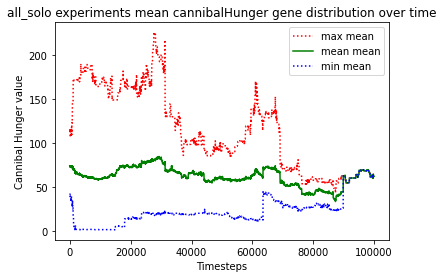

In [48]:
#getting the mean value for canibalHunger gene
temp=pd.DataFrame(data = solo_minMeanMax_canibalHunger)
mean_canibalHunger = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean canibalHunger for all columns
min_mean_canibalHunger = mean_canibalHunger.min()
mean_mean_canibalHunger = mean_canibalHunger.mean()
max_mean_canibalHunger = mean_canibalHunger.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo experiments mean cannibalHunger gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Cannibal Hunger value")
plt.plot(max_mean_canibalHunger, ':r', label='max mean')
plt.plot(mean_mean_canibalHunger, '-g', label='mean mean')
plt.plot(min_mean_canibalHunger, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/canibalHunger.png')
plt.close()

### Boids fish

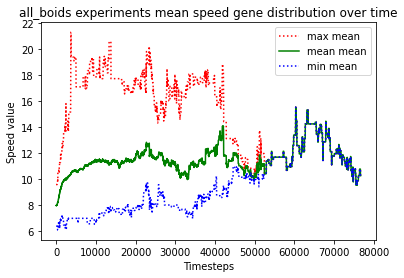

In [49]:
#getting the mean value for speed gene
temp=pd.DataFrame(data = boids_minMeanMax_speed)
mean_speed = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean speed for all columns
min_mean_speed = mean_speed.min()
mean_mean_speed = mean_speed.mean()
max_mean_speed = mean_speed.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids experiments mean speed gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Speed value")
plt.plot(max_mean_speed, ':r', label='max mean')
plt.plot(mean_mean_speed, '-g', label='mean mean')
plt.plot(min_mean_speed, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/speed.png')
plt.close()

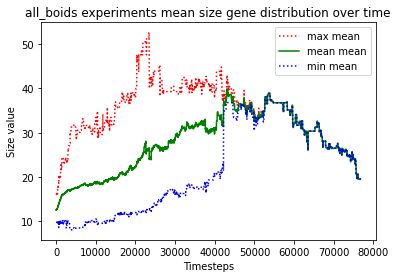

In [50]:
#getting the mean value for size gene
temp=pd.DataFrame(data = boids_minMeanMax_size)
mean_size = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean size for all columns
min_mean_size = mean_size.min()
mean_mean_size = mean_size.mean()
max_mean_size = mean_size.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids experiments mean size gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Size value")
plt.plot(max_mean_size, ':r', label='max mean')
plt.plot(mean_mean_size, '-g', label='mean mean')
plt.plot(min_mean_size, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/size.png')
plt.close()

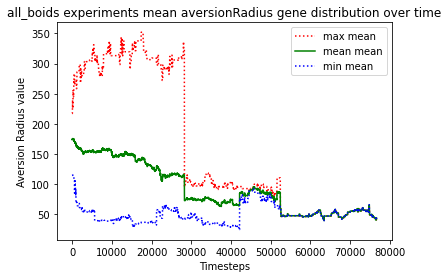

In [51]:
#getting the mean value for aversionRadius gene
temp=pd.DataFrame(data = boids_minMeanMax_aversionRadius)
mean_aversionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean aversionRadius for all columns
min_mean_aversionRadius = mean_aversionRadius.min()
mean_mean_aversionRadius = mean_aversionRadius.mean()
max_mean_aversionRadius = mean_aversionRadius.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids experiments mean aversionRadius gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Aversion Radius value")
plt.plot(max_mean_aversionRadius, ':r', label='max mean')
plt.plot(mean_mean_aversionRadius, '-g', label='mean mean')
plt.plot(min_mean_aversionRadius, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/aversionRadius.png')
plt.close()

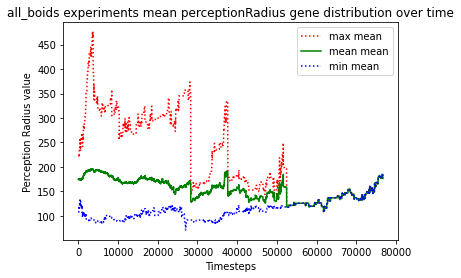

In [52]:
#getting the mean value for perceptionRadius gene
temp=pd.DataFrame(data = boids_minMeanMax_perceptionRadius)
mean_perceptionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean perceptionRadius for all columns
min_mean_perceptionRadius = mean_perceptionRadius.min()
mean_mean_perceptionRadius = mean_perceptionRadius.mean()
max_mean_perceptionRadius = mean_perceptionRadius.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids experiments mean perceptionRadius gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Perception Radius value")
plt.plot(max_mean_perceptionRadius, ':r', label='max mean')
plt.plot(mean_mean_perceptionRadius, '-g', label='mean mean')
plt.plot(min_mean_perceptionRadius, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/perceptionRadius.png')
plt.close()

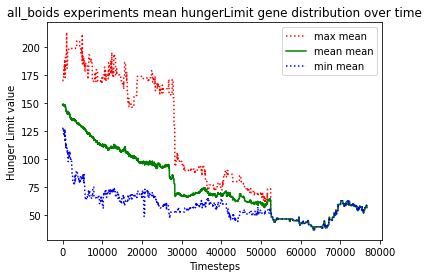

In [53]:
#getting the mean value for hungerLimit gene
temp=pd.DataFrame(data = boids_minMeanMax_hungerLimit)
mean_hungerLimit = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean hungerLimit for all columns
min_mean_hungerLimit = mean_hungerLimit.min()
mean_mean_hungerLimit = mean_hungerLimit.mean()
max_mean_hungerLimit = mean_hungerLimit.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids experiments mean hungerLimit gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Hunger Limit value")
plt.plot(max_mean_hungerLimit, ':r', label='max mean')
plt.plot(mean_mean_hungerLimit, '-g', label='mean mean')
plt.plot(min_mean_hungerLimit, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/hungerLimit.png')
plt.close()

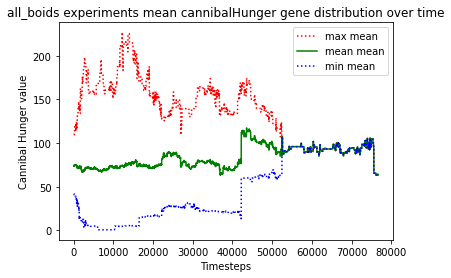

In [54]:
#getting the mean value for canibalHunger gene
temp=pd.DataFrame(data = boids_minMeanMax_canibalHunger)
mean_canibalHunger = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean canibalHunger for all columns
min_mean_canibalHunger = mean_canibalHunger.min()
mean_mean_canibalHunger = mean_canibalHunger.mean()
max_mean_canibalHunger = mean_canibalHunger.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids experiments mean cannibalHunger gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Cannibal Hunger value")
plt.plot(max_mean_canibalHunger, ':r', label='max mean')
plt.plot(mean_mean_canibalHunger, '-g', label='mean mean')
plt.plot(min_mean_canibalHunger, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/canibalHunger.png')
plt.close()

# Boids Versus Solo Comparison Charts
## Comparing populations

In [55]:
#getting the pred and fish popsizes

#for boids
temp=pd.DataFrame(data = boids_populationSizes, columns = ["pred","fish"])
boids_preds_popsizes = pd.DataFrame(data = temp["pred"].to_list()).replace(0, np.nan)
boids_fish_popsizes = pd.DataFrame(data = temp["fish"].to_list())# getting min/max/mean of all columns

boids_min_fish = boids_fish_popsizes.min()
boids_mean_fish = boids_fish_popsizes.mean()
boids_max_fish = boids_fish_popsizes.max()

boids_min_shark = boids_preds_popsizes.min()
boids_mean_shark = boids_preds_popsizes.mean()
boids_max_shark = boids_preds_popsizes.max()




#for solo
temp=pd.DataFrame(data = solo_populationSizes, columns = ["pred","fish"])
solo_preds_popsizes = pd.DataFrame(data = temp["pred"].to_list()).replace(0, np.nan)
solo_fish_popsizes = pd.DataFrame(data = temp["fish"].to_list())# getting min/max/mean of all columns

solo_min_fish = solo_fish_popsizes.min()
solo_mean_fish = solo_fish_popsizes.mean()
solo_max_fish = solo_fish_popsizes.max()

solo_min_shark = solo_preds_popsizes.min()
solo_mean_shark = solo_preds_popsizes.mean()
solo_max_shark = solo_preds_popsizes.max()

### Comparing fish populations

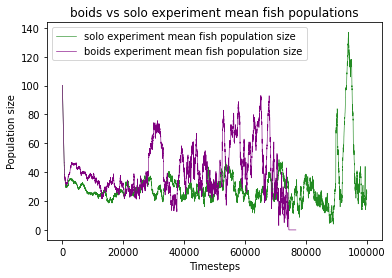

In [56]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("boids vs solo experiment mean fish populations")
plt.xlabel("Timesteps")
plt.ylabel("Population size")

plt.plot(solo_mean_fish, color='forestgreen', linestyle='-', lw=0.6, label='solo experiment mean fish population size')

plt.plot(boids_mean_fish, color='purple', linestyle='-', lw=0.6, label='boids experiment mean fish population size')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/_fish_mean_populations.png')
plt.close()

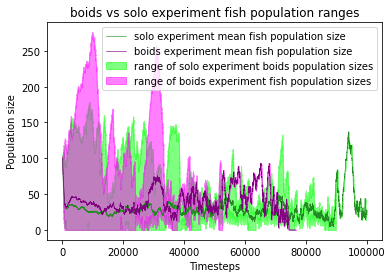

In [57]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("boids vs solo experiment fish population ranges")
plt.xlabel("Timesteps")
plt.ylabel("Population size")

plt.plot(solo_mean_fish, color='forestgreen', linestyle='-', lw=0.6, label='solo experiment mean fish population size')
plt.fill_between(list(range(len(solo_mean_fish))),solo_min_fish, solo_max_fish, color="lime", alpha=.5, label='range of solo experiment boids population sizes')

plt.plot(boids_mean_fish, color='purple', linestyle='-', lw=0.6, label='boids experiment mean fish population size')
plt.fill_between(list(range(len(boids_mean_fish))),boids_min_fish, boids_max_fish, color="magenta", alpha=.5, label='range of boids experiment fish population sizes')
plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/_fish_mean_populations_with_ranges.png')
plt.close()

In [58]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_fish, solo_mean_fish)
print("T-Test on mean fish population sizes between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on mean fish population sizes between boids and solo
t = 115.627
p = 0.0


### Comparing shark populations 

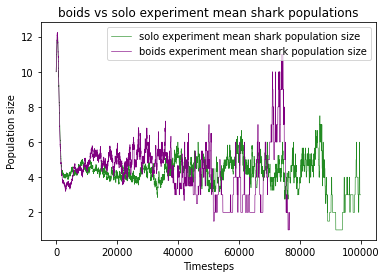

In [59]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("boids vs solo experiment mean shark populations")
plt.xlabel("Timesteps")
plt.ylabel("Population size")

plt.plot(solo_mean_shark, color='forestgreen', linestyle='-', lw=0.6, label='solo experiment mean shark population size')

plt.plot(boids_mean_shark, color='purple', linestyle='-', lw=0.6, label='boids experiment mean shark population size')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/_shark_mean_populations.png')
plt.close()

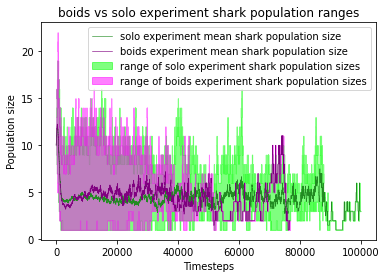

In [60]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("boids vs solo experiment shark population ranges")
plt.xlabel("Timesteps")
plt.ylabel("Population size")

plt.plot(solo_mean_shark, color='forestgreen', linestyle='-', lw=0.6, label='solo experiment mean shark population size')
plt.fill_between(list(range(len(solo_mean_shark))),solo_min_shark, solo_max_shark, color="lime", alpha=.5, label='range of solo experiment shark population sizes')

plt.plot(boids_mean_shark, color='purple', linestyle='-', lw=0.6, label='boids experiment mean shark population size')
plt.fill_between(list(range(len(boids_mean_shark))),boids_min_shark, boids_max_shark, color="magenta", alpha=.5, label='range of boids experiment shark population sizes')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/_shark_mean_populations_with_ranges.png')
plt.close()

In [61]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_shark, solo_mean_shark)
print("T-Test on mean shark population sizes between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on mean shark population sizes between boids and solo
t = 34.707
p = 0.0


## Comparing extinction rates

In [62]:
#getting the solo and boid experiment fish and shark extinction timesteps

# SOLO
solo_fish_never_went_extinct = solo_fish_extinct_timestep.count(None)
solo_fish_no_none=solo_fish_extinct_timestep.copy()
while None in solo_fish_no_none: solo_fish_no_none.remove(None)

solo_sharks_never_went_extinct = solo_shark_extinct_timestep.count(None)
solo_sharks_no_none=solo_shark_extinct_timestep.copy()
while None in solo_sharks_no_none: solo_sharks_no_none.remove(None)
    
    
    
# BOIDS
boids_fish_never_went_extinct = boids_fish_extinct_timestep.count(None)
boids_fish_no_none=boids_fish_extinct_timestep.copy()
while None in boids_fish_no_none: boids_fish_no_none.remove(None)

boids_sharks_never_went_extinct = boids_shark_extinct_timestep.count(None)
boids_sharks_no_none=boids_shark_extinct_timestep.copy()
while None in boids_sharks_no_none: boids_sharks_no_none.remove(None)

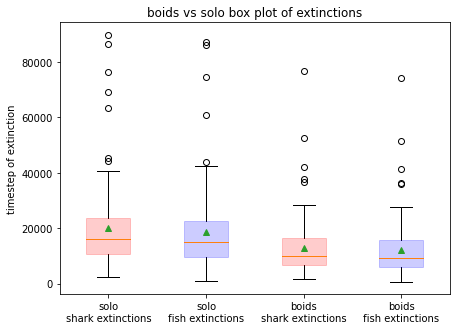

In [63]:
# box plot of extinctions
fig=plt.figure(figsize=(7,5))
bp=plt.boxplot([solo_sharks_no_none, solo_fish_no_none, boids_sharks_no_none, boids_fish_no_none], labels=["solo\nshark extinctions","solo\nfish extinctions", "boids\nshark extinctions","boids\nfish extinctions"], showmeans=True, patch_artist=True)

i=0
for box in bp['boxes']:
    if i%2==1:
        box.set(color='blue', alpha=0.2) 
    else:
        box.set(color='red', alpha=0.2)
    i+=1

plt.ylabel("timestep of extinction")
plt.title("boids vs solo box plot of extinctions")
plt.show()
fig.savefig("__boids_vs_solo/plots/box_all_extinctions.png")

In [64]:
#just plotting without patch artist so below function works
bp=plt.boxplot([solo_sharks_no_none, solo_fish_no_none, boids_sharks_no_none, boids_fish_no_none], labels=["solo\nshark extinctions","solo\nfish extinctions", "boids\nshark extinctions","boids\nfish extinctions"], showmeans=True)
plt.close()
#getting the dataframe annotating the box plot
temp=get_box_plot_data(["solo\nshark extinctions","solo\nfish extinctions","boids\nshark extinctions","boids\nfish extinctions"], bp)
temp["max"]=[max(solo_sharks_no_none),max(solo_fish_no_none),max(boids_sharks_no_none),max(boids_fish_no_none)]
temp["min"]=[min(solo_sharks_no_none),min(solo_fish_no_none),min(boids_sharks_no_none),min(boids_fish_no_none)]
temp["number of runs without extinction"]=[solo_shark_extinct_timestep.count(None),solo_fish_extinct_timestep.count(None),boids_shark_extinct_timestep.count(None),boids_fish_extinct_timestep.count(None)]
temp

,label,lower_whisker,lower_quartile,median,mean,upper_quartile,upper_whisker,max,min,number of runs without extinction
0,solo: shark extinctions,2384.0,10625.50,15979.0,20021.95,23584.50,40762.0,89824,2384,1
1,solo: fish extinctions,1106.0,9580.75,14966.0,18722.11,22737.00,42397.0,87050,1106,6
2,boids: shark extinctions,1731.0,6834.00,10072.0,13006.87,16526.25,28278.0,76706,1731,0
3,boids: fish extinctions,665.0,6172.00,9369.0,12277.74,15585.00,27786.0,74386,665,7


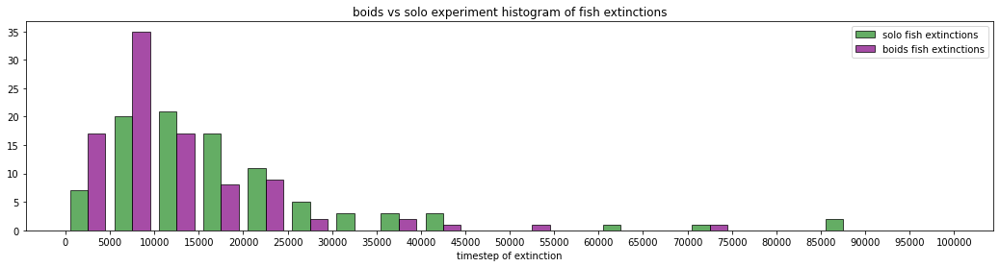

In [65]:
fig = plt.figure(figsize=(18,4))
plt.hist([solo_fish_no_none, boids_fish_no_none], color=['forestgreen','purple'], ec="k",alpha=0.7, bins=range(0,100001,5000))
plt.xticks(range(0,100001,5000))

handles = [Rectangle((0,0),1,1,color=c,ec="k", alpha=0.7) for c in ['forestgreen','purple']]
labels=["solo fish extinctions","boids fish extinctions"]
plt.legend(handles, labels)

plt.title("boids vs solo experiment histogram of fish extinctions")
plt.xlabel("timestep of extinction")

fig.savefig('__boids_vs_solo/plots/fish_extinctions.png')
plt.show()
plt.close()

In [66]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_fish_no_none, solo_fish_no_none)
print("T-Test on fish extinctions between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on fish extinctions between boids and solo
t = -3.232
p = 0.001


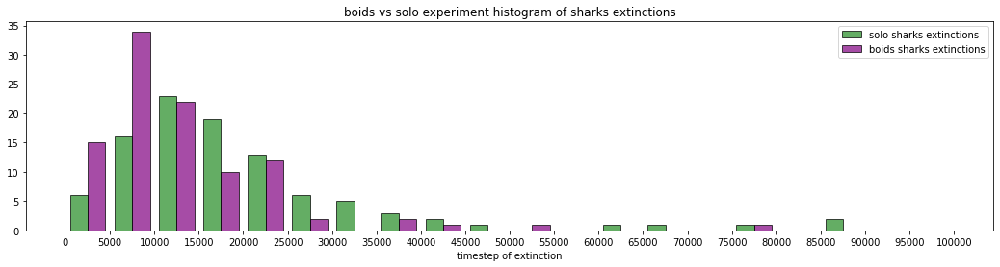

In [67]:
fig = plt.figure(figsize=(18,4))
plt.hist([solo_sharks_no_none, boids_sharks_no_none], color=['forestgreen','purple'], ec="k",alpha=0.7, bins=range(0,100001,5000))
plt.xticks(range(0,100001,5000))

handles = [Rectangle((0,0),1,1,color=c,ec="k", alpha=0.7) for c in ['forestgreen','purple']]
labels=["solo sharks extinctions","boids sharks extinctions"]
plt.legend(handles, labels)

plt.title("boids vs solo experiment histogram of sharks extinctions")
plt.xlabel("timestep of extinction")

fig.savefig('__boids_vs_solo/plots/sharks_extinctions.png')
plt.show()
plt.close()

In [68]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_sharks_no_none,solo_sharks_no_none)
print("T-Test on shark extinctions between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on shark extinctions between boids and solo
t = -3.547
p = 0.0


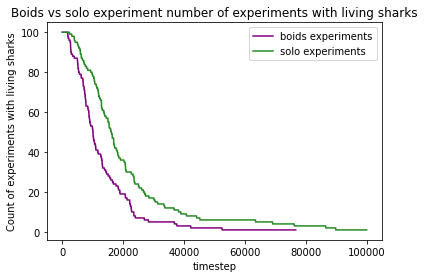

In [69]:
fig = plt.figure()
plt.title("Boids vs solo experiment number of experiments with living sharks")
plt.xlabel("timestep")
plt.ylabel("Count of experiments with living sharks")
plt.plot(boids_preds_popsizes.count(), color='purple', label = "boids experiments")
plt.plot(solo_preds_popsizes.count(), color='forestgreen', label = "solo experiments")
plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/_count_experiments_with_life.png')
plt.close()

In [70]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_preds_popsizes.count(), solo_preds_popsizes.count())
print("T-Test on run time of experiments between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on run time of experiments between boids and solo
t = -28.725
p = 0.0


## Comparing genes

### speed

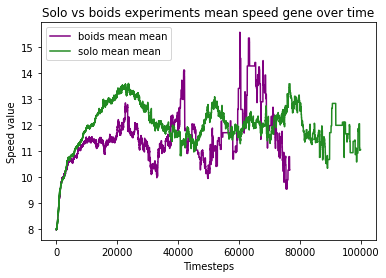

In [71]:
#getting the SOLO speed values
temp=pd.DataFrame(data = solo_minMeanMax_speed)
solo_mean_speed = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
solo_min_mean_speed = solo_mean_speed.min()
solo_mean_mean_speed = solo_mean_speed.mean()
solo_max_mean_speed = solo_mean_speed.max()

#getting the BOIDS speed values
temp=pd.DataFrame(data = boids_minMeanMax_speed)
boids_mean_speed = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
boids_min_mean_speed = boids_mean_speed.min()
boids_mean_mean_speed = boids_mean_speed.mean()
boids_max_mean_speed = boids_mean_speed.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean speed gene over time")
plt.xlabel("Timesteps")
plt.ylabel("Speed value")

plt.plot(boids_mean_mean_speed, label='boids mean mean', color='purple')
plt.plot(solo_mean_mean_speed, label='solo mean mean', color='forestgreen')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/speed.png')
plt.close()

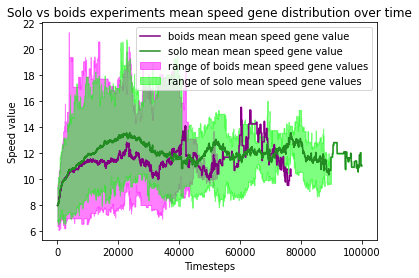

In [72]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean speed gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Speed value")

plt.plot(boids_mean_mean_speed, label='boids mean mean speed gene value', color='purple')
plt.plot(solo_mean_mean_speed, label='solo mean mean speed gene value', color='forestgreen')

plt.fill_between(list(range(len(boids_mean_mean_speed))),boids_min_mean_speed, boids_max_mean_speed, color="magenta", alpha=.5, label='range of boids mean speed gene values')
plt.fill_between(list(range(len(solo_mean_mean_speed))),solo_min_mean_speed, solo_max_mean_speed, color="lime", alpha=.5, label='range of solo mean speed gene values')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/speed_with_ranges.png')
plt.close()

In [73]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_mean_speed, solo_mean_mean_speed)
print("T-Test on speed gene mean values between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on speed gene mean values between boids and solo
t = -95.053
p = 0.0


### size

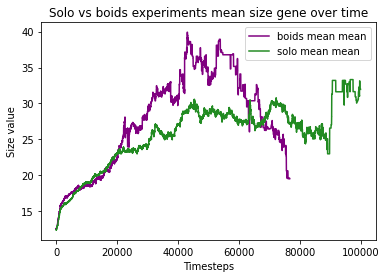

In [74]:
#getting the SOLO size values
temp=pd.DataFrame(data = solo_minMeanMax_size)
solo_mean_size = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
solo_min_mean_size = solo_mean_size.min()
solo_mean_mean_size = solo_mean_size.mean()
solo_max_mean_size = solo_mean_size.max()

#getting the BOIDS size values
temp=pd.DataFrame(data = boids_minMeanMax_size)
boids_mean_size = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
boids_min_mean_size = boids_mean_size.min()
boids_mean_mean_size = boids_mean_size.mean()
boids_max_mean_size = boids_mean_size.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean size gene over time")
plt.xlabel("Timesteps")
plt.ylabel("Size value")

plt.plot(boids_mean_mean_size, label='boids mean mean', color='purple')
plt.plot(solo_mean_mean_size, label='solo mean mean', color='forestgreen')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/size.png')
plt.close()

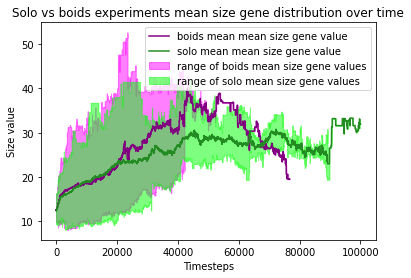

In [75]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean size gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Size value")

plt.plot(boids_mean_mean_size, label='boids mean mean size gene value', color='purple')
plt.plot(solo_mean_mean_size, label='solo mean mean size gene value', color='forestgreen')

plt.fill_between(list(range(len(boids_mean_mean_size))),boids_min_mean_size, boids_max_mean_size, color="magenta", alpha=.5, label='range of boids mean size gene values')
plt.fill_between(list(range(len(solo_mean_mean_size))),solo_min_mean_size, solo_max_mean_size, color="lime", alpha=.5, label='range of solo mean size gene values')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/size_with_ranges.png')
plt.close()

In [76]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_mean_size, solo_mean_mean_size)
print("T-Test on size gene mean values between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on size gene mean values between boids and solo
t = 71.075
p = 0.0


### Aversion radius

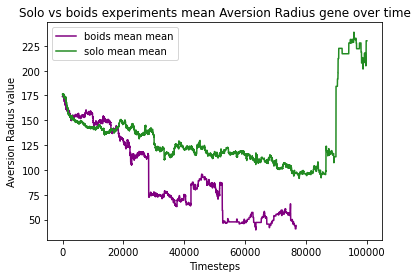

In [77]:
#getting the SOLO aversionRadius values
temp=pd.DataFrame(data = solo_minMeanMax_aversionRadius)
solo_mean_aversionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
solo_min_mean_aversionRadius = solo_mean_aversionRadius.min()
solo_mean_mean_aversionRadius = solo_mean_aversionRadius.mean()
solo_max_mean_aversionRadius = solo_mean_aversionRadius.max()

#getting the BOIDS aversionRadius values
temp=pd.DataFrame(data = boids_minMeanMax_aversionRadius)
boids_mean_aversionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
boids_min_mean_aversionRadius = boids_mean_aversionRadius.min()
boids_mean_mean_aversionRadius = boids_mean_aversionRadius.mean()
boids_max_mean_aversionRadius = boids_mean_aversionRadius.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean Aversion Radius gene over time")
plt.xlabel("Timesteps")
plt.ylabel("Aversion Radius value")

plt.plot(boids_mean_mean_aversionRadius, label='boids mean mean', color='purple')
plt.plot(solo_mean_mean_aversionRadius, label='solo mean mean', color='forestgreen')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/aversionRadius.png')
plt.close()

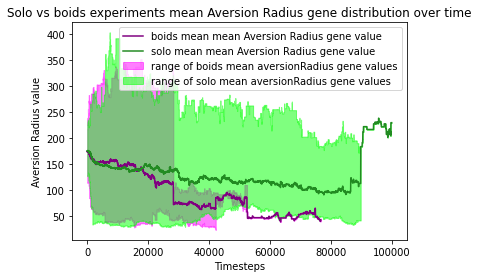

In [78]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean Aversion Radius gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Aversion Radius value")

plt.plot(boids_mean_mean_aversionRadius, label='boids mean mean Aversion Radius gene value', color='purple')
plt.plot(solo_mean_mean_aversionRadius, label='solo mean mean Aversion Radius gene value', color='forestgreen')

plt.fill_between(list(range(len(boids_mean_mean_aversionRadius))),boids_min_mean_aversionRadius, boids_max_mean_aversionRadius, color="magenta", alpha=.5, label='range of boids mean aversionRadius gene values')
plt.fill_between(list(range(len(solo_mean_mean_aversionRadius))),solo_min_mean_aversionRadius, solo_max_mean_aversionRadius, color="lime", alpha=.5, label='range of solo mean aversionRadius gene values')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/aversionRadius_with_ranges.png')
plt.close()

In [79]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_mean_aversionRadius, solo_mean_mean_aversionRadius)
print("T-Test on aversionRadius gene mean values between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on aversionRadius gene mean values between boids and solo
t = -229.582
p = 0.0


### Perception Radius

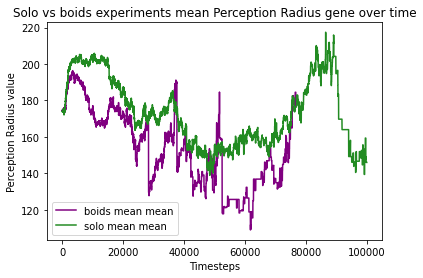

In [80]:
#getting the SOLO perceptionRadius values
temp=pd.DataFrame(data = solo_minMeanMax_perceptionRadius)
solo_mean_perceptionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
solo_min_mean_perceptionRadius = solo_mean_perceptionRadius.min()
solo_mean_mean_perceptionRadius = solo_mean_perceptionRadius.mean()
solo_max_mean_perceptionRadius = solo_mean_perceptionRadius.max()

#getting the BOIDS perceptionRadius values
temp=pd.DataFrame(data = boids_minMeanMax_perceptionRadius)
boids_mean_perceptionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
boids_min_mean_perceptionRadius = boids_mean_perceptionRadius.min()
boids_mean_mean_perceptionRadius = boids_mean_perceptionRadius.mean()
boids_max_mean_perceptionRadius = boids_mean_perceptionRadius.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean Perception Radius gene over time")
plt.xlabel("Timesteps")
plt.ylabel("Perception Radius value")

plt.plot(boids_mean_mean_perceptionRadius, label='boids mean mean', color='purple')
plt.plot(solo_mean_mean_perceptionRadius, label='solo mean mean', color='forestgreen')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/perceptionRadius.png')
plt.close()

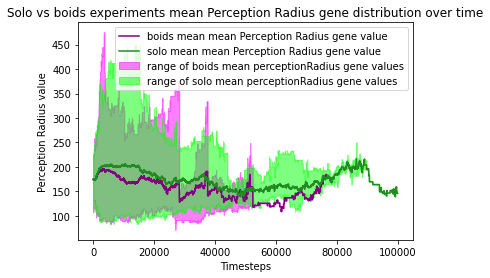

In [81]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean Perception Radius gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Perception Radius value")

plt.plot(boids_mean_mean_perceptionRadius, label='boids mean mean Perception Radius gene value', color='purple')
plt.plot(solo_mean_mean_perceptionRadius, label='solo mean mean Perception Radius gene value', color='forestgreen')

plt.fill_between(list(range(len(boids_mean_mean_perceptionRadius))),boids_min_mean_perceptionRadius, boids_max_mean_perceptionRadius, color="magenta", alpha=.5, label='range of boids mean perceptionRadius gene values')
plt.fill_between(list(range(len(solo_mean_mean_perceptionRadius))),solo_min_mean_perceptionRadius, solo_max_mean_perceptionRadius, color="lime", alpha=.5, label='range of solo mean perceptionRadius gene values')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/perceptionRadius_with_ranges.png')
plt.close()

In [82]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_mean_perceptionRadius, solo_mean_mean_perceptionRadius)
print("T-Test on perceptionRadius gene mean values between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on perceptionRadius gene mean values between boids and solo
t = -206.062
p = 0.0


### Hunger Limit

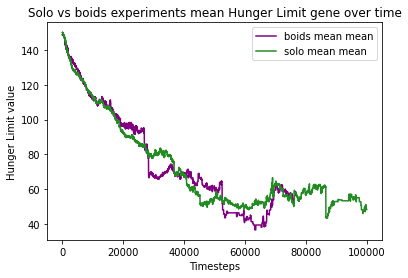

In [83]:
#getting the SOLO hungerLimit values
temp=pd.DataFrame(data = solo_minMeanMax_hungerLimit)
solo_mean_hungerLimit = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
solo_min_mean_hungerLimit = solo_mean_hungerLimit.min()
solo_mean_mean_hungerLimit = solo_mean_hungerLimit.mean()
solo_max_mean_hungerLimit = solo_mean_hungerLimit.max()

#getting the BOIDS hungerLimit values
temp=pd.DataFrame(data = boids_minMeanMax_hungerLimit)
boids_mean_hungerLimit = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
boids_min_mean_hungerLimit = boids_mean_hungerLimit.min()
boids_mean_mean_hungerLimit = boids_mean_hungerLimit.mean()
boids_max_mean_hungerLimit = boids_mean_hungerLimit.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean Hunger Limit gene over time")
plt.xlabel("Timesteps")
plt.ylabel("Hunger Limit value")

plt.plot(boids_mean_mean_hungerLimit, label='boids mean mean', color='purple')
plt.plot(solo_mean_mean_hungerLimit, label='solo mean mean', color='forestgreen')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/hungerLimit.png')
plt.close()

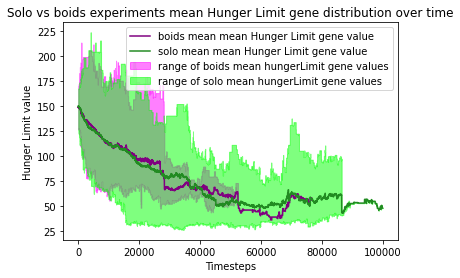

In [84]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean Hunger Limit gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Hunger Limit value")

plt.plot(boids_mean_mean_hungerLimit, label='boids mean mean Hunger Limit gene value', color='purple')
plt.plot(solo_mean_mean_hungerLimit, label='solo mean mean Hunger Limit gene value', color='forestgreen')

plt.fill_between(list(range(len(boids_mean_mean_hungerLimit))),boids_min_mean_hungerLimit, boids_max_mean_hungerLimit, color="magenta", alpha=.5, label='range of boids mean hungerLimit gene values')
plt.fill_between(list(range(len(solo_mean_mean_hungerLimit))),solo_min_mean_hungerLimit, solo_max_mean_hungerLimit, color="lime", alpha=.5, label='range of solo mean hungerLimit gene values')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/hungerLimit_with_ranges.png')
plt.close()

In [85]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_mean_hungerLimit, solo_mean_mean_hungerLimit)
print("T-Test on hungerLimit gene mean values between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on hungerLimit gene mean values between boids and solo
t = 34.298
p = 0.0


### Cannibal Hunger

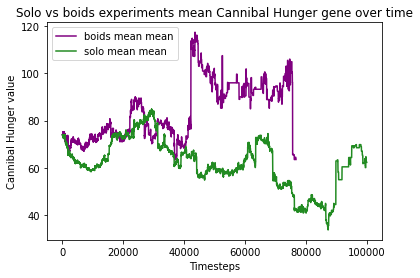

In [86]:
#getting the SOLO canibalHunger values
temp=pd.DataFrame(data = solo_minMeanMax_canibalHunger)
solo_mean_canibalHunger = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
solo_min_mean_canibalHunger = solo_mean_canibalHunger.min()
solo_mean_mean_canibalHunger = solo_mean_canibalHunger.mean()
solo_max_mean_canibalHunger = solo_mean_canibalHunger.max()

#getting the BOIDS canibalHunger values
temp=pd.DataFrame(data = boids_minMeanMax_canibalHunger)
boids_mean_canibalHunger = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
boids_min_mean_canibalHunger = boids_mean_canibalHunger.min()
boids_mean_mean_canibalHunger = boids_mean_canibalHunger.mean()
boids_max_mean_canibalHunger = boids_mean_canibalHunger.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean Cannibal Hunger gene over time")
plt.xlabel("Timesteps")
plt.ylabel("Cannibal Hunger value")

plt.plot(boids_mean_mean_canibalHunger, label='boids mean mean', color='purple')
plt.plot(solo_mean_mean_canibalHunger, label='solo mean mean', color='forestgreen')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/cannibalHunger.png')
plt.close()

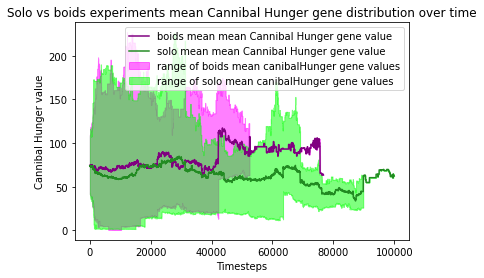

In [87]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean Cannibal Hunger gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Cannibal Hunger value")

plt.plot(boids_mean_mean_canibalHunger, label='boids mean mean Cannibal Hunger gene value', color='purple')
plt.plot(solo_mean_mean_canibalHunger, label='solo mean mean Cannibal Hunger gene value', color='forestgreen')

plt.fill_between(list(range(len(boids_mean_mean_canibalHunger))),boids_min_mean_canibalHunger, boids_max_mean_canibalHunger, color="magenta", alpha=.5, label='range of boids mean canibalHunger gene values')
plt.fill_between(list(range(len(solo_mean_mean_canibalHunger))),solo_min_mean_canibalHunger, solo_max_mean_canibalHunger, color="lime", alpha=.5, label='range of solo mean canibalHunger gene values')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/cannibalHunger_with_ranges.png')
plt.close()

In [88]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_mean_canibalHunger, solo_mean_mean_canibalHunger)
print("T-Test on cannibalHunger gene mean values between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on cannibalHunger gene mean values between boids and solo
t = 409.776
p = 0.0


# TODO:

1.  Start writing the report
    a. Look at the lecture slides where he describes what he wants
    b. Read the mark scheme / coursework desc pdf
    c. Do mini literature review for 3 pieces of related literature
    d. Start writing